In [4]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when ONI is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [ ]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

[I 2025-05-20 23:58:23,939] A new study created in memory with name: no-name-ac8ff91b-55fc-41dd-9b44-db4adcef3289
[I 2025-05-21 00:03:13,199] Trial 0 finished with value: 5.27193431854248 and parameters: {'lr': 0.9558546248629887, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3643733965202276}. Best is trial 0 with value: 5.27193431854248.


Cross Validation Accuracies:
[5.565174102783203, 5.5022711753845215, 4.373484134674072, 5.009019374847412, 5.909722805023193]
Mean Cross Validation Accuracy:
5.27193431854248
Standard Deviation of Cross Validation Accuracy:
0.5333208776487439


[I 2025-05-21 00:09:30,127] Trial 1 finished with value: 0.06867870688438416 and parameters: {'lr': 0.001837461198168192, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.18173039731035764}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.06749662011861801, 0.06773598492145538, 0.08030156046152115, 0.06536292284727097, 0.06249644607305527]
Mean Cross Validation Accuracy:
0.06867870688438416
Standard Deviation of Cross Validation Accuracy:
0.006108871444331129


[I 2025-05-21 00:15:09,425] Trial 2 finished with value: 0.06953778862953186 and parameters: {'lr': 0.888249562639659, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2650500959171095}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.06377669423818588, 0.061705827713012695, 0.06839605420827866, 0.07616040855646133, 0.07764995843172073]
Mean Cross Validation Accuracy:
0.06953778862953186
Standard Deviation of Cross Validation Accuracy:
0.0064109246052135825


[I 2025-05-21 00:19:46,963] Trial 3 finished with value: 0.12917666286230087 and parameters: {'lr': 0.021686345703216092, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.46344325750912707}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.15139758586883545, 0.10375415533781052, 0.16171668469905853, 0.12002301961183548, 0.10899186879396439]
Mean Cross Validation Accuracy:
0.12917666286230087
Standard Deviation of Cross Validation Accuracy:
0.023195436730398998


[I 2025-05-21 00:23:41,594] Trial 4 finished with value: 0.1846876859664917 and parameters: {'lr': 0.035400320105961905, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3823539650143257}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.18390582501888275, 0.1950194388628006, 0.16093802452087402, 0.2094796746969223, 0.17409546673297882]
Mean Cross Validation Accuracy:
0.1846876859664917
Standard Deviation of Cross Validation Accuracy:
0.016722683138383265


[I 2025-05-21 00:33:15,168] Trial 5 finished with value: 4.011168003082275 and parameters: {'lr': 0.049882150085025785, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28199054580684313}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[4.5616774559021, 2.4393250942230225, 4.749467849731445, 4.488321781158447, 3.8170478343963623]
Mean Cross Validation Accuracy:
4.011168003082275
Standard Deviation of Cross Validation Accuracy:
0.846663548189043


[I 2025-05-21 00:39:10,112] Trial 6 finished with value: 0.05107387825846672 and parameters: {'lr': 0.006580266640267653, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27046469908289605}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04249671474099159, 0.045296043157577515, 0.05648990720510483, 0.06254686415195465, 0.04853986203670502]
Mean Cross Validation Accuracy:
0.05107387825846672
Standard Deviation of Cross Validation Accuracy:
0.007407227896233787


[I 2025-05-21 00:44:07,441] Trial 7 finished with value: 0.9854403734207153 and parameters: {'lr': 0.605937335526479, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.11452833678550985}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.6476268768310547, 1.1606515645980835, 1.0395011901855469, 1.0202308893203735, 1.059191346168518]
Mean Cross Validation Accuracy:
0.9854403734207153
Standard Deviation of Cross Validation Accuracy:
0.1757208455926713


[I 2025-05-21 00:48:35,187] Trial 8 finished with value: 1.4821093320846557 and parameters: {'lr': 0.8573186947939732, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4047895412416317}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[1.884287714958191, 1.4442414045333862, 1.833909511566162, 1.4929946660995483, 0.7551133632659912]
Mean Cross Validation Accuracy:
1.4821093320846557
Standard Deviation of Cross Validation Accuracy:
0.4038778099985748


[I 2025-05-21 00:54:36,406] Trial 9 finished with value: 0.05765921920537949 and parameters: {'lr': 0.1554728133709094, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25854029453015237}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.05298822000622749, 0.0512922964990139, 0.05634655803442001, 0.06381139159202576, 0.06385762989521027]
Mean Cross Validation Accuracy:
0.05765921920537949
Standard Deviation of Cross Validation Accuracy:
0.005298085272471146


[I 2025-05-21 01:00:53,142] Trial 10 finished with value: 0.30728051960468294 and parameters: {'lr': 0.002384959321038042, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18825671130398702}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.31184080243110657, 0.37189266085624695, 0.31937023997306824, 0.2457219511270523, 0.28757694363594055]
Mean Cross Validation Accuracy:
0.30728051960468294
Standard Deviation of Cross Validation Accuracy:
0.04127801975416439


[I 2025-05-21 01:07:53,619] Trial 11 finished with value: 0.06021386086940765 and parameters: {'lr': 0.1457712180204786, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22510583780430715}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.05339103937149048, 0.06463606655597687, 0.06331360340118408, 0.06585203111171722, 0.05387656390666962]
Mean Cross Validation Accuracy:
0.06021386086940765
Standard Deviation of Cross Validation Accuracy:
0.005434436430123432


[I 2025-05-21 01:13:02,826] Trial 12 finished with value: 0.1505704939365387 and parameters: {'lr': 0.009258151995327361, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3137625206705784}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.16748297214508057, 0.11977555602788925, 0.06222524493932724, 0.13995634019374847, 0.26341235637664795]
Mean Cross Validation Accuracy:
0.1505704939365387
Standard Deviation of Cross Validation Accuracy:
0.06615918578543632


[I 2025-05-21 01:17:40,149] Trial 13 finished with value: 0.055870074033737185 and parameters: {'lr': 0.1288954189131518, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3230082208913488}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04559481516480446, 0.060720883309841156, 0.058669399470090866, 0.0644751563668251, 0.04989011585712433]
Mean Cross Validation Accuracy:
0.055870074033737185
Standard Deviation of Cross Validation Accuracy:
0.007025024699011307


[I 2025-05-21 01:22:02,270] Trial 14 finished with value: 0.05116631537675857 and parameters: {'lr': 0.006614318403589186, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3360866456622074}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04226727783679962, 0.04547780752182007, 0.0566626638174057, 0.0625687763094902, 0.04885505139827728]
Mean Cross Validation Accuracy:
0.05116631537675857
Standard Deviation of Cross Validation Accuracy:
0.007444728248028884


[I 2025-05-21 01:28:39,426] Trial 15 finished with value: 0.051044286042451856 and parameters: {'lr': 0.005404551035956621, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.449775915365779}. Best is trial 15 with value: 0.051044286042451856.


Cross Validation Accuracies:
[0.04251108691096306, 0.0453217513859272, 0.05636783689260483, 0.062447819858789444, 0.04857293516397476]
Mean Cross Validation Accuracy:
0.051044286042451856
Standard Deviation of Cross Validation Accuracy:
0.00734916651916169


[I 2025-05-21 01:35:34,444] Trial 16 finished with value: 0.05102758929133415 and parameters: {'lr': 0.005294432374959981, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4963469269484101}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.0425584577023983, 0.04510955512523651, 0.05644184350967407, 0.06245611980557442, 0.04857197031378746]
Mean Cross Validation Accuracy:
0.05102758929133415
Standard Deviation of Cross Validation Accuracy:
0.007385185729288465


[I 2025-05-21 01:40:58,429] Trial 17 finished with value: 0.5692744612693786 and parameters: {'lr': 0.0010545278848791998, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49185525419733084}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.5873256921768188, 0.5190343856811523, 0.6121917366981506, 0.61375892162323, 0.5140615701675415]
Mean Cross Validation Accuracy:
0.5692744612693786
Standard Deviation of Cross Validation Accuracy:
0.044088853964262195


[I 2025-05-21 01:48:03,010] Trial 18 finished with value: 0.09136146754026413 and parameters: {'lr': 0.015622502720989955, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43618470520530606}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.0859605222940445, 0.08223897963762283, 0.10970651358366013, 0.09376499056816101, 0.08513633161783218]
Mean Cross Validation Accuracy:
0.09136146754026413
Standard Deviation of Cross Validation Accuracy:
0.009934384224693563


[I 2025-05-21 01:51:42,680] Trial 19 finished with value: 0.06020569875836372 and parameters: {'lr': 0.004060291056158403, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.48916932915689265}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.06778410077095032, 0.046017229557037354, 0.056339558213949203, 0.06292818486690521, 0.06795942038297653]
Mean Cross Validation Accuracy:
0.06020569875836372
Standard Deviation of Cross Validation Accuracy:
0.00826104118974986


[I 2025-05-21 01:56:26,000] Trial 20 finished with value: 0.22341266870498658 and parameters: {'lr': 0.0031520288307098298, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4313369898671497}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.3051508069038391, 0.13639052212238312, 0.24081097543239594, 0.224153533577919, 0.2105575054883957]
Mean Cross Validation Accuracy:
0.22341266870498658
Standard Deviation of Cross Validation Accuracy:
0.05426321481653108


[I 2025-05-21 02:01:49,341] Trial 21 finished with value: 0.051159337908029553 and parameters: {'lr': 0.007417722274812812, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44918584721856003}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.042559605091810226, 0.045386556535959244, 0.05647542327642441, 0.06276240199804306, 0.04861270263791084]
Mean Cross Validation Accuracy:
0.051159337908029553
Standard Deviation of Cross Validation Accuracy:
0.007438516255277218


[I 2025-05-21 02:08:08,510] Trial 22 finished with value: 0.051338189840316774 and parameters: {'lr': 0.014288128421506783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4988881906071839}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.042583152651786804, 0.04510456696152687, 0.05697524920105934, 0.06296940892934799, 0.049058571457862854]
Mean Cross Validation Accuracy:
0.051338189840316774
Standard Deviation of Cross Validation Accuracy:
0.007586396853193446


[I 2025-05-21 02:14:52,811] Trial 23 finished with value: 0.05183838754892349 and parameters: {'lr': 0.004592607242858895, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3625954553479331}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.046200644224882126, 0.04531661421060562, 0.05620134249329567, 0.06254696846008301, 0.04892636835575104]
Mean Cross Validation Accuracy:
0.05183838754892349
Standard Deviation of Cross Validation Accuracy:
0.00658037406266609


[I 2025-05-21 02:21:29,755] Trial 24 finished with value: 0.44265968799591066 and parameters: {'lr': 0.001713242172265903, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39448856133886995}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.42994582653045654, 0.4223979711532593, 0.4576061964035034, 0.4592362642288208, 0.4441121816635132]
Mean Cross Validation Accuracy:
0.44265968799591066
Standard Deviation of Cross Validation Accuracy:
0.014645614864611793


[I 2025-05-21 02:29:09,819] Trial 25 finished with value: 0.09570933282375335 and parameters: {'lr': 0.010639408343460065, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22139615652651526}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.1264086216688156, 0.09072738885879517, 0.09169134497642517, 0.09160211682319641, 0.07811719179153442]
Mean Cross Validation Accuracy:
0.09570933282375335
Standard Deviation of Cross Validation Accuracy:
0.016184949656866628


[I 2025-05-21 02:34:35,622] Trial 26 finished with value: 0.05102245062589646 and parameters: {'lr': 0.0050791000665729264, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41647911543396515}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.0426330640912056, 0.045341189950704575, 0.05632572993636131, 0.062324490398168564, 0.04848777875304222]
Mean Cross Validation Accuracy:
0.05102245062589646
Standard Deviation of Cross Validation Accuracy:
0.007279340152098919


[I 2025-05-21 02:40:46,811] Trial 27 finished with value: 0.568458890914917 and parameters: {'lr': 0.0010980097382684497, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4171614416410031}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.6108144521713257, 0.5515281558036804, 0.5719274878501892, 0.5195311903953552, 0.5884931683540344]
Mean Cross Validation Accuracy:
0.568458890914917
Standard Deviation of Cross Validation Accuracy:
0.031266489013290516


[I 2025-05-21 02:44:45,464] Trial 28 finished with value: 0.051178085058927535 and parameters: {'lr': 0.06049550023033372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.46605220477781667}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.04196230694651604, 0.0479121170938015, 0.05441300570964813, 0.06205911561846733, 0.04954387992620468]
Mean Cross Validation Accuracy:
0.051178085058927535
Standard Deviation of Cross Validation Accuracy:
0.00673987057793171


[I 2025-05-21 02:48:27,581] Trial 29 finished with value: 0.0771654948592186 and parameters: {'lr': 0.02160947972500265, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3674576773203678}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.06785611808300018, 0.0767318606376648, 0.08417800068855286, 0.0770704448223114, 0.07999105006456375]
Mean Cross Validation Accuracy:
0.0771654948592186
Standard Deviation of Cross Validation Accuracy:
0.005366946419224128


[I 2025-05-21 02:51:51,342] Trial 30 finished with value: 0.2938618063926697 and parameters: {'lr': 0.004771059740708683, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.47106602433042516}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.23426753282546997, 0.34757480025291443, 0.26270556449890137, 0.3338139057159424, 0.29094722867012024]
Mean Cross Validation Accuracy:
0.2938618063926697
Standard Deviation of Cross Validation Accuracy:
0.042454539366275926


[I 2025-05-21 02:57:11,328] Trial 31 finished with value: 0.050984546542167664 and parameters: {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042394403368234634, 0.045098088681697845, 0.05630620941519737, 0.06237003952264786, 0.04875399172306061]
Mean Cross Validation Accuracy:
0.050984546542167664
Standard Deviation of Cross Validation Accuracy:
0.007367032874034748


[I 2025-05-21 03:02:58,842] Trial 32 finished with value: 0.3295901656150818 and parameters: {'lr': 0.002630547359037514, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42422229989916793}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.3475082814693451, 0.36137646436691284, 0.25011739134788513, 0.30415281653404236, 0.3847958743572235]
Mean Cross Validation Accuracy:
0.3295901656150818
Standard Deviation of Cross Validation Accuracy:
0.04762788788057916


[I 2025-05-21 03:08:14,476] Trial 33 finished with value: 0.4782963752746582 and parameters: {'lr': 0.0017080418665937247, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.453683816893905}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.47703787684440613, 0.5450551509857178, 0.42592307925224304, 0.5210710167884827, 0.4223947525024414]
Mean Cross Validation Accuracy:
0.4782963752746582
Standard Deviation of Cross Validation Accuracy:
0.04930708158914591


[I 2025-05-21 03:11:36,702] Trial 34 finished with value: 0.051183727383613584 and parameters: {'lr': 0.013861833793168602, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4848510661291912}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042316313832998276, 0.045494113117456436, 0.05672140419483185, 0.06257149577140808, 0.04881531000137329]
Mean Cross Validation Accuracy:
0.051183727383613584
Standard Deviation of Cross Validation Accuracy:
0.007442570359645235


[I 2025-05-21 03:17:38,515] Trial 35 finished with value: 0.06029686406254768 and parameters: {'lr': 0.0040273317410159035, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.44526587135309686}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.046588316559791565, 0.05671238526701927, 0.0671980232000351, 0.06751985102891922, 0.06346574425697327]
Mean Cross Validation Accuracy:
0.06029686406254768
Standard Deviation of Cross Validation Accuracy:
0.007881777752700663


[I 2025-05-21 03:24:38,928] Trial 36 finished with value: 0.11269363760948181 and parameters: {'lr': 0.026247723820511246, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.35539868514496353}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.09954559057950974, 0.11783497780561447, 0.12775175273418427, 0.09380649775266647, 0.12452936917543411]
Mean Cross Validation Accuracy:
0.11269363760948181
Standard Deviation of Cross Validation Accuracy:
0.013585727396762398


[I 2025-05-21 03:28:37,995] Trial 37 finished with value: 0.05451729074120522 and parameters: {'lr': 0.010209290854751942, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3873265903546627}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043409354984760284, 0.04880812391638756, 0.06036762893199921, 0.06571106612682343, 0.0542902797460556]
Mean Cross Validation Accuracy:
0.05451729074120522
Standard Deviation of Cross Validation Accuracy:
0.007944298847918045


[I 2025-05-21 03:33:45,506] Trial 38 finished with value: 0.05212816521525383 and parameters: {'lr': 0.005841547479885234, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4673973251293872}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.044263582676649094, 0.04347243905067444, 0.05833818018436432, 0.06437911093235016, 0.05018751323223114]
Mean Cross Validation Accuracy:
0.05212816521525383
Standard Deviation of Cross Validation Accuracy:
0.00811405374571475


[I 2025-05-21 03:36:44,524] Trial 39 finished with value: 0.055210118740797044 and parameters: {'lr': 0.03631532163006064, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.40792189919475663}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.044459596276283264, 0.04865213483572006, 0.060498785227537155, 0.06938095390796661, 0.05305912345647812]
Mean Cross Validation Accuracy:
0.055210118740797044
Standard Deviation of Cross Validation Accuracy:
0.008854267100279777


[I 2025-05-21 03:41:32,229] Trial 40 finished with value: 0.38772123456001284 and parameters: {'lr': 0.0022009597270482768, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1309235738215551}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.26184695959091187, 0.3392125964164734, 0.4452348053455353, 0.4554486572742462, 0.43686315417289734]
Mean Cross Validation Accuracy:
0.38772123456001284
Standard Deviation of Cross Validation Accuracy:
0.07550783263846293


[I 2025-05-21 03:47:04,661] Trial 41 finished with value: 0.05109559446573257 and parameters: {'lr': 0.007780598849622445, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2928680246938695}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042367320507764816, 0.04505395144224167, 0.05659255012869835, 0.0626182034611702, 0.04884594678878784]
Mean Cross Validation Accuracy:
0.05109559446573257
Standard Deviation of Cross Validation Accuracy:
0.00749309243238556


[I 2025-05-21 03:53:31,154] Trial 42 finished with value: 0.16333281695842744 and parameters: {'lr': 0.003347226982658619, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2607690367766171}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.16370418667793274, 0.21275340020656586, 0.15689058601856232, 0.16676251590251923, 0.116553395986557]
Mean Cross Validation Accuracy:
0.16333281695842744
Standard Deviation of Cross Validation Accuracy:
0.030607552547852877


[I 2025-05-21 04:00:41,916] Trial 43 finished with value: 0.05202133432030678 and parameters: {'lr': 0.004784846279310102, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4806541332059162}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04334597662091255, 0.047313667833805084, 0.05772420018911362, 0.06163604557514191, 0.05008678138256073]
Mean Cross Validation Accuracy:
0.05202133432030678
Standard Deviation of Cross Validation Accuracy:
0.006725054671316316


[I 2025-05-21 04:05:11,643] Trial 44 finished with value: 0.05108282193541527 and parameters: {'lr': 0.00590866824774296, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2841250823307159}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04221242293715477, 0.045181360095739365, 0.056576360017061234, 0.06273035705089569, 0.04871360957622528]
Mean Cross Validation Accuracy:
0.05108282193541527
Standard Deviation of Cross Validation Accuracy:
0.007549416300049619


[I 2025-05-21 04:08:19,284] Trial 45 finished with value: 0.4277293860912323 and parameters: {'lr': 0.0014002660962685036, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.2498658202084616}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4265843331813812, 0.4333955943584442, 0.4417191743850708, 0.40396061539649963, 0.4329872131347656]
Mean Cross Validation Accuracy:
0.4277293860912323
Standard Deviation of Cross Validation Accuracy:
0.012819753853789024


[I 2025-05-21 04:12:39,058] Trial 46 finished with value: 0.45465545654296874 and parameters: {'lr': 0.0030598853667637665, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4537766087534131}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.44149133563041687, 0.44582557678222656, 0.46536919474601746, 0.44918468594551086, 0.471406489610672]
Mean Cross Validation Accuracy:
0.45465545654296874
Standard Deviation of Cross Validation Accuracy:
0.011632467339633608


[I 2025-05-21 04:17:37,873] Trial 47 finished with value: 0.05122214108705521 and parameters: {'lr': 0.018503921490259846, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34073866094948524}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04313020035624504, 0.04529351741075516, 0.056515589356422424, 0.06263274699449539, 0.04853865131735802]
Mean Cross Validation Accuracy:
0.05122214108705521
Standard Deviation of Cross Validation Accuracy:
0.007294542104691359


[I 2025-05-21 04:24:31,461] Trial 48 finished with value: 0.09753186851739884 and parameters: {'lr': 0.010813001990258756, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23465157477937454}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.08982286602258682, 0.09610298275947571, 0.11109836399555206, 0.0930808037519455, 0.09755432605743408]
Mean Cross Validation Accuracy:
0.09753186851739884
Standard Deviation of Cross Validation Accuracy:
0.007284678653452463


[I 2025-05-21 04:29:30,710] Trial 49 finished with value: 0.5553553879261017 and parameters: {'lr': 0.33825382201273674, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40548837728221443}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4881300628185272, 0.4797726571559906, 0.505088746547699, 0.4271158277988434, 0.8766696453094482]
Mean Cross Validation Accuracy:
0.5553553879261017
Standard Deviation of Cross Validation Accuracy:
0.16275562389140064


[I 2025-05-21 04:33:12,138] Trial 50 finished with value: 0.3777040958404541 and parameters: {'lr': 0.007833262975100886, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3086115758114054}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.324040025472641, 0.39374157786369324, 0.3908737003803253, 0.3691619634628296, 0.41070321202278137]
Mean Cross Validation Accuracy:
0.3777040958404541
Standard Deviation of Cross Validation Accuracy:
0.02990779649588216


[I 2025-05-21 04:38:02,134] Trial 51 finished with value: 0.05115235820412636 and parameters: {'lr': 0.005678225179984967, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27945521187070277}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0423833504319191, 0.04544823616743088, 0.05685076862573624, 0.06255127489566803, 0.04852816089987755]
Mean Cross Validation Accuracy:
0.05115235820412636
Standard Deviation of Cross Validation Accuracy:
0.007466272163322101


[I 2025-05-21 04:44:11,832] Trial 52 finished with value: 0.05098752230405808 and parameters: {'lr': 0.00666685537337673, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2756817260572487}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04193450137972832, 0.045423757284879684, 0.05650194734334946, 0.06242718920111656, 0.048650216311216354]
Mean Cross Validation Accuracy:
0.05098752230405808
Standard Deviation of Cross Validation Accuracy:
0.007478643333904605


[I 2025-05-21 04:50:13,383] Trial 53 finished with value: 0.1578376352787018 and parameters: {'lr': 0.0035216223925649557, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20794086398562228}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.09243254363536835, 0.19586177170276642, 0.11846742033958435, 0.2131388783454895, 0.1692875623703003]
Mean Cross Validation Accuracy:
0.1578376352787018
Standard Deviation of Cross Validation Accuracy:
0.04574495185953503


[I 2025-05-21 04:55:35,899] Trial 54 finished with value: 0.05143168196082115 and parameters: {'lr': 0.013708895502231078, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.32706091912197244}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04292118176817894, 0.04579409584403038, 0.05669812858104706, 0.06265560537576675, 0.049089398235082626]
Mean Cross Validation Accuracy:
0.05143168196082115
Standard Deviation of Cross Validation Accuracy:
0.0072582256872228456


[I 2025-05-21 05:00:29,997] Trial 55 finished with value: 0.2783196300268173 and parameters: {'lr': 0.0023799316682010197, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43473222642107123}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4067203402519226, 0.29131609201431274, 0.20965589582920074, 0.23610331118106842, 0.2478025108575821]
Mean Cross Validation Accuracy:
0.2783196300268173
Standard Deviation of Cross Validation Accuracy:
0.0694029840046378


[I 2025-05-21 05:05:18,515] Trial 56 finished with value: 0.051213546097278594 and parameters: {'lr': 0.008741124403826609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17148555302235113}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04275353252887726, 0.04550377279520035, 0.05652035400271416, 0.0626235082745552, 0.048666562885046005]
Mean Cross Validation Accuracy:
0.051213546097278594
Standard Deviation of Cross Validation Accuracy:
0.007334983452662059


[I 2025-05-21 05:10:15,476] Trial 57 finished with value: 0.05130074396729469 and parameters: {'lr': 0.006721787204379421, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49903004695061165}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04266251623630524, 0.04549515247344971, 0.05684530362486839, 0.06258013844490051, 0.048920609056949615]
Mean Cross Validation Accuracy:
0.05130074396729469
Standard Deviation of Cross Validation Accuracy:
0.007375036199167056


[I 2025-05-21 05:15:46,163] Trial 58 finished with value: 0.051214434951543805 and parameters: {'lr': 0.005165464954505452, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2715901960276225}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04264774173498154, 0.045326609164476395, 0.05675109475851059, 0.06246746703982353, 0.04887926205992699]
Mean Cross Validation Accuracy:
0.051214434951543805
Standard Deviation of Cross Validation Accuracy:
0.00735925391051602


[I 2025-05-21 05:21:14,148] Trial 59 finished with value: 0.05488366261124611 and parameters: {'lr': 0.012374754638987528, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3005810851612935}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04641493782401085, 0.04712550342082977, 0.06174701079726219, 0.06616108119487762, 0.05296977981925011]
Mean Cross Validation Accuracy:
0.05488366261124611
Standard Deviation of Cross Validation Accuracy:
0.007872191551533797


[I 2025-05-21 05:25:51,489] Trial 60 finished with value: 0.06173822209239006 and parameters: {'lr': 0.0019957840696409285, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.47687647585453863}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.06802001595497131, 0.05529208481311798, 0.066777803003788, 0.061037614941596985, 0.05756359174847603]
Mean Cross Validation Accuracy:
0.06173822209239006
Standard Deviation of Cross Validation Accuracy:
0.004986569654698134


[I 2025-05-21 05:31:14,731] Trial 61 finished with value: 0.051177967339754105 and parameters: {'lr': 0.006551332415778223, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2432616807522731}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04270532727241516, 0.04525380581617355, 0.05654282495379448, 0.06261629611253738, 0.048771582543849945]
Mean Cross Validation Accuracy:
0.051177967339754105
Standard Deviation of Cross Validation Accuracy:
0.007379553774955733


[I 2025-05-21 05:36:59,861] Trial 62 finished with value: 0.06369568258523942 and parameters: {'lr': 0.004269619879261996, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2942458251643465}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.06058939918875694, 0.05969327315688133, 0.05791303142905235, 0.08512594550848007, 0.05515676364302635]
Mean Cross Validation Accuracy:
0.06369568258523942
Standard Deviation of Cross Validation Accuracy:
0.010874526544420518


[I 2025-05-21 05:42:58,138] Trial 63 finished with value: 0.18894743621349336 and parameters: {'lr': 0.00286217850926009, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2639552222050328}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.2211167961359024, 0.18669261038303375, 0.22994302213191986, 0.0974937379360199, 0.20949101448059082]
Mean Cross Validation Accuracy:
0.18894743621349336
Standard Deviation of Cross Validation Accuracy:
0.04797167405622156


[I 2025-05-21 05:48:11,478] Trial 64 finished with value: 0.05106706619262695 and parameters: {'lr': 0.009028486828163623, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27949834406979923}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042388204485177994, 0.04508841037750244, 0.056537095457315445, 0.06256318837404251, 0.048758432269096375]
Mean Cross Validation Accuracy:
0.05106706619262695
Standard Deviation of Cross Validation Accuracy:
0.007462959223420769


[I 2025-05-21 05:53:06,153] Trial 65 finished with value: 0.051058873534202576 and parameters: {'lr': 0.009424607438039028, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2024420408659473}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04233277216553688, 0.045172885060310364, 0.05666486918926239, 0.06242327392101288, 0.048700567334890366]
Mean Cross Validation Accuracy:
0.051058873534202576
Standard Deviation of Cross Validation Accuracy:
0.007442151529994796


[I 2025-05-21 05:57:55,997] Trial 66 finished with value: 0.05117233321070671 and parameters: {'lr': 0.009085619960104983, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16762408379526905}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04275762662291527, 0.04554184526205063, 0.056188322603702545, 0.06265772134065628, 0.04871615022420883]
Mean Cross Validation Accuracy:
0.05117233321070671
Standard Deviation of Cross Validation Accuracy:
0.007288577453083378


[I 2025-05-21 06:03:14,303] Trial 67 finished with value: 0.0513776533305645 and parameters: {'lr': 0.018620639023831122, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13425993707249753}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043160390108823776, 0.04563996568322182, 0.056530699133872986, 0.06270277500152588, 0.048854436725378036]
Mean Cross Validation Accuracy:
0.0513776533305645
Standard Deviation of Cross Validation Accuracy:
0.007233579450639973


[I 2025-05-21 06:08:01,517] Trial 68 finished with value: 0.458040326833725 and parameters: {'lr': 0.004092619128673925, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.37829611151106335}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4372451603412628, 0.47897961735725403, 0.45704641938209534, 0.42823079228401184, 0.48869964480400085]
Mean Cross Validation Accuracy:
0.458040326833725
Standard Deviation of Cross Validation Accuracy:
0.023239977700391202


[I 2025-05-21 06:14:08,343] Trial 69 finished with value: 0.05143139883875847 and parameters: {'lr': 0.010822597868366153, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19592534378706677}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043959248811006546, 0.045837268233299255, 0.05738885700702667, 0.06387531012296677, 0.0460963100194931]
Mean Cross Validation Accuracy:
0.05143139883875847
Standard Deviation of Cross Validation Accuracy:
0.007822182967094684


[I 2025-05-21 06:19:30,619] Trial 70 finished with value: 0.052557780593633655 and parameters: {'lr': 0.06931767784438478, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42214896887022474}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04514578729867935, 0.04493632912635803, 0.05581556633114815, 0.06372740864753723, 0.053163811564445496]
Mean Cross Validation Accuracy:
0.052557780593633655
Standard Deviation of Cross Validation Accuracy:
0.0070535834776965815


[I 2025-05-21 06:24:17,271] Trial 71 finished with value: 0.05116865187883377 and parameters: {'lr': 0.0082258037078382, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2191954933592253}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042932938784360886, 0.04516264796257019, 0.0565175861120224, 0.06260157376527786, 0.048628512769937515]
Mean Cross Validation Accuracy:
0.05116865187883377
Standard Deviation of Cross Validation Accuracy:
0.007344033771731982


[I 2025-05-21 06:28:28,124] Trial 72 finished with value: 0.09312662780284882 and parameters: {'lr': 0.00367823909150032, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45867062934259156}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.13432860374450684, 0.11434993892908096, 0.07503828406333923, 0.06562405079603195, 0.0762922614812851]
Mean Cross Validation Accuracy:
0.09312662780284882
Standard Deviation of Cross Validation Accuracy:
0.026514175707952763


[I 2025-05-21 06:32:47,376] Trial 73 finished with value: 0.05119621008634567 and parameters: {'lr': 0.007091658834817609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4403261102564047}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04232252761721611, 0.045413922518491745, 0.05693777650594711, 0.06253588199615479, 0.04877094179391861]
Mean Cross Validation Accuracy:
0.05119621008634567
Standard Deviation of Cross Validation Accuracy:
0.007478138275578438


[I 2025-05-21 06:37:18,710] Trial 74 finished with value: 0.051074717193841934 and parameters: {'lr': 0.01692723987881031, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24559789689456346}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04277350381016731, 0.044984303414821625, 0.056262433528900146, 0.06236933171749115, 0.04898401349782944]
Mean Cross Validation Accuracy:
0.051074717193841934
Standard Deviation of Cross Validation Accuracy:
0.00727811848758121


[I 2025-05-21 06:40:46,361] Trial 75 finished with value: 0.0512557253241539 and parameters: {'lr': 0.005196369031276378, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.31816089328480474}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04270988330245018, 0.045537952333688736, 0.056730981916189194, 0.062493715435266495, 0.048806093633174896]
Mean Cross Validation Accuracy:
0.0512557253241539
Standard Deviation of Cross Validation Accuracy:
0.007321146026927057


[I 2025-05-21 06:47:27,912] Trial 76 finished with value: 2.1092357873916625 and parameters: {'lr': 0.027295809564138566, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3454670764299034}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[2.25537371635437, 2.1562397480010986, 2.116988182067871, 1.785899043083191, 2.2316782474517822]
Mean Cross Validation Accuracy:
2.1092357873916625
Standard Deviation of Cross Validation Accuracy:
0.16921263100801576


[I 2025-05-21 06:53:11,995] Trial 77 finished with value: 0.051152057200670245 and parameters: {'lr': 0.011309637011626189, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4919045773553989}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042528316378593445, 0.04551397264003754, 0.056206654757261276, 0.0624663271009922, 0.04904501512646675]
Mean Cross Validation Accuracy:
0.051152057200670245
Standard Deviation of Cross Validation Accuracy:
0.0072685375340310375


[I 2025-05-21 06:59:41,866] Trial 78 finished with value: 0.05111701786518097 and parameters: {'lr': 0.006214090659222875, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2756621819477794}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04257148504257202, 0.04522072896361351, 0.056547220796346664, 0.06271203607320786, 0.048533618450164795]
Mean Cross Validation Accuracy:
0.05111701786518097
Standard Deviation of Cross Validation Accuracy:
0.007461874532430251


[I 2025-05-21 07:03:14,598] Trial 79 finished with value: 0.051124269515275954 and parameters: {'lr': 0.009314941355480683, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4661785756433608}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04248848930001259, 0.04519153758883476, 0.056559089571237564, 0.06266778707504272, 0.048714444041252136]
Mean Cross Validation Accuracy:
0.051124269515275954
Standard Deviation of Cross Validation Accuracy:
0.007461519061771929


[I 2025-05-21 07:08:08,912] Trial 80 finished with value: 0.4540468156337738 and parameters: {'lr': 0.0027055424254085404, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25580973188338885}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.46660181879997253, 0.4463760554790497, 0.4338715672492981, 0.4461381733417511, 0.4772464632987976]
Mean Cross Validation Accuracy:
0.4540468156337738
Standard Deviation of Cross Validation Accuracy:
0.01564787262163306


[I 2025-05-21 07:13:06,610] Trial 81 finished with value: 0.051736225932836534 and parameters: {'lr': 0.01923749730430901, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23273018557757158}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04318265989422798, 0.04578186571598053, 0.05687059089541435, 0.0630309209227562, 0.049815092235803604]
Mean Cross Validation Accuracy:
0.051736225932836534
Standard Deviation of Cross Validation Accuracy:
0.007297129445680041


[I 2025-05-21 07:17:38,368] Trial 82 finished with value: 0.051215346157550815 and parameters: {'lr': 0.012445792433719637, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24565952953136935}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04225895181298256, 0.04592651501297951, 0.05614582076668739, 0.06280527263879776, 0.04894017055630684]
Mean Cross Validation Accuracy:
0.051215346157550815
Standard Deviation of Cross Validation Accuracy:
0.0073756509442861684


[I 2025-05-21 07:22:18,820] Trial 83 finished with value: 0.05104161500930786 and parameters: {'lr': 0.016352852477762567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2127005317209154}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042749516665935516, 0.044866893440485, 0.05622461065649986, 0.06237960234284401, 0.04898745194077492]
Mean Cross Validation Accuracy:
0.05104161500930786
Standard Deviation of Cross Validation Accuracy:
0.00730094607506461


[I 2025-05-21 07:27:12,784] Trial 84 finished with value: 0.05123659446835518 and parameters: {'lr': 0.014380186484691282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1986794254353263}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04306961968541145, 0.04522407427430153, 0.056337274610996246, 0.06233805790543556, 0.049213945865631104]
Mean Cross Validation Accuracy:
0.05123659446835518
Standard Deviation of Cross Validation Accuracy:
0.007158217821799066


[I 2025-05-21 07:33:17,076] Trial 85 finished with value: 0.052050376683473586 and parameters: {'lr': 0.004776230598028665, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1603102755718381}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04589216783642769, 0.04624691233038902, 0.05495760589838028, 0.06339752674102783, 0.04975767061114311]
Mean Cross Validation Accuracy:
0.052050376683473586
Standard Deviation of Cross Validation Accuracy:
0.0065432412758833665


[I 2025-05-21 07:38:36,488] Trial 86 finished with value: 0.051932448893785475 and parameters: {'lr': 0.04097073845973709, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2128123081551498}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.045195676386356354, 0.04655186086893082, 0.05696989223361015, 0.06257384270429611, 0.04837097227573395]
Mean Cross Validation Accuracy:
0.051932448893785475
Standard Deviation of Cross Validation Accuracy:
0.006717649062630587


[I 2025-05-21 07:44:16,939] Trial 87 finished with value: 0.051055402308702466 and parameters: {'lr': 0.007178751799104214, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18834661663126578}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04221348091959953, 0.04514242708683014, 0.05649590119719505, 0.06261305510997772, 0.0488121472299099]
Mean Cross Validation Accuracy:
0.051055402308702466
Standard Deviation of Cross Validation Accuracy:
0.0075013786680129075


[I 2025-05-21 07:50:56,396] Trial 88 finished with value: 0.05121859684586525 and parameters: {'lr': 0.0074590658605377365, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18475298046587604}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042746927589178085, 0.04505976289510727, 0.056640032678842545, 0.06277593225240707, 0.048870328813791275]
Mean Cross Validation Accuracy:
0.05121859684586525
Standard Deviation of Cross Validation Accuracy:
0.007458937545905096


[I 2025-05-21 07:57:55,234] Trial 89 finished with value: 0.05112432390451431 and parameters: {'lr': 0.005529878095817116, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1556637939134515}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042400628328323364, 0.045446064323186874, 0.05653304234147072, 0.062463484704494476, 0.04877839982509613]
Mean Cross Validation Accuracy:
0.05112432390451431
Standard Deviation of Cross Validation Accuracy:
0.007371291053044417


[I 2025-05-21 08:03:31,034] Trial 90 finished with value: 0.596740049123764 and parameters: {'lr': 0.00940015245257858, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1468638825101635}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.5554288625717163, 0.6032602190971375, 0.6928354501724243, 0.46800896525382996, 0.6641667485237122]
Mean Cross Validation Accuracy:
0.596740049123764
Standard Deviation of Cross Validation Accuracy:
0.08012678029201173


[I 2025-05-21 08:08:05,381] Trial 91 finished with value: 0.051228853315114974 and parameters: {'lr': 0.006700629656974047, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20142205505712096}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04294043406844139, 0.045229472219944, 0.0565955750644207, 0.06256847083568573, 0.048810314387083054]
Mean Cross Validation Accuracy:
0.051228853315114974
Standard Deviation of Cross Validation Accuracy:
0.007320224389012076


[I 2025-05-21 08:12:28,037] Trial 92 finished with value: 0.11884111016988755 and parameters: {'lr': 0.0036291625225694816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2318955141224798}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0698251873254776, 0.10408410429954529, 0.108544260263443, 0.09624921530485153, 0.2155027836561203]
Mean Cross Validation Accuracy:
0.11884111016988755
Standard Deviation of Cross Validation Accuracy:
0.050160199097081394


[I 2025-05-21 08:16:37,572] Trial 93 finished with value: 0.0615010991692543 and parameters: {'lr': 0.004404755343299991, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1792166575850866}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.08289680629968643, 0.056170787662267685, 0.0562247596681118, 0.06318973004817963, 0.04902341216802597]
Mean Cross Validation Accuracy:
0.0615010991692543
Standard Deviation of Cross Validation Accuracy:
0.011598037851722484


[I 2025-05-21 08:20:47,724] Trial 94 finished with value: 0.051358092576265335 and parameters: {'lr': 0.008440326449648509, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29072593168198424}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042871203273534775, 0.045544322580099106, 0.0568864569067955, 0.0628553107380867, 0.04863316938281059]
Mean Cross Validation Accuracy:
0.051358092576265335
Standard Deviation of Cross Validation Accuracy:
0.00742968714882324


[I 2025-05-21 08:25:00,136] Trial 95 finished with value: 0.05123598650097847 and parameters: {'lr': 0.005760740874005584, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10991095108390986}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04274410009384155, 0.04546089470386505, 0.056475166231393814, 0.06265023350715637, 0.04884953796863556]
Mean Cross Validation Accuracy:
0.05123598650097847
Standard Deviation of Cross Validation Accuracy:
0.007333389333452319


[I 2025-05-21 08:29:20,436] Trial 96 finished with value: 0.051119742542505266 and parameters: {'lr': 0.007624262191811609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41574244382842784}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042632345110177994, 0.04514101520180702, 0.05637924373149872, 0.06267020106315613, 0.04877590760588646]
Mean Cross Validation Accuracy:
0.051119742542505266
Standard Deviation of Cross Validation Accuracy:
0.007407430091375858


[I 2025-05-21 08:33:32,812] Trial 97 finished with value: 0.051141003519296645 and parameters: {'lr': 0.012289494003978765, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3066055140699647}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04256566986441612, 0.04540439322590828, 0.056799471378326416, 0.06254706531763077, 0.048388417810201645]
Mean Cross Validation Accuracy:
0.051141003519296645
Standard Deviation of Cross Validation Accuracy:
0.007431531165187157


[I 2025-05-21 08:36:09,695] Trial 98 finished with value: 0.059413828700780866 and parameters: {'lr': 0.022407882470303144, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.47679146254629956}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0542282834649086, 0.05546484887599945, 0.06279692053794861, 0.06590550392866135, 0.05867358669638634]
Mean Cross Validation Accuracy:
0.059413828700780866
Standard Deviation of Cross Validation Accuracy:
0.004395894378118436


[I 2025-05-21 08:40:57,867] Trial 99 finished with value: 0.05242023691534996 and parameters: {'lr': 0.009999033133542508, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3979616454945815}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04579135403037071, 0.045037586241960526, 0.05981875956058502, 0.06335435062646866, 0.04809913411736488]
Mean Cross Validation Accuracy:
0.05242023691534996
Standard Deviation of Cross Validation Accuracy:
0.0076342717876501185
Number of finished trials: 100
Best trial: {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}
Best hyperparameters:  {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}
Fold 1:
Epoch 1/100
84/84 [==============================] - 23s 140ms/step - loss: 0.6408 - val_loss: 0.3933
Epoch 2/100
84/84 [==============================] - 9s 105ms/step - loss: 0.3282 - val_loss: 0.2126
Epoch 3/100
84/84 [==============================] - 9s 104ms/step - loss: 0.0868 - val_loss: 0.2477
Epoch 4/100
84/84 [==============================] - 8s 92ms/step - loss: 0.0536 - 

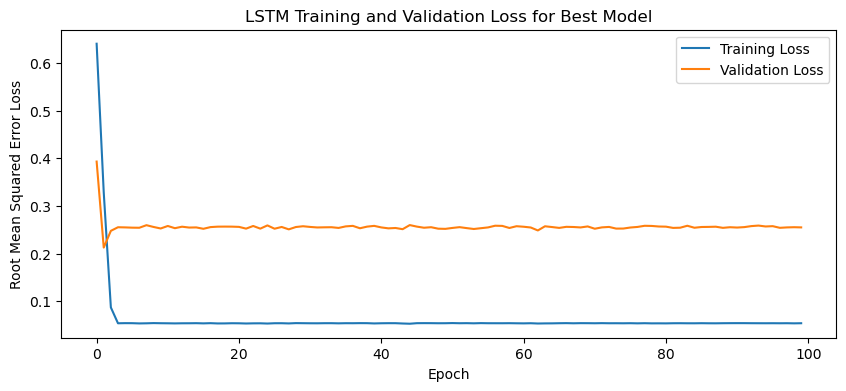

1/1 - 2s - loss: 0.0444 - 2s/epoch - 2s/step
Test Loss: 0.044439345598220825
1/1 [==============================] - 0s 81ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

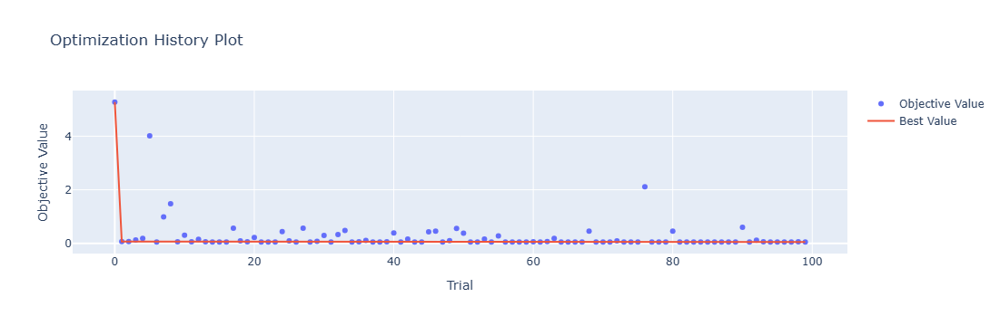

In [4]:
optuna.visualization.plot_optimization_history(study)

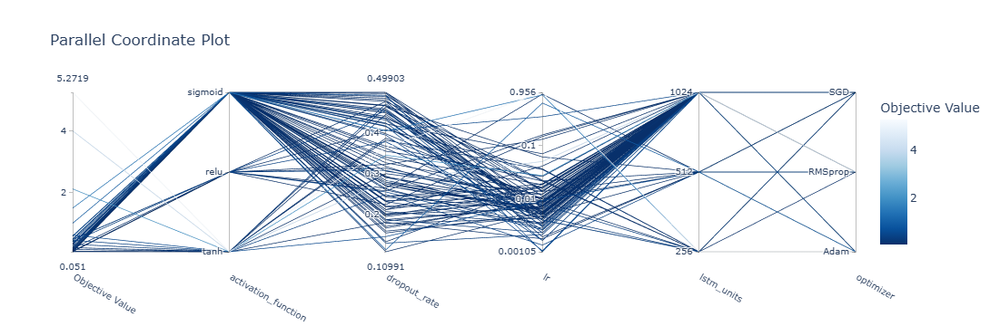

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

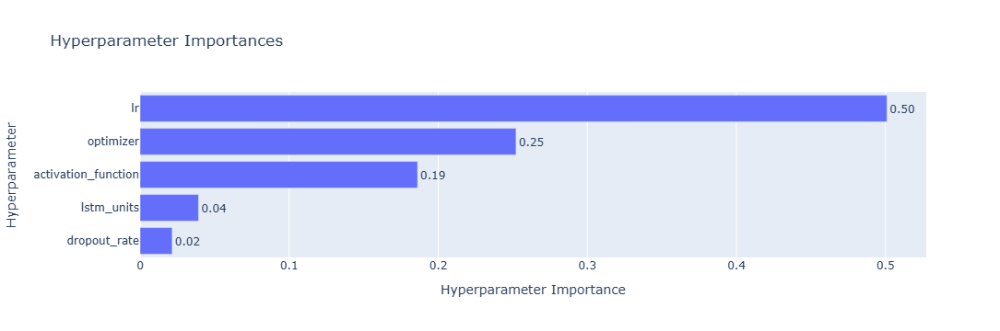

In [6]:
optuna.visualization.plot_param_importances(study)

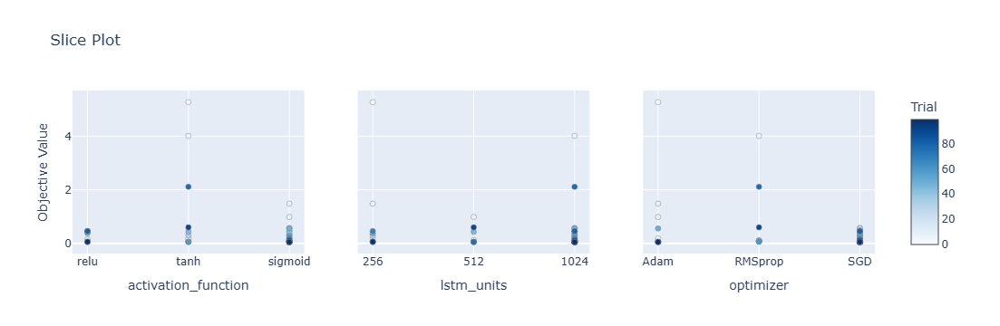

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

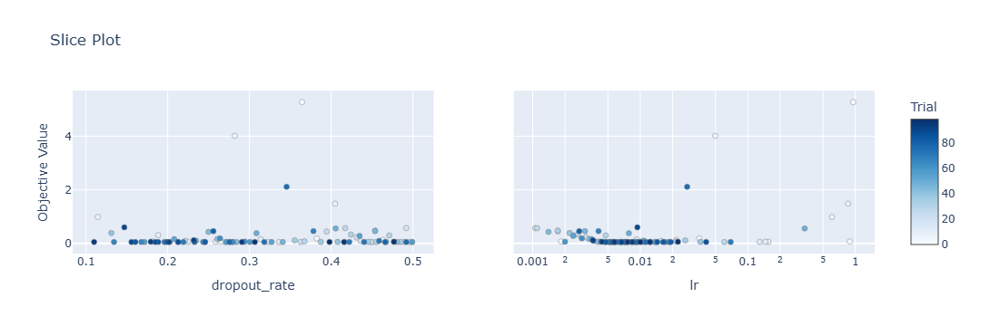

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 31s 137ms/step - loss: 0.5812 - accuracy: 0.0000e+00 - mae: 0.4751 - rmse: 0.5812 - mape: inf - pearson: 0.0914 - val_loss: 0.4224 - val_accuracy: 0.0000e+00 - val_mae: 0.3460 - val_rmse: 0.4224 - val_mape: 73.4129 - val_pearson: 0.1490
Epoch 2/100
84/84 [==============================] - 6s 70ms/step - loss: 0.2731 - accuracy: 0.0000e+00 - mae: 0.2234 - rmse: 0.2731 - mape: inf - pearson: 0.3271 - val_loss: 0.1297 - val_accuracy: 0.0000e+00 - val_mae: 0.1054 - val_rmse: 0.1297 - val_mape: 22.1181 - val_pearson: 0.6136
Epoch 3/100
84/84 [==============================] - 7s 81ms/step - loss: 0.0678 - accuracy: 0.3929 - mae: 0.0540 - rmse: 0.0678 - mape: inf - pearson: 0.8228

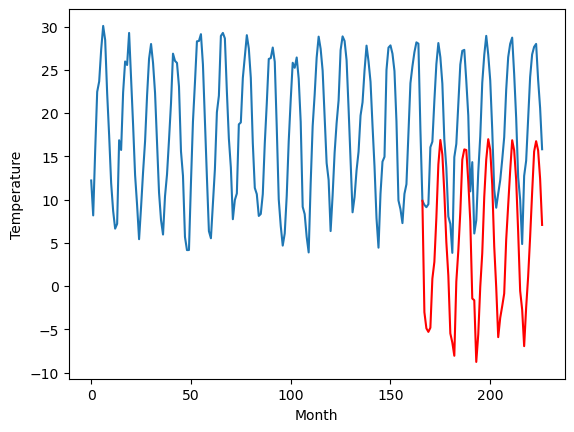

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.90		0.51
2.49		2.04		-0.45
2.11		1.62		-0.49
2.86		2.10		-0.76
8.69		7.77		-0.92
9.18		9.70		0.52
11.95		14.80		2.85
15.70		20.95		5.25
16.18		23.79		7.61
16.81		22.12		5.31
13.83		17.65		3.82
11.20		11.99		0.79
7.78		8.12		0.34
0.57		1.43		0.86
1.23		0.37		-0.86
1.14		-1.16		-2.30
6.20		7.43		1.23
7.60		11.00		3.40
11.62		15.45		3.83
15.10		21.53		6.43
16.32		22.70		6.38
16.66		22.62		5.96
14.53		18.97		4.44
11.90		14.41		2.51
6.39		5.46		-0.93
6.15		5.25		-0.90
-0.53		-1.87		-1.34
2.24		1.33		-0.91
6.10		6.81		0.71
9.07		10.70		1.63
13.38		17.21		3.83
17.07		21.54		4.47
17.21		23.88		6.67
16.66		22.65		5.99
15.64		18.60		2.96
10.04		11.47		1.43
7.35		6.73		-0.62
3.50		0.98		-2.52
4.29		3.21		-1.08
5.39		4.57		-0.82
6.98		6.03		-0.95
9.13		12.26		3.13
12.31		16.25		3.94
15.39		20.24		4.85
17.22		23.75		6.53
18.81		22.57		3.76
15.43		19.17		3.74
10.32		13.14		2.82
5.08		6.34		1.26
2.3

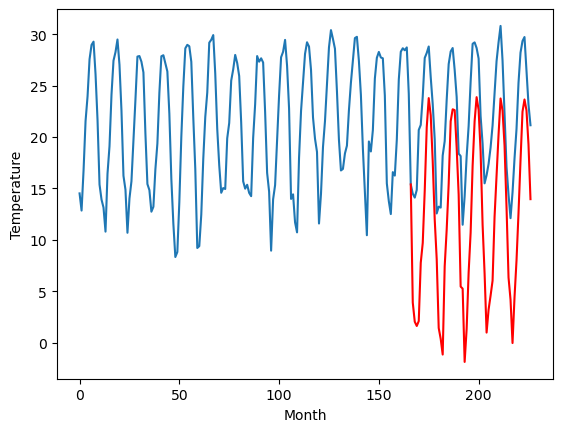

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		6.20		1.27
4.82		4.34		-0.48
4.20		3.93		-0.27
4.82		4.41		-0.41
11.07		10.08		-0.99
10.83		12.02		1.19
14.52		17.11		2.59
18.24		23.26		5.02
20.61		26.10		5.49
19.85		24.42		4.57
16.46		19.95		3.49
12.74		14.29		1.55
7.81		10.42		2.61
0.81		3.72		2.91
1.63		2.66		1.03
2.49		1.14		-1.35
8.47		9.72		1.25
10.11		13.29		3.18
14.09		17.74		3.65
18.23		23.83		5.60
19.99		25.00		5.01
20.27		24.91		4.64
16.70		21.27		4.57
12.82		16.70		3.88
4.46		7.75		3.29
6.64		7.55		0.91
0.63		0.42		-0.21
4.58		3.62		-0.96
8.08		9.11		1.03
10.82		12.99		2.17
16.58		19.51		2.93
20.36		23.84		3.48
21.28		26.18		4.90
20.05		24.95		4.90
16.93		20.90		3.97
9.79		13.77		3.98
7.31		9.03		1.72
2.79		3.29		0.50
4.74		5.52		0.78
7.52		6.88		-0.64
7.50		8.34		0.84
10.57		14.57		4.00
13.98		18.56		4.58
17.30		22.55		5.25
20.40		26.06		5.66
20.01		24.87		4.86
16.56		21.46		4.90
10.58		15.44		4.86
5.49		8.64		3.15
2.46		

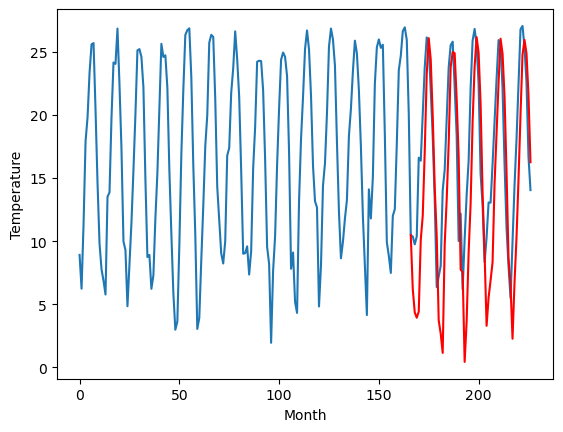

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.60		-0.53
1.11		-1.26		-2.37
1.15		-1.68		-2.83
1.15		-1.18		-2.33
8.07		4.48		-3.59
8.15		6.41		-1.74
11.04		11.50		0.46
13.95		17.66		3.71
14.92		20.49		5.57
15.26		18.82		3.56
12.93		14.35		1.42
8.87		8.68		-0.19
6.03		4.81		-1.22
-1.43		-1.89		-0.46
-1.34		-2.95		-1.61
-2.91		-4.47		-1.56
5.00		4.11		-0.89
6.79		7.68		0.89
10.76		12.14		1.38
14.04		18.23		4.19
14.67		19.40		4.73
14.72		19.31		4.59
12.21		15.67		3.46
9.90		11.11		1.21
1.81		2.16		0.35
4.58		1.96		-2.62
-2.77		-5.15		-2.38
-0.33		-1.95		-1.62
3.46		3.53		0.07
8.25		7.41		-0.84
12.77		13.92		1.15
15.20		18.25		3.05
15.18		20.58		5.40
13.99		19.36		5.37
12.75		15.31		2.56
7.13		8.17		1.04
3.02		3.44		0.42
0.84		-2.30		-3.14
2.28		-0.08		-2.36
2.69		1.28		-1.41
6.21		2.74		-3.47
7.63		8.96		1.33
12.06		12.96		0.90
15.81		16.95		1.14
16.93		20.46		3.53
18.46		19.27		0.81
15.02		15.87		0.85
8.77		9.84		1.07
2.91		3.05		0

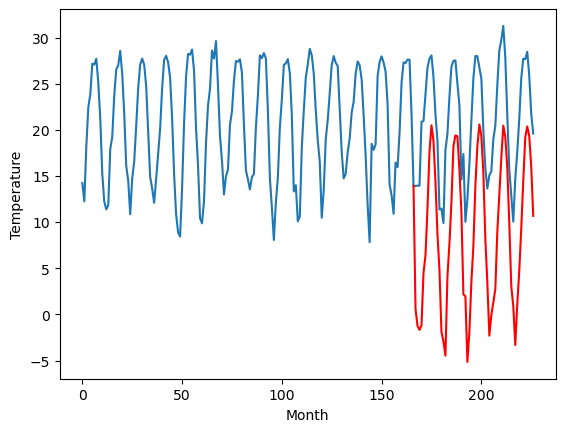

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.93		-1.41
5.29		4.07		-1.22
6.03		3.66		-2.37
5.36		4.15		-1.21
13.11		9.81		-3.30
13.36		11.75		-1.61
18.34		16.84		-1.50
22.54		23.01		0.47
24.15		25.84		1.69
24.64		24.17		-0.47
18.93		19.70		0.77
14.05		14.03		-0.02
11.53		10.16		-1.37
5.06		3.46		-1.60
4.18		2.40		-1.78
1.09		0.88		-0.21
10.99		9.46		-1.53
12.92		13.02		0.10
16.78		17.49		0.71
21.98		23.58		1.60
22.41		24.75		2.34
23.17		24.67		1.50
21.16		21.02		-0.14
16.81		16.46		-0.35
9.24		7.51		-1.73
11.57		7.31		-4.26
3.12		0.19		-2.93
2.89		3.39		0.50
9.38		8.87		-0.51
15.42		12.75		-2.67
20.13		19.26		-0.87
24.47		23.59		-0.88
26.83		25.93		-0.90
24.47		24.71		0.24
21.52		20.67		-0.85
15.60		13.53		-2.07
8.67		8.80		0.13
5.94		3.05		-2.89
6.91		5.27		-1.64
7.04		6.63		-0.41
11.76		8.08		-3.68
13.26		14.31		1.05
18.79		18.30		-0.49
23.34		22.29		-1.05
26.33		25.80		-0.53
28.07		24.61		-3.46
23.59		21.21		-2.38
15.93		15.1

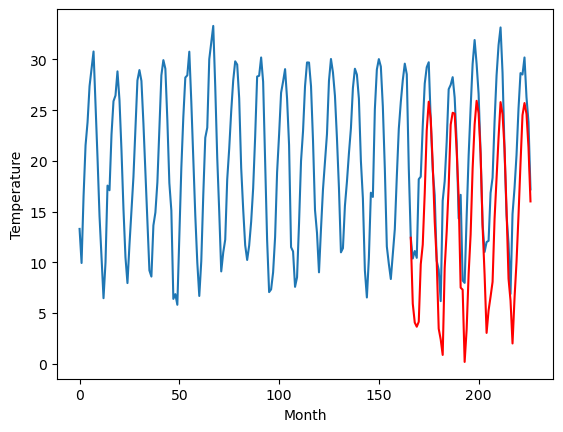

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		5.00		0.37
4.06		3.13		-0.93
3.53		2.72		-0.81
3.22		3.22		-0.00
6.81		8.88		2.07
8.78		10.82		2.04
12.47		15.91		3.44
16.82		22.07		5.25
20.56		24.90		4.34
19.71		23.23		3.52
16.68		18.76		2.08
12.59		13.09		0.50
8.47		9.22		0.75
1.72		2.53		0.81
-0.06		1.47		1.53
0.59		-0.06		-0.65
5.49		8.52		3.03
8.86		12.08		3.22
12.37		16.53		4.16
16.94		22.62		5.68
18.93		23.79		4.86
19.41		23.71		4.30
16.40		20.06		3.66
12.80		15.50		2.70
4.63		6.56		1.93
5.68		6.36		0.68
-0.70		-0.76		-0.06
2.91		2.45		-0.46
6.83		7.93		1.10
9.70		11.81		2.11
14.33		18.32		3.99
17.90		22.65		4.75
20.04		24.99		4.95
19.19		23.77		4.58
16.54		19.72		3.18
9.98		12.58		2.60
8.29		7.85		-0.44
1.77		2.11		0.34
3.46		4.34		0.88
4.95		5.69		0.74
5.86		7.15		1.29
10.54		13.37		2.83
12.06		17.37		5.31
15.88		21.36		5.48
19.71		24.86		5.15
19.23		23.67		4.44
15.71		20.25		4.54
11.36		14.23		2.87
5.92		7.43		1.51
3.78		5.2

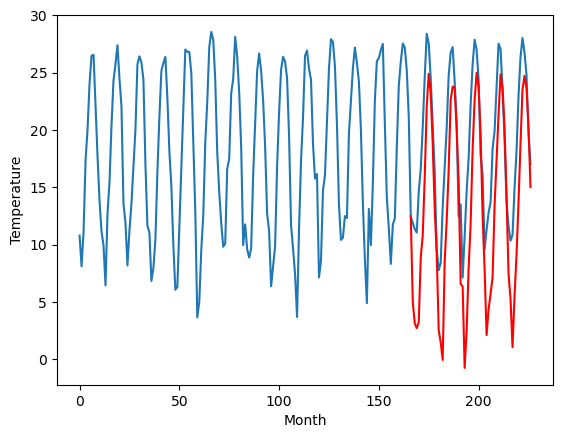

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.47		1.79
0.32		0.60		0.28
-0.15		0.19		0.34
0.96		0.68		-0.28
6.38		6.35		-0.03
7.62		8.28		0.66
9.96		13.37		3.41
15.21		19.53		4.32
18.28		22.36		4.08
17.25		20.69		3.44
13.36		16.21		2.85
9.36		10.54		1.18
5.18		6.67		1.49
-1.75		-0.03		1.72
-2.33		-1.10		1.23
-1.69		-2.62		-0.93
5.29		5.96		0.67
6.32		9.52		3.20
10.03		13.98		3.95
14.36		20.07		5.71
15.98		21.24		5.26
15.92		21.15		5.23
11.87		17.51		5.64
8.64		12.94		4.30
-0.01		4.00		4.01
1.93		3.80		1.87
-4.72		-3.32		1.40
-0.74		-0.12		0.62
3.60		5.37		1.77
6.52		9.24		2.72
11.59		15.75		4.16
15.50		20.09		4.59
16.60		22.42		5.82
15.31		21.20		5.89
12.25		17.15		4.90
5.31		10.01		4.70
3.08		5.28		2.20
-3.43		-0.46		2.97
-0.24		1.77		2.01
2.76		3.12		0.36
3.24		4.57		1.33
6.80		10.80		4.00
9.49		14.80		5.31
12.84		18.78		5.94
16.55		22.28		5.73
15.86		21.09		5.23
12.35		17.67		5.32
7.14		11.64		4.50
1.27		4.85		3.58
-1.02		2.69

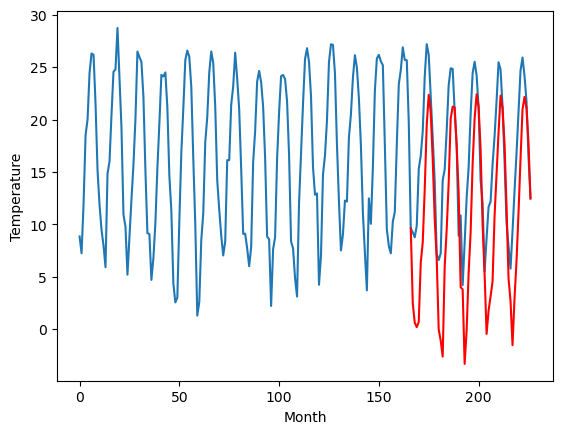

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.53		1.90
-1.74		-1.34		0.40
-1.86		-1.75		0.11
-0.82		-1.27		-0.45
4.76		4.40		-0.36
5.66		6.34		0.68
8.78		11.43		2.65
14.30		17.58		3.28
17.56		20.42		2.86
16.19		18.74		2.55
11.32		14.27		2.95
7.48		8.60		1.12
3.25		4.73		1.48
-3.68		-1.98		1.70
-4.62		-3.05		1.57
-4.00		-4.57		-0.57
2.52		4.01		1.49
6.15		7.57		1.42
9.17		12.03		2.86
13.96		18.12		4.16
16.08		19.29		3.21
16.03		19.19		3.16
11.52		15.55		4.03
7.67		10.99		3.32
-1.83		2.04		3.87
0.23		1.84		1.61
-6.95		-5.28		1.67
-2.71		-2.08		0.63
2.13		3.42		1.29
5.45		7.29		1.84
10.43		13.80		3.37
14.43		18.13		3.70
16.30		20.47		4.17
14.62		19.24		4.62
10.92		15.19		4.27
3.73		8.05		4.32
1.53		3.33		1.80
-5.64		-2.42		3.22
-2.47		-0.18		2.29
0.50		1.16		0.66
1.18		2.61		1.43
5.80		8.83		3.03
8.09		12.84		4.75
11.84		16.82		4.98
15.98		20.32		4.34
14.84		19.13		4.29
11.08		15.71		4.63
5.69		9.68		3.99
-0.76		2.88		3.64
-2.35		0

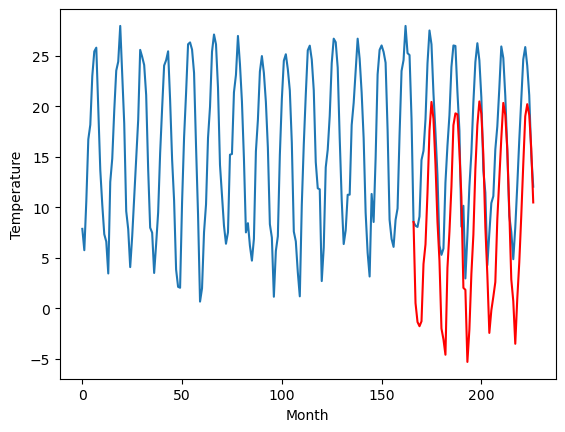

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.44		0.51
-1.11		-2.31		-1.20
-2.30		-2.73		-0.43
-1.80		-2.24		-0.44
4.77		3.43		-1.34
7.05		5.37		-1.68
11.93		10.46		-1.47
17.86		16.62		-1.24
20.60		19.45		-1.15
17.59		17.78		0.19
14.03		13.31		-0.72
6.77		7.63		0.86
3.91		3.76		-0.15
-2.80		-2.94		-0.14
-3.59		-4.00		-0.41
-7.86		-5.53		2.33
4.61		3.05		-1.56
7.21		6.63		-0.58
11.90		11.08		-0.82
18.09		17.17		-0.92
18.66		18.35		-0.31
18.60		18.26		-0.34
14.86		14.61		-0.25
10.90		10.04		-0.86
0.86		1.10		0.24
2.66		0.90		-1.76
-5.85		-6.23		-0.38
-3.81		-3.03		0.78
3.41		2.46		-0.95
7.36		6.34		-1.02
14.20		12.85		-1.35
18.72		17.18		-1.54
21.05		19.52		-1.53
18.17		18.30		0.13
14.53		14.25		-0.28
7.97		7.12		-0.85
2.00		2.39		0.39
-3.29		-3.36		-0.07
-0.73		-1.13		-0.40
0.88		0.21		-0.67
2.70		1.66		-1.04
8.48		7.89		-0.59
14.07		11.90		-2.17
17.94		15.88		-2.06
19.43		19.38		-0.05
18.17		18.20		0.03
15.00		14.78		-0.22
9.40

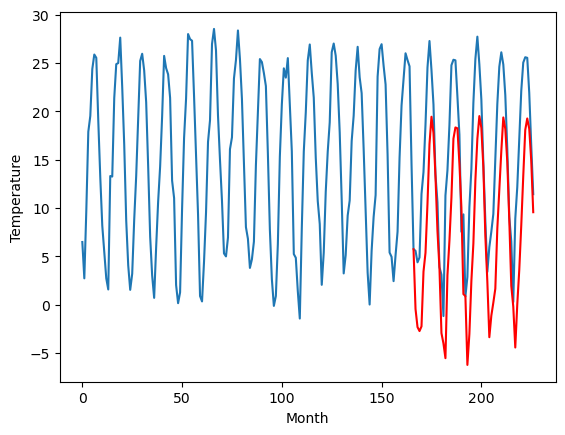

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-1.83		2.73
-4.38		-3.70		0.68
-5.66		-4.12		1.54
-6.53		-3.63		2.90
0.66		2.04		1.38
2.32		3.99		1.67
7.41		9.09		1.68
14.39		15.23		0.84
17.02		18.07		1.05
14.64		16.39		1.75
10.97		11.92		0.95
4.58		6.25		1.67
0.90		2.38		1.48
-6.61		-4.32		2.29
-8.20		-5.38		2.82
-10.37		-6.92		3.45
0.38		1.67		1.29
3.44		5.25		1.81
7.91		9.70		1.79
14.39		15.80		1.41
15.40		16.96		1.56
16.00		16.88		0.88
12.14		13.23		1.09
7.67		8.66		0.99
-2.99		-0.28		2.71
-1.76		-0.47		1.29
-10.73		-7.61		3.12
-7.15		-4.41		2.74
-0.17		1.08		1.25
2.56		4.96		2.40
10.73		11.47		0.74
14.63		15.80		1.17
16.66		18.15		1.49
14.75		16.93		2.18
11.02		12.88		1.86
3.98		5.75		1.77
-1.04		1.02		2.06
-6.75		-4.73		2.02
-4.86		-2.50		2.36
-2.82		-1.15		1.67
-2.48		0.29		2.77
3.80		6.52		2.72
8.76		10.53		1.77
12.60		14.51		1.91
15.43		18.02		2.59
14.63		16.83		2.20
12.02		13.41		1.39
5.44		7.37		1.93
-1.06		0.58		1.64
-3

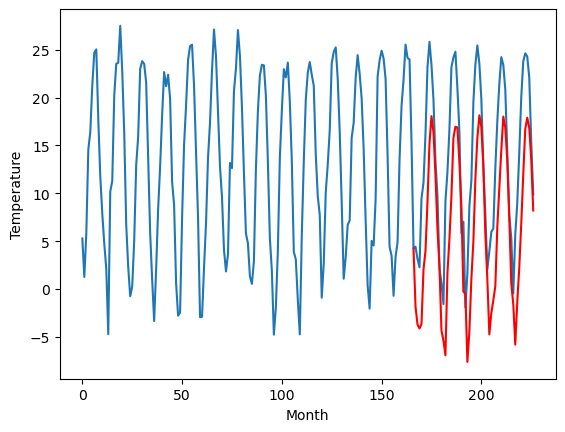

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.03		2.03
-5.73		-4.90		0.83
-6.76		-5.31		1.45
-8.22		-4.83		3.39
-2.08		0.85		2.93
0.57		2.80		2.23
7.00		7.90		0.90
14.96		14.05		-0.91
18.12		16.88		-1.24
15.43		15.21		-0.22
10.60		10.75		0.15
3.85		5.08		1.23
0.37		1.20		0.83
-6.66		-5.50		1.16
-8.27		-6.56		1.71
-12.58		-8.10		4.48
-0.85		0.49		1.34
3.12		4.07		0.95
8.27		8.53		0.26
15.58		14.63		-0.95
16.17		15.79		-0.38
16.88		15.70		-1.18
12.83		12.05		-0.78
8.48		7.49		-0.99
-2.38		-1.46		0.92
-3.28		-1.65		1.63
-12.23		-8.78		3.45
-8.99		-5.58		3.41
-2.08		-0.09		1.99
1.53		3.80		2.27
10.85		10.32		-0.53
15.61		14.65		-0.96
16.72		17.01		0.29
15.60		15.79		0.19
11.76		11.75		-0.01
4.52		4.62		0.10
-0.51		-0.11		0.40
-6.69		-5.86		0.83
-5.56		-3.62		1.94
-5.15		-2.27		2.88
-3.29		-0.83		2.46
3.56		5.40		1.84
8.58		9.40		0.82
14.09		13.40		-0.69
16.55		16.90		0.35
14.74		15.72		0.98
12.36		12.29		-0.07
6.40		6.26		-0.14
-1

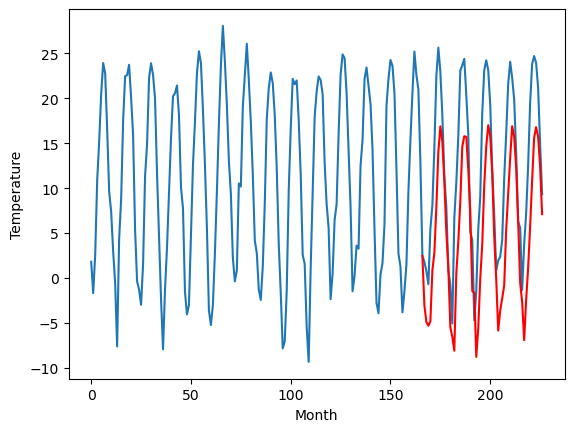

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.022163
1                 1    3.39   3.901029
2                 2    4.93   6.202807
3                 3    1.13   0.598658
4                 4    7.34   5.927352
5                 5    4.63   4.996560
6                 6    0.68   2.473168
7                 7   -1.37   0.533299
8                 8   -0.95  -0.440496
9                 9   -4.56  -1.829491
10               10   -5.06  -3.028118


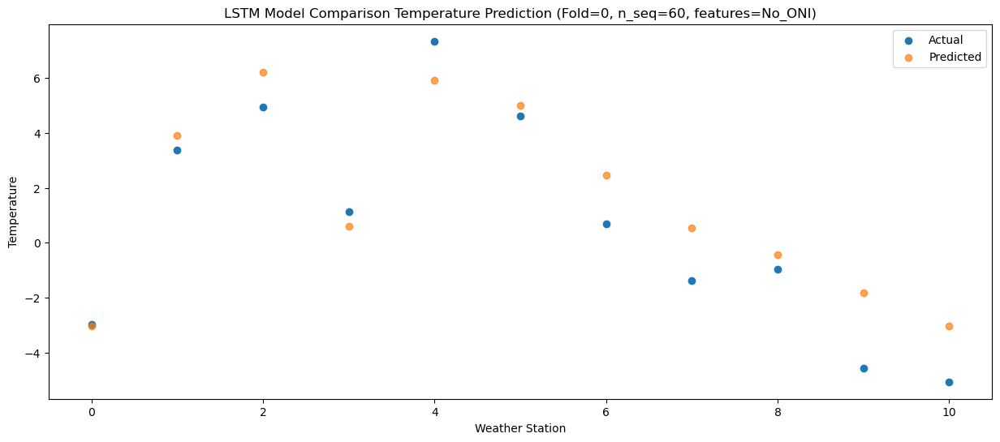

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -4.887357
1                 1    2.49   2.035829
2                 2    4.82   4.339973
3                 3    1.11  -1.261587
4                 4    5.29   4.065812
5                 5    4.06   3.131078
6                 6    0.32   0.603812
7                 7   -1.74  -1.337123
8                 8   -1.11  -2.312652
9                 9   -4.38  -3.700623
10               10   -5.73  -4.902510


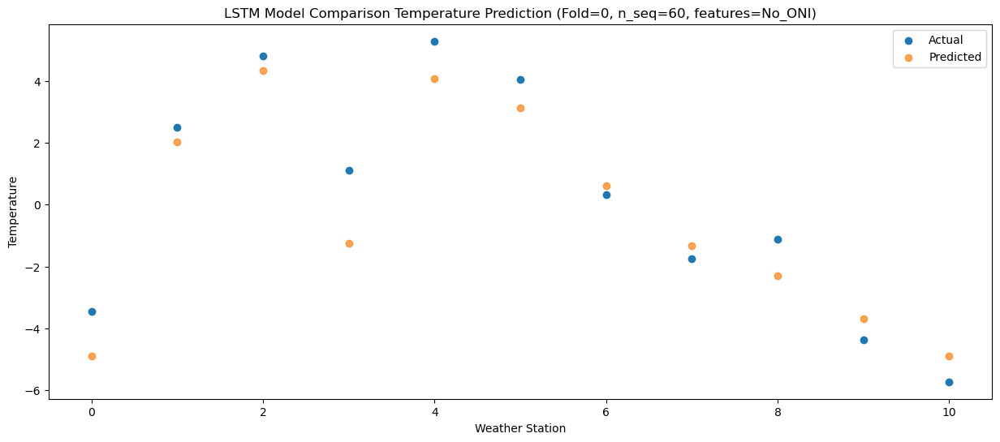

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -5.296190
1                 1    2.11   1.624078
2                 2    4.20   3.927494
3                 3    1.15  -1.678464
4                 4    6.03   3.656745
5                 5    3.53   2.722247
6                 6   -0.15   0.191588
7                 7   -1.86  -1.753055
8                 8   -2.30  -2.726183
9                 9   -5.66  -4.116717
10               10   -6.76  -5.314650


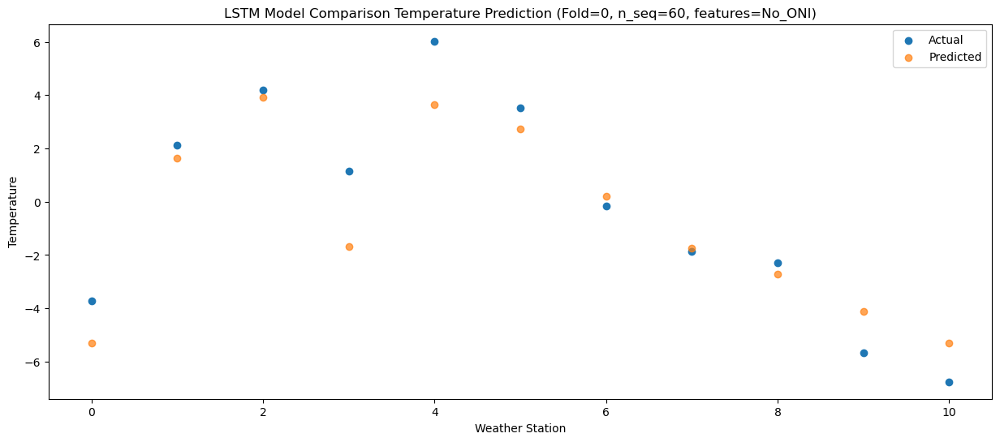

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -4.817164
1                 1    2.86   2.102055
2                 2    4.82   4.411186
3                 3    1.15  -1.182882
4                 4    5.36   4.147823
5                 5    3.22   3.215278
6                 6    0.96   0.680115
7                 7   -0.82  -1.265548
8                 8   -1.80  -2.240933
9                 9   -6.53  -3.634104
10               10   -8.22  -4.829505


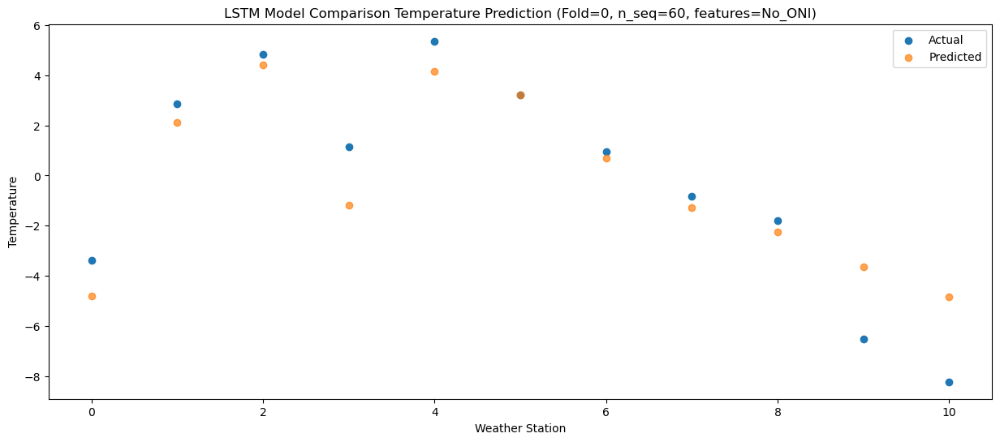

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21   0.855370
1                 1    8.69   7.768486
2                 2   11.07  10.079020
3                 3    8.07   4.479732
4                 4   13.11   9.814293
5                 5    6.81   8.883769
6                 6    6.38   6.345228
7                 7    4.76   4.401458
8                 8    4.77   3.428111
9                 9    0.66   2.039322
10               10   -2.08   0.847743


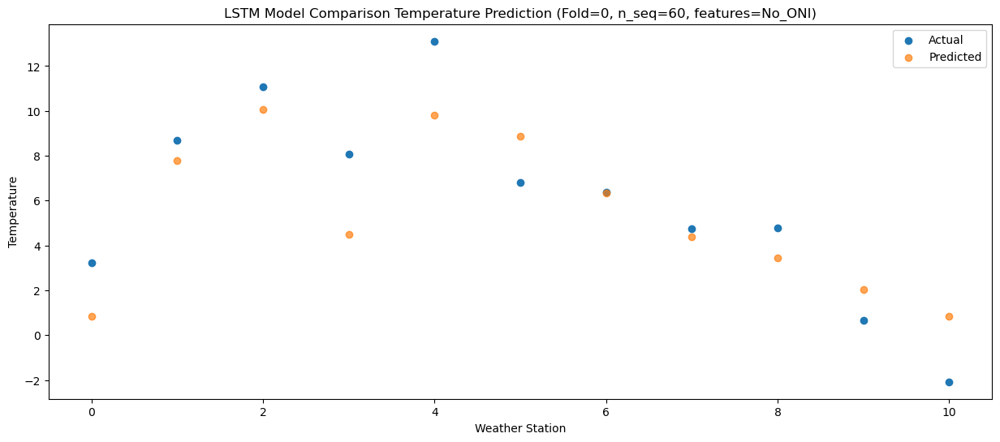

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.793116
1                 1    9.18   9.703065
2                 2   10.83  12.015316
3                 3    8.15   6.408560
4                 4   13.36  11.746554
5                 5    8.78  10.821713
6                 6    7.62   8.281765
7                 7    5.66   6.339412
8                 8    7.05   5.371793
9                 9    2.32   3.986197
10               10    0.57   2.798918


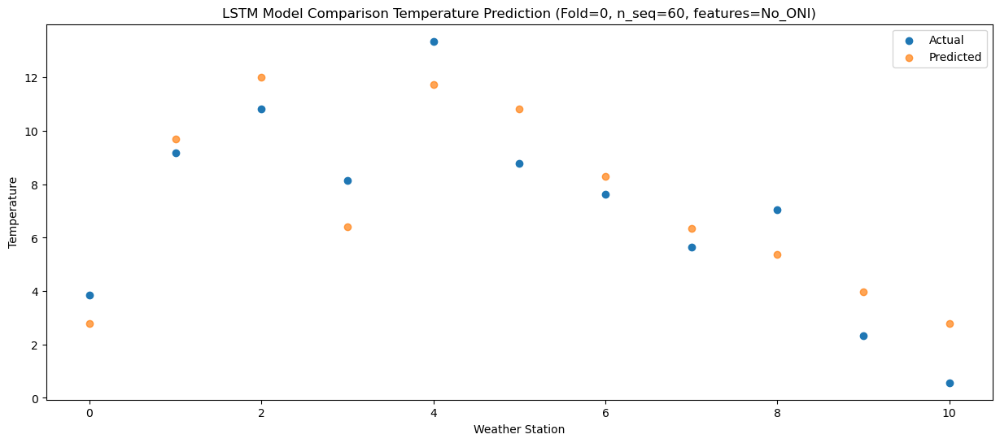

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   7.891576
1                 1   11.95  14.796873
2                 2   14.52  17.109931
3                 3   11.04  11.499572
4                 4   18.34  16.842886
5                 5   12.47  15.911132
6                 6    9.96  13.373082
7                 7    8.78  11.429264
8                 8   11.93  10.464026
9                 9    7.41   9.085319
10               10    7.00   7.903275


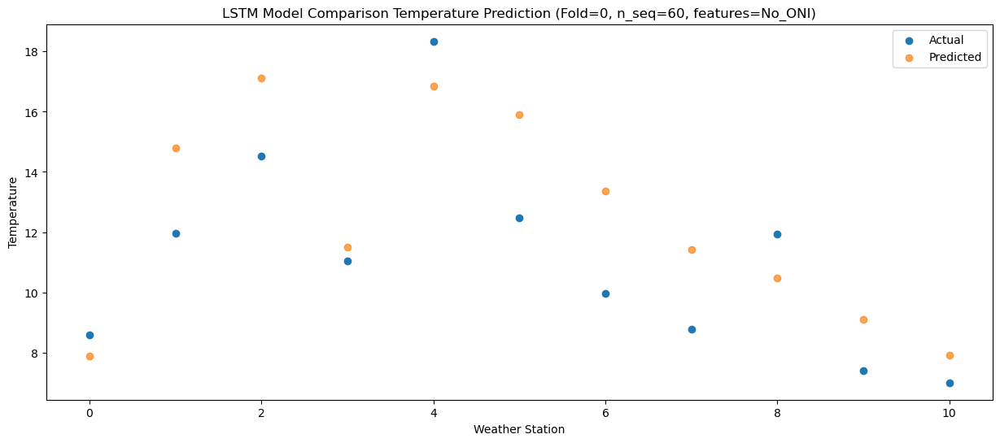

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  14.051071
1                 1   15.70  20.950189
2                 2   18.24  23.260091
3                 3   13.95  17.655733
4                 4   22.54  23.005464
5                 5   16.82  22.065980
6                 6   15.21  19.530402
7                 7   14.30  17.584623
8                 8   17.86  16.620493
9                 9   14.39  15.232591
10               10   14.96  14.050438


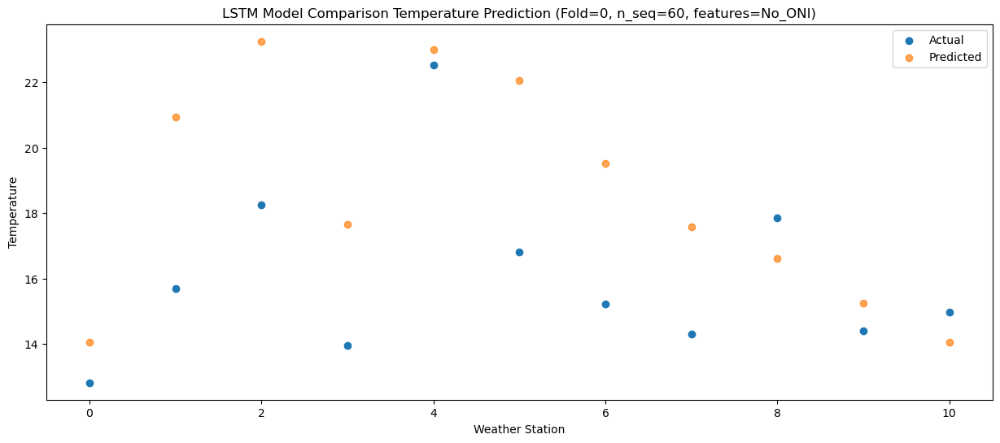

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  16.892937
1                 1   16.18  23.789033
2                 2   20.61  26.101574
3                 3   14.92  20.491153
4                 4   24.15  25.841969
5                 5   20.56  24.903194
6                 6   18.28  22.364808
7                 7   17.56  20.415620
8                 8   20.60  19.453503
9                 9   17.02  18.067644
10               10   18.12  16.883032


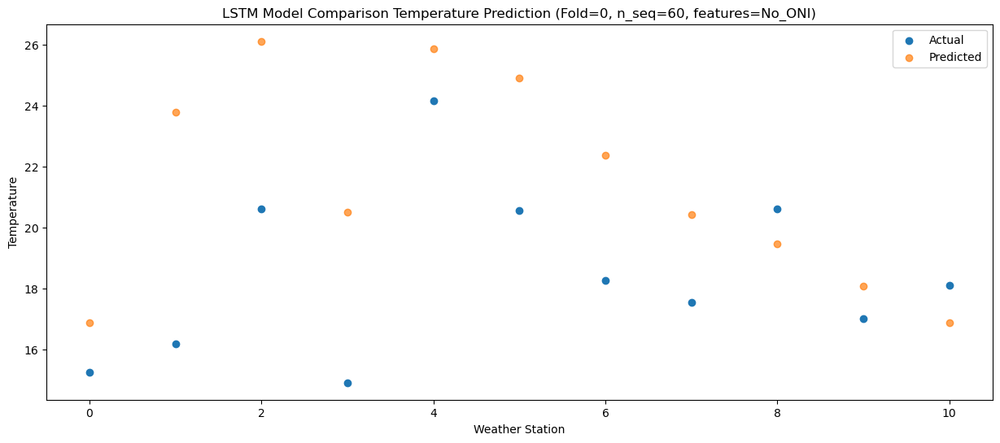

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  15.218051
1                 1   16.81  22.120034
2                 2   19.85  24.422729
3                 3   15.26  18.818450
4                 4   24.64  24.170163
5                 5   19.71  23.233169
6                 6   17.25  20.691178
7                 7   16.19  18.742117
8                 8   17.59  17.777494
9                 9   14.64  16.394964
10               10   15.43  15.213637


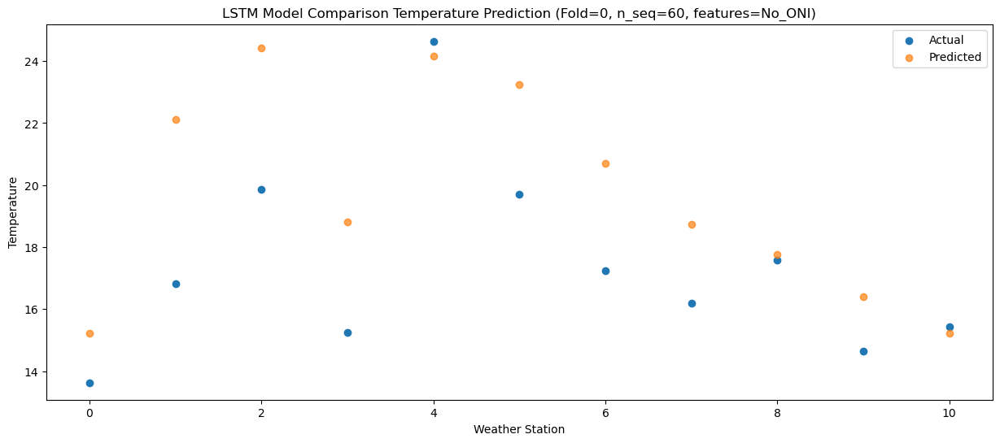

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57  10.753853
1                 1   13.83  17.651202
2                 2   16.46  19.953750
3                 3   12.93  14.346436
4                 4   18.93  19.699100
5                 5   16.68  18.757779
6                 6   13.36  16.214609
7                 7   11.32  14.265737
8                 8   14.03  13.306562
9                 9   10.97  11.922813
10               10   10.60  10.746200


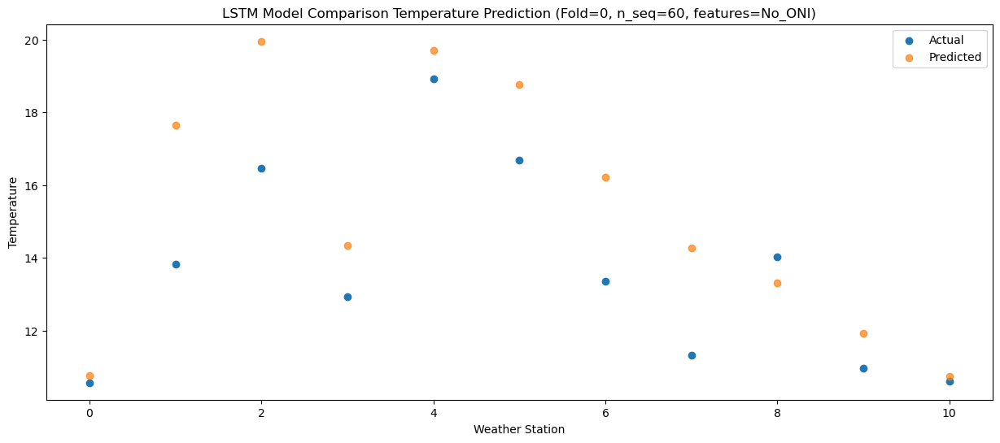

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   5.082347
1                 1   11.20  11.987615
2                 2   12.74  14.287821
3                 3    8.87   8.681042
4                 4   14.05  14.028822
5                 5   12.59  13.091292
6                 6    9.36  10.544562
7                 7    7.48   8.596805
8                 8    6.77   7.633707
9                 9    4.58   6.252266
10               10    3.85   5.077050


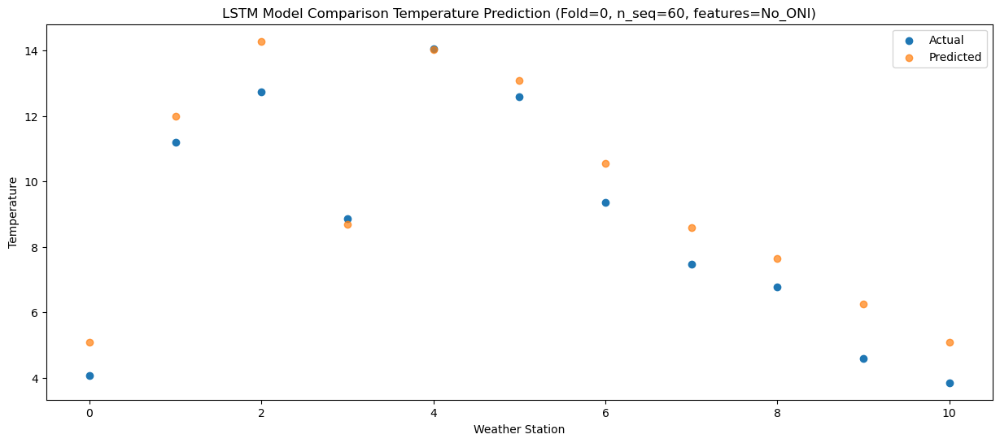

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   1.204622
1                 1    7.78   8.116612
2                 2    7.81  10.417898
3                 3    6.03   4.808392
4                 4   11.53  10.156356
5                 5    8.47   9.221879
6                 6    5.18   6.674887
7                 7    3.25   4.726774
8                 8    3.91   3.761748
9                 9    0.90   2.380822
10               10    0.37   1.203700


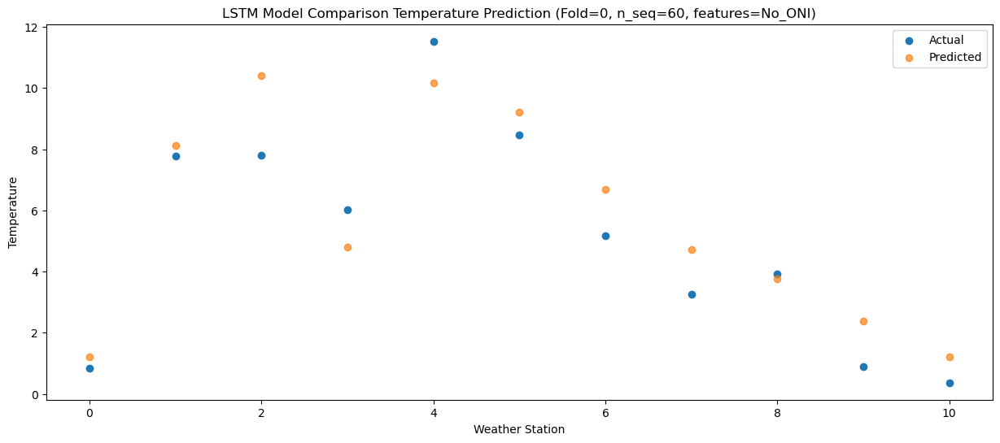

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -5.475631
1                 1    0.57   1.427982
2                 2    0.81   3.724532
3                 3   -1.43  -1.891887
4                 4    5.06   3.463525
5                 5    1.72   2.526125
6                 6   -1.75  -0.029969
7                 7   -3.68  -1.980558
8                 8   -2.80  -2.940098
9                 9   -6.61  -4.323059
10               10   -6.66  -5.498957


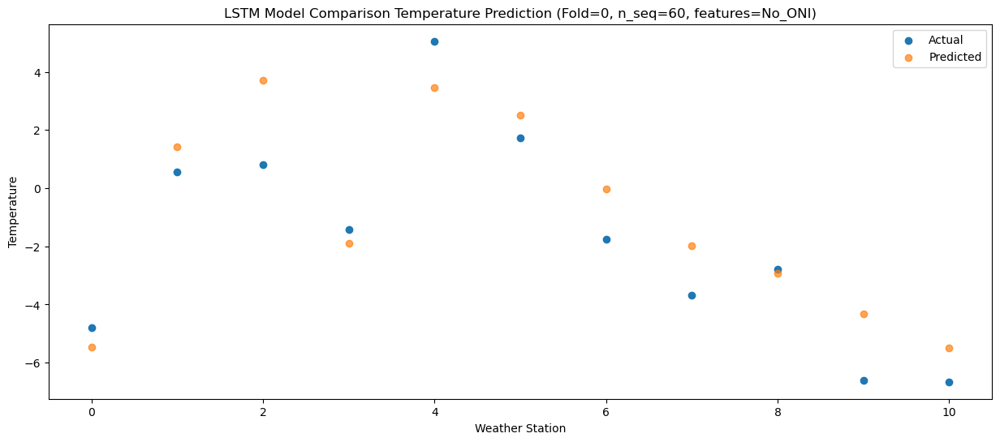

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -6.531567
1                 1    1.23   0.372159
2                 2    1.63   2.662864
3                 3   -1.34  -2.947514
4                 4    4.18   2.402507
5                 5   -0.06   1.466119
6                 6   -2.33  -1.096647
7                 7   -4.62  -3.048866
8                 8   -3.59  -4.004822
9                 9   -8.20  -5.384688
10               10   -8.27  -6.556201


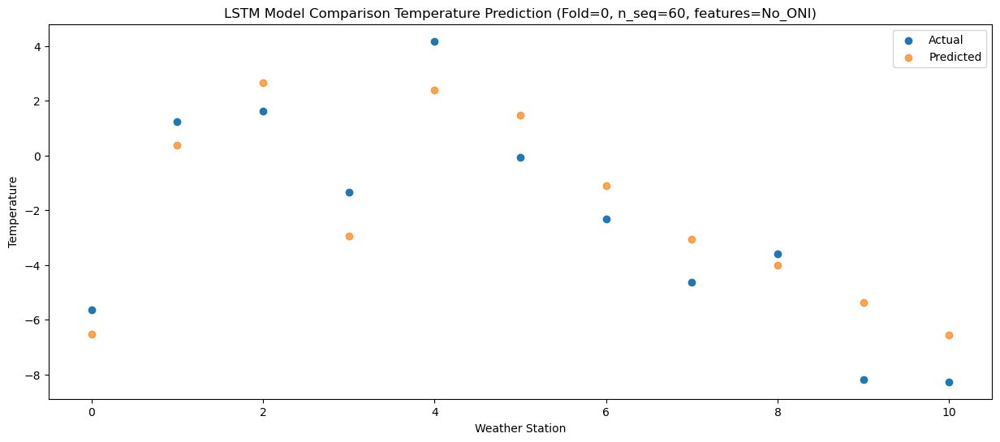

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -8.058351
1                 1    1.14  -1.155128
2                 2    2.49   1.137350
3                 3   -2.91  -4.470647
4                 4    1.09   0.877078
5                 5    0.59  -0.060246
6                 6   -1.69  -2.620228
7                 7   -4.00  -4.572266
8                 8   -7.86  -5.530053
9                 9  -10.37  -6.915912
10               10  -12.58  -8.095552


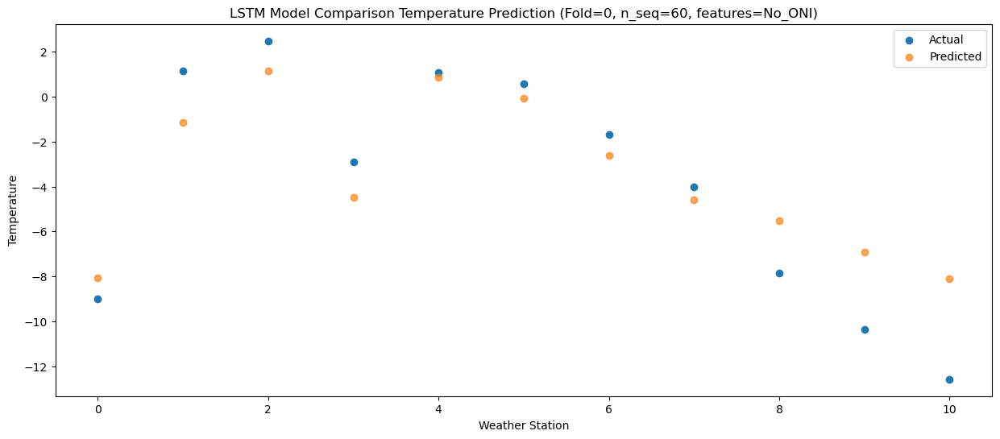

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07   0.517354
1                 1    6.20   7.425844
2                 2    8.47   9.720498
3                 3    5.00   4.112501
4                 4   10.99   9.461725
5                 5    5.49   8.517089
6                 6    5.29   5.957750
7                 7    2.52   4.006384
8                 8    4.61   3.054655
9                 9    0.38   1.671546
10               10   -0.85   0.491252


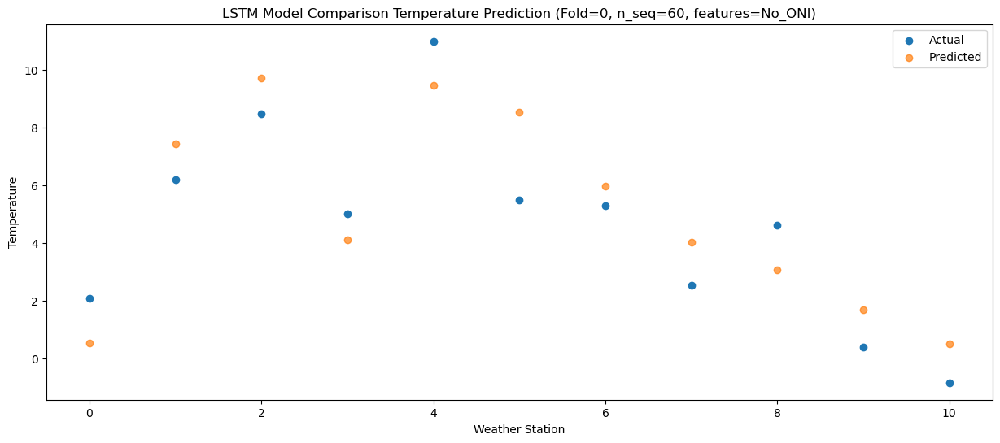

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   4.081051
1                 1    7.60  10.997015
2                 2   10.11  13.287197
3                 3    6.79   7.679812
4                 4   12.92  13.024619
5                 5    8.86  12.081568
6                 6    6.32   9.523252
7                 7    6.15   7.574949
8                 8    7.21   6.628526
9                 9    3.44   5.249673
10               10    3.12   4.073064


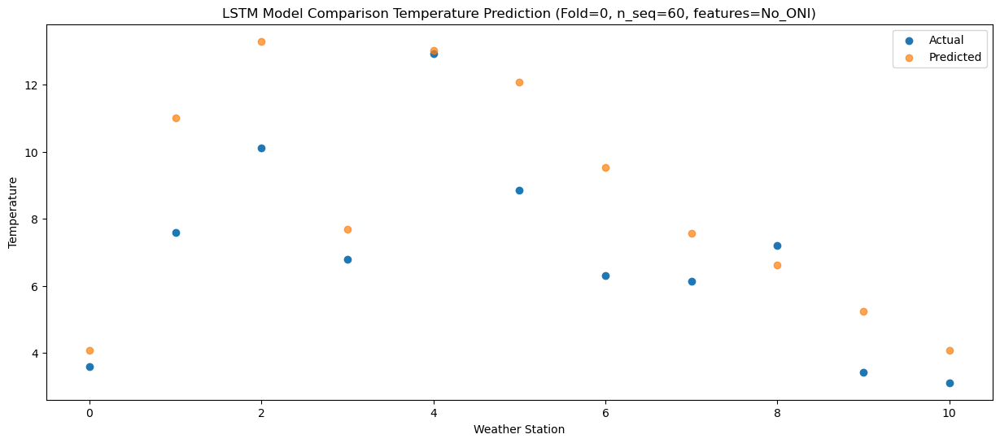

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   8.535864
1                 1   11.62  15.447297
2                 2   14.09  17.741088
3                 3   10.76  12.137827
4                 4   16.78  17.486210
5                 5   12.37  16.533405
6                 6   10.03  13.981910
7                 7    9.17  12.029894
8                 8   11.90  11.082254
9                 9    7.91   9.704325
10               10    8.27   8.531407


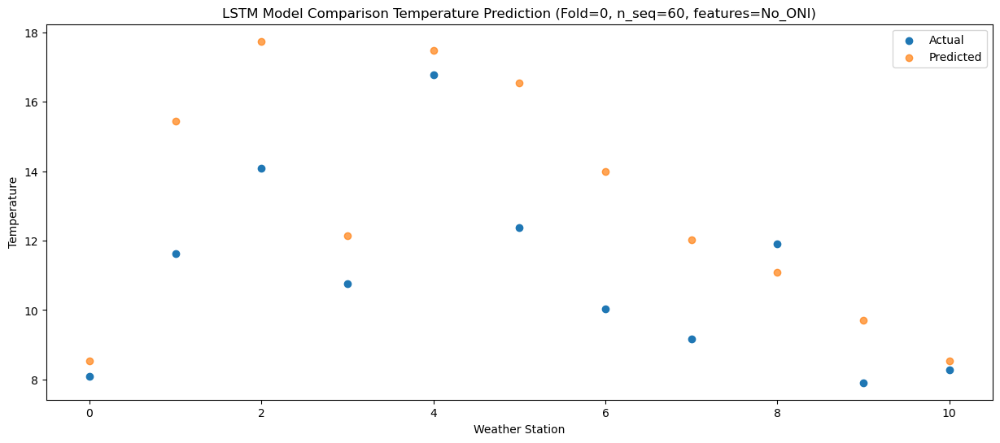

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  14.626209
1                 1   15.10  21.533569
2                 2   18.23  23.830201
3                 3   14.04  18.230628
4                 4   21.98  23.575941
5                 5   16.94  22.623197
6                 6   14.36  20.070495
7                 7   13.96  18.117737
8                 8   18.09  17.173288
9                 9   14.39  15.796331
10               10   15.58  14.627533


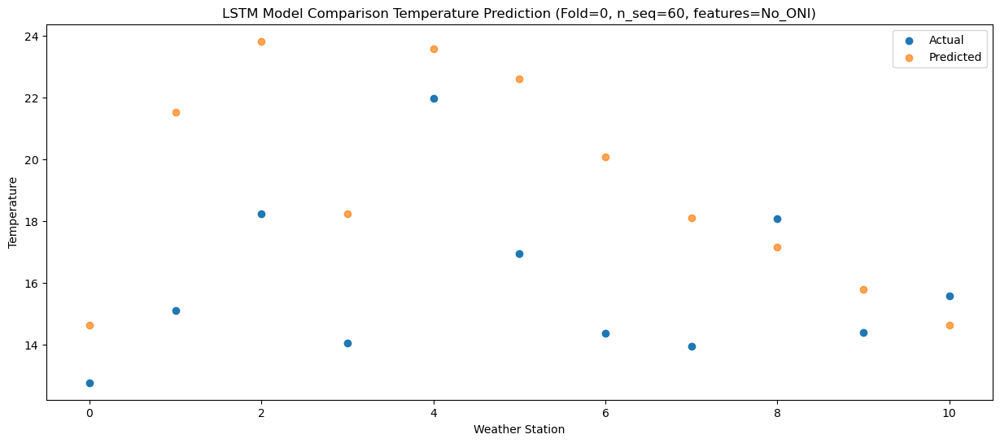

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  15.802696
1                 1   16.32  22.700779
2                 2   19.99  24.995653
3                 3   14.67  19.395314
4                 4   22.41  24.750080
5                 5   18.93  23.793799
6                 6   15.98  21.241148
7                 7   16.08  19.288155
8                 8   18.66  18.345998
9                 9   15.40  16.964178
10               10   16.17  15.790934


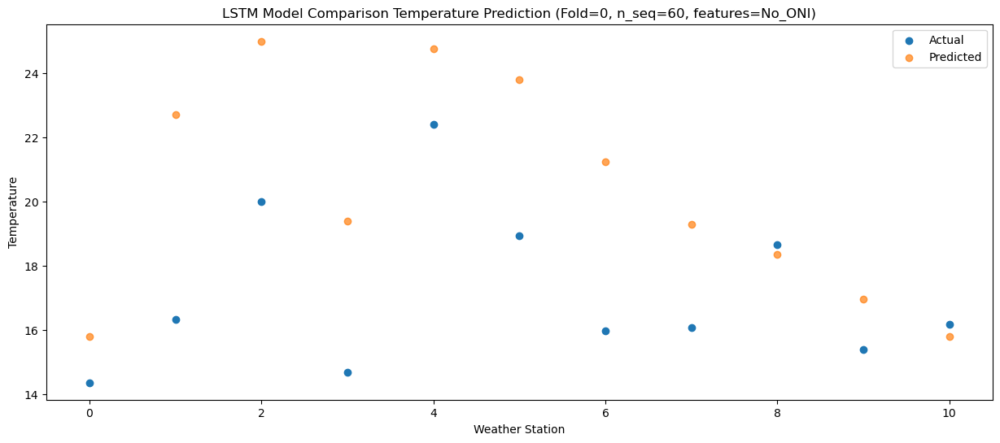

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  15.732456
1                 1   16.66  22.617678
2                 2   20.27  24.911155
3                 3   14.72  19.312722
4                 4   23.17  24.668651
5                 5   19.41  23.706115
6                 6   15.92  21.147797
7                 7   16.03  19.190717
8                 8   18.60  18.257340
9                 9   16.00  16.875197
10               10   16.88  15.701827


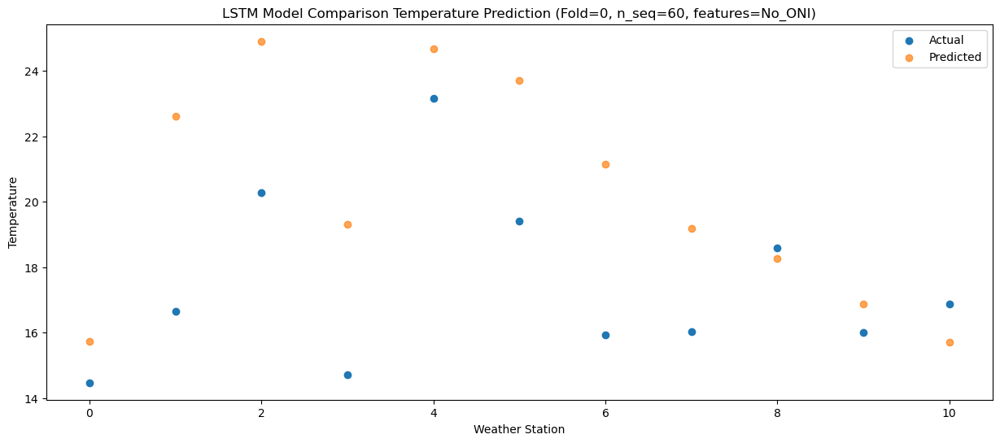

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89  12.078773
1                 1   14.53  18.973795
2                 2   16.70  21.266952
3                 3   12.21  15.671531
4                 4   21.16  21.022408
5                 5   16.40  20.061862
6                 6   11.87  17.507387
7                 7   11.52  15.552008
8                 8   14.86  14.609381
9                 9   12.14  13.226915
10               10   12.83  12.049728


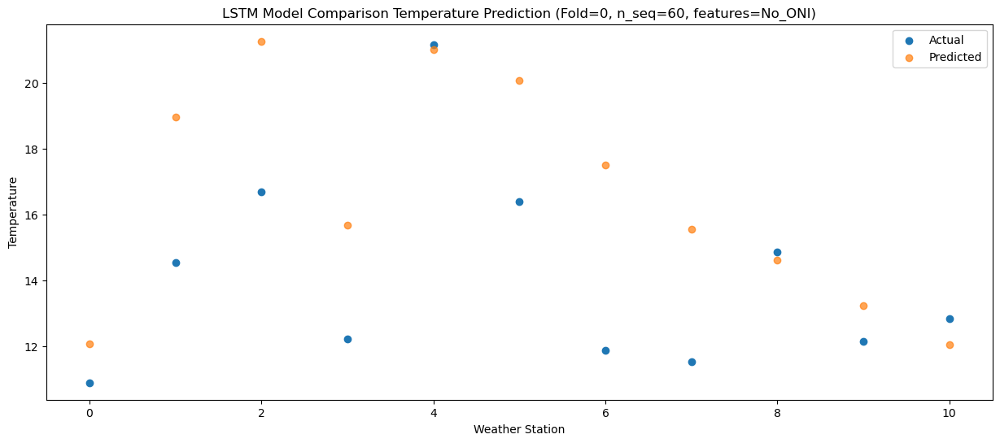

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   7.512953
1                 1   11.90  14.407866
2                 2   12.82  16.702316
3                 3    9.90  11.109318
4                 4   16.81  16.459837
5                 5   12.80  15.501294
6                 6    8.64  12.941247
7                 7    7.67  10.985524
8                 8   10.90  10.040290
9                 9    7.67   8.660893
10               10    8.48   7.488761


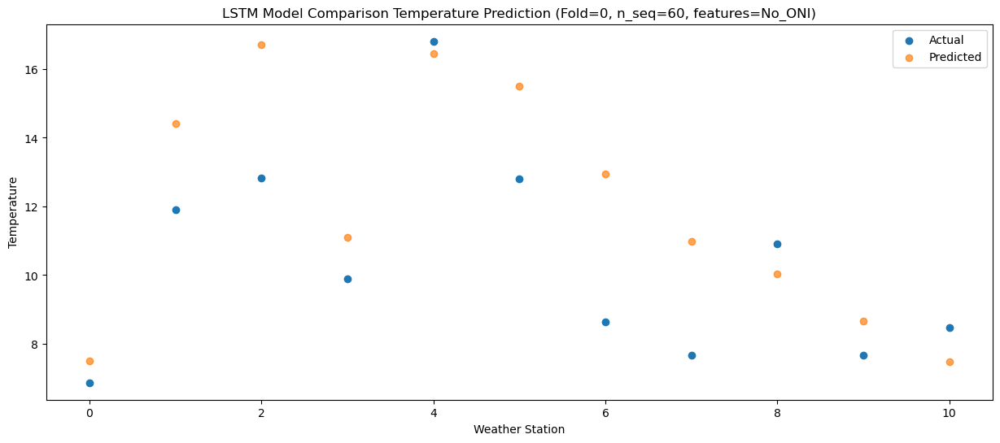

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -1.437284
1                 1    6.39   5.456894
2                 2    4.46   7.749830
3                 3    1.81   2.163621
4                 4    9.24   7.508884
5                 5    4.63   6.557122
6                 6   -0.01   3.997594
7                 7   -1.83   2.038469
8                 8    0.86   1.097731
9                 9   -2.99  -0.280192
10               10   -2.38  -1.457547


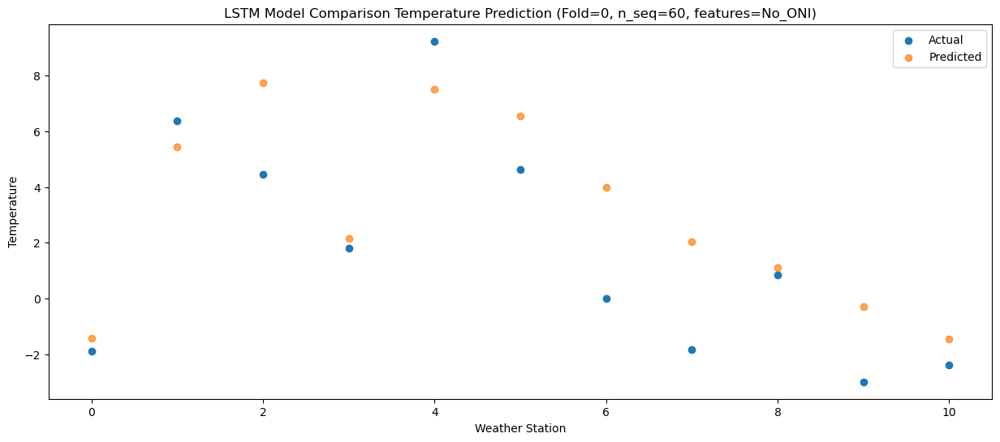

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -1.637005
1                 1    6.15   5.253333
2                 2    6.64   7.548273
3                 3    4.58   1.962276
4                 4   11.57   7.307962
5                 5    5.68   6.359767
6                 6    1.93   3.802176
7                 7    0.23   1.844342
8                 8    2.66   0.900631
9                 9   -1.76  -0.473578
10               10   -3.28  -1.648235


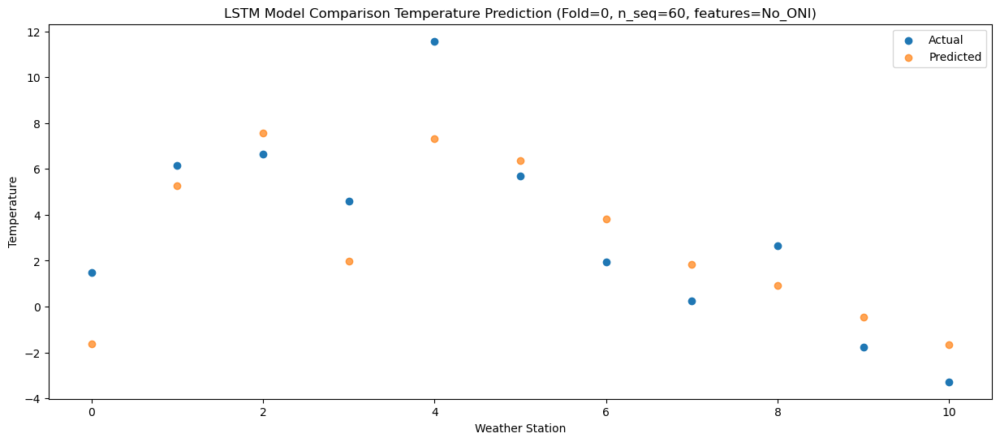

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76  -8.769941
1                 1   -0.53  -1.872419
2                 2    0.63   0.423207
3                 3   -2.77  -5.153079
4                 4    3.12   0.187522
5                 5   -0.70  -0.758324
6                 6   -4.72  -3.321071
7                 7   -6.95  -5.282411
8                 8   -5.85  -6.228775
9                 9  -10.73  -7.610214
10               10  -12.23  -8.780112


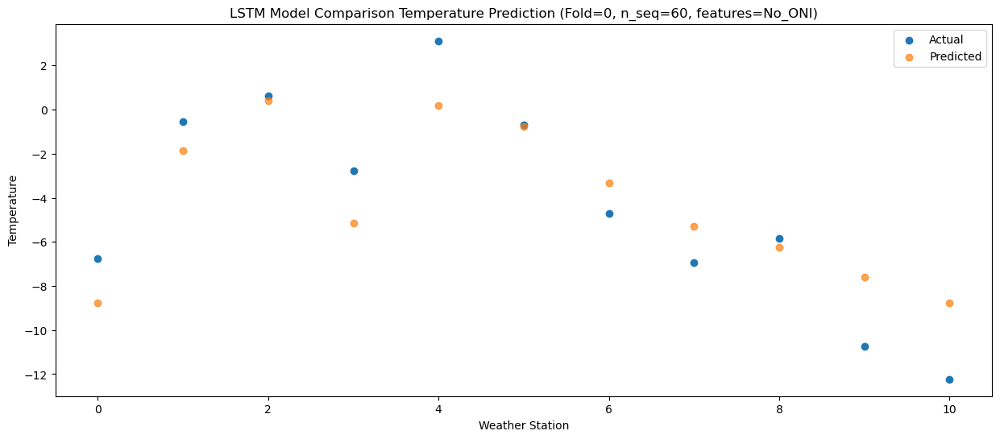

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -5.574548
1                 1    2.24   1.325353
2                 2    4.58   3.624445
3                 3   -0.33  -1.952206
4                 4    2.89   3.385712
5                 5    2.91   2.448679
6                 6   -0.74  -0.116283
7                 7   -2.71  -2.077194
8                 8   -3.81  -3.026293
9                 9   -7.15  -4.409162
10               10   -8.99  -5.580065


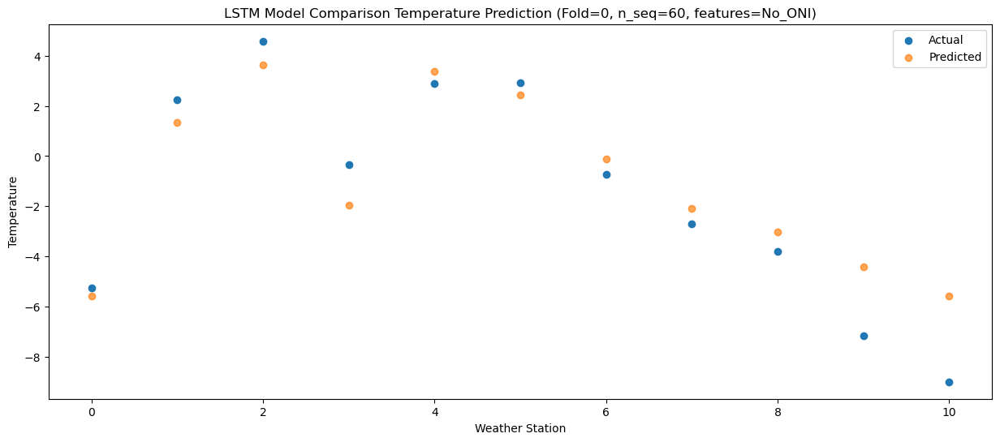

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -0.087188
1                 1    6.10   6.814625
2                 2    8.08   9.111187
3                 3    3.46   3.532336
4                 4    9.38   8.869036
5                 5    6.83   7.933505
6                 6    3.60   5.373312
7                 7    2.13   3.417253
8                 8    3.41   2.460583
9                 9   -0.17   1.082161
10               10   -2.08  -0.086044


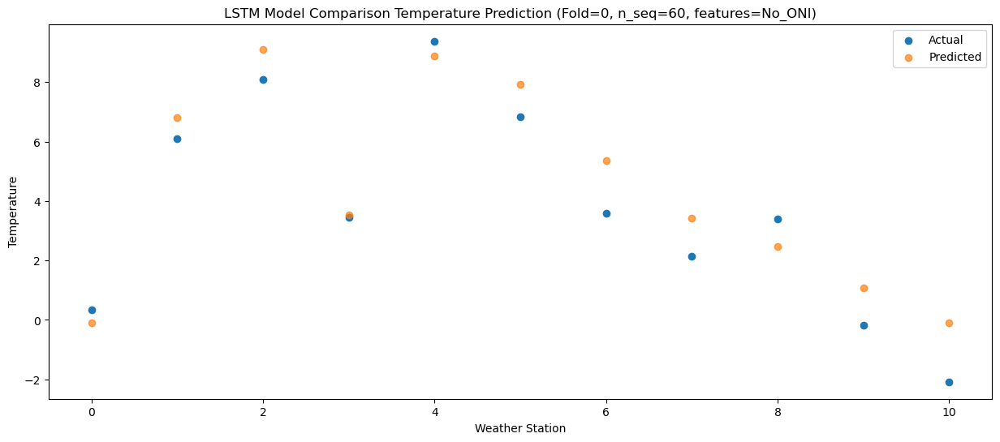

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47   3.799510
1                 1    9.07  10.698044
2                 2   10.82  12.991630
3                 3    8.25   7.408311
4                 4   15.42  12.751916
5                 5    9.70  11.811960
6                 6    6.52   9.244139
7                 7    5.45   7.288856
8                 8    7.36   6.337487
9                 9    2.56   4.957531
10               10    1.53   3.796273


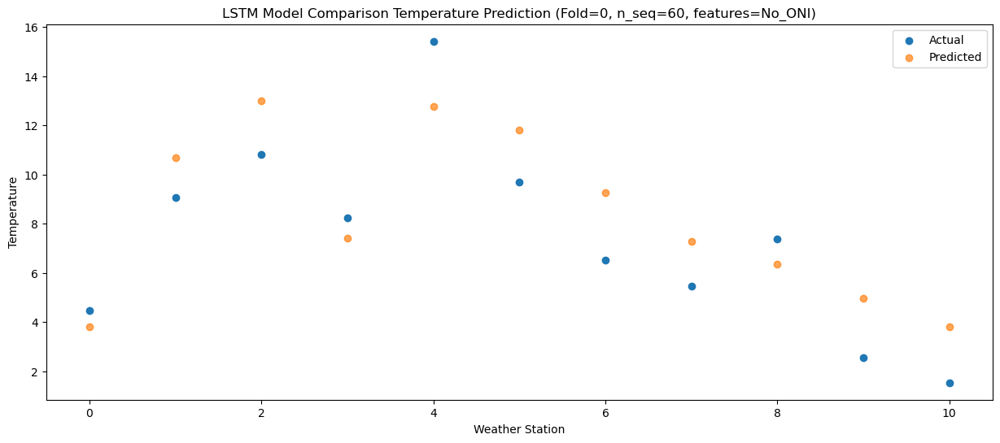

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66  10.309256
1                 1   13.38  17.213249
2                 2   16.58  19.505093
3                 3   12.77  13.920677
4                 4   20.13  19.259523
5                 5   14.33  18.316006
6                 6   11.59  15.750552
7                 7   10.43  13.796203
8                 8   14.20  12.848925
9                 9   10.73  11.472278
10               10   10.85  10.319309


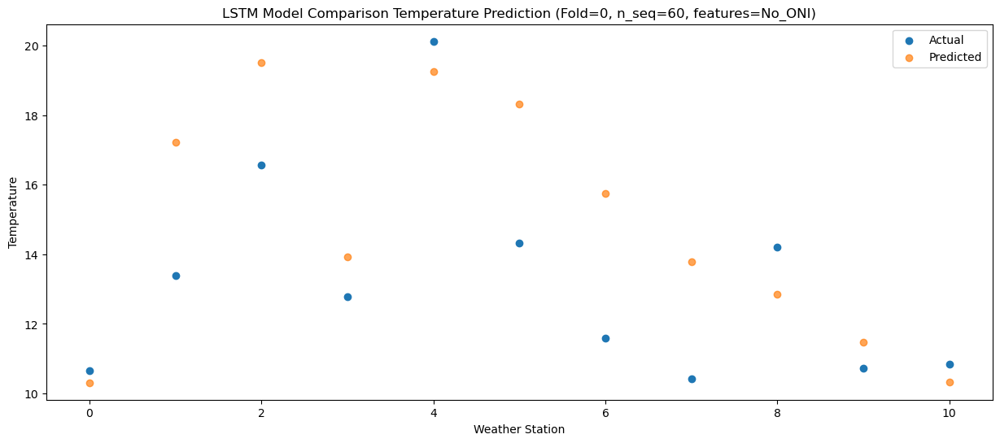

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87  14.633341
1                 1   17.07  21.544956
2                 2   20.36  23.841211
3                 3   15.20  18.247746
4                 4   24.47  23.587097
5                 5   17.90  22.648565
6                 6   15.50  20.085614
7                 7   14.43  18.130016
8                 8   18.72  17.178057
9                 9   14.63  15.804486
10               10   15.61  14.654333


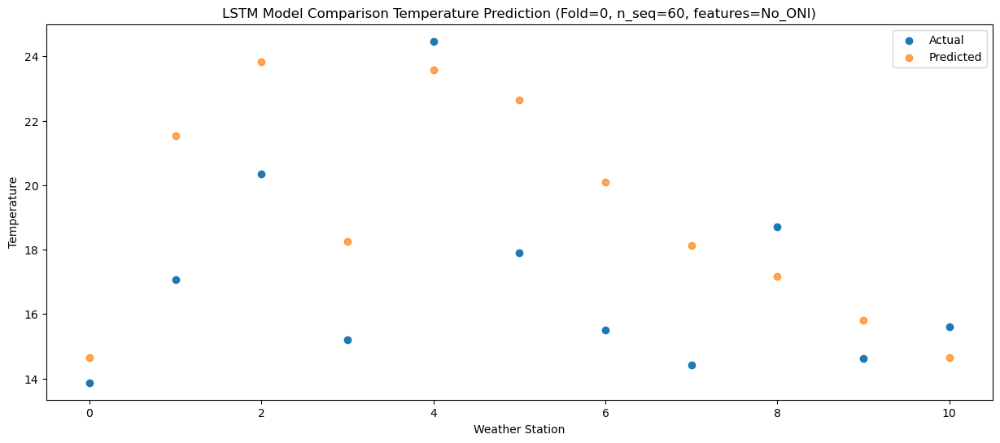

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  16.982137
1                 1   17.21  23.880390
2                 2   21.28  26.181535
3                 3   15.18  20.584610
4                 4   26.83  25.926781
5                 5   20.04  24.989740
6                 6   16.60  22.419389
7                 7   16.30  20.465811
8                 8   21.05  19.520748
9                 9   16.66  18.149367
10               10   16.72  17.008064


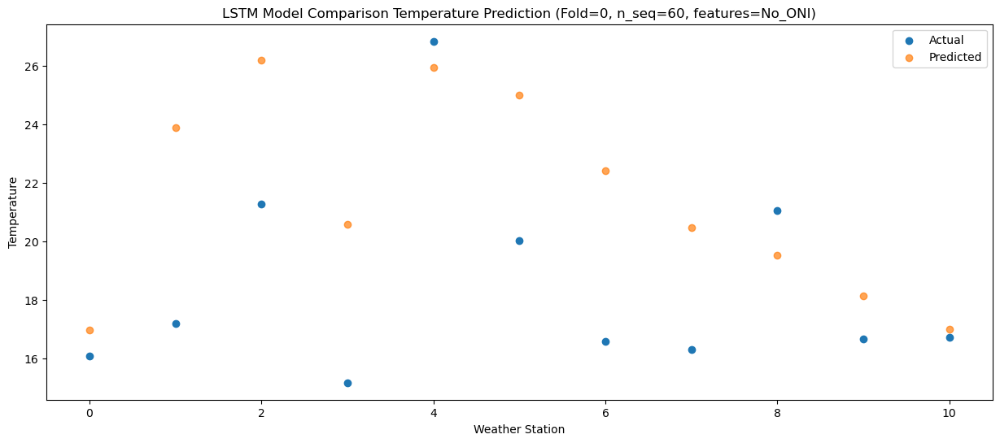

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91  15.759969
1                 1   16.66  22.651431
2                 2   20.05  24.950878
3                 3   13.99  19.356665
4                 4   24.47  24.710712
5                 5   19.19  23.767414
6                 6   15.31  21.198126
7                 7   14.62  19.244404
8                 8   18.17  18.299031
9                 9   14.75  16.927513
10               10   15.60  15.786367


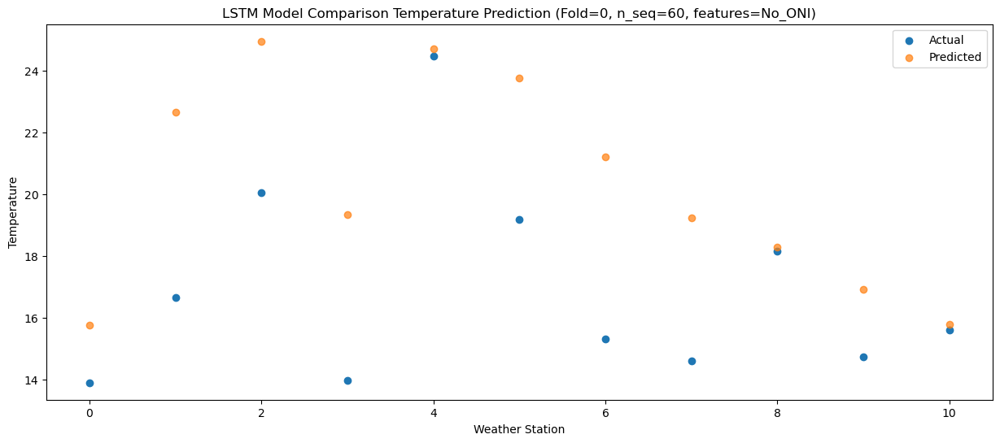

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94  11.722283
1                 1   15.64  18.603899
2                 2   16.93  20.898822
3                 3   12.75  15.308409
4                 4   21.52  20.668216
5                 5   16.54  19.717401
6                 6   12.25  17.146135
7                 7   10.92  15.188444
8                 8   14.53  14.252480
9                 9   11.02  12.884483
10               10   11.76  11.754351


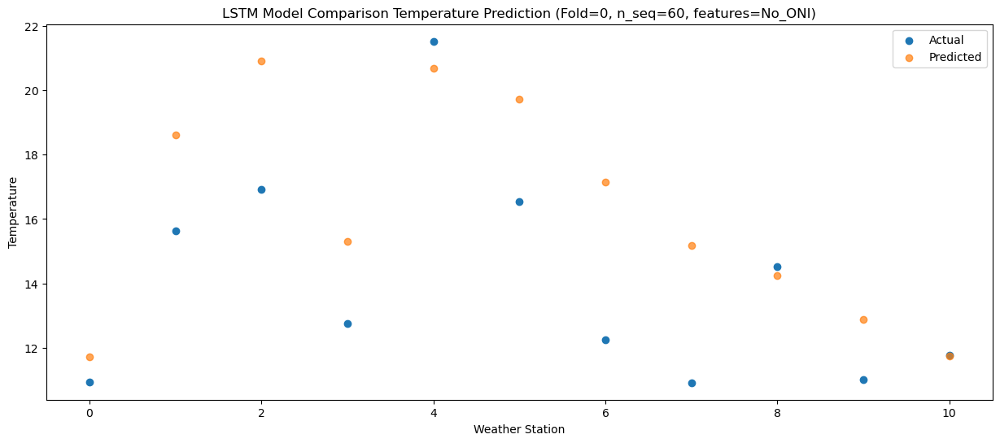

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   4.581149
1                 1   10.04  11.465249
2                 2    9.79  13.766171
3                 3    7.13   8.172716
4                 4   15.60  13.531461
5                 5    9.98  12.581891
6                 6    5.31  10.008920
7                 7    3.73   8.054056
8                 8    7.97   7.120160
9                 9    3.98   5.753286
10               10    4.52   4.620683


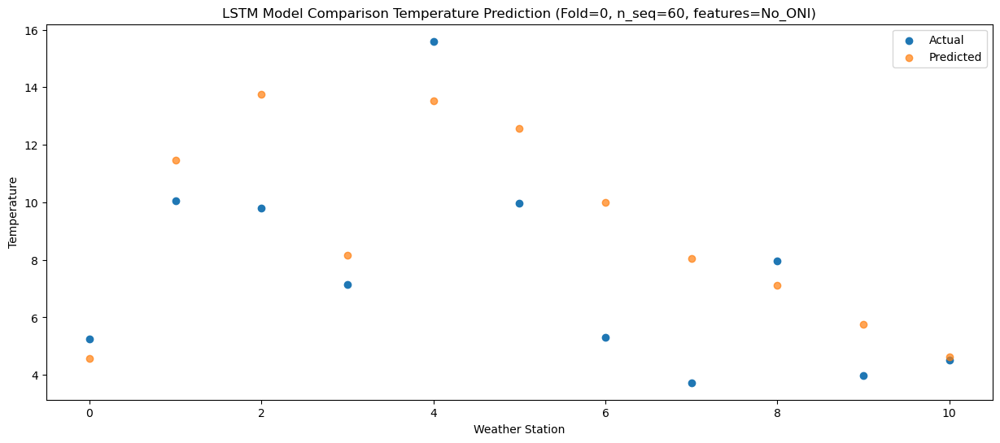

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.151561
1                 1    7.35   6.732205
2                 2    7.31   9.034512
3                 3    3.02   3.442302
4                 4    8.67   8.800479
5                 5    8.29   7.848157
6                 6    3.08   5.279552
7                 7    1.53   3.325430
8                 8    2.00   2.385873
9                 9   -1.04   1.016511
10               10   -0.51  -0.111536


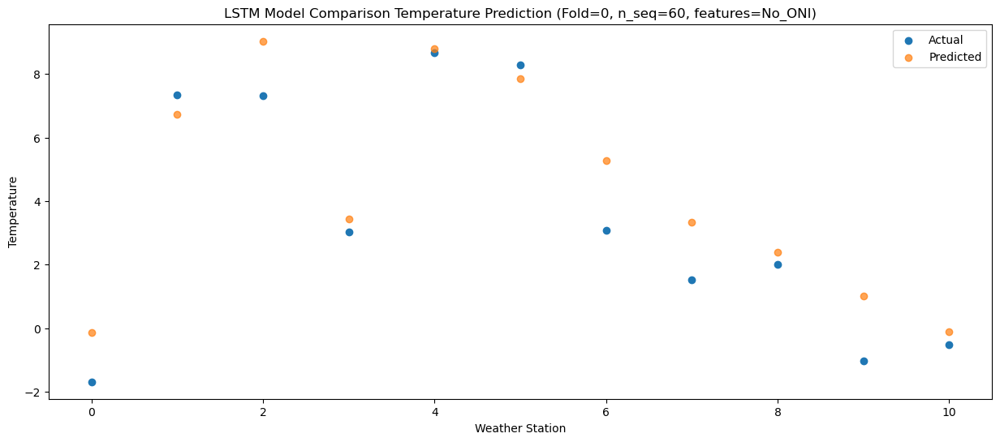

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -5.906178
1                 1    3.50   0.981523
2                 2    2.79   3.286945
3                 3    0.84  -2.304998
4                 4    5.94   3.048466
5                 5    1.77   2.107338
6                 6   -3.43  -0.460501
7                 7   -5.64  -2.415209
8                 8   -3.29  -3.362251
9                 9   -6.75  -4.730854
10               10   -6.69  -5.858721


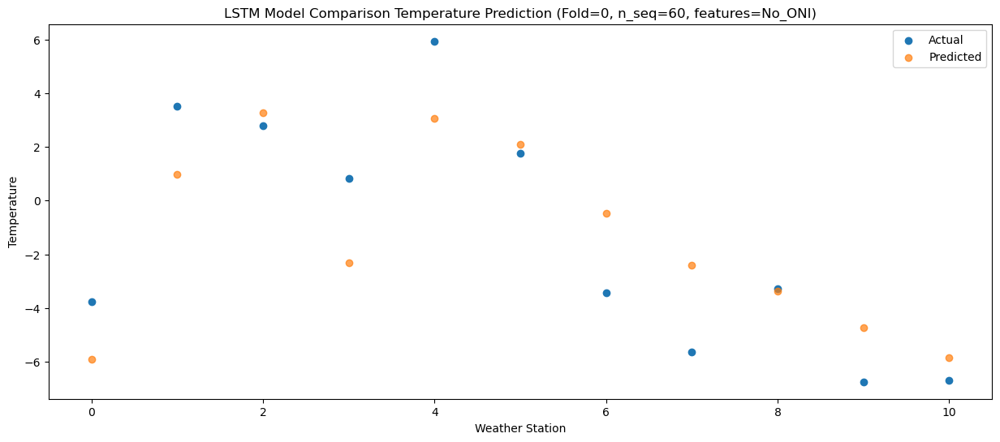

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -3.675195
1                 1    4.29   3.212215
2                 2    4.74   5.522716
3                 3    2.28  -0.082135
4                 4    6.91   5.269125
5                 5    3.46   4.341230
6                 6   -0.24   1.768615
7                 7   -2.47  -0.184638
8                 8   -0.73  -1.129257
9                 9   -4.86  -2.498296
10               10   -5.56  -3.619876


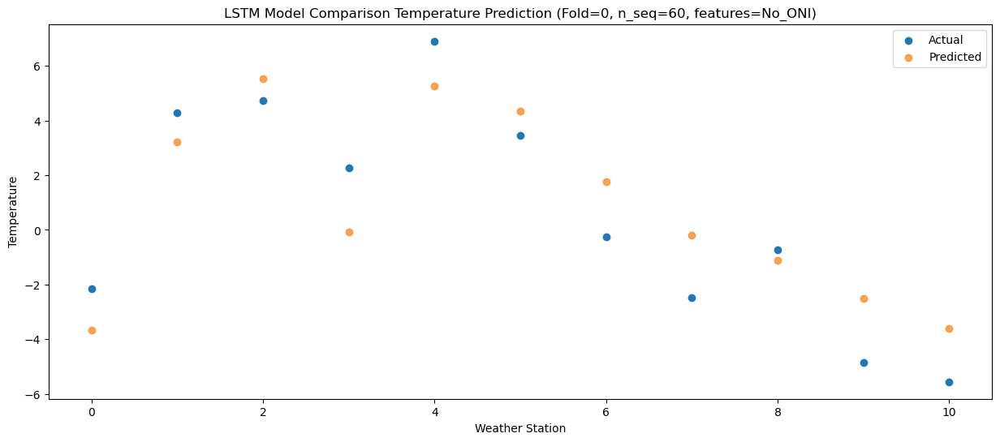

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -2.319254
1                 1    5.39   4.572235
2                 2    7.52   6.882759
3                 3    2.69   1.284298
4                 4    7.04   6.630546
5                 5    4.95   5.694594
6                 6    2.76   3.115187
7                 7    0.50   1.157257
8                 8    0.88   0.212971
9                 9   -2.82  -1.154541
10               10   -5.15  -2.271631


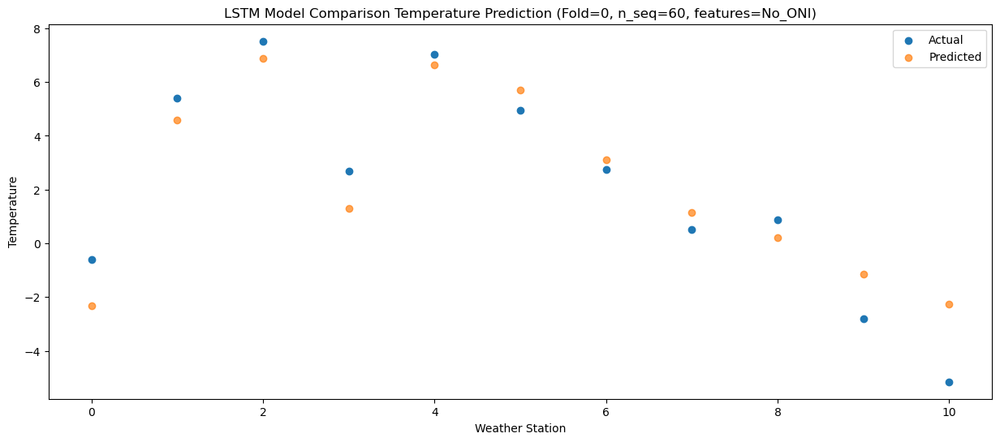

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -0.864842
1                 1    6.98   6.030166
2                 2    7.50   8.337602
3                 3    6.21   2.737733
4                 4   11.76   8.078768
5                 5    5.86   7.145479
6                 6    3.24   4.571291
7                 7    1.18   2.610124
8                 8    2.70   1.664019
9                 9   -2.48   0.294676
10               10   -3.29  -0.827122


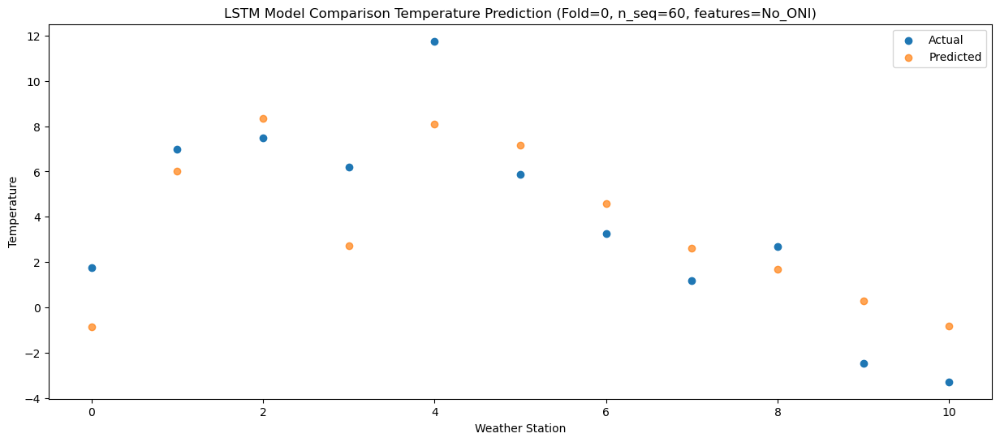

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   5.364197
1                 1    9.13  12.257258
2                 2   10.57  14.565871
3                 3    7.63   8.960536
4                 4   13.26  14.305533
5                 5   10.54  13.369257
6                 6    6.80  10.796026
7                 7    5.80   8.832075
8                 8    8.48   7.891478
9                 9    3.80   6.521611
10               10    3.56   5.396780


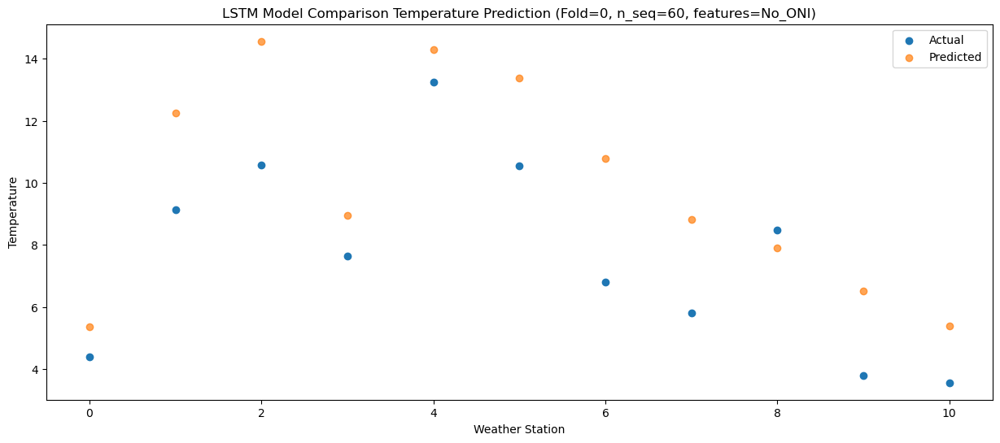

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   9.358667
1                 1   12.31  16.252521
2                 2   13.98  18.562600
3                 3   12.06  12.958401
4                 4   18.79  18.303314
5                 5   12.06  17.370313
6                 6    9.49  14.799992
7                 7    8.09  12.840748
8                 8   14.07  11.901125
9                 9    8.76  10.529949
10               10    8.58   9.401687


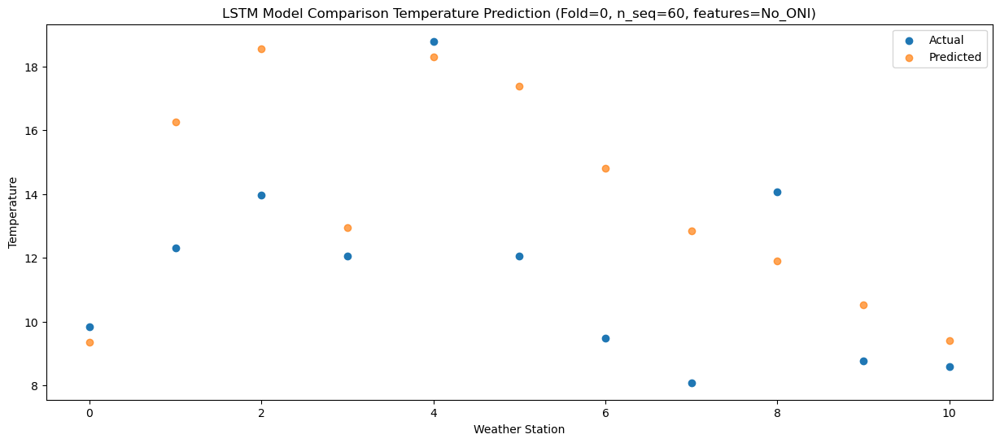

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63  13.348743
1                 1   15.39  20.243170
2                 2   17.30  22.548045
3                 3   15.81  16.948395
4                 4   23.34  22.294466
5                 5   15.88  21.358410
6                 6   12.84  18.784960
7                 7   11.84  16.824368
8                 8   17.94  15.884430
9                 9   12.60  14.514685
10               10   14.09  13.395065


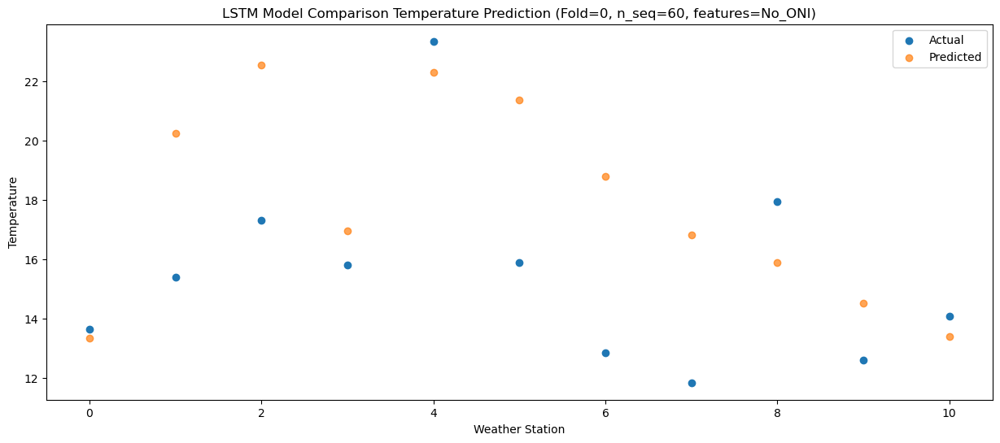

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17  16.862906
1                 1   17.22  23.752944
2                 2   20.40  26.056174
3                 3   16.93  20.455194
4                 4   26.33  25.798142
5                 5   19.71  24.860200
6                 6   16.55  22.282580
7                 7   15.98  20.319031
8                 8   19.43  19.381191
9                 9   15.43  18.018100
10               10   16.55  16.903254


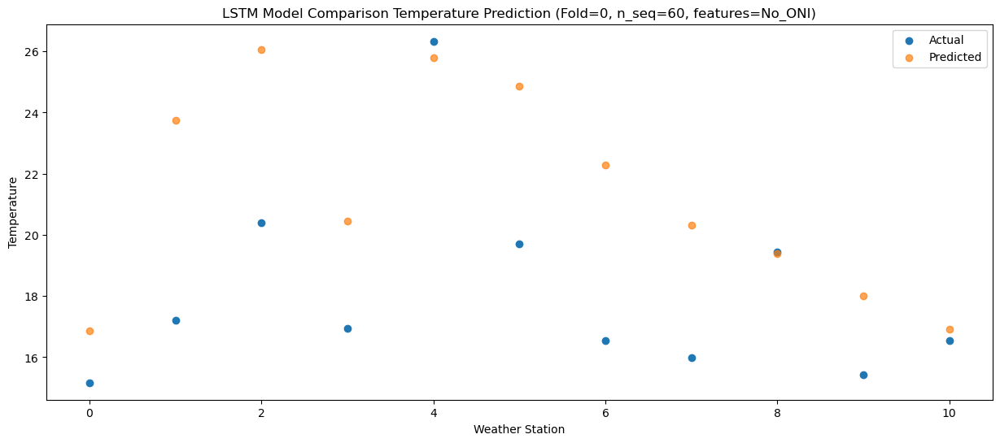

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89  15.677557
1                 1   18.81  22.571626
2                 2   20.01  24.868606
3                 3   18.46  19.270098
4                 4   28.07  24.612666
5                 5   19.23  23.667965
6                 6   15.86  21.089497
7                 7   14.84  19.127709
8                 8   18.17  18.197490
9                 9   14.63  16.832865
10               10   14.74  15.720288


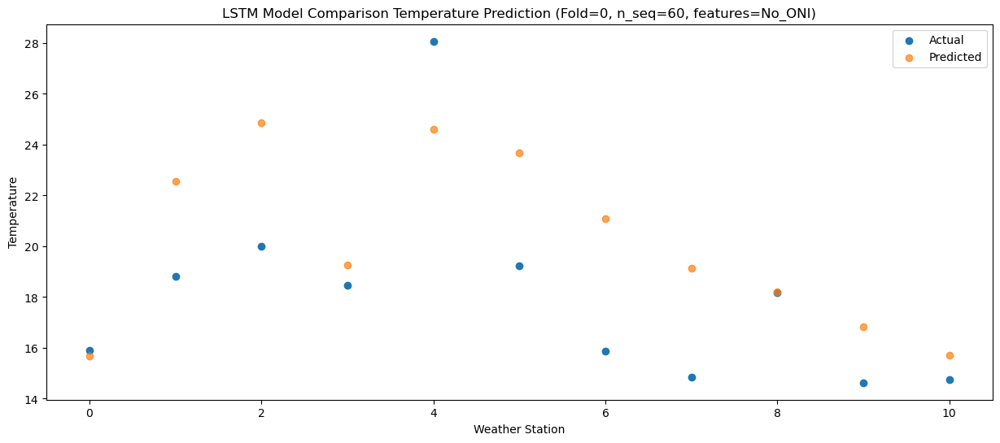

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66  12.272248
1                 1   15.43  19.165646
2                 2   16.56  21.464252
3                 3   15.02  15.867164
4                 4   23.59  21.208569
5                 5   15.71  20.254718
6                 6   12.35  17.672575
7                 7   11.08  15.708257
8                 8   15.00  14.779568
9                 9   12.02  13.409145
10               10   12.36  12.294949


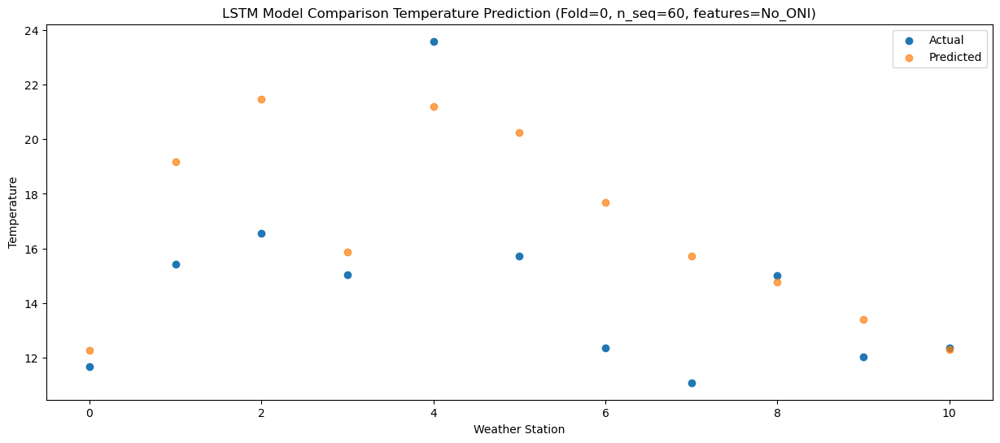

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   6.246294
1                 1   10.32  13.139852
2                 2   10.58  15.438030
3                 3    8.77   9.842244
4                 4   15.93  15.182438
5                 5   11.36  14.229133
6                 6    7.14  11.642855
7                 7    5.69   9.676718
8                 8    9.40   8.744209
9                 9    5.44   7.369446
10               10    6.40   6.258479


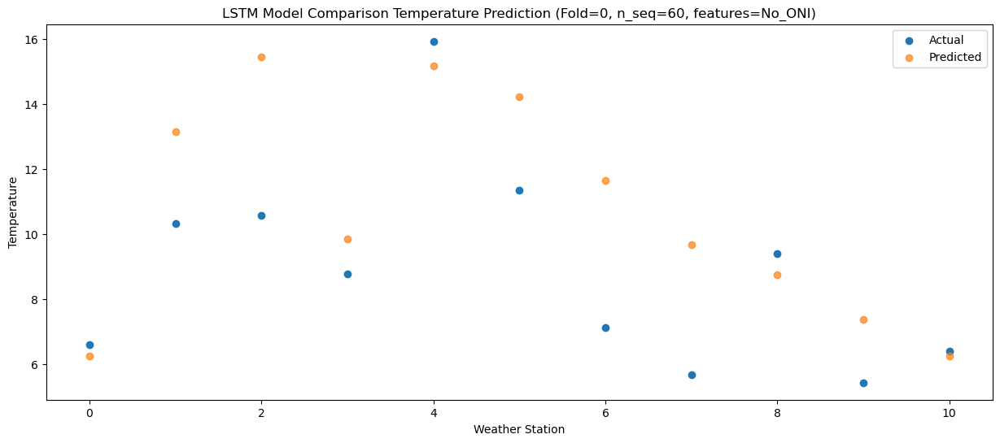

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -0.561066
1                 1    5.08   6.338003
2                 2    5.49   8.638053
3                 3    2.91   3.049223
4                 4    9.57   8.384642
5                 5    5.92   7.429078
6                 6    1.27   4.845359
7                 7   -0.76   2.881881
8                 8    2.41   1.954280
9                 9   -1.06   0.575604
10               10   -1.24  -0.535568


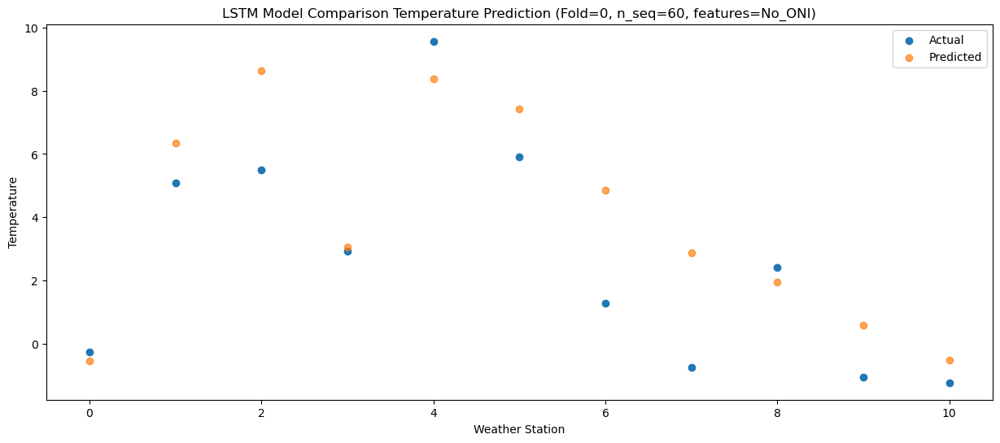

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -2.720015
1                 1    2.38   4.181876
2                 2    2.46   6.485210
3                 3    0.12   0.894755
4                 4    6.78   6.225366
5                 5    3.78   5.270854
6                 6   -1.02   2.688320
7                 7   -2.35   0.729585
8                 8   -0.15  -0.204146
9                 9   -3.49  -1.575333
10               10   -1.92  -2.683743


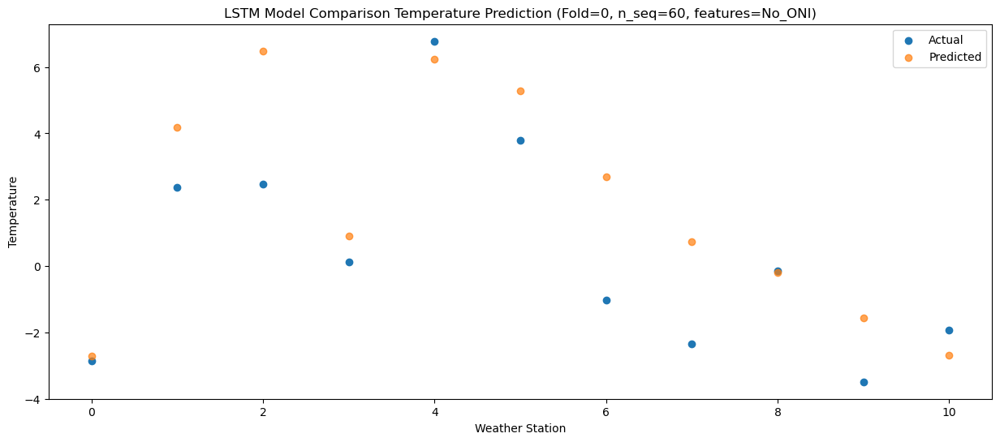

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98  -6.947840
1                 1    0.11  -0.036514
2                 2   -0.05   2.262557
3                 3   -2.76  -3.323881
4                 4    1.80   2.006090
5                 5    2.51   1.043994
6                 6   -3.15  -1.531935
7                 7   -5.05  -3.489974
8                 8   -6.41  -4.427315
9                 9   -9.25  -5.802311
10               10   -8.84  -6.914668


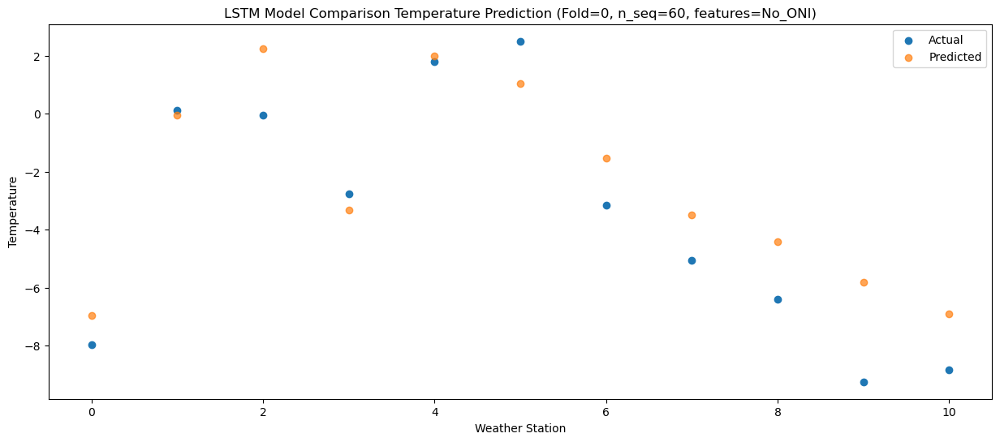

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -2.487329
1                 1    2.61   4.423260
2                 2    4.46   6.724638
3                 3    1.89   1.140549
4                 4    9.67   6.467831
5                 5    3.03   5.500661
6                 6    0.41   2.927643
7                 7   -1.91   0.969470
8                 8    2.21   0.035736
9                 9   -3.11  -1.334085
10               10   -3.83  -2.442744


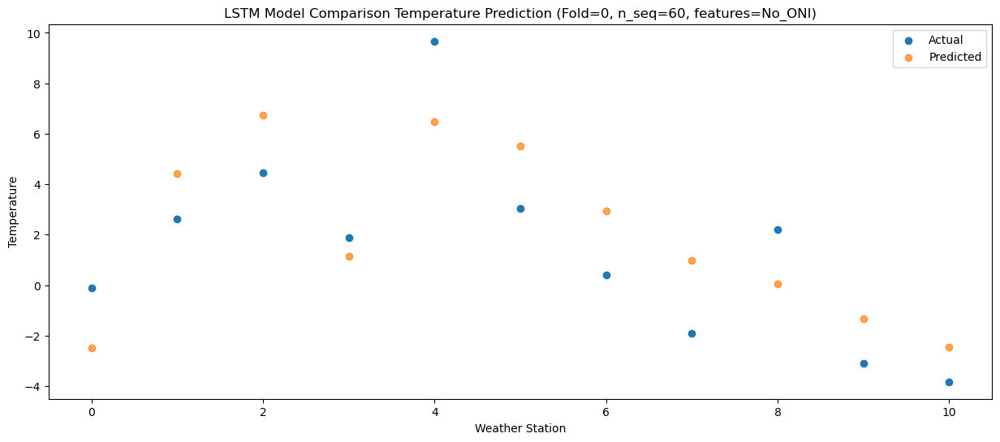

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65   1.090080
1                 1    5.91   7.996781
2                 2    8.84  10.297502
3                 3    4.83   4.711202
4                 4   12.22  10.037181
5                 5    7.08   9.067244
6                 6    4.25   6.496477
7                 7    2.24   4.537513
8                 8    5.49   3.605289
9                 9    0.21   2.236868
10               10   -0.33   1.129959


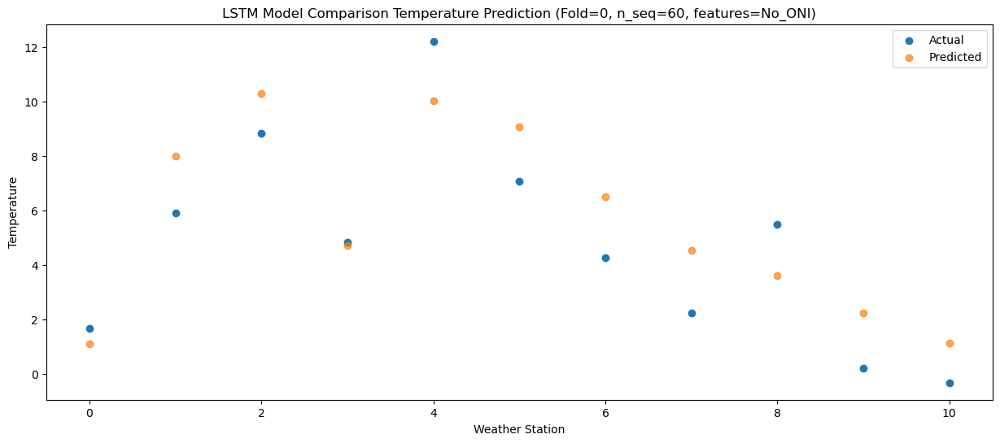

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42   5.700916
1                 1    8.79  12.606833
2                 2   12.53  14.909119
3                 3    8.40   9.318481
4                 4   15.49  14.646297
5                 5   10.30  13.668485
6                 6    7.84  11.099366
7                 7    6.72   9.140082
8                 8   10.37   8.213361
9                 9    5.43   6.845450
10               10    5.01   5.736975


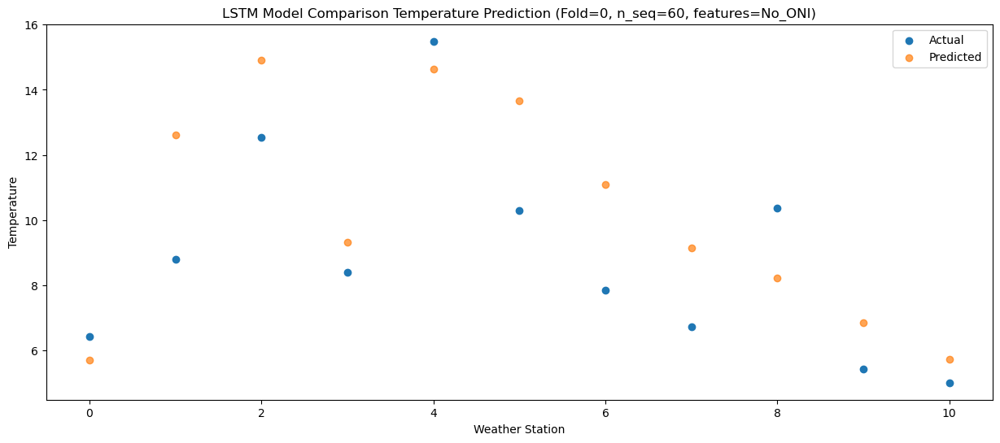

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33  10.798192
1                 1   13.28  17.703855
2                 2   17.01  20.009232
3                 3   12.79  14.419577
4                 4   20.07  19.755047
5                 5   15.11  18.773999
6                 6   11.84  16.197689
7                 7   10.68  14.235843
8                 8   15.44  13.317475
9                 9   11.23  11.953890
10               10   11.98  10.853347


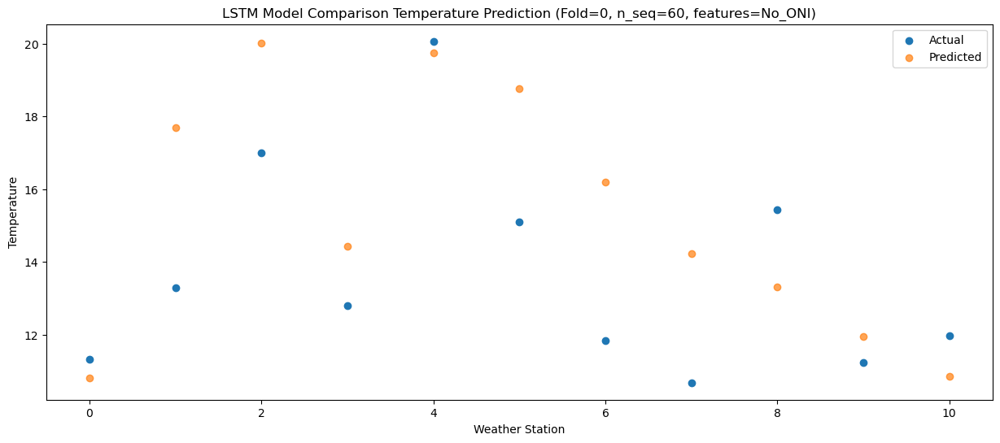

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94  15.557163
1                 1   16.21  22.464238
2                 2   21.25  24.768202
3                 3   14.91  19.187188
4                 4   23.57  24.517276
5                 5   18.54  23.538193
6                 6   15.75  20.967414
7                 7   14.70  19.004280
8                 8   18.37  18.084164
9                 9   14.99  16.717704
10               10   16.30  15.613695


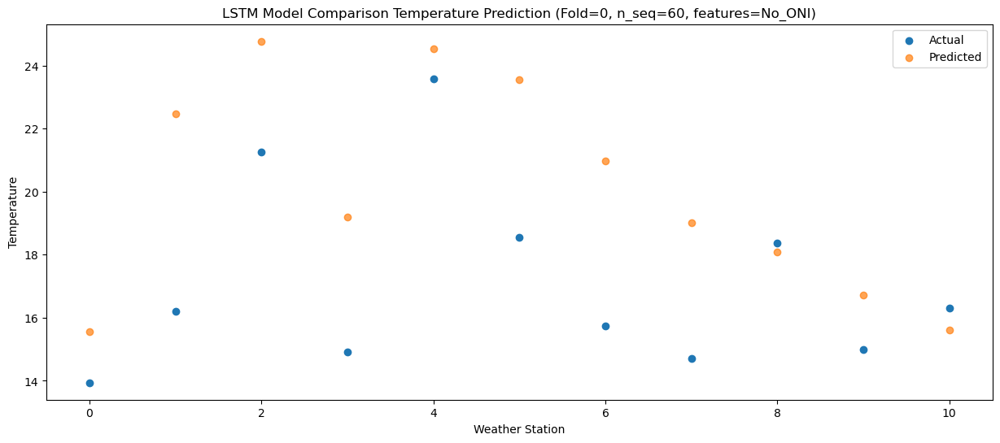

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82  16.754045
1                 1   17.34  23.656755
2                 2   21.52  25.963686
3                 3   14.85  20.372575
4                 4   23.43  25.708143
5                 5   20.20  24.730023
6                 6   17.01  22.162067
7                 7   15.92  20.197043
8                 8   18.92  19.276538
9                 9   15.83  17.906286
10               10   17.19  16.795669


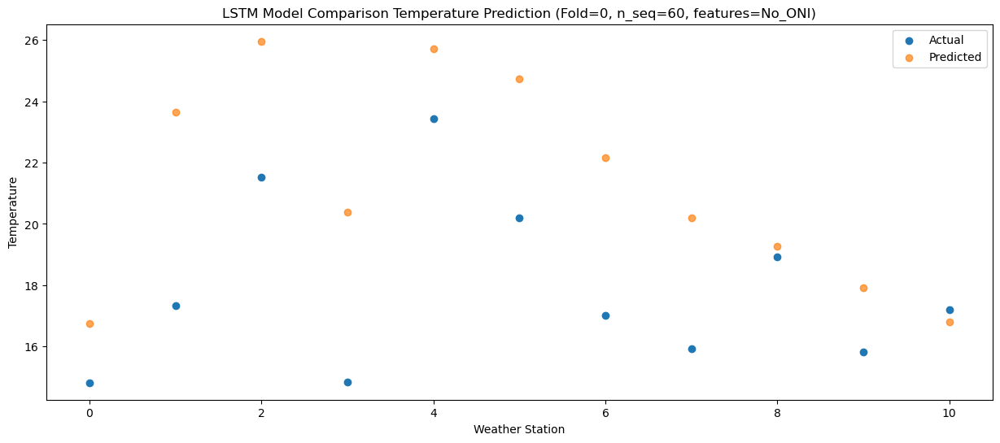

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16  15.688977
1                 1   17.73  22.591613
2                 2   19.84  24.894674
3                 3   15.66  19.307213
4                 4   25.11  24.641688
5                 5   18.93  23.662567
6                 6   15.26  21.099665
7                 7   14.08  19.130015
8                 8   18.86  18.207462
9                 9   15.50  16.838037
10               10   16.44  15.720535


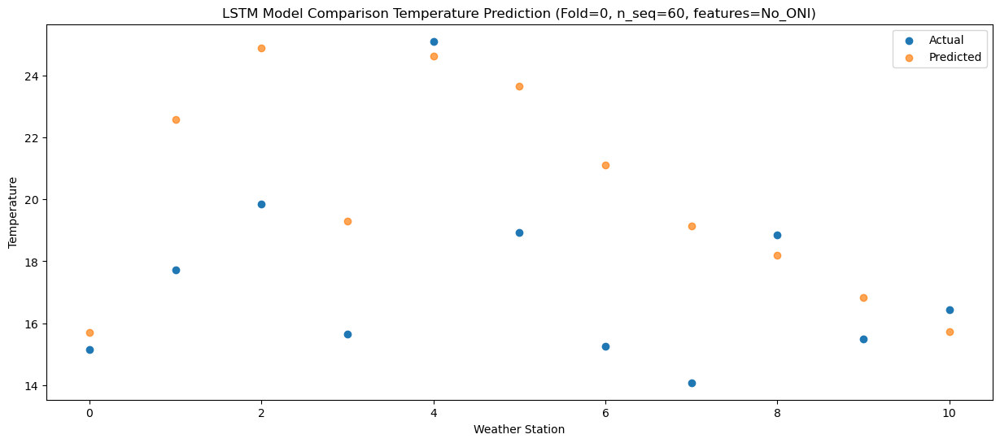

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02  12.396849
1                 1   14.49  19.289801
2                 2   17.07  21.594064
3                 3   13.07  16.012124
4                 4   21.19  21.345943
5                 5   16.99  20.356367
6                 6   12.83  17.796219
7                 7   11.15  15.825960
8                 8   15.24  14.915066
9                 9   13.31  13.553450
10               10   13.66  12.442491


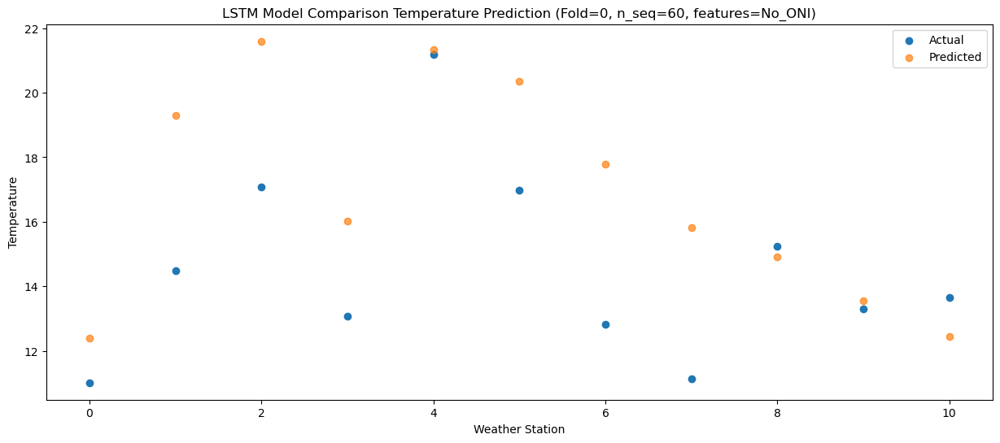

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   7.070525
1                 1   11.17  13.960545
2                 2   11.17  16.261773
3                 3    8.93  10.677749
4                 4   18.74  16.011214
5                 5   11.96  15.014282
6                 6    7.56  12.452183
7                 7    5.32  10.480162
8                 8    9.81   9.574284
9                 9    6.57   8.210903
10               10    7.43   7.102372


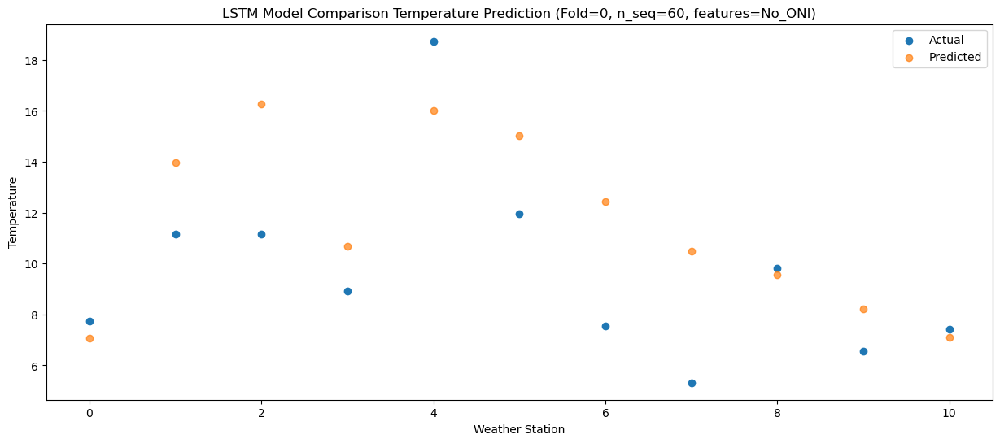

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

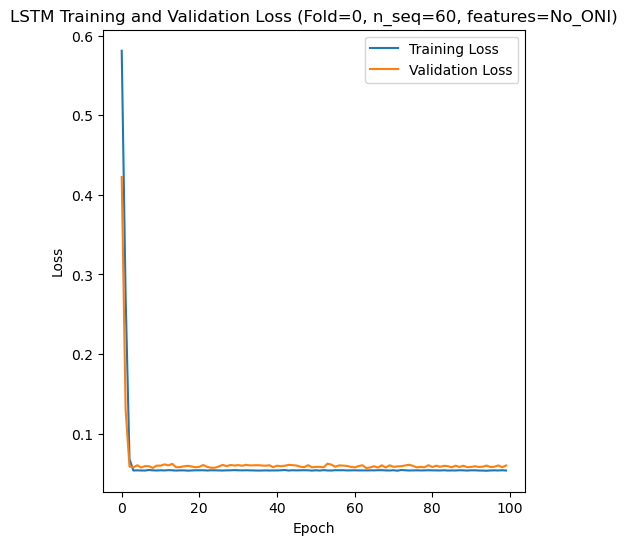

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 31s 157ms/step - loss: 0.6271 - accuracy: 0.0000e+00 - mae: 0.4946 - rmse: 0.6271 - mape: inf - pearson: 0.0076 - val_loss: 0.4567 - val_accuracy: 0.0000e+00 - val_mae: 0.3633 - val_rmse: 0.4567 - val_mape: 77.9000 - val_pearson: 0.0275
Epoch 2/100
84/84 [==============================] - 6s 73ms/step - loss: 0.2999 - accuracy: 0.3452 - mae: 0.2401 - rmse: 0.2999 - mape: inf - pearson: 0.1352 - val_loss: 0.1438 - val_accuracy: 0.6000 - val_mae: 0.1167 - val_rmse: 0.1438 - val_mape: 24.5684 - val_pearson: 0.4783
Epoch 3/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0725 - accuracy: 0.6071 - mae: 0.0576 - rmse: 0.0725 - mape: inf - pearson: 0.7782 - val_l

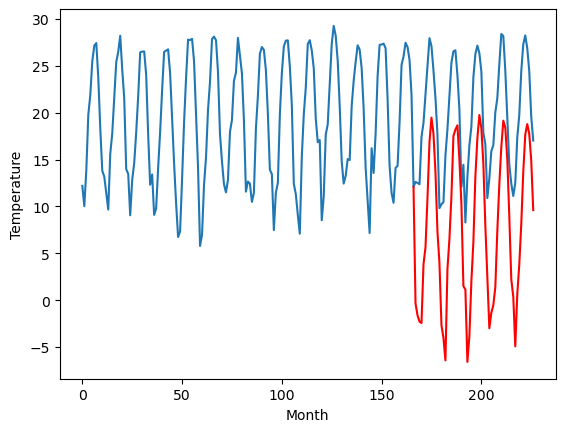

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		3.91		0.39
2.61		2.62		0.01
1.50		1.95		0.45
1.59		1.80		0.21
7.59		8.06		0.47
8.81		9.89		1.08
12.16		15.16		3.00
16.51		21.12		4.61
19.88		23.72		3.84
18.47		22.02		3.55
14.93		17.87		2.94
11.21		11.54		0.33
7.11		8.18		1.07
0.22		1.59		1.37
0.02		0.22		0.20
0.68		-2.17		-2.85
7.45		7.56		0.11
9.59		10.80		1.21
13.32		15.34		2.02
17.46		21.76		4.30
18.84		22.45		3.61
19.11		22.90		3.79
15.37		19.20		3.83
11.59		14.52		2.93
3.93		5.74		1.81
5.56		5.36		-0.20
-1.17		-2.35		-1.18
3.06		0.41		-2.65
6.63		6.26		-0.37
9.63		10.42		0.79
15.51		17.43		1.92
19.48		21.49		2.01
19.98		23.98		4.00
18.52		22.61		4.09
15.43		18.77		3.34
9.09		12.16		3.07
6.09		6.69		0.60
0.28		1.23		0.95
2.47		2.89		0.42
5.84		3.70		-2.14
6.61		5.62		-0.99
9.88		11.65		1.77
13.16		16.56		3.40
16.35		20.57		4.22
19.95		23.38		3.43
19.41		22.64		3.23
15.90		19.27		3.37
10.89		13.21		2.32
5.27		6.45		1.18
2.13		4.61		

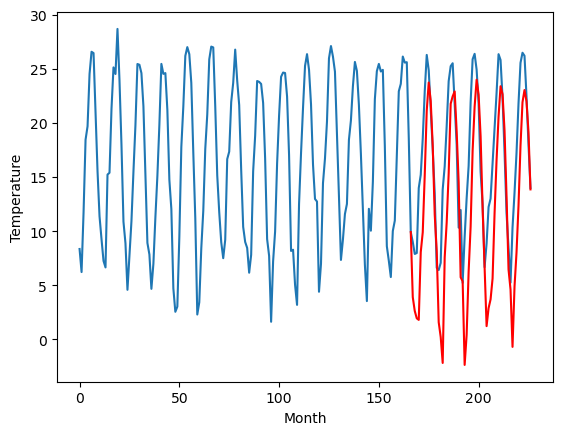

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		0.05		1.53
-1.05		-1.22		-0.17
-1.58		-1.90		-0.32
-1.30		-2.04		-0.74
5.80		4.22		-1.58
4.83		6.05		1.22
8.98		11.32		2.34
13.21		17.28		4.07
14.68		19.88		5.20
14.67		18.18		3.51
11.87		14.03		2.16
7.52		7.70		0.18
2.72		4.33		1.61
-4.34		-2.26		2.08
-3.92		-3.63		0.29
-3.43		-6.02		-2.59
3.63		3.72		0.09
5.03		6.95		1.92
9.15		11.50		2.35
13.03		17.91		4.88
13.80		18.59		4.79
14.46		19.05		4.59
11.44		15.34		3.90
7.66		10.67		3.01
-0.08		1.88		1.96
2.52		1.50		-1.02
-4.37		-6.21		-1.84
-1.02		-3.45		-2.43
2.98		2.39		-0.59
6.57		6.56		-0.01
11.93		13.57		1.64
14.90		17.63		2.73
15.61		20.13		4.52
14.00		18.76		4.76
11.61		14.92		3.31
4.92		8.31		3.39
1.60		2.83		1.23
-1.56		-2.63		-1.07
-0.56		-0.97		-0.41
2.03		-0.17		-2.20
3.46		1.76		-1.70
6.15		7.79		1.64
9.39		12.70		3.31
13.14		16.71		3.57
15.51		19.52		4.01
15.95		18.79		2.84
12.99		15.42		2.43
6.95		9.36		2.41
0.39		2.61		2.

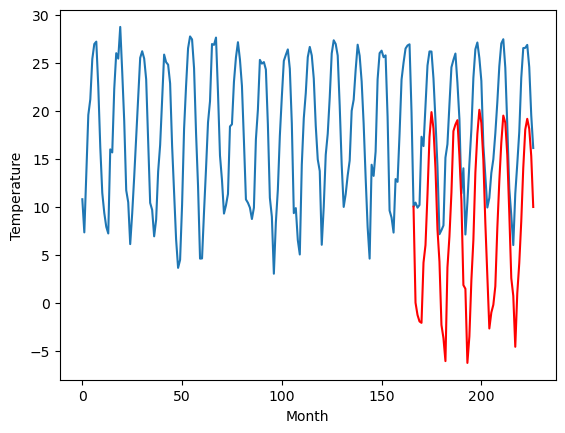

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		2.52		-1.53
2.63		1.25		-1.38
3.38		0.58		-2.80
2.85		0.44		-2.41
10.49		6.70		-3.79
10.37		8.53		-1.84
14.12		13.80		-0.32
16.90		19.76		2.86
18.55		22.36		3.81
18.79		20.65		1.86
15.38		16.50		1.12
10.84		10.17		-0.67
7.94		6.79		-1.15
1.76		0.21		-1.55
1.66		-1.15		-2.81
0.07		-3.55		-3.62
7.44		6.18		-1.26
9.78		9.41		-0.37
13.67		13.95		0.28
17.56		20.36		2.80
17.44		21.04		3.60
18.41		21.51		3.10
15.40		17.80		2.40
12.71		13.12		0.41
5.55		4.34		-1.21
8.92		3.96		-4.96
0.87		-3.75		-4.62
0.40		-0.96		-1.36
6.24		4.88		-1.36
12.24		9.04		-3.20
16.67		16.05		-0.62
19.67		20.10		0.43
20.61		22.60		1.99
18.97		21.24		2.27
16.20		17.39		1.19
10.64		10.78		0.14
5.59		5.30		-0.29
3.50		-0.16		-3.66
4.21		1.50		-2.71
5.21		2.30		-2.91
9.04		4.23		-4.81
9.88		10.26		0.38
14.47		15.17		0.70
18.62		19.17		0.55
20.34		21.98		1.64
22.31		21.25		-1.06
19.23		17.88		-1.35
11.97		11.81		-0.16
5.6

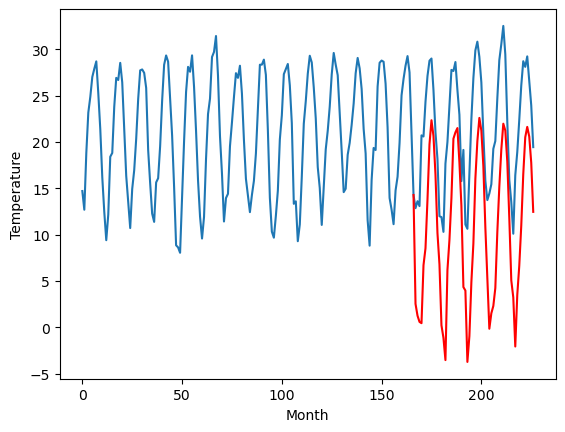

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		6.41		-1.70
6.22		5.14		-1.08
7.03		4.47		-2.56
6.65		4.34		-2.31
14.69		10.60		-4.09
14.43		12.43		-2.00
18.23		17.70		-0.53
21.26		23.65		2.39
23.30		26.24		2.94
23.54		24.54		1.00
19.96		20.40		0.44
15.02		14.07		-0.95
11.92		10.69		-1.23
5.56		4.10		-1.46
5.55		2.75		-2.80
3.85		0.35		-3.50
11.46		10.08		-1.38
13.76		13.31		-0.45
17.88		17.85		-0.03
21.35		24.26		2.91
21.44		24.94		3.50
22.41		25.40		2.99
18.83		21.69		2.86
15.79		17.01		1.22
8.24		8.22		-0.02
12.12		7.85		-4.27
3.64		0.15		-3.49
3.33		2.93		-0.40
9.11		8.78		-0.33
15.38		12.93		-2.45
20.00		19.94		-0.06
23.37		23.99		0.62
24.46		26.50		2.04
22.45		25.13		2.68
19.27		21.29		2.02
13.88		14.67		0.79
8.88		9.19		0.31
6.86		3.73		-3.13
7.34		5.39		-1.95
8.52		6.19		-2.33
12.34		8.12		-4.22
13.30		14.15		0.85
17.94		19.06		1.12
22.83		23.06		0.23
24.78		25.87		1.09
26.21		25.14		-1.07
22.36		21.76		-0.60
14.96		15.69		0.

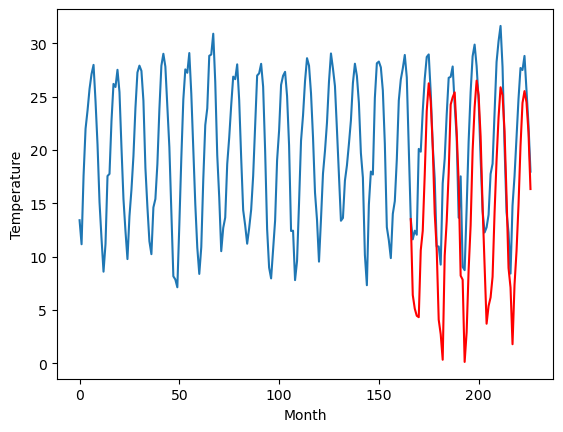

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		5.13		-2.67
5.77		3.86		-1.91
5.11		3.19		-1.92
4.59		3.06		-1.53
11.94		9.31		-2.63
14.73		11.14		-3.59
19.92		16.40		-3.52
22.64		22.36		-0.28
25.34		24.95		-0.39
25.19		23.24		-1.95
17.66		19.12		1.46
14.82		12.77		-2.05
11.10		9.40		-1.70
4.35		2.81		-1.54
2.84		1.45		-1.39
3.22		-0.94		-4.16
10.56		8.79		-1.77
12.83		12.02		-0.81
18.42		16.56		-1.86
22.69		22.97		0.28
22.03		23.65		1.62
21.44		24.12		2.68
21.08		20.42		-0.66
16.76		15.73		-1.03
10.29		6.94		-3.35
10.55		6.57		-3.98
3.23		-1.13		-4.36
3.12		1.65		-1.47
10.07		7.51		-2.56
16.98		11.67		-5.31
22.38		18.68		-3.70
24.44		22.73		-1.71
25.36		25.24		-0.12
22.51		23.87		1.36
19.46		20.03		0.57
13.38		13.41		0.03
6.42		7.91		1.49
5.30		2.45		-2.85
5.76		4.12		-1.64
5.90		4.93		-0.97
10.96		6.87		-4.09
14.12		12.89		-1.23
18.73		17.81		-0.92
25.42		21.82		-3.60
26.52		24.63		-1.89
25.71		23.89		-1.82
23.43		20.51		-2.92
15.8

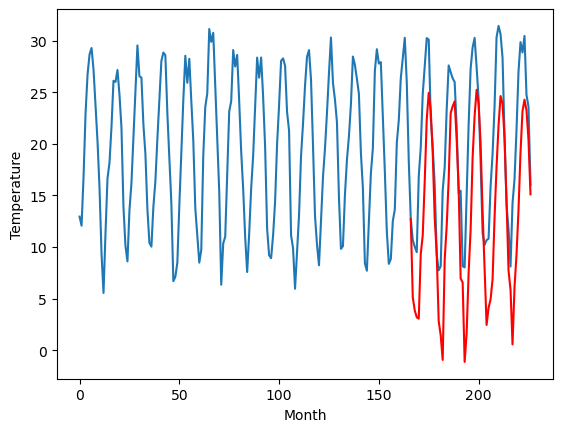

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		4.65		0.77
3.15		3.38		0.23
2.34		2.70		0.36
2.41		2.56		0.15
8.08		8.82		0.74
9.71		10.66		0.95
12.49		15.92		3.43
17.16		21.88		4.72
20.34		24.48		4.14
18.71		22.77		4.06
15.29		18.64		3.35
11.80		12.30		0.50
7.65		8.93		1.28
0.44		2.34		1.90
0.24		0.98		0.74
1.02		-1.41		-2.43
7.30		8.32		1.02
9.87		11.55		1.68
13.64		16.09		2.45
17.65		22.51		4.86
19.01		23.18		4.17
19.27		23.65		4.38
15.94		19.94		4.00
11.99		15.26		3.27
4.39		6.47		2.08
5.91		6.09		0.18
-0.48		-1.62		-1.14
3.33		1.15		-2.18
7.17		7.01		-0.16
9.93		11.17		1.24
15.85		18.18		2.33
19.43		22.23		2.80
20.17		24.73		4.56
18.67		23.36		4.69
15.78		19.52		3.74
9.44		12.90		3.46
6.55		7.41		0.86
0.54		1.95		1.41
2.67		3.61		0.94
6.26		4.42		-1.84
6.93		6.35		-0.58
10.19		12.38		2.19
13.19		17.30		4.11
16.47		21.31		4.84
19.92		24.12		4.20
19.50		23.38		3.88
16.33		20.01		3.68
11.32		13.95		2.63
5.63		7.20		1.57
2.89		5.36	

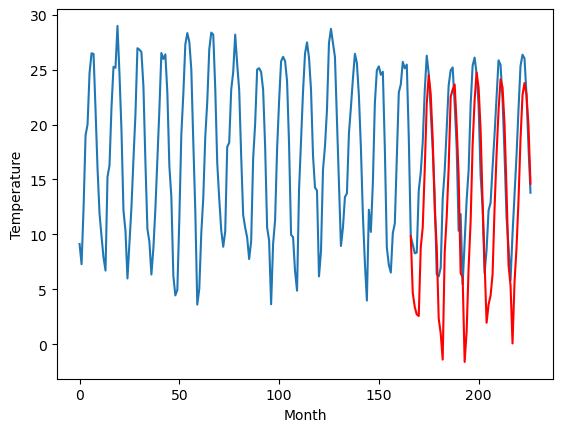

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.82		-0.10
0.30		-0.45		-0.75
-0.55		-1.13		-0.58
0.13		-1.25		-1.38
7.05		5.00		-2.05
8.19		6.83		-1.36
12.69		12.09		-0.60
18.25		18.05		-0.20
20.79		20.65		-0.14
18.77		18.94		0.17
15.47		14.80		-0.67
8.70		8.47		-0.23
5.03		5.10		0.07
-1.57		-1.48		0.09
-1.88		-2.85		-0.97
-4.88		-5.24		-0.36
6.44		4.49		-1.95
8.15		7.72		-0.43
12.81		12.26		-0.55
18.89		18.67		-0.22
19.88		19.35		-0.53
21.10		19.82		-1.28
17.39		16.12		-1.27
12.19		11.44		-0.75
2.89		2.65		-0.24
5.30		2.28		-3.02
-3.53		-5.43		-1.90
-1.48		-2.65		-1.17
4.47		3.20		-1.27
9.66		7.36		-2.30
15.13		14.37		-0.76
19.19		18.43		-0.76
23.32		20.93		-2.39
20.45		19.56		-0.89
16.61		15.71		-0.90
9.94		9.09		-0.85
3.34		3.61		0.27
-0.40		-1.85		-1.45
0.79		-0.18		-0.97
2.29		0.62		-1.67
5.12		2.56		-2.56
9.52		8.58		-0.94
14.87		13.50		-1.37
18.68		17.51		-1.17
20.98		20.33		-0.65
21.48		19.58		-1.90
17.86		16.22		-1.64
11.5

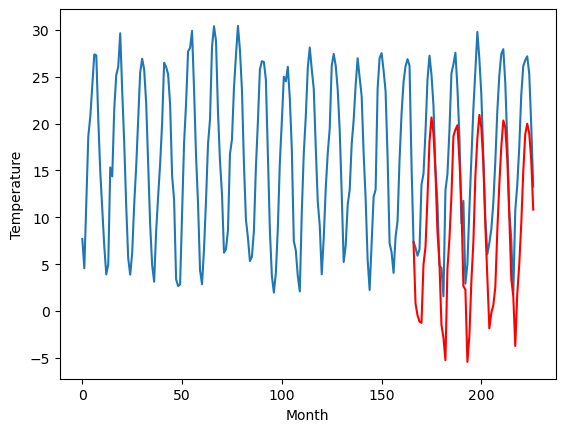

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-0.61		-1.05
-1.41		-1.89		-0.48
-1.23		-2.56		-1.33
-1.74		-2.68		-0.94
6.09		3.57		-2.52
7.47		5.39		-2.08
13.58		10.66		-2.92
18.69		16.62		-2.07
21.23		19.22		-2.01
20.30		17.51		-2.79
13.65		13.37		-0.28
7.47		7.03		-0.44
4.59		3.67		-0.92
-2.09		-2.92		-0.83
-2.44		-4.28		-1.84
-7.22		-6.69		0.53
5.34		3.05		-2.29
7.14		6.27		-0.87
11.95		10.82		-1.13
17.98		17.23		-0.75
19.49		17.91		-1.58
19.88		18.39		-1.49
17.37		14.69		-2.68
11.12		10.00		-1.12
3.37		1.22		-2.15
2.56		0.84		-1.72
-5.06		-6.86		-1.80
-4.08		-4.09		-0.01
3.17		1.77		-1.40
10.28		5.92		-4.36
15.64		12.93		-2.71
19.93		16.98		-2.95
24.08		19.49		-4.59
21.41		18.12		-3.29
17.58		14.28		-3.30
9.35		7.66		-1.69
1.50		2.17		0.67
-2.13		-3.28		-1.15
-1.27		-1.60		-0.33
-0.90		-0.80		0.10
3.53		1.15		-2.38
7.86		7.18		-0.68
13.55		12.10		-1.45
18.48		16.11		-2.37
21.36		18.92		-2.44
23.17		18.18		-4.99
18.53		14.81		-3

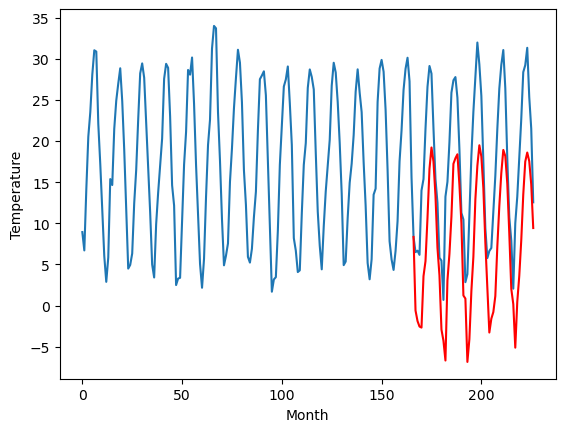

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.64		-4.04
3.32		-0.64		-3.96
2.87		-1.30		-4.17
1.63		-1.43		-3.06
9.59		4.82		-4.77
11.90		6.66		-5.24
18.43		11.91		-6.52
24.81		17.88		-6.93
26.39		20.48		-5.91
25.16		18.76		-6.40
18.41		14.63		-3.78
11.81		8.29		-3.52
8.63		4.92		-3.71
1.36		-1.66		-3.02
1.47		-3.04		-4.51
-2.90		-5.43		-2.53
7.81		4.30		-3.51
11.57		7.53		-4.04
16.12		12.07		-4.05
23.23		18.48		-4.75
23.90		19.17		-4.73
23.75		19.65		-4.10
21.80		15.96		-5.84
14.36		11.27		-3.09
8.11		2.49		-5.62
6.50		2.11		-4.39
-0.42		-5.59		-5.17
-0.36		-2.81		-2.45
6.57		3.04		-3.53
13.05		7.20		-5.85
18.50		14.20		-4.30
23.07		18.26		-4.81
26.67		20.76		-5.91
23.84		19.39		-4.45
21.43		15.55		-5.88
12.89		8.93		-3.96
3.90		3.43		-0.47
1.55		-2.02		-3.57
1.83		-0.34		-2.17
2.98		0.47		-2.51
6.71		2.42		-4.29
12.06		8.45		-3.61
17.17		13.38		-3.79
20.40		17.39		-3.01
25.02		20.19		-4.83
25.42		19.45		-5.97
21.90		16.08		-5.

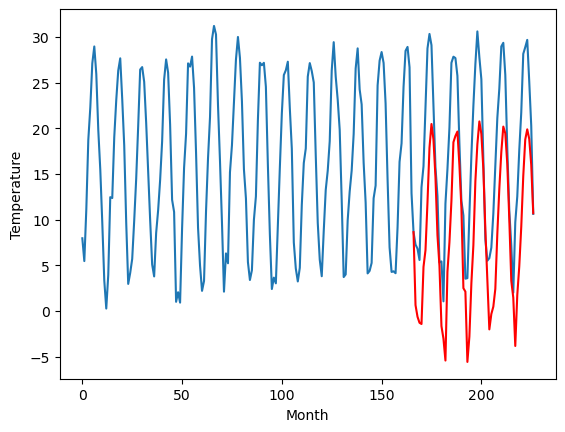

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-0.33		1.23
-4.37		-1.61		2.76
-4.03		-2.28		1.75
-3.29		-2.41		0.88
1.03		3.84		2.81
2.66		5.67		3.01
8.12		10.93		2.81
15.44		16.89		1.45
19.31		19.50		0.19
17.12		17.79		0.67
12.59		13.66		1.07
7.05		7.33		0.28
2.85		3.96		1.11
-4.16		-2.63		1.53
-6.00		-3.99		2.01
-6.96		-6.39		0.57
0.26		3.33		3.07
4.91		6.56		1.65
9.45		11.09		1.64
15.54		17.52		1.98
17.77		18.21		0.44
17.55		18.69		1.14
13.85		14.99		1.14
9.43		10.32		0.89
0.11		1.54		1.43
-0.66		1.16		1.82
-7.68		-6.55		1.13
-3.78		-3.78		-0.00
0.78		2.08		1.30
4.13		6.24		2.11
11.11		13.23		2.12
15.50		17.29		1.79
19.44		19.79		0.35
18.90		18.43		-0.47
13.99		14.58		0.59
5.89		7.97		2.08
2.38		2.48		0.10
-4.77		-2.97		1.80
-1.81		-1.29		0.52
-2.13		-0.49		1.64
-1.01		1.46		2.47
6.21		7.49		1.28
8.77		12.41		3.64
13.14		16.43		3.29
18.28		19.23		0.95
16.54		18.48		1.94
13.35		15.11		1.76
8.00		9.06		1.06
0.06		2.32		2.26
-1.63

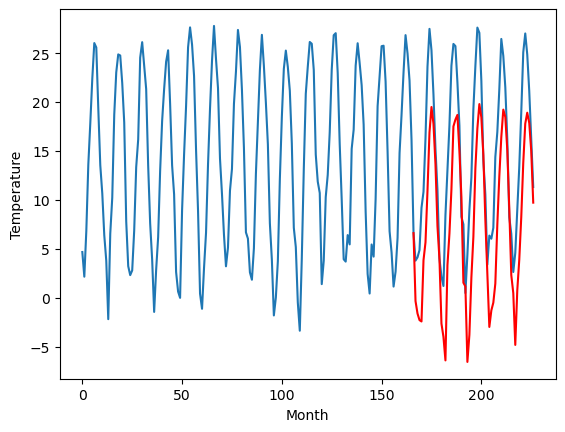

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -0.334310
1                 1    3.52   3.906109
2                 2   -1.48   0.054380
3                 3    4.05   2.523053
4                 4    8.11   6.412485
5                 5    7.80   5.130916
6                 6    3.88   4.653101
7                 7    0.92   0.821744
8                 8    0.44  -0.606477
9                 9    4.68   0.638185
10               10   -1.56  -0.331142


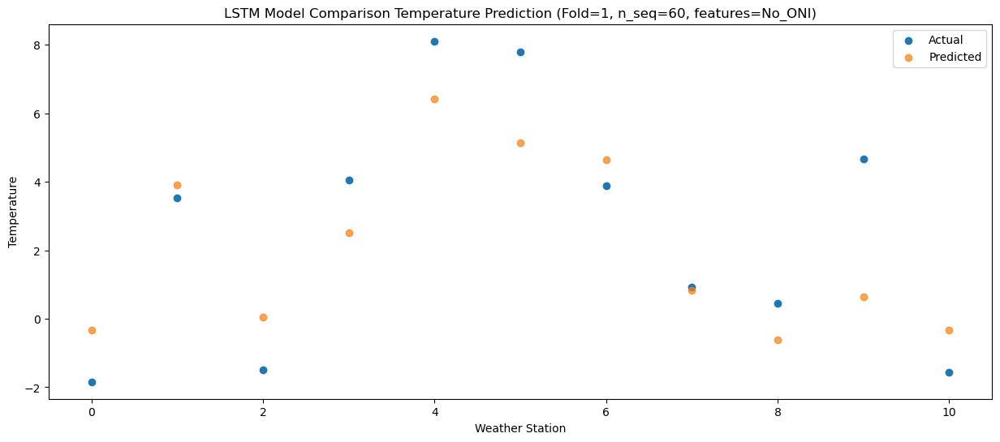

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -1.613980
1                 1    2.61   2.623783
2                 2   -1.05  -1.221304
3                 3    2.63   1.248690
4                 4    6.22   5.139847
5                 5    5.77   3.856873
6                 6    3.15   3.379934
7                 7    0.30  -0.454182
8                 8   -1.41  -1.886688
9                 9    3.32  -0.638994
10               10   -4.37  -1.605833


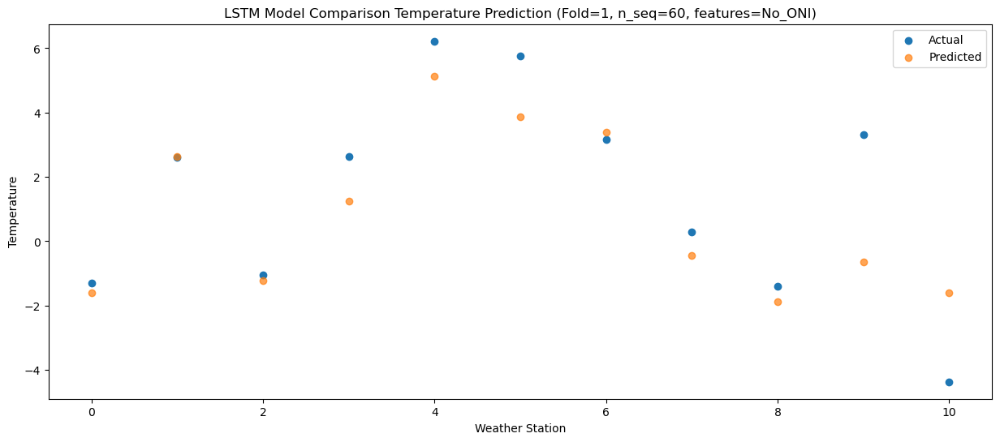

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.287031
1                 1    1.50   1.948334
2                 2   -1.58  -1.896565
3                 3    3.38   0.575036
4                 4    7.03   4.469295
5                 5    5.11   3.189874
6                 6    2.34   2.703990
7                 7   -0.55  -1.125337
8                 8   -1.23  -2.557601
9                 9    2.87  -1.298315
10               10   -4.03  -2.276747


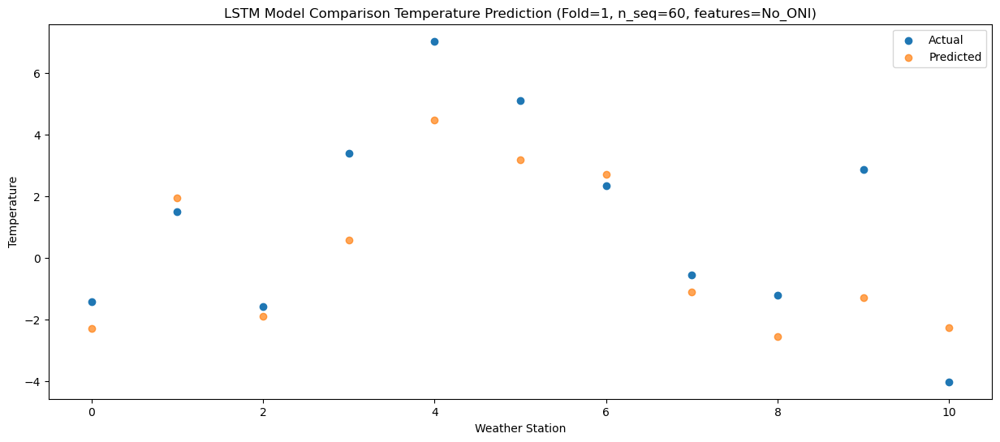

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -2.428369
1                 1    1.59   1.804146
2                 2   -1.30  -2.041054
3                 3    2.85   0.439239
4                 4    6.65   4.337918
5                 5    4.59   3.056198
6                 6    2.41   2.564995
7                 7    0.13  -1.254863
8                 8   -1.74  -2.681969
9                 9    1.63  -1.430915
10               10   -3.29  -2.414343


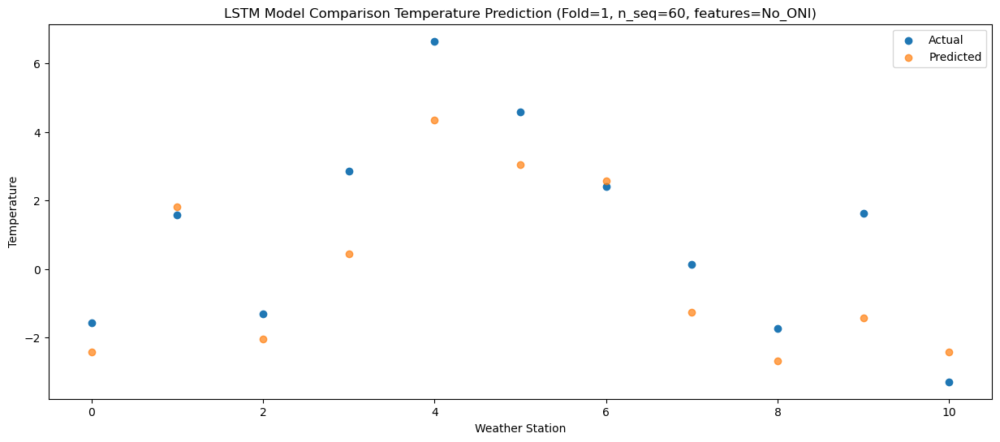

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.825283
1                 1    7.59   8.057664
2                 2    5.80   4.218045
3                 3   10.49   6.700486
4                 4   14.69  10.598567
5                 5   11.94   9.308258
6                 6    8.08   8.818333
7                 7    7.05   4.998329
8                 8    6.09   3.566150
9                 9    9.59   4.822607
10               10    1.03   3.838637


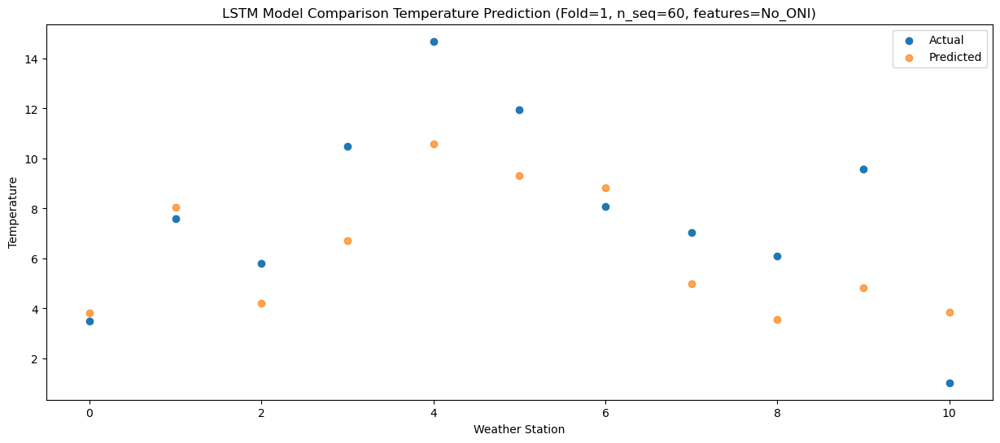

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.654094
1                 1    8.81   9.888608
2                 2    4.83   6.050378
3                 3   10.37   8.528328
4                 4   14.43  12.426805
5                 5   14.73  11.137302
6                 6    9.71  10.655905
7                 7    8.19   6.827957
8                 8    7.47   5.393953
9                 9   11.90   6.655973
10               10    2.66   5.668959


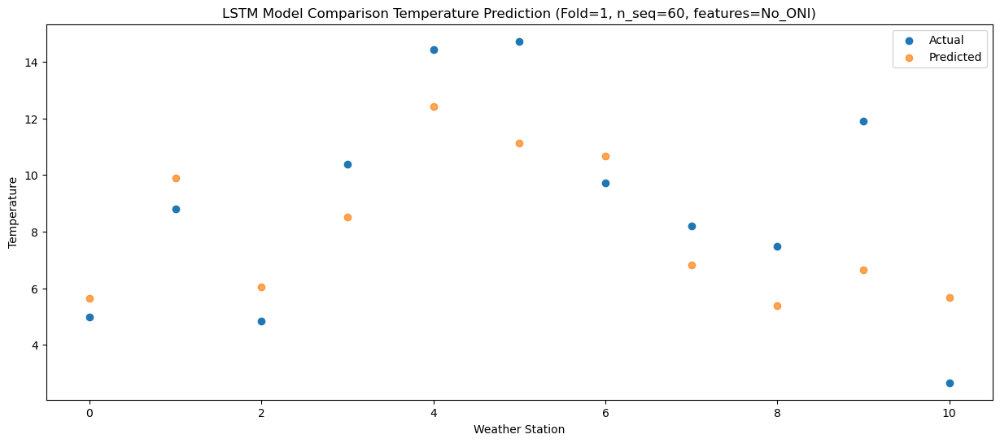

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  10.921040
1                 1   12.16  15.160501
2                 2    8.98  11.320193
3                 3   14.12  13.799662
4                 4   18.23  17.696093
5                 5   19.92  16.398728
6                 6   12.49  15.917041
7                 7   12.69  12.088073
8                 8   13.58  10.655604
9                 9   18.43  11.911116
10               10    8.12  10.932490


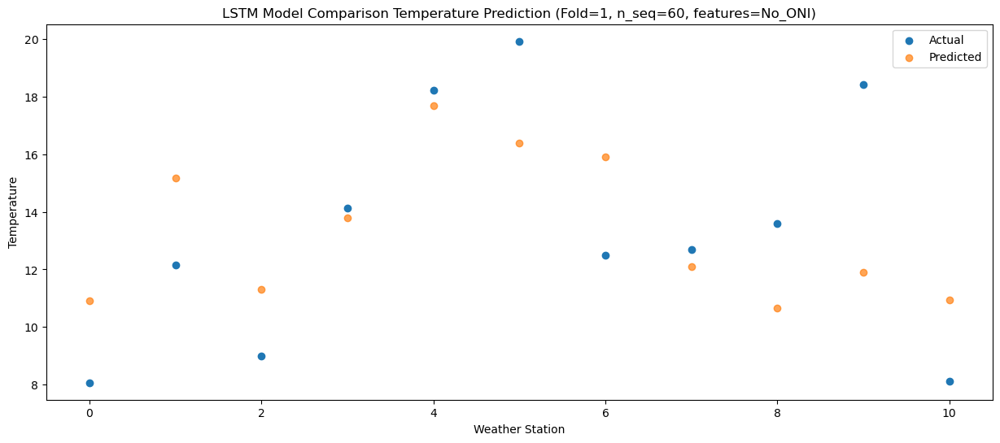

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  16.871516
1                 1   16.51  21.115199
2                 2   13.21  17.279707
3                 3   16.90  19.755362
4                 4   21.26  23.647485
5                 5   22.64  22.357414
6                 6   17.16  21.880512
7                 7   18.25  18.048798
8                 8   18.69  16.617498
9                 9   24.81  17.876162
10               10   15.44  16.888142


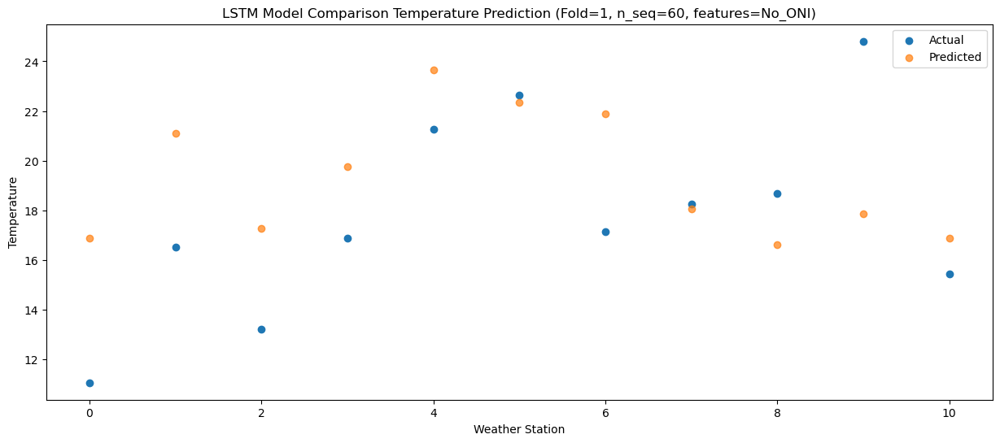

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  19.477816
1                 1   19.88  23.721574
2                 2   14.68  19.884828
3                 3   18.55  22.355363
4                 4   23.30  26.242935
5                 5   25.34  24.949074
6                 6   20.34  24.480654
7                 7   20.79  20.649353
8                 8   21.23  19.218756
9                 9   26.39  20.476246
10               10   19.31  19.495139


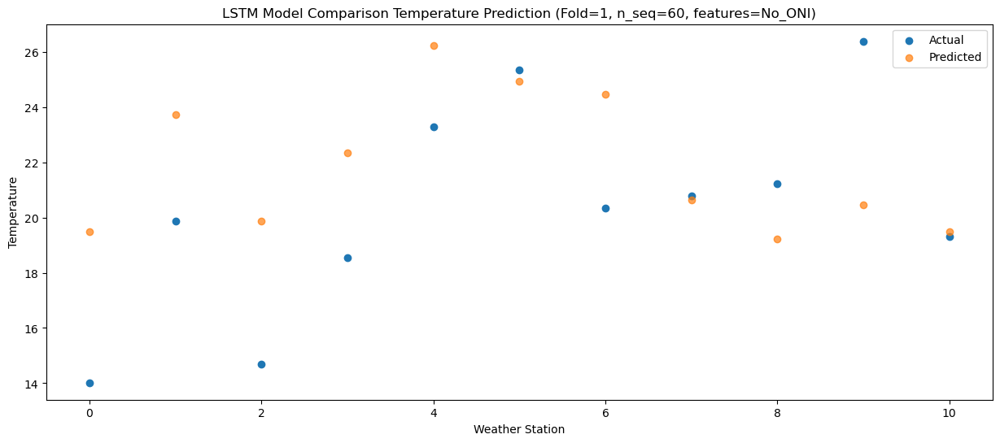

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  17.773403
1                 1   18.47  22.019513
2                 2   14.67  18.183176
3                 3   18.79  20.653650
4                 4   23.54  24.544933
5                 5   25.19  23.244318
6                 6   18.71  22.774349
7                 7   18.77  18.941618
8                 8   20.30  17.508256
9                 9   25.16  18.764991
10               10   17.12  17.785225


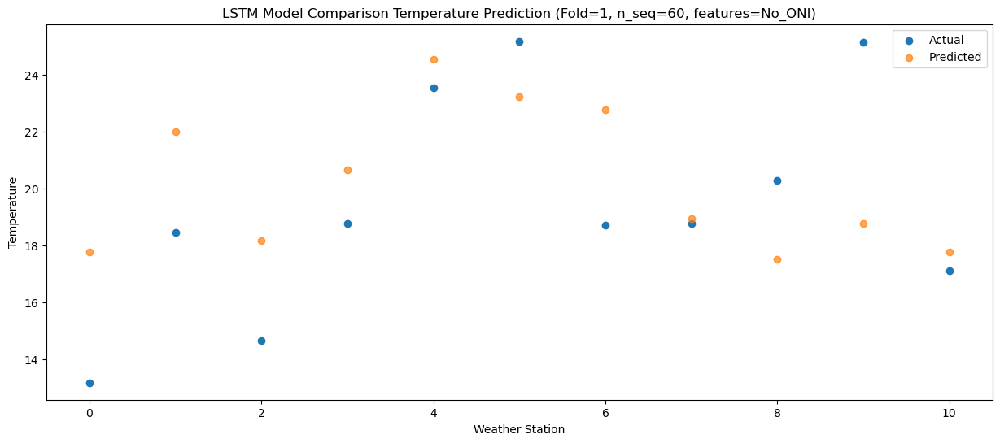

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  13.625517
1                 1   14.93  17.868288
2                 2   11.87  14.027102
3                 3   15.38  16.501681
4                 4   19.96  20.401291
5                 5   17.66  19.115062
6                 6   15.29  18.639145
7                 7   15.47  14.802524
8                 8   13.65  13.372689
9                 9   18.41  14.632930
10               10   12.59  13.657573


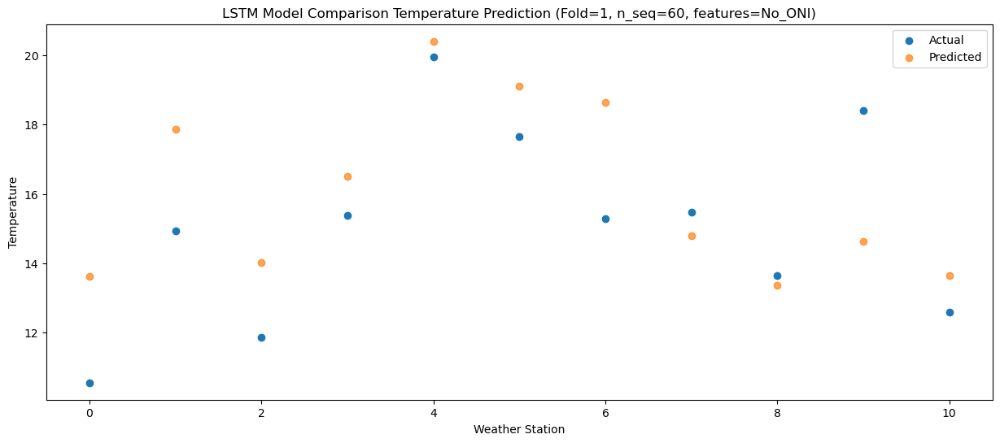

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   7.299034
1                 1   11.21  11.542032
2                 2    7.52   7.696371
3                 3   10.84  10.167650
4                 4   15.02  14.065892
5                 5   14.82  12.774013
6                 6   11.80  12.302225
7                 7    8.70   8.468225
8                 8    7.47   7.033726
9                 9   11.81   8.291340
10               10    7.05   7.327701


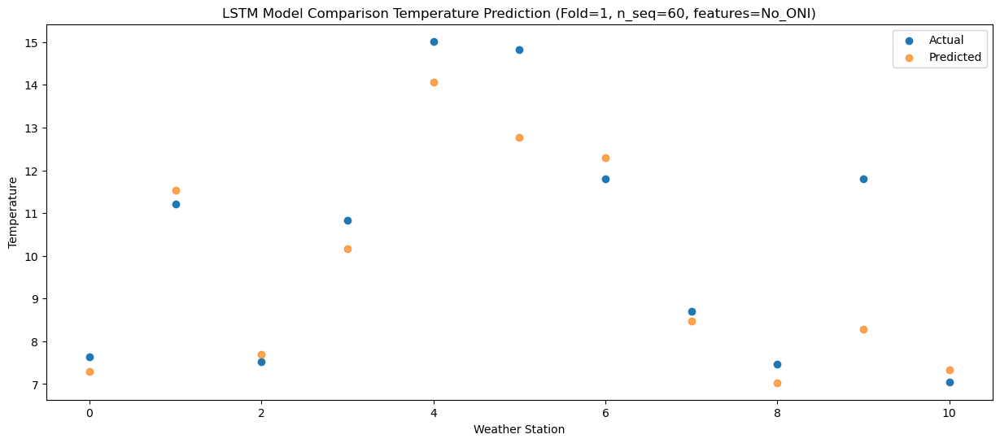

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.932025
1                 1    7.11   8.175952
2                 2    2.72   4.325114
3                 3    7.94   6.791176
4                 4   11.92  10.687271
5                 5   11.10   9.399071
6                 6    7.65   8.927736
7                 7    5.03   5.097979
8                 8    4.59   3.666316
9                 9    8.63   4.917903
10               10    2.85   3.958624


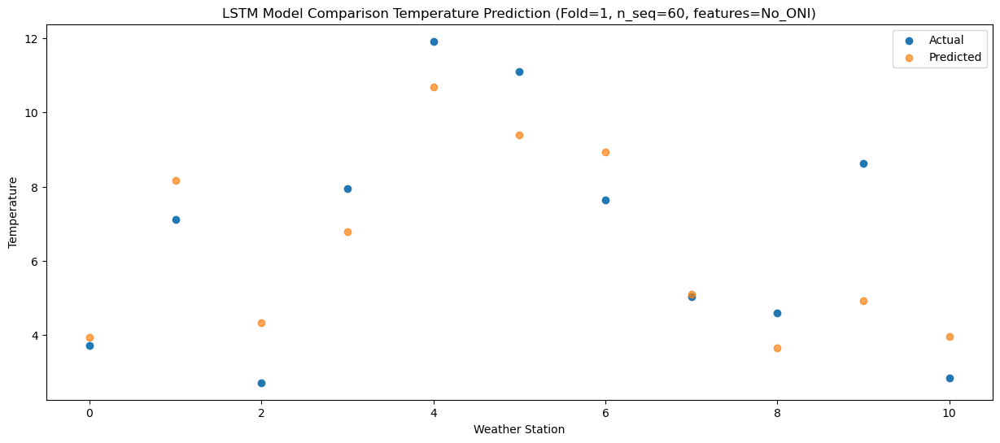

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -2.658384
1                 1    0.22   1.587587
2                 2   -4.34  -2.264106
3                 3    1.76   0.212214
4                 4    5.56   4.104209
5                 5    4.35   2.812405
6                 6    0.44   2.340562
7                 7   -1.57  -1.480755
8                 8   -2.09  -2.916033
9                 9    1.36  -1.662868
10               10   -4.16  -2.629746


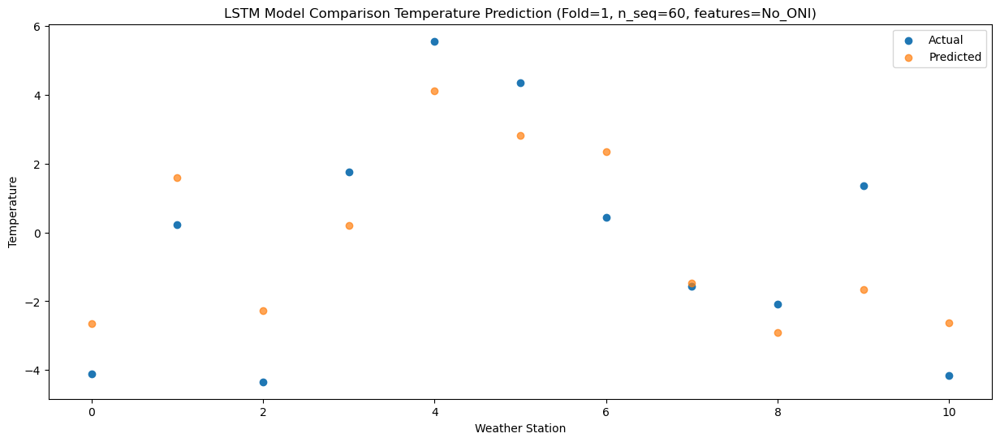

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -4.022593
1                 1    0.02   0.222766
2                 2   -3.92  -3.630041
3                 3    1.66  -1.149780
4                 4    5.55   2.745987
5                 5    2.84   1.445788
6                 6    0.24   0.979147
7                 7   -1.88  -2.845048
8                 8   -2.44  -4.284887
9                 9    1.47  -3.036643
10               10   -6.00  -3.991782


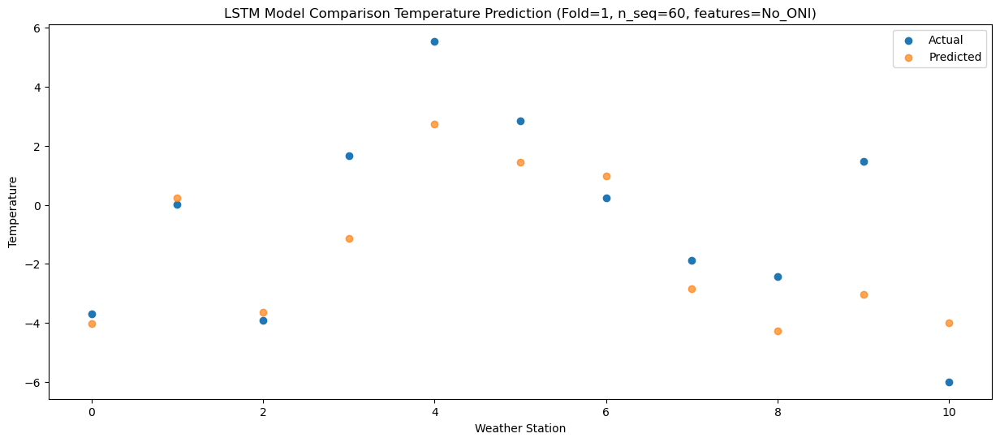

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -6.418491
1                 1    0.68  -2.173171
2                 2   -3.43  -6.023042
3                 3    0.07  -3.548087
4                 4    3.85   0.350722
5                 5    3.22  -0.940632
6                 6    1.02  -1.408001
7                 7   -4.88  -5.243415
8                 8   -7.22  -6.687547
9                 9   -2.90  -5.434736
10               10   -6.96  -6.392725


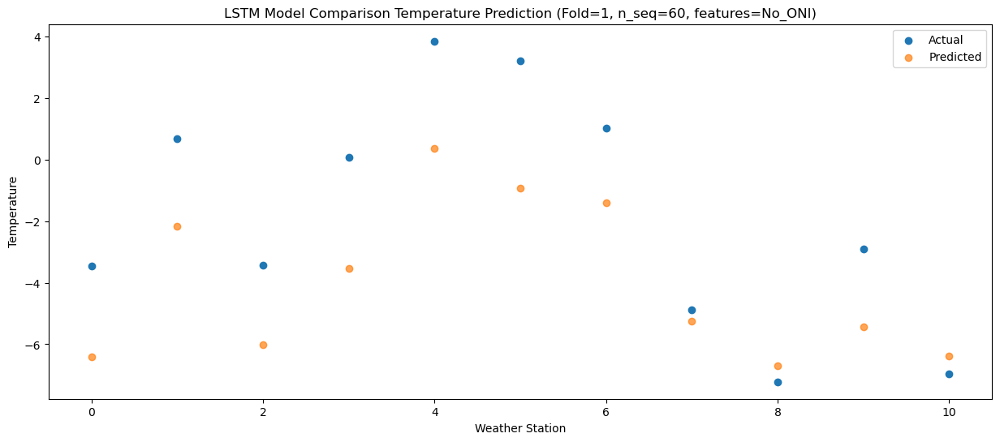

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   3.318499
1                 1    7.45   7.564293
2                 2    3.63   3.716028
3                 3    7.44   6.183177
4                 4   11.46  10.084642
5                 5   10.56   8.793998
6                 6    7.30   8.324592
7                 7    6.44   4.489010
8                 8    5.34   3.047129
9                 9    7.81   4.298914
10               10    0.26   3.332669


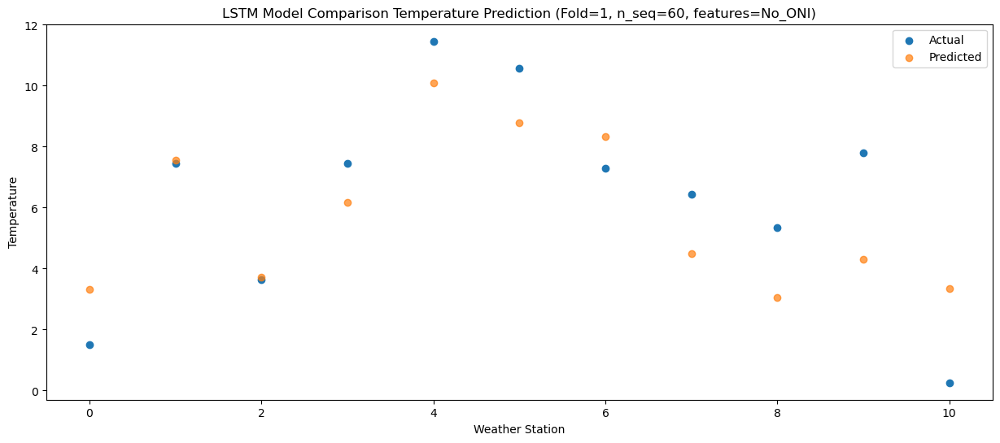

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   6.552501
1                 1    9.59  10.798279
2                 2    5.03   6.950617
3                 3    9.78   9.412230
4                 4   13.76  13.310321
5                 5   12.83  12.024597
6                 6    9.87  11.554568
7                 7    8.15   7.721139
8                 8    7.14   6.274593
9                 9   11.57   7.525586
10               10    4.91   6.560476


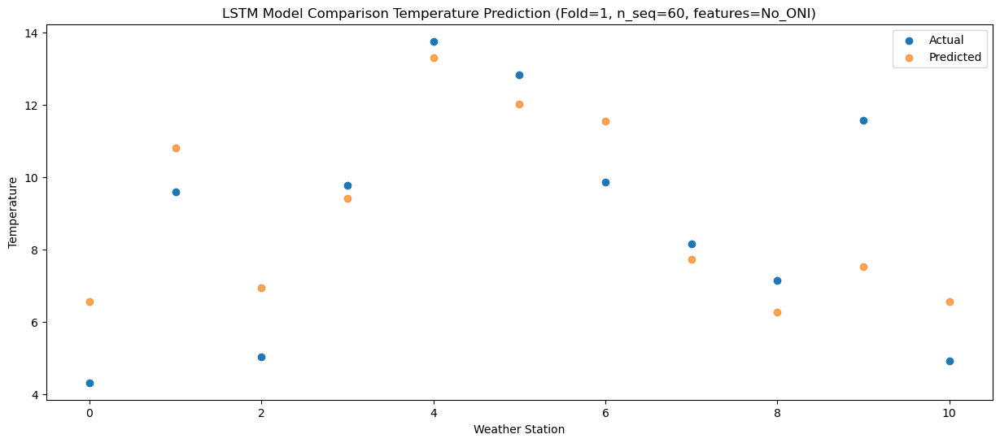

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  11.095231
1                 1   13.32  15.341832
2                 2    9.15  11.496786
3                 3   13.67  13.952693
4                 4   17.88  17.850880
5                 5   18.42  16.562257
6                 6   13.64  16.092417
7                 7   12.81  12.260645
8                 8   11.95  10.817306
9                 9   16.12  12.065446
10               10    9.45  11.093648


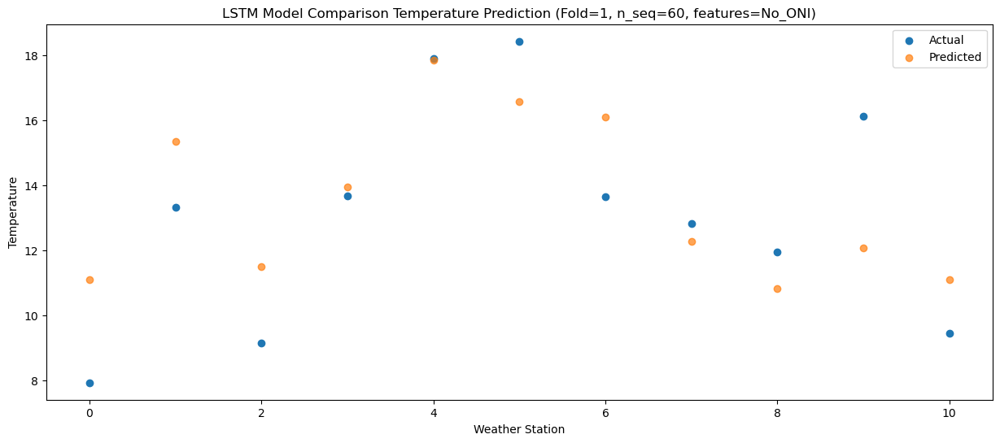

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  17.517536
1                 1   17.46  21.761140
2                 2   13.03  17.910547
3                 3   17.56  20.360356
4                 4   21.35  24.255954
5                 5   22.69  22.972656
6                 6   17.65  22.508575
7                 7   18.89  18.672871
8                 8   17.98  17.231182
9                 9   23.23  18.482660
10               10   15.54  17.516693


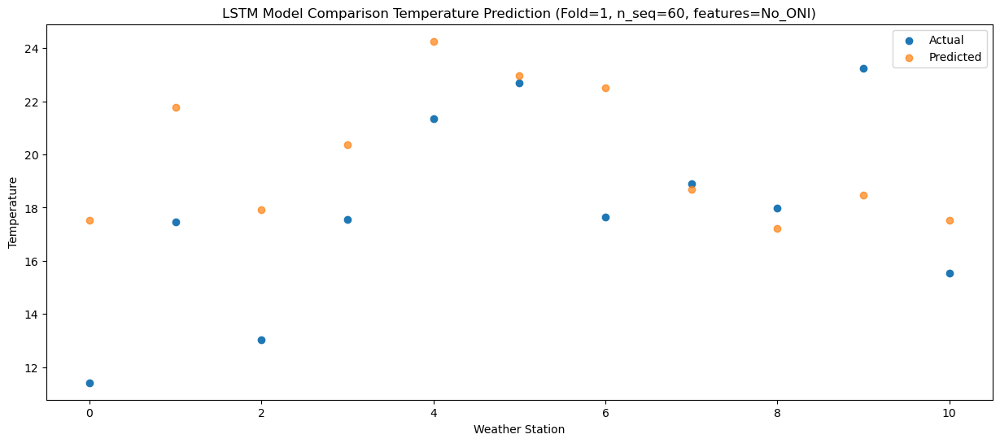

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  18.207616
1                 1   18.84  22.447144
2                 2   13.80  18.594348
3                 3   17.44  21.044081
4                 4   21.44  24.936172
5                 5   22.03  23.646998
6                 6   19.01  23.183599
7                 7   19.88  19.348897
8                 8   19.49  17.910415
9                 9   23.90  19.167999
10               10   17.77  18.210114


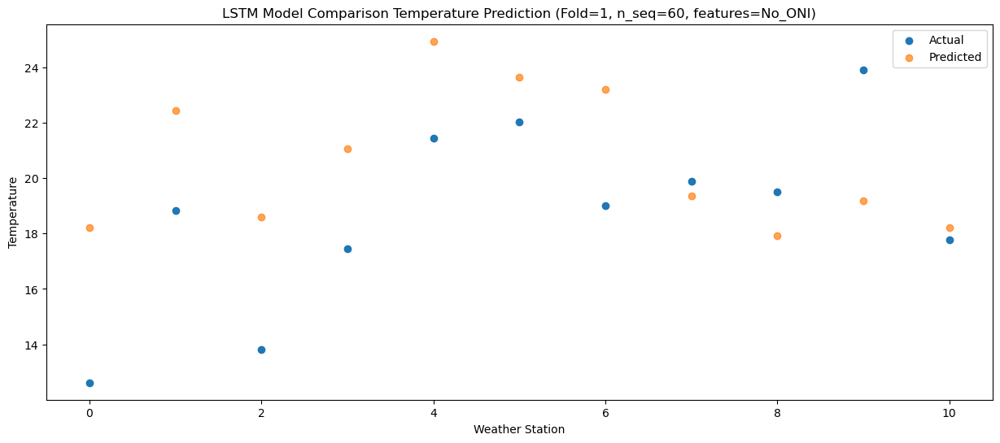

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  18.659181
1                 1   19.11  22.900539
2                 2   14.46  19.048228
3                 3   18.41  21.508017
4                 4   22.41  25.398234
5                 5   21.44  24.116777
6                 6   19.27  23.645716
7                 7   21.10  19.821405
8                 8   19.88  18.390237
9                 9   23.75  19.649966
10               10   17.55  18.687742


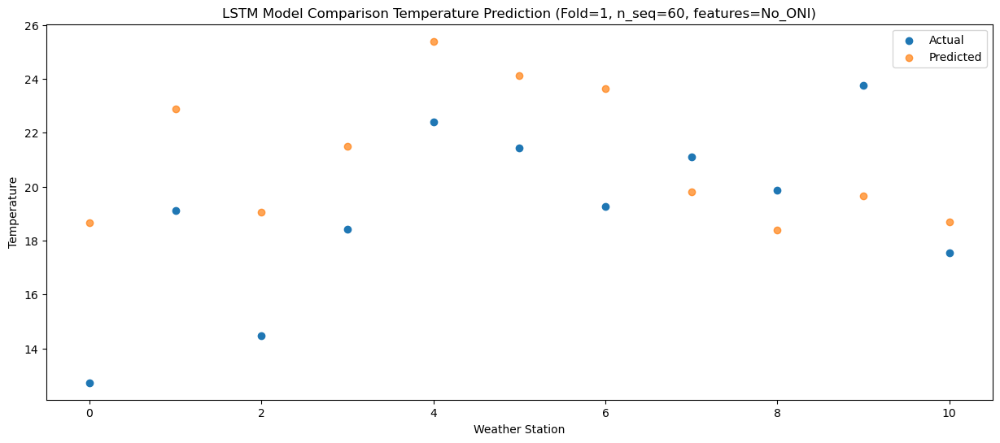

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  14.959003
1                 1   15.37  19.197056
2                 2   11.44  15.344097
3                 3   15.40  17.802913
4                 4   18.83  21.691583
5                 5   21.08  20.416429
6                 6   15.94  19.941297
7                 7   17.39  16.120592
8                 8   17.37  14.689444
9                 9   21.80  15.959589
10               10   13.85  14.992492


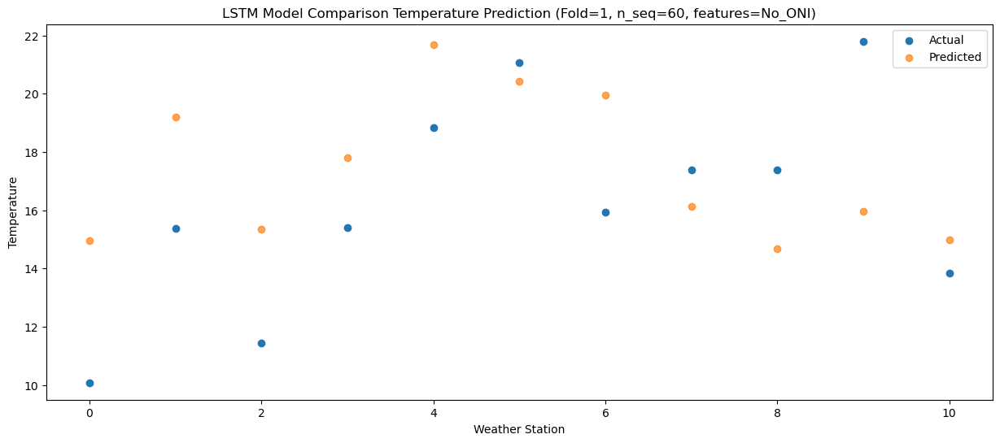

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38  10.276995
1                 1   11.59  14.516822
2                 2    7.66  10.665306
3                 3   12.71  13.119786
4                 4   15.79  17.007543
5                 5   16.76  15.731709
6                 6   11.99  15.257326
7                 7   12.19  11.439290
8                 8   11.12  10.003727
9                 9   14.36  11.272183
10               10    9.43  10.316526


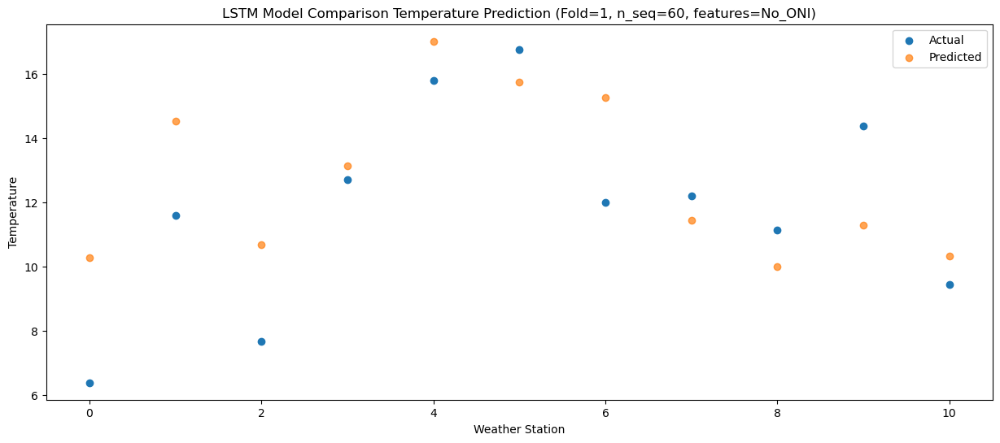

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83   1.504803
1                 1    3.93   5.738566
2                 2   -0.08   1.882450
3                 3    5.55   4.336085
4                 4    8.24   8.224318
5                 5   10.29   6.942628
6                 6    4.39   6.470148
7                 7    2.89   2.653822
8                 8    3.37   1.220972
9                 9    8.11   2.491935
10               10    0.11   1.541499


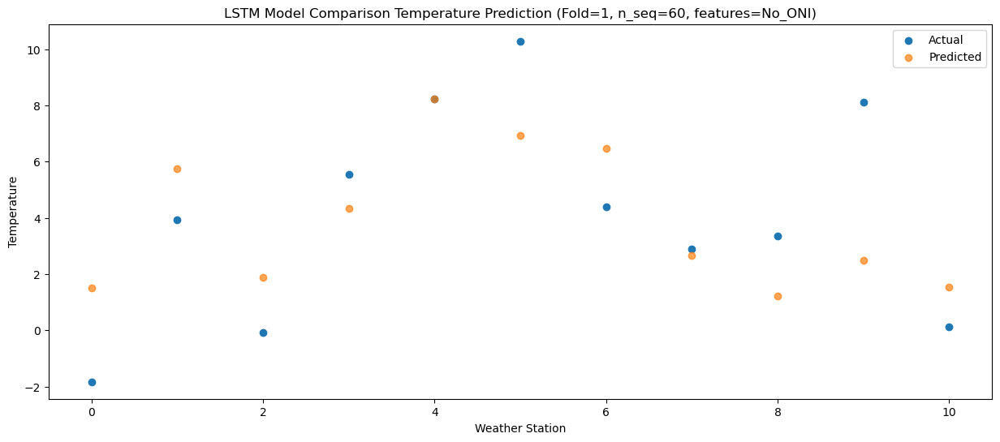

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52   1.134205
1                 1    5.56   5.363027
2                 2    2.52   1.502365
3                 3    8.92   3.962369
4                 4   12.12   7.853299
5                 5   10.55   6.572898
6                 6    5.91   6.094172
7                 7    5.30   2.280670
8                 8    2.56   0.843918
9                 9    6.50   2.114361
10               10   -0.66   1.164124


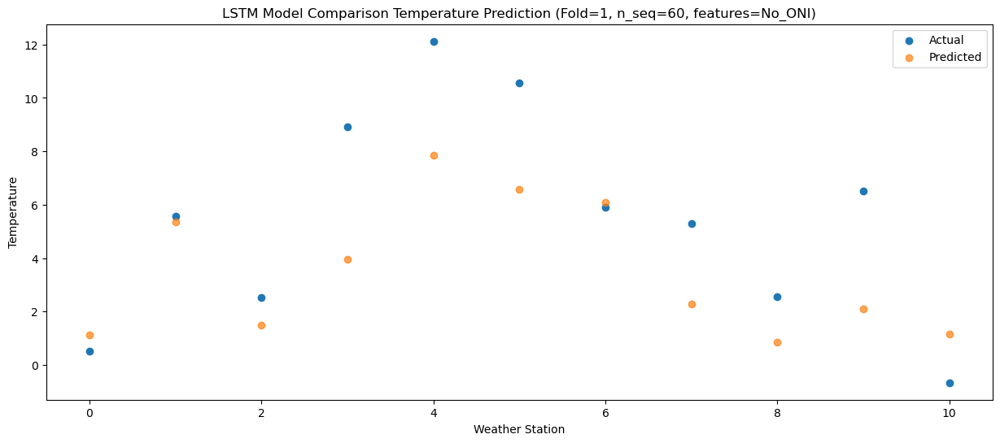

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -6.581916
1                 1   -1.17  -2.354764
2                 2   -4.37  -6.212468
3                 3    0.87  -3.745770
4                 4    3.64   0.146947
5                 5    3.23  -1.133290
6                 6   -0.48  -1.619357
7                 7   -3.53  -5.425694
8                 8   -5.06  -6.858253
9                 9   -0.42  -5.586209
10               10   -7.68  -6.547957


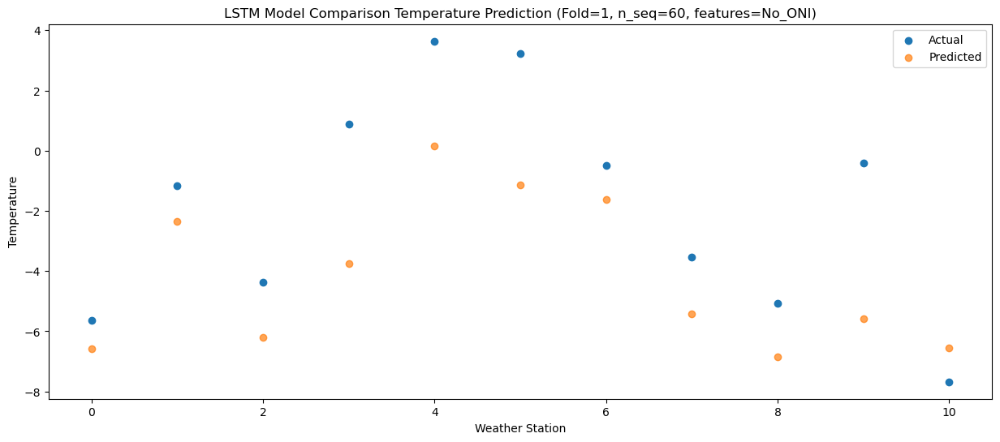

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -3.808536
1                 1    3.06   0.413924
2                 2   -1.02  -3.445792
3                 3    0.40  -0.964353
4                 4    3.33   2.927648
5                 5    3.12   1.648919
6                 6    3.33   1.154390
7                 7   -1.48  -2.654416
8                 8   -4.08  -4.085703
9                 9   -0.36  -2.813407
10               10   -3.78  -3.784716


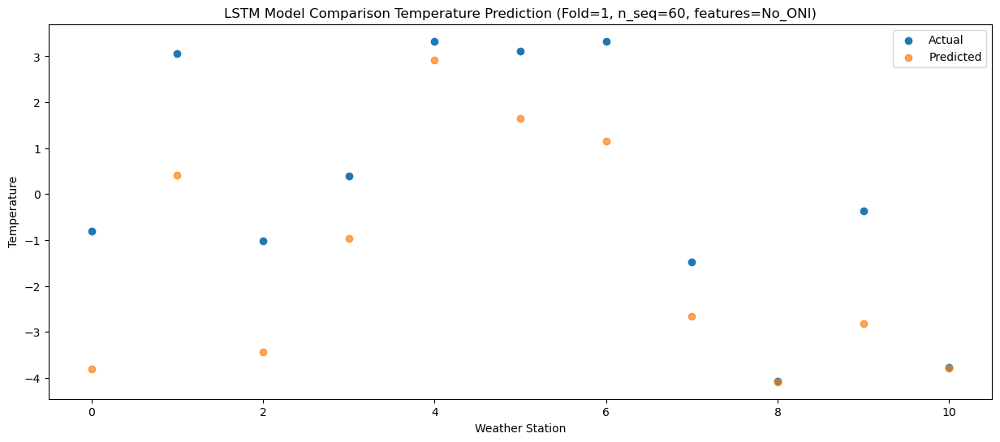

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.035034
1                 1    6.63   6.255876
2                 2    2.98   2.394651
3                 3    6.24   4.881915
4                 4    9.11   8.777762
5                 5   10.07   7.514793
6                 6    7.17   7.008947
7                 7    4.47   3.201309
8                 8    3.17   1.767264
9                 9    6.57   3.041366
10               10    0.78   2.077362


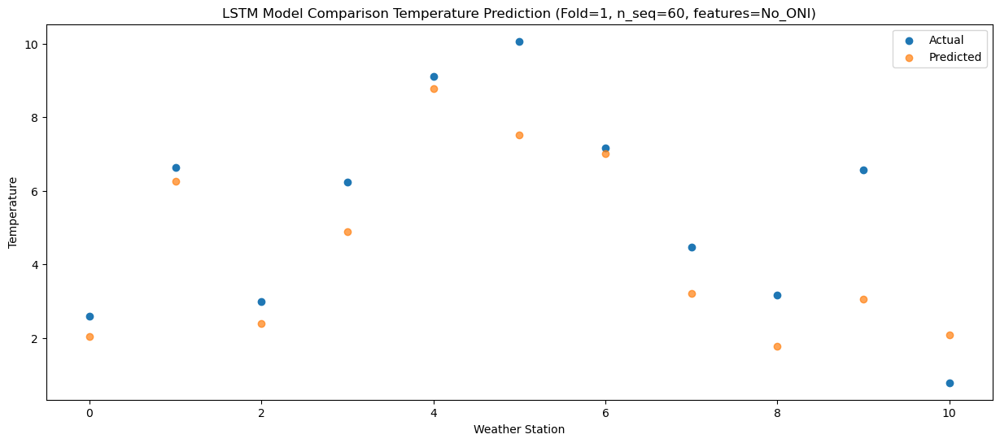

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   6.200641
1                 1    9.63  10.421698
2                 2    6.57   6.562451
3                 3   12.24   9.037736
4                 4   15.38  12.932177
5                 5   16.98  11.672657
6                 6    9.93  11.171714
7                 7    9.66   7.360669
8                 8   10.28   5.924030
9                 9   13.05   7.199226
10               10    4.13   6.237726


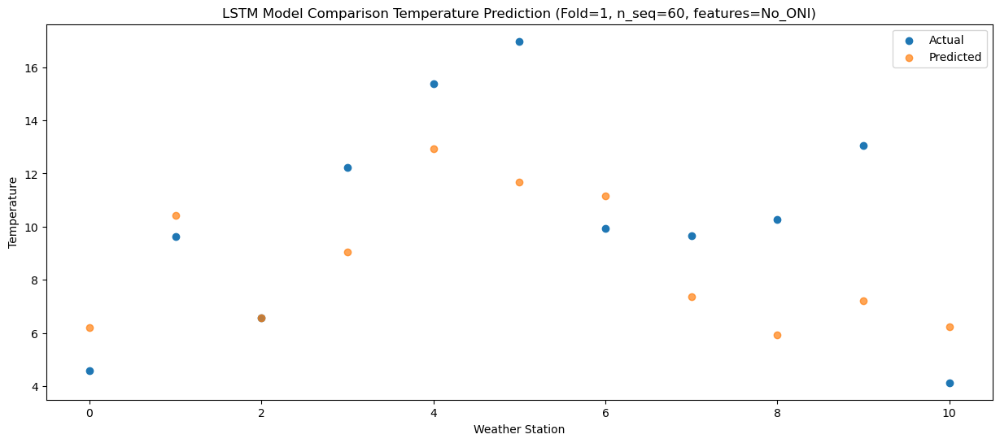

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  13.203749
1                 1   15.51  17.426755
2                 2   11.93  13.573220
3                 3   16.67  16.047338
4                 4   20.00  19.941357
5                 5   22.38  18.677107
6                 6   15.85  18.176546
7                 7   15.13  14.368123
8                 8   15.64  12.928190
9                 9   18.50  14.203783
10               10   11.11  13.229641


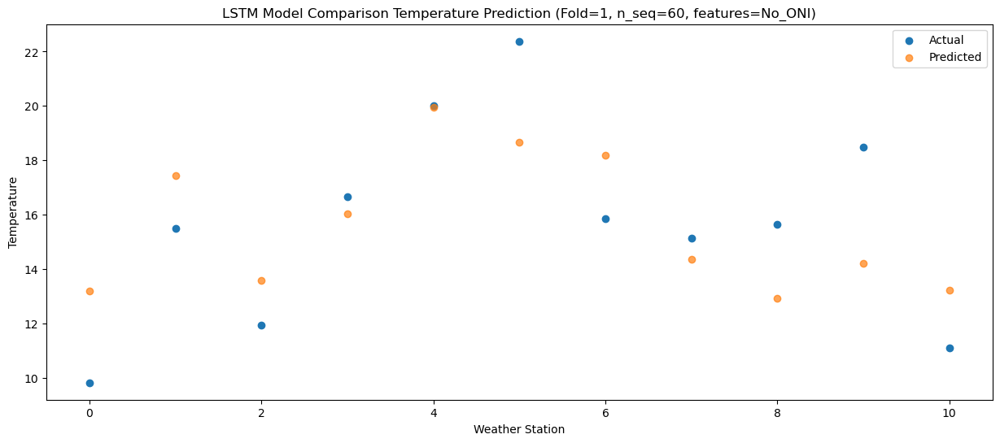

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  17.261429
1                 1   19.48  21.488636
2                 2   14.90  17.633233
3                 3   19.67  20.103351
4                 4   23.37  23.994891
5                 5   24.44  22.729287
6                 6   19.43  22.230183
7                 7   19.19  18.425866
8                 8   19.93  16.983984
9                 9   23.07  18.259229
10               10   15.50  17.293405


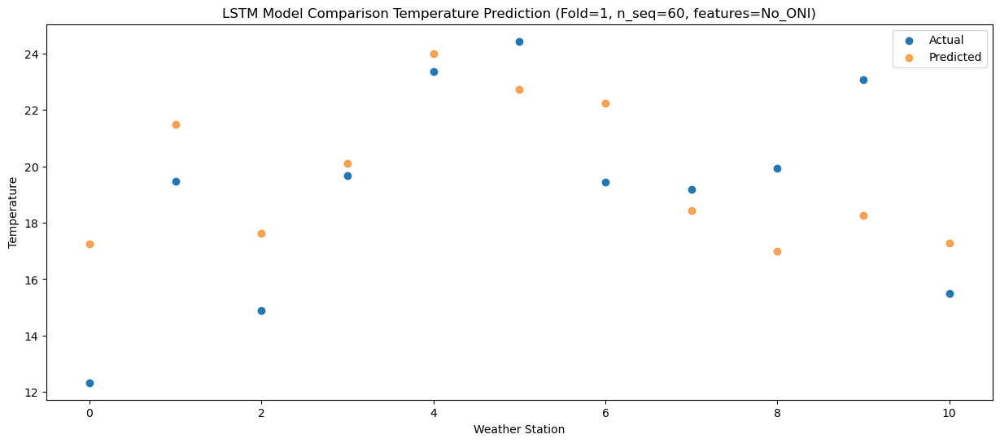

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  19.754858
1                 1   19.98  23.981727
2                 2   15.61  20.128771
3                 3   20.61  22.604334
4                 4   24.46  26.496901
5                 5   25.36  25.235197
6                 6   20.17  24.730236
7                 7   23.32  20.926743
8                 8   24.08  19.486454
9                 9   26.67  20.757476
10               10   19.44  19.794241


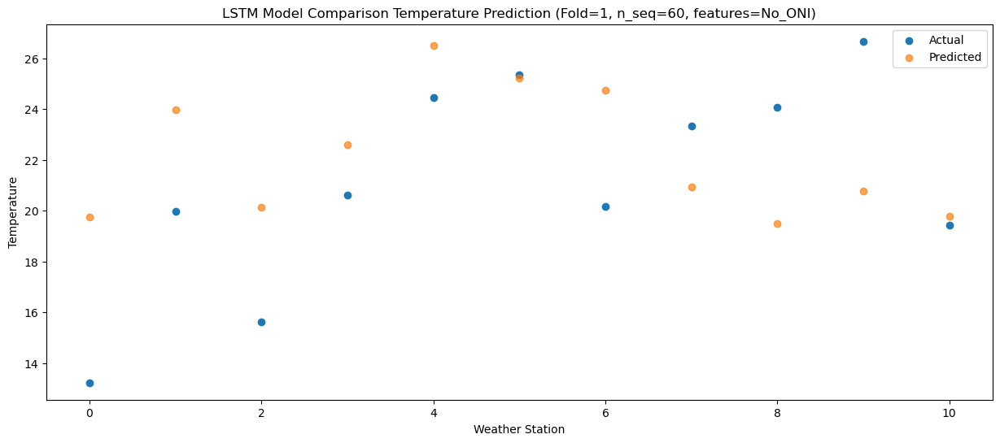

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  18.389161
1                 1   18.52  22.611239
2                 2   14.00  18.757891
3                 3   18.97  21.236412
4                 4   22.45  25.133924
5                 5   22.51  23.873225
6                 6   18.67  23.363392
7                 7   20.45  19.556777
8                 8   21.41  18.120990
9                 9   23.84  19.391085
10               10   18.90  18.430110


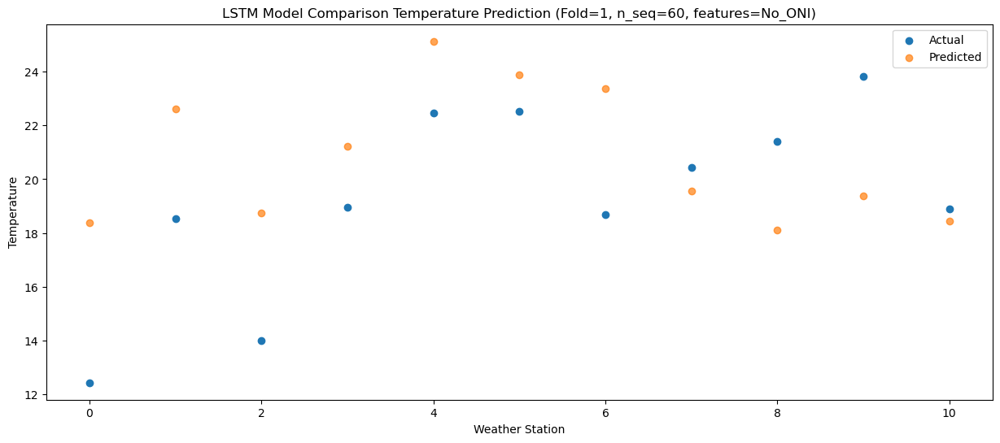

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  14.549668
1                 1   15.43  18.770838
2                 2   11.61  14.918373
3                 3   16.20  17.393962
4                 4   19.27  21.289972
5                 5   19.46  20.028583
6                 6   15.78  19.522124
7                 7   16.61  15.714287
8                 8   17.58  14.281357
9                 9   21.43  15.545186
10               10   13.99  14.583773


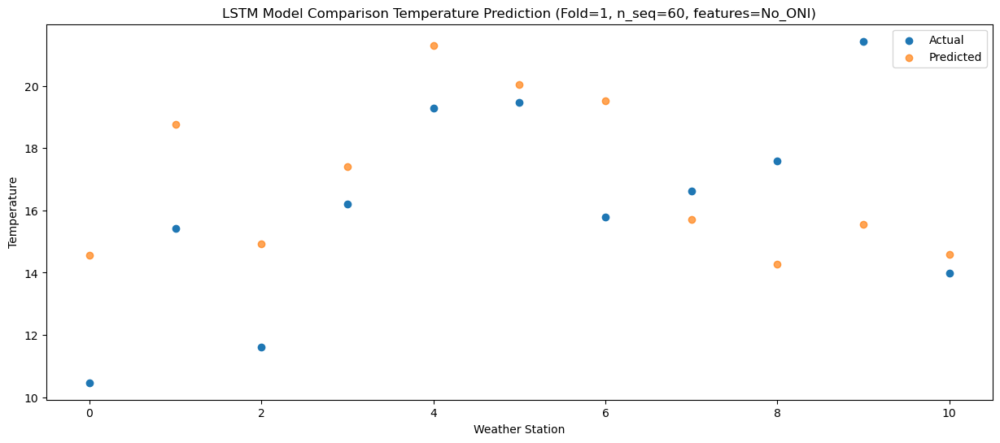

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   7.934844
1                 1    9.09  12.159212
2                 2    4.92   8.308662
3                 3   10.64  10.783296
4                 4   13.88  14.674430
5                 5   13.38  13.407315
6                 6    9.44  12.901666
7                 7    9.94   9.090979
8                 8    9.35   7.658104
9                 9   12.89   8.925388
10               10    5.89   7.967912


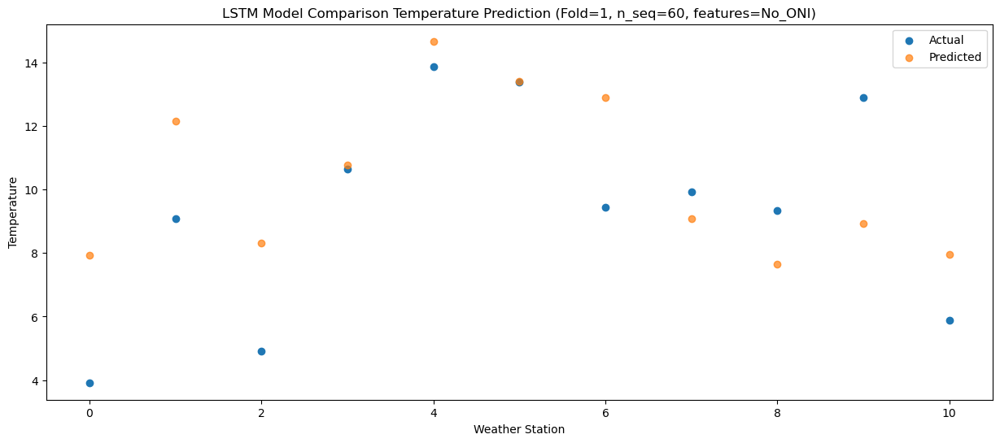

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72   2.461683
1                 1    6.09   6.685167
2                 2    1.60   2.829947
3                 3    5.59   5.299574
4                 4    8.88   9.188104
5                 5    6.42   7.911482
6                 6    6.55   7.412801
7                 7    3.34   3.605392
8                 8    1.50   2.169481
9                 9    3.90   3.430661
10               10    2.38   2.481150


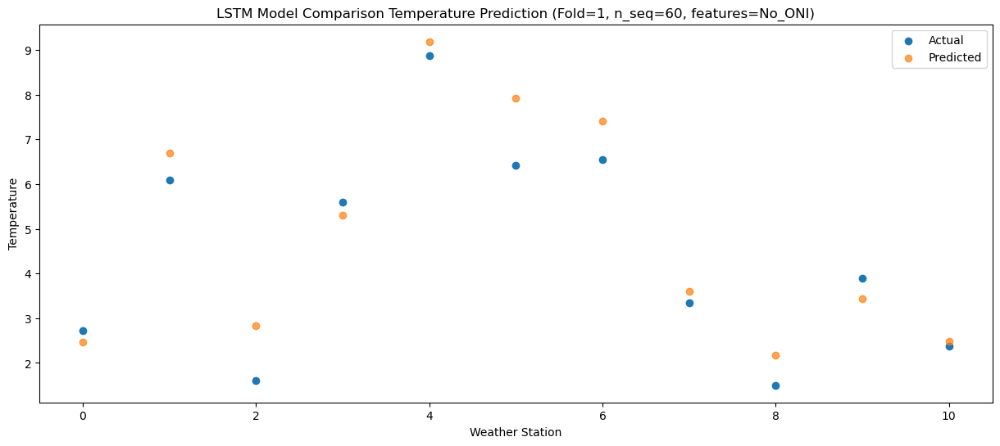

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -2.995102
1                 1    0.28   1.226974
2                 2   -1.56  -2.630163
3                 3    3.50  -0.161672
4                 4    6.86   3.725281
5                 5    5.30   2.448519
6                 6    0.54   1.946729
7                 7   -0.40  -1.853913
8                 8   -2.13  -3.283669
9                 9    1.55  -2.022677
10               10   -4.77  -2.973985


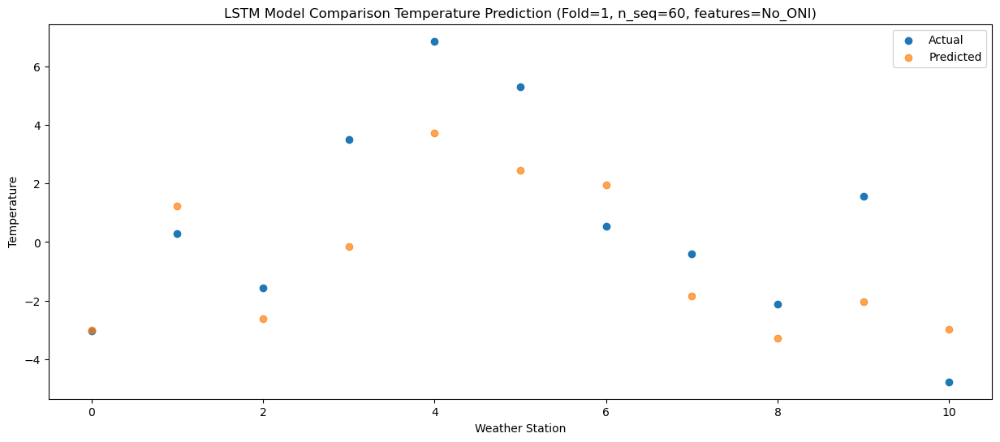

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -1.334394
1                 1    2.47   2.891028
2                 2   -0.56  -0.968618
3                 3    4.21   1.504298
4                 4    7.34   5.392158
5                 5    5.76   4.121573
6                 6    2.67   3.614605
7                 7    0.79  -0.184710
8                 8   -1.27  -1.602121
9                 9    1.83  -0.339238
10               10   -1.81  -1.291323


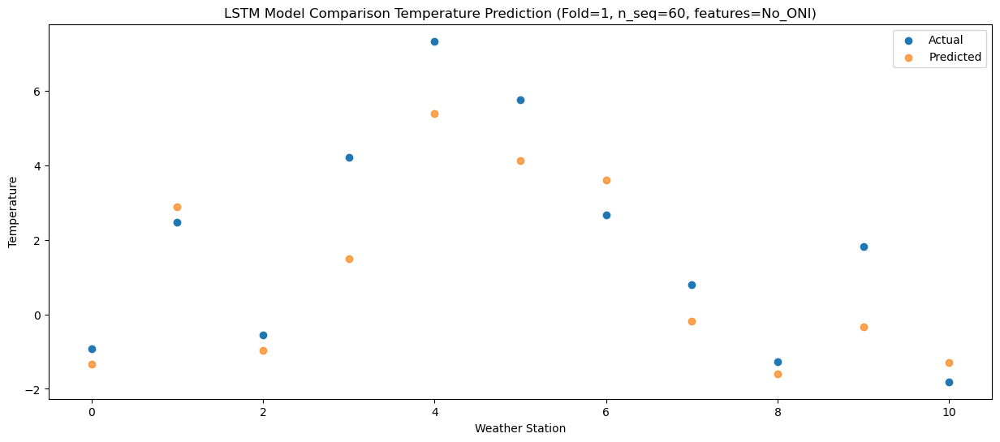

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -0.522414
1                 1    5.84   3.699555
2                 2    2.03  -0.165646
3                 3    5.21   2.299630
4                 4    8.52   6.185087
5                 5    5.90   4.928716
6                 6    6.26   4.418050
7                 7    2.29   0.616827
8                 8   -0.90  -0.796265
9                 9    2.98   0.467896
10               10   -2.13  -0.489774


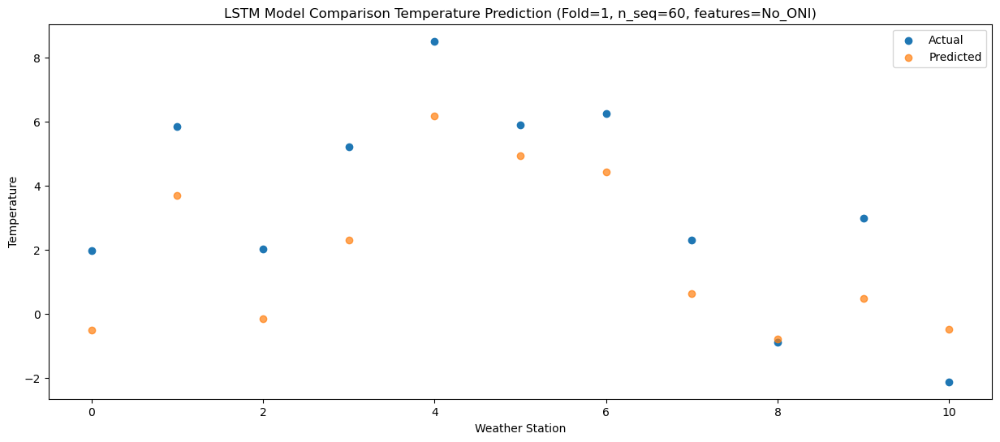

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62   1.392501
1                 1    6.61   5.621898
2                 2    3.46   1.761585
3                 3    9.04   4.233199
4                 4   12.34   8.122456
5                 5   10.96   6.866970
6                 6    6.93   6.353196
7                 7    5.12   2.557744
8                 8    3.53   1.148660
9                 9    6.71   2.417503
10               10   -1.01   1.456567


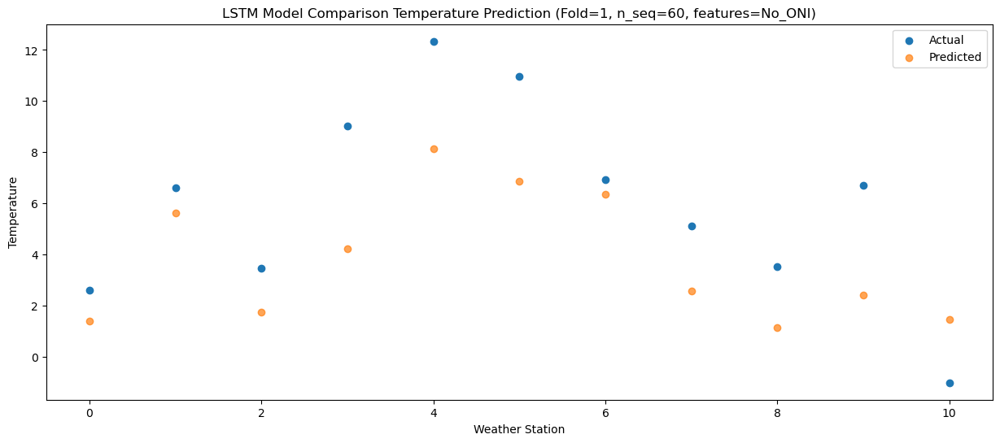

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   7.418001
1                 1    9.88  11.647175
2                 2    6.15   7.790147
3                 3    9.88  10.258165
4                 4   13.30  14.147676
5                 5   14.12  12.894702
6                 6   10.19  12.382762
7                 7    9.52   8.583915
8                 8    7.86   7.175715
9                 9   12.06   8.452067
10               10    6.21   7.492806


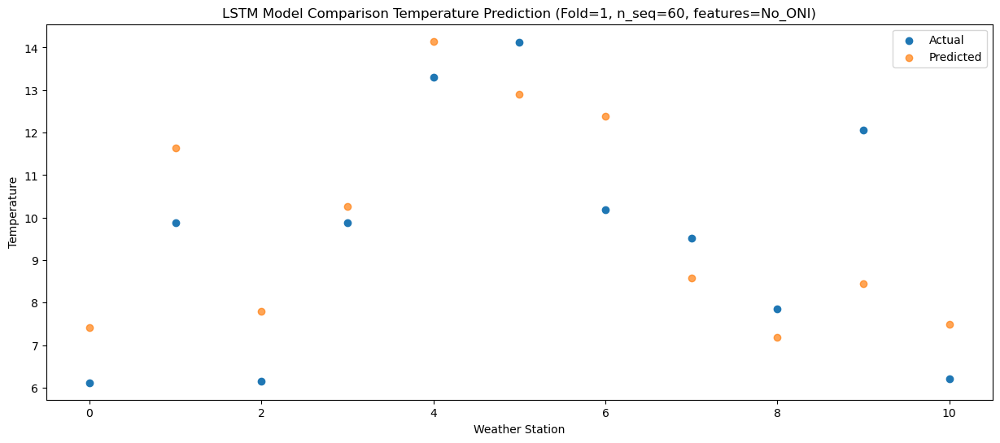

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62  12.334004
1                 1   13.16  16.561484
2                 2    9.39  12.704729
3                 3   14.47  15.169500
4                 4   17.94  19.056283
5                 5   18.73  17.808171
6                 6   13.19  17.298101
7                 7   14.87  13.501632
8                 8   13.55  12.099032
9                 9   17.17  13.376732
10               10    8.77  12.410127


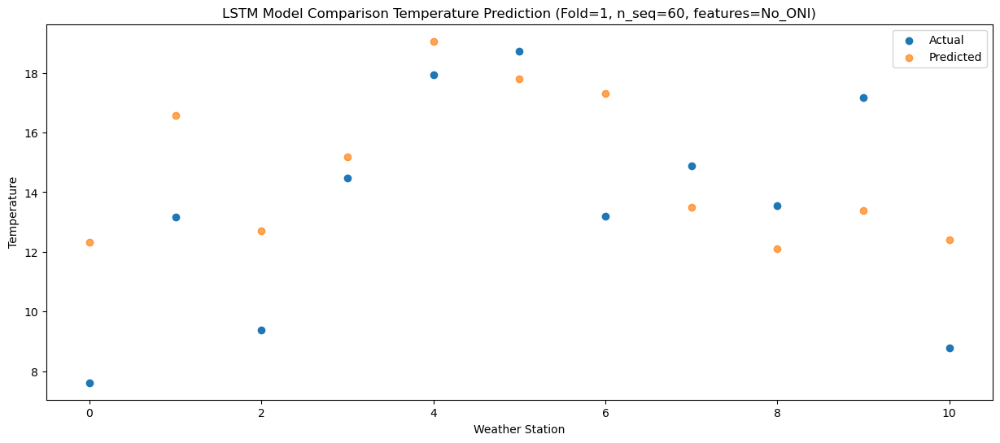

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  16.344526
1                 1   16.35  20.568695
2                 2   13.14  16.712803
3                 3   18.62  19.173283
4                 4   22.83  23.060998
5                 5   25.42  21.818504
6                 6   16.47  21.309194
7                 7   18.68  17.512887
8                 8   18.48  16.110732
9                 9   20.40  17.391945
10               10   13.14  16.430710


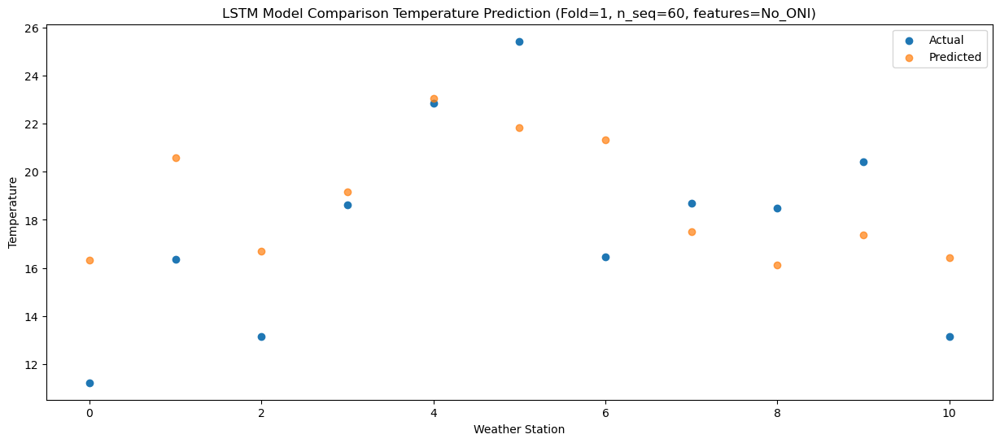

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  19.152389
1                 1   19.95  23.377616
2                 2   15.51  19.524296
3                 3   20.34  21.982825
4                 4   24.78  25.871519
5                 5   26.52  24.631108
6                 6   19.92  24.121851
7                 7   20.98  20.327317
8                 8   21.36  18.921729
9                 9   25.02  20.194273
10               10   18.28  19.227944


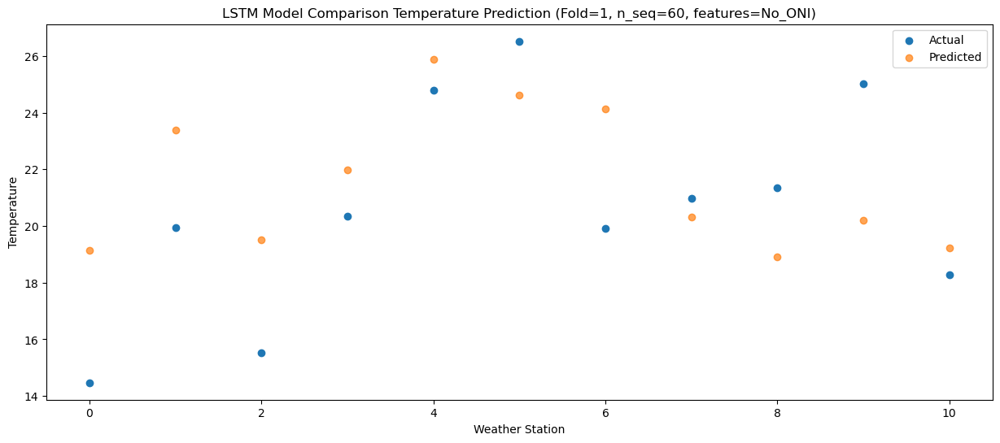

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  18.412751
1                 1   19.41  22.637784
2                 2   15.95  18.785417
3                 3   22.31  21.246495
4                 4   26.21  25.136505
5                 5   25.71  23.889395
6                 6   19.50  23.381937
7                 7   21.48  19.583191
8                 8   23.17  18.176549
9                 9   25.42  19.449594
10               10   16.54  18.478398


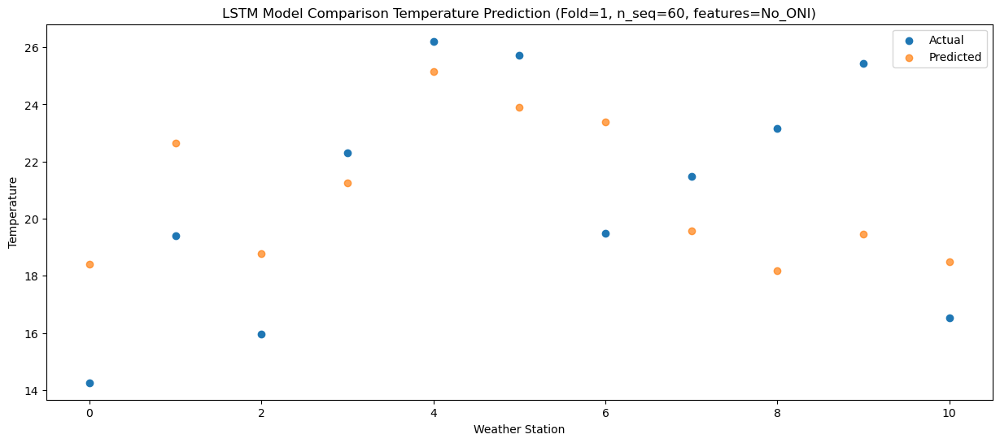

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  15.035514
1                 1   15.90  19.267951
2                 2   12.99  15.417566
3                 3   19.23  17.875789
4                 4   22.36  21.756282
5                 5   23.43  20.511705
6                 6   16.33  20.010922
7                 7   17.86  16.219100
8                 8   18.53  14.813508
9                 9   21.90  16.084948
10               10   13.35  15.113776


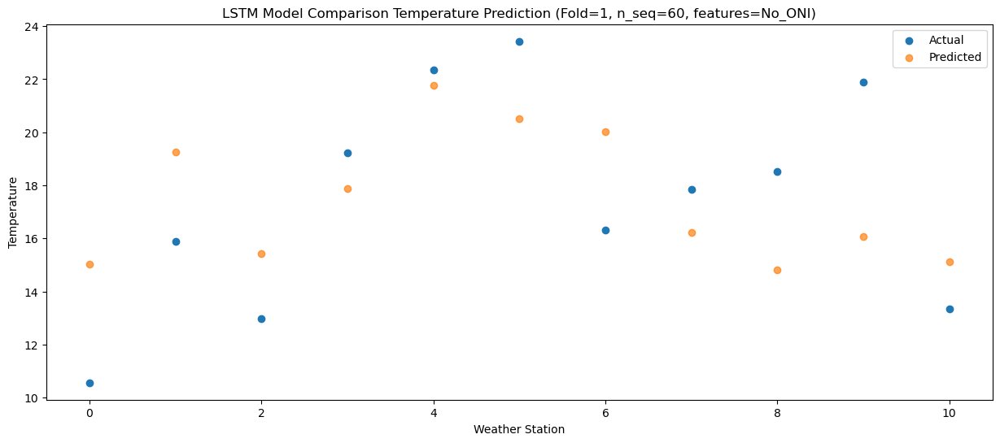

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   8.973591
1                 1   10.89  13.207235
2                 2    6.95   9.359713
3                 3   11.97  11.813413
4                 4   14.96  15.693276
5                 5   15.83  14.456411
6                 6   11.32  13.951905
7                 7   11.55  10.161315
8                 8    9.95   8.760333
9                 9   13.80  10.034775
10               10    8.00   9.058327


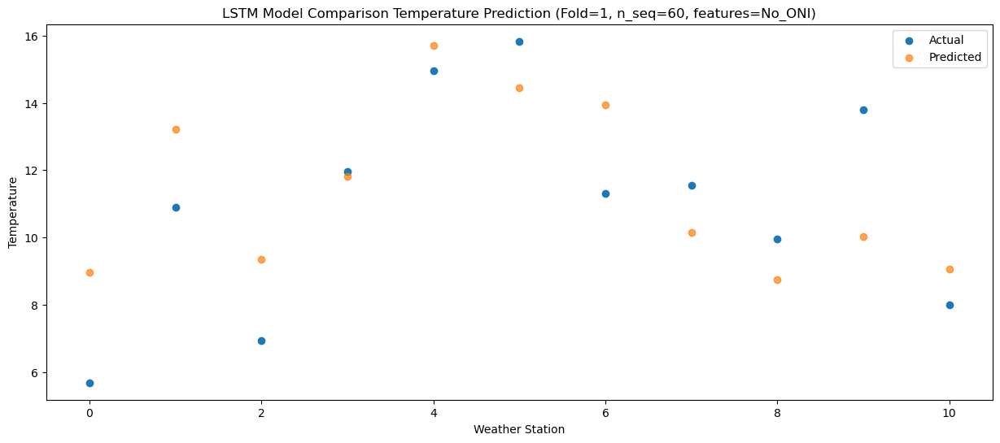

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54   2.219317
1                 1    5.27   6.453391
2                 2    0.39   2.605531
3                 3    5.69   5.061658
4                 4    8.76   8.943996
5                 5    9.17   7.708448
6                 6    5.63   7.203724
7                 7    4.15   3.417600
8                 8    2.83   2.017309
9                 9    7.05   3.296223
10               10    0.06   2.321951


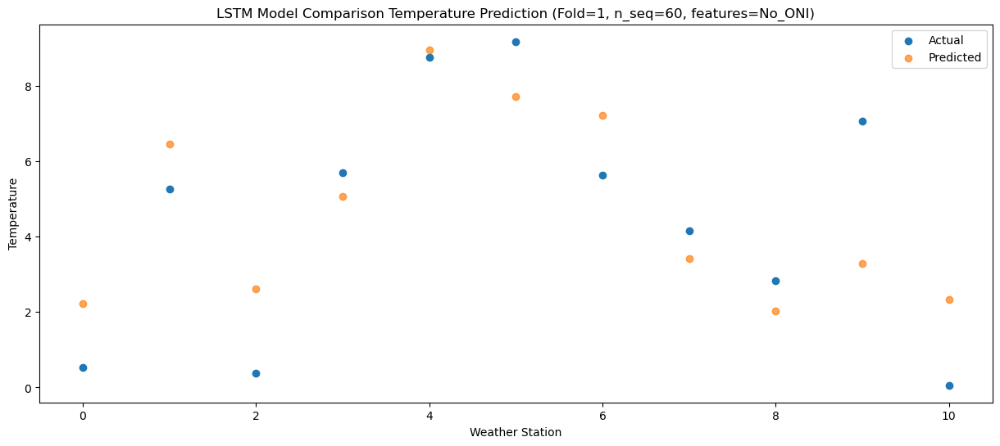

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49   0.372980
1                 1    2.13   4.608314
2                 2   -2.39   0.764098
3                 3    3.29   3.222809
4                 4    6.86   7.111246
5                 5    6.81   5.869475
6                 6    2.89   5.362618
7                 7    1.23   1.575516
8                 8   -0.02   0.173758
9                 9    3.22   1.454114
10               10   -1.63   0.482211


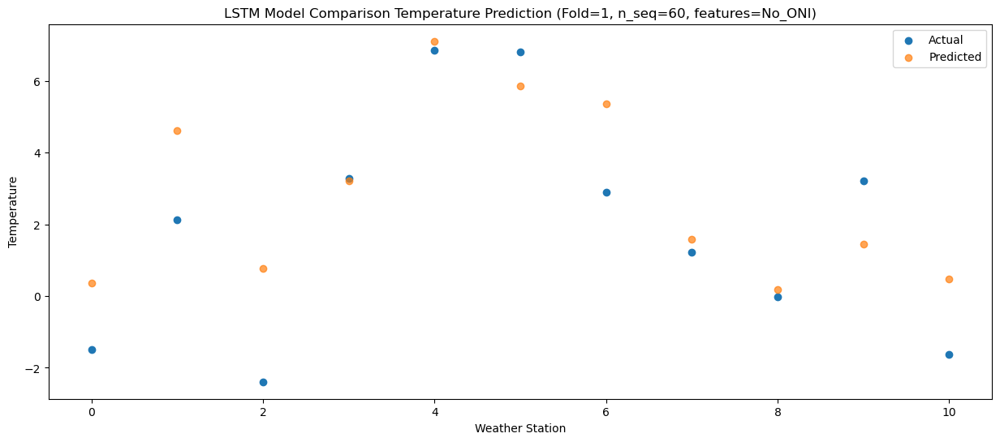

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -4.924154
1                 1   -1.15  -0.689199
2                 2   -5.47  -4.533401
3                 3   -0.13  -2.081632
4                 4    3.01   1.804349
5                 5    3.20   0.561529
6                 6   -0.11   0.061795
7                 7   -4.70  -3.725201
8                 8   -5.85  -5.124160
9                 9   -1.95  -3.839266
10               10   -5.53  -4.810660


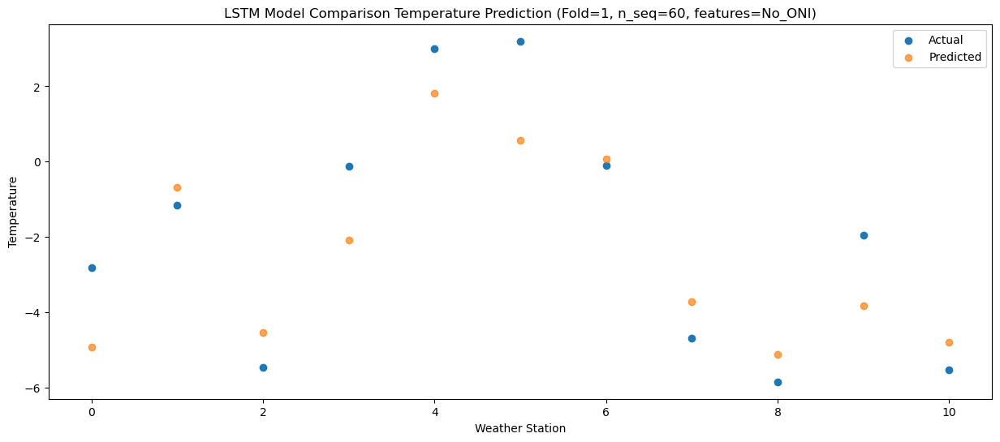

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43   0.643381
1                 1    3.93   4.882148
2                 2   -0.13   1.039007
3                 3    6.18   3.495347
4                 4    9.38   7.376622
5                 5    9.32   6.126432
6                 6    4.10   5.629313
7                 7    4.30   1.851244
8                 8    2.10   0.458624
9                 9    5.76   1.735040
10               10   -3.58   0.754656


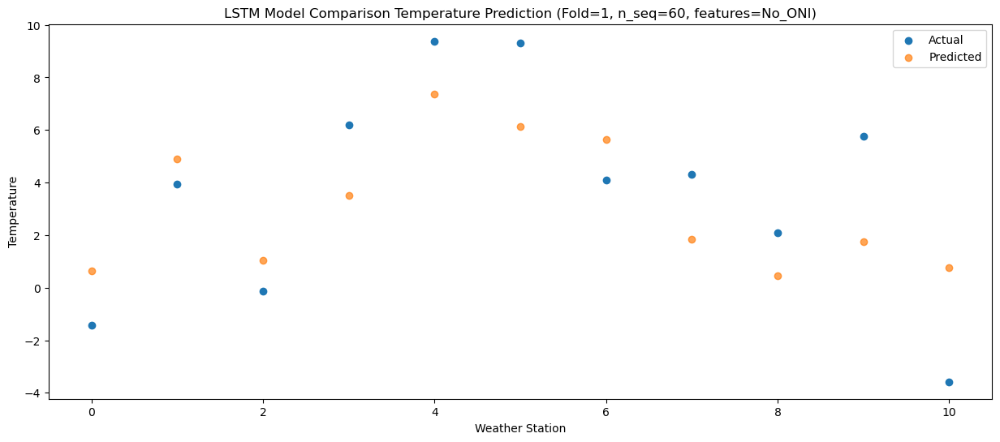

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42   3.777283
1                 1    7.15   8.018924
2                 2    2.97   4.180689
3                 3    8.69   6.636930
4                 4   12.12  10.515254
5                 5   11.67   9.268440
6                 6    7.76   8.771303
7                 7    7.02   4.989111
8                 8    5.34   3.600295
9                 9    8.59   4.880629
10               10    0.82   3.899366


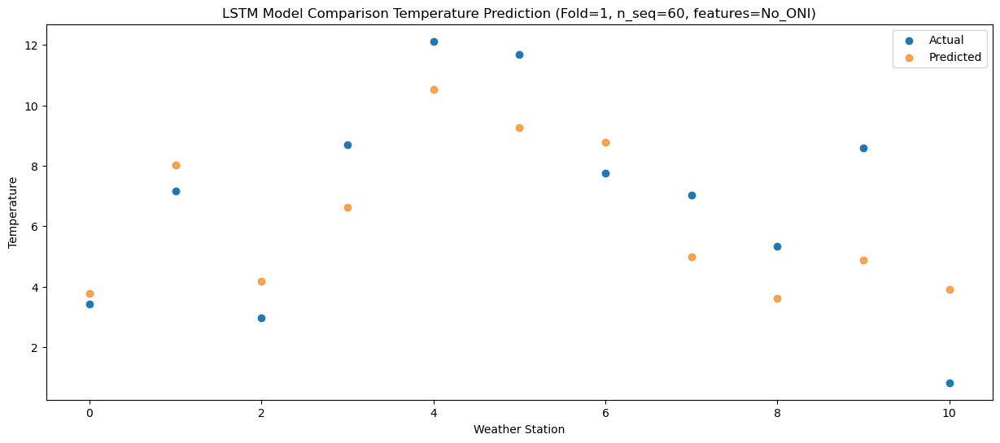

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   8.113703
1                 1   10.82  12.356048
2                 2    6.31   8.521297
3                 3   12.17  10.971890
4                 4   15.68  14.847987
5                 5   16.47  13.604579
6                 6   11.23  13.108644
7                 7   11.06   9.324689
8                 8   10.02   7.942245
9                 9   13.66   9.225750
10               10    5.21   8.247644


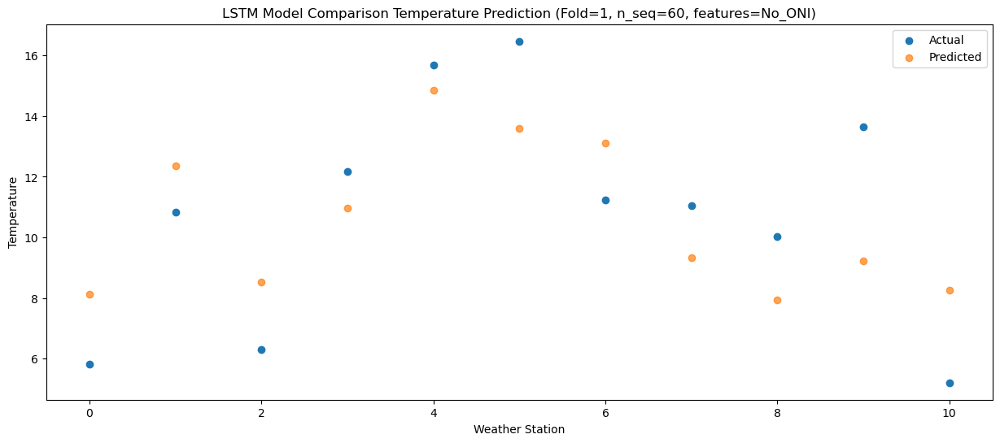

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49  13.654303
1                 1   15.39  17.896291
2                 2   11.92  14.060693
3                 3   15.87  16.514028
4                 4   19.38  20.389968
5                 5   22.09  19.147709
6                 6   15.47  18.647196
7                 7   16.60  14.861956
8                 8   14.78  13.480450
9                 9   17.80  14.761642
10               10   10.80  13.785042


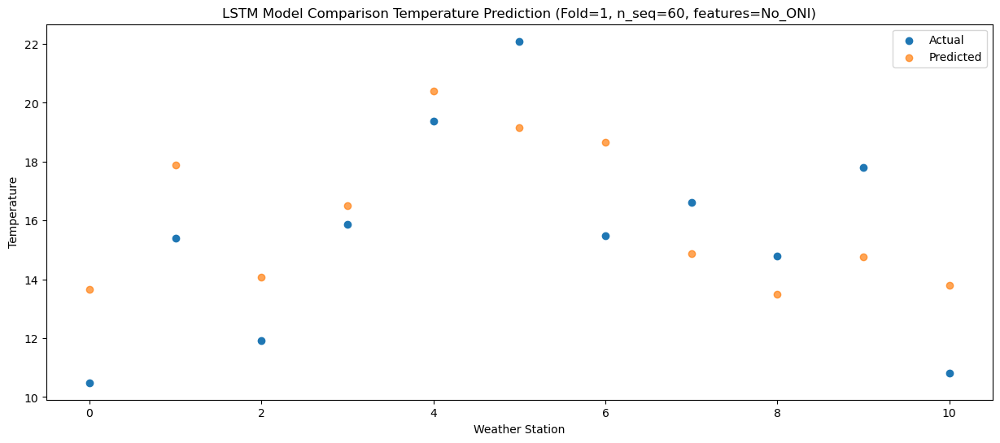

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  17.661806
1                 1   19.15  21.900151
2                 2   15.03  18.063431
3                 3   18.50  20.520465
4                 4   22.27  24.404649
5                 5   24.95  23.167909
6                 6   19.40  22.662694
7                 7   19.67  18.872447
8                 8   20.48  17.499340
9                 9   24.21  18.775143
10               10   16.91  17.790503


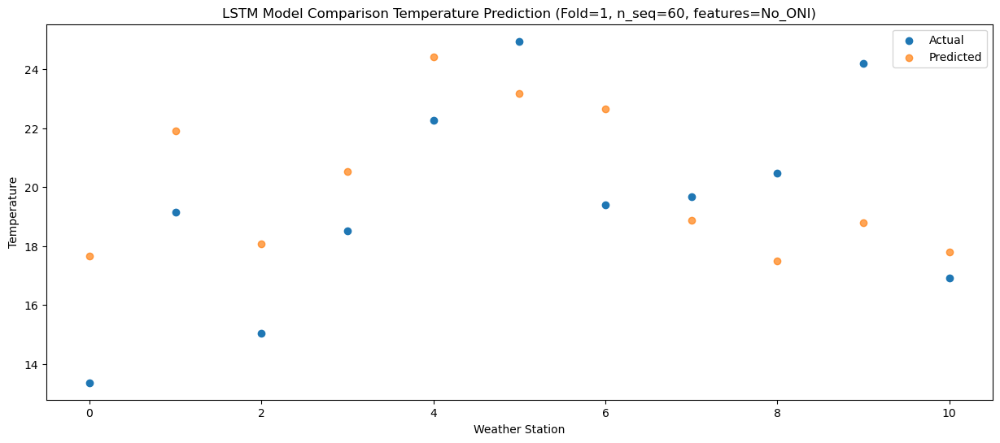

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  18.788759
1                 1   20.08  23.025573
2                 2   15.05  19.188270
3                 3   17.89  21.637837
4                 4   22.08  25.515254
5                 5   23.95  24.283429
6                 6   20.43  23.778177
7                 7   20.31  19.987025
8                 8   21.33  18.605106
9                 9   24.94  19.892636
10               10   18.84  18.915829


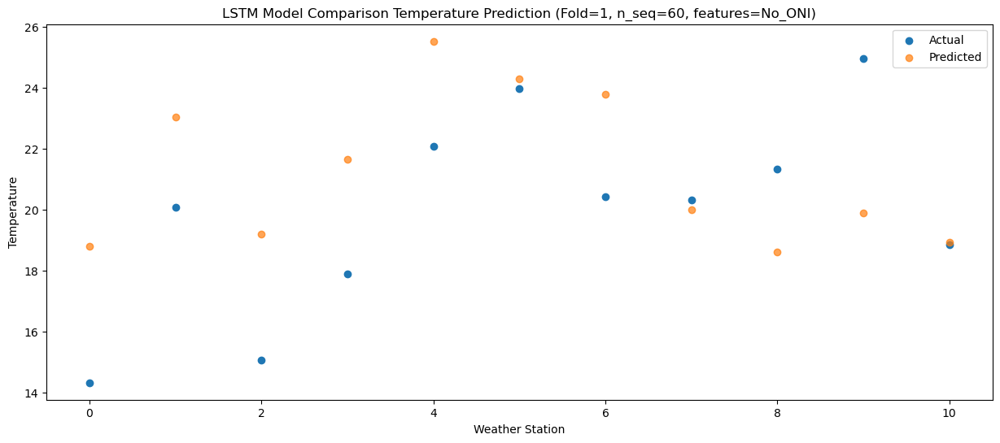

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  17.756632
1                 1   19.80  21.991558
2                 2   15.36  18.150871
3                 3   19.02  20.594106
4                 4   23.40  24.468115
5                 5   25.55  23.238034
6                 6   20.10  22.737054
7                 7   20.72  18.939686
8                 8   23.44  17.552858
9                 9   25.74  18.836081
10               10   16.69  17.868591


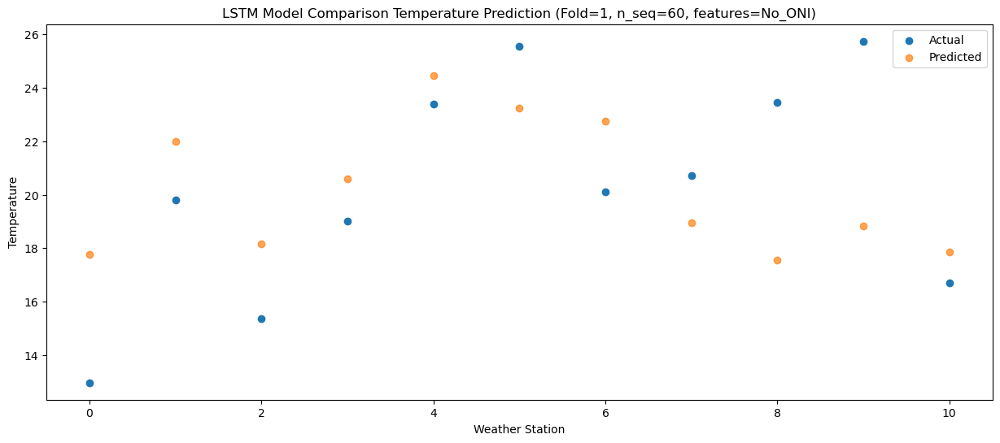

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53  14.913290
1                 1   16.08  19.155640
2                 2   13.05  15.317728
3                 3   16.42  17.765956
4                 4   20.11  21.642565
5                 5   19.84  20.407620
6                 6   16.80  19.907492
7                 7   18.85  16.114852
8                 8   17.47  14.726270
9                 9   21.18  16.003471
10               10   12.96  15.019443


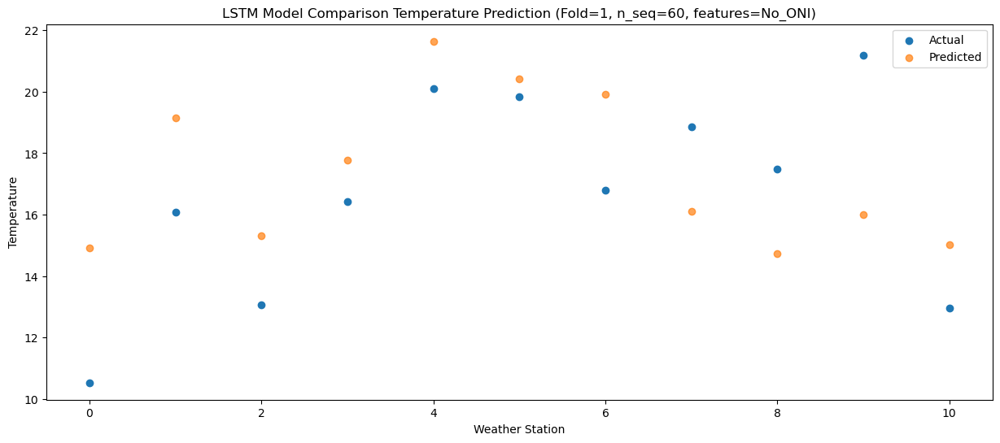

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   9.610113
1                 1   11.63  13.853269
2                 2    8.05  10.013526
3                 3   13.73  12.460118
4                 4   16.96  16.341021
5                 5   18.69  15.109841
6                 6   12.00  14.614152
7                 7   13.38  10.817414
8                 8   13.61   9.422418
9                 9   16.33  10.702387
10               10    8.09   9.724750


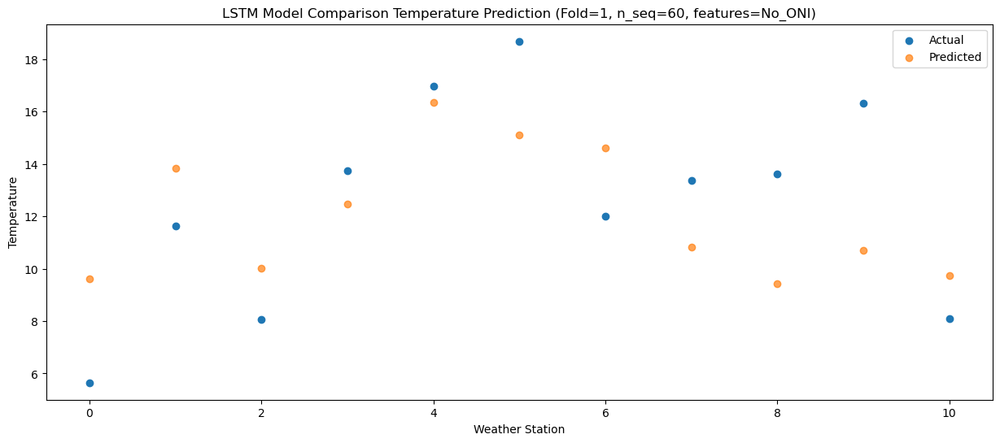

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

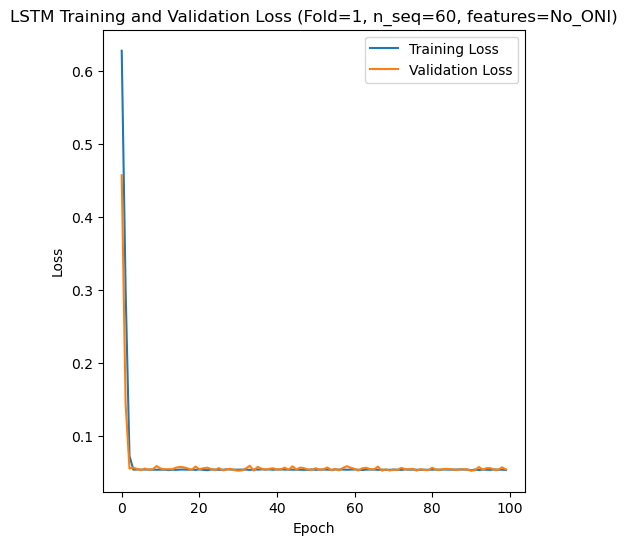

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 29s 136ms/step - loss: 0.5291 - accuracy: 0.0000e+00 - mae: 0.4411 - rmse: 0.5291 - mape: inf - pearson: 0.0184 - val_loss: 0.3790 - val_accuracy: 0.0000e+00 - val_mae: 0.3158 - val_rmse: 0.3790 - val_mape: 66.2385 - val_pearson: 8.1923e-04
Epoch 2/100
84/84 [==============================] - 6s 68ms/step - loss: 0.2324 - accuracy: 0.0000e+00 - mae: 0.1916 - rmse: 0.2324 - mape: inf - pearson: 0.1707 - val_loss: 0.0956 - val_accuracy: 0.0000e+00 - val_mae: 0.0781 - val_rmse: 0.0956 - val_mape: 16.7409 - val_pearson: 0.6839
Epoch 3/100
84/84 [==============================] - 6s 70ms/step - loss: 0.0616 - accuracy: 0.5357 - mae: 0.0491 - rmse: 0.0616 - mape: inf - pearson: 0.

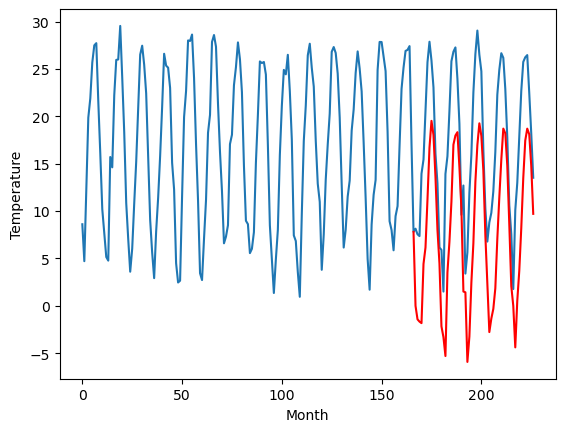

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		0.04		-3.37
1.13		-1.38		-2.51
0.89		-1.63		-2.52
0.16		-1.78		-1.94
8.17		4.47		-3.70
10.40		6.21		-4.19
17.20		11.30		-5.90
24.40		16.75		-7.65
24.43		19.57		-4.86
23.10		18.08		-5.02
16.97		13.66		-3.31
9.98		8.07		-1.91
6.86		4.51		-2.35
0.23		-2.14		-2.37
0.15		-3.27		-3.42
-3.89		-5.27		-1.38
6.30		3.56		-2.74
10.06		6.79		-3.27
15.24		11.03		-4.21
22.49		17.05		-5.44
23.18		18.01		-5.17
23.94		18.36		-5.58
21.70		14.67		-7.03
13.44		10.30		-3.14
6.73		1.53		-5.20
4.34		1.45		-2.89
-0.35		-5.89		-5.54
-0.36		-3.22		-2.86
6.62		2.49		-4.13
13.30		6.64		-6.66
19.10		13.11		-5.99
22.90		17.00		-5.90
26.14		19.29		-6.85
23.83		17.97		-5.86
21.07		14.33		-6.74
12.69		7.48		-5.21
2.70		2.38		-0.32
-0.01		-2.77		-2.76
-0.26		-1.34		-1.08
1.34		-0.32		-1.66
5.41		1.85		-3.56
11.27		7.08		-4.19
16.76		11.45		-5.31
19.37		15.42		-3.95
23.47		18.70		-4.77
23.96		18.20		-5.76
21.09		14.77		-6

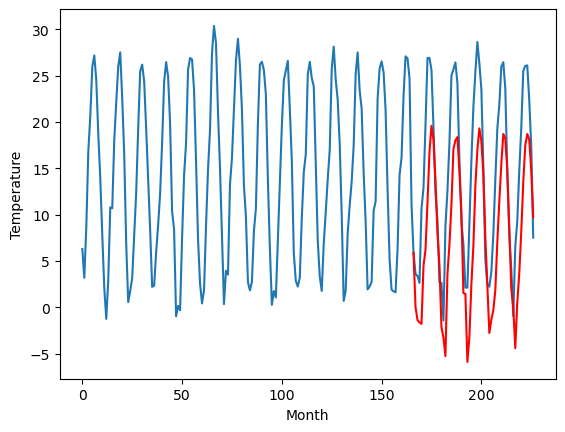

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-2.30		-2.20
-1.22		-3.72		-2.50
-2.37		-3.98		-1.61
-1.33		-4.14		-2.81
2.29		2.11		-0.18
3.68		3.84		0.16
4.99		8.93		3.94
7.58		14.36		6.78
8.22		17.18		8.96
7.91		15.70		7.79
6.65		11.28		4.63
5.38		5.68		0.30
1.96		2.12		0.16
-5.03		-4.52		0.51
-4.37		-5.66		-1.29
-1.64		-7.66		-6.02
0.17		1.16		0.99
1.98		4.40		2.42
5.56		8.66		3.10
6.78		14.68		7.90
7.57		15.63		8.06
7.62		15.98		8.36
6.34		12.30		5.96
5.20		7.93		2.73
-1.65		-0.83		0.82
-0.75		-0.90		-0.15
-5.01		-8.25		-3.24
-2.68		-5.58		-2.90
0.79		0.14		-0.65
2.60		4.27		1.67
5.36		10.74		5.38
7.17		14.63		7.46
7.35		16.92		9.57
6.78		15.58		8.80
5.37		11.94		6.57
2.74		5.09		2.35
0.98		-0.01		-0.99
-3.12		-5.15		-2.03
-3.32		-3.73		-0.41
-0.26		-2.71		-2.45
0.76		-0.56		-1.32
3.30		4.68		1.38
4.28		9.05		4.77
6.69		13.01		6.32
8.60		16.30		7.70
8.78		15.81		7.03
6.83		12.40		5.57
3.25		6.20		2.95
-0.73		-0.32		0.41
-2.66		

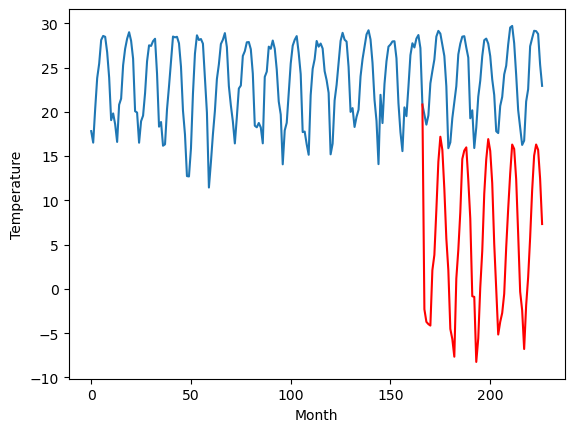

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.25		0.01
6.18		7.83		1.65
6.45		7.56		1.11
6.60		7.41		0.81
10.15		13.65		3.50
11.38		15.38		4.00
17.27		20.47		3.20
23.33		25.92		2.59
27.61		28.75		1.14
25.76		27.26		1.50
21.18		22.84		1.66
15.96		17.25		1.29
12.00		13.69		1.69
5.17		7.05		1.88
2.09		5.91		3.82
2.11		3.92		1.81
6.22		12.75		6.53
10.72		15.99		5.27
15.98		20.24		4.26
21.55		26.26		4.71
23.55		27.22		3.67
24.61		27.58		2.97
21.44		23.90		2.46
17.61		19.53		1.92
9.53		10.76		1.23
7.61		10.68		3.07
1.46		3.34		1.88
3.78		6.01		2.23
7.64		11.72		4.08
12.08		15.86		3.78
17.42		22.33		4.91
21.66		26.22		4.56
26.28		28.51		2.23
26.20		27.18		0.98
21.16		23.54		2.38
15.72		16.70		0.98
11.92		11.60		-0.32
5.75		6.45		0.70
7.04		7.89		0.85
5.16		8.91		3.75
7.60		11.07		3.47
13.32		16.30		2.98
16.95		20.67		3.72
20.74		24.64		3.90
26.31		27.93		1.62
24.30		27.42		3.12
21.88		24.00		2.12
16.86		17.80		0.94
8.88		11.29		2.41
8.1

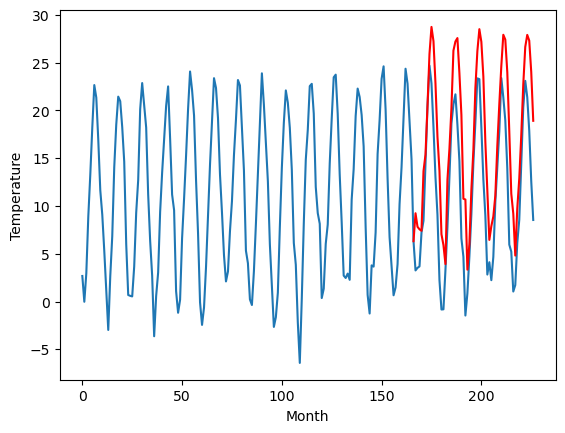

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-5.91		0.34
-5.90		-7.32		-1.42
-5.56		-7.59		-2.03
-4.92		-7.76		-2.84
1.77		-1.51		-3.28
1.24		0.21		-1.03
4.21		5.30		1.09
7.25		10.74		3.49
7.99		13.57		5.58
8.36		12.08		3.72
6.01		7.65		1.64
2.32		2.07		-0.25
-1.80		-1.49		0.31
-8.10		-8.13		-0.03
-7.75		-9.26		-1.51
-8.49		-11.26		-2.77
-1.16		-2.45		-1.29
-0.29		0.80		1.09
4.18		5.05		0.87
7.66		11.07		3.41
8.25		12.03		3.78
8.42		12.38		3.96
5.88		8.70		2.82
3.14		4.33		1.19
-5.13		-4.43		0.70
-1.72		-4.51		-2.79
-9.45		-11.86		-2.41
-6.31		-9.18		-2.87
-2.55		-3.47		-0.92
1.25		0.66		-0.59
6.41		7.14		0.73
9.00		11.02		2.02
8.83		13.31		4.48
8.01		11.98		3.97
6.04		8.35		2.31
-0.15		1.50		1.65
-3.22		-3.59		-0.37
-5.73		-8.75		-3.02
-4.56		-7.32		-2.76
-2.43		-6.30		-3.87
-0.60		-4.15		-3.55
1.32		1.09		-0.23
5.35		5.47		0.12
9.00		9.43		0.43
10.44		12.72		2.28
11.74		12.23		0.49
7.31		8.82		1.51
1.15		2.63		1.48
-3.96		-3.89

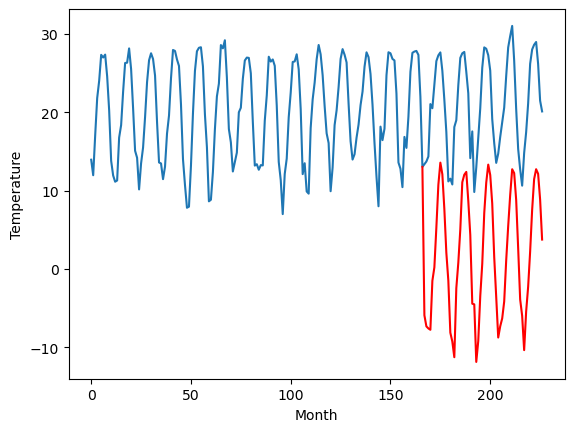

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		5.36		-1.91
5.84		3.94		-1.90
6.21		3.68		-2.53
5.45		3.51		-1.94
13.54		9.76		-3.78
13.51		11.47		-2.04
17.35		16.56		-0.79
20.96		22.00		1.04
22.66		24.82		2.16
22.96		23.34		0.38
18.56		18.91		0.35
14.09		13.33		-0.76
11.41		9.76		-1.65
5.30		3.12		-2.18
4.71		1.98		-2.73
2.36		-0.01		-2.37
10.74		8.80		-1.94
12.86		12.05		-0.81
16.90		16.30		-0.60
21.45		22.32		0.87
21.53		23.27		1.74
22.64		23.62		0.98
19.90		19.93		0.03
16.60		15.56		-1.04
8.96		6.80		-2.16
12.20		6.72		-5.48
3.77		-0.62		-4.39
3.39		2.05		-1.34
9.51		7.77		-1.74
15.66		11.89		-3.77
20.26		18.37		-1.89
23.98		22.25		-1.73
25.34		24.54		-0.80
22.62		23.21		0.59
19.96		19.56		-0.40
14.39		12.72		-1.67
8.51		7.63		-0.88
6.28		2.47		-3.81
7.04		3.90		-3.14
8.23		4.92		-3.31
12.03		7.08		-4.95
12.95		12.32		-0.63
18.03		16.70		-1.33
22.95		20.67		-2.28
25.11		23.95		-1.16
26.81		23.45		-3.36
22.33		20.04		-2.29
14.44		

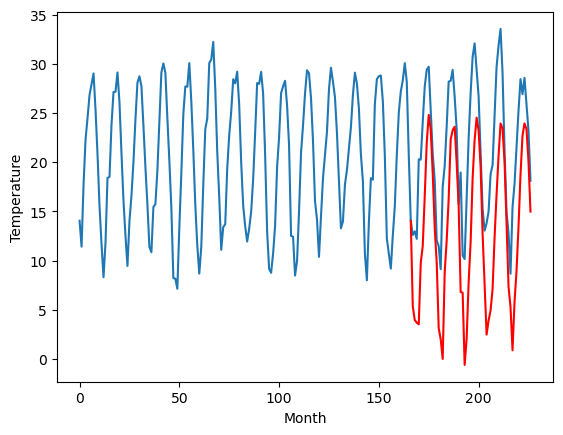

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		5.47		-1.18
4.84		4.05		-0.79
5.19		3.80		-1.39
4.63		3.63		-1.00
12.28		9.88		-2.40
12.59		11.60		-0.99
17.49		16.69		-0.80
22.23		22.13		-0.10
23.41		24.96		1.55
23.64		23.47		-0.17
17.70		19.04		1.34
12.22		13.47		1.25
9.73		9.90		0.17
3.27		3.26		-0.01
2.57		2.12		-0.45
-0.54		0.13		0.67
9.83		8.95		-0.88
11.53		12.18		0.65
15.61		16.43		0.82
21.17		22.45		1.28
22.06		23.40		1.34
22.62		23.75		1.13
20.35		20.06		-0.29
15.84		15.70		-0.14
7.87		6.93		-0.94
10.16		6.85		-3.31
1.68		-0.48		-2.16
1.51		2.19		0.68
8.09		7.91		-0.18
14.36		12.04		-2.32
19.38		18.52		-0.86
24.09		22.40		-1.69
26.88		24.69		-2.19
24.07		23.36		-0.71
20.24		19.72		-0.52
13.86		12.86		-1.00
7.19		7.77		0.58
4.57		2.61		-1.96
5.45		4.05		-1.40
5.64		5.07		-0.57
10.29		7.24		-3.05
12.11		12.48		0.37
17.85		16.86		-0.99
22.00		20.82		-1.18
24.56		24.10		-0.46
26.90		23.61		-3.29
22.12		20.19		-1.93
13.40		13.99	

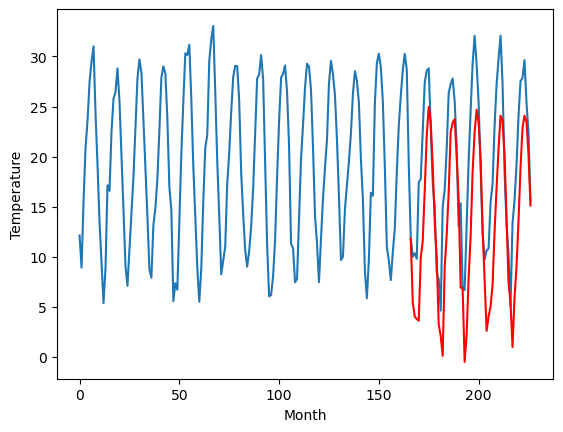

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		3.56		-2.47
1.50		2.15		0.65
2.75		1.91		-0.84
3.56		1.74		-1.82
8.06		8.00		-0.06
13.04		9.72		-3.32
19.33		14.81		-4.52
22.85		20.25		-2.60
24.95		23.06		-1.89
25.39		21.58		-3.81
19.14		17.16		-1.98
13.54		11.58		-1.96
7.98		8.01		0.03
0.33		1.37		1.04
0.87		0.23		-0.64
3.79		-1.76		-5.55
6.89		7.04		0.15
13.55		10.28		-3.27
18.56		14.53		-4.03
23.55		20.56		-2.99
22.35		21.51		-0.84
21.83		21.85		0.02
19.65		18.16		-1.49
13.09		13.80		0.71
7.69		5.04		-2.65
4.34		4.95		0.61
1.34		-2.38		-3.72
2.31		0.28		-2.03
7.37		6.00		-1.37
14.56		10.12		-4.44
19.26		16.61		-2.65
23.12		20.49		-2.63
24.26		22.78		-1.48
21.24		21.45		0.21
19.51		17.81		-1.70
11.30		10.96		-0.34
4.41		5.88		1.47
2.24		0.72		-1.52
1.53		2.16		0.63
2.74		3.19		0.45
7.44		5.35		-2.09
13.08		10.59		-2.49
17.73		14.98		-2.75
22.39		18.95		-3.44
27.14		22.23		-4.91
24.14		21.74		-2.40
21.48		18.32		-3.16
14.74		12.12		-

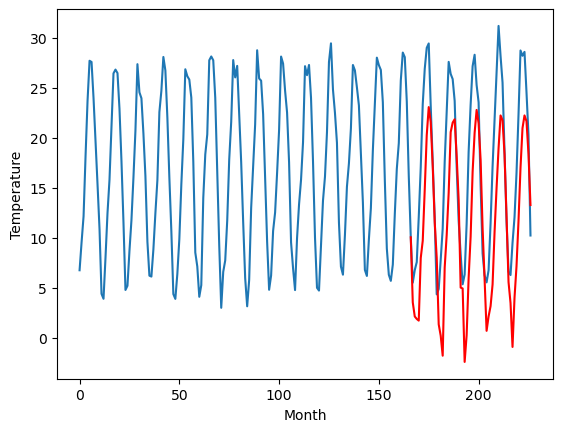

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-1.80		-3.97
-1.37		-3.20		-1.83
-0.83		-3.46		-2.63
1.28		-3.62		-4.90
1.35		2.64		1.29
4.56		4.35		-0.21
8.61		9.46		0.85
9.90		14.89		4.99
12.31		17.70		5.39
14.71		16.22		1.51
13.11		11.81		-1.30
9.87		6.24		-3.63
3.15		2.66		-0.49
1.10		-3.99		-5.09
1.04		-5.13		-6.17
0.12		-7.12		-7.24
-0.28		1.68		1.96
3.58		4.91		1.33
5.80		9.16		3.36
10.04		15.20		5.16
13.02		16.15		3.13
12.62		16.49		3.87
10.84		12.81		1.97
5.86		8.45		2.59
4.60		-0.32		-4.92
-1.91		-0.40		1.51
0.50		-7.73		-8.23
1.37		-5.07		-6.44
3.16		0.67		-2.49
5.28		4.79		-0.49
6.24		11.28		5.04
11.16		15.16		4.00
11.97		17.46		5.49
14.01		16.11		2.10
13.60		12.46		-1.14
7.33		5.62		-1.71
1.10		0.53		-0.57
-1.60		-4.62		-3.02
-1.94		-3.19		-1.25
-2.26		-2.16		0.10
-1.25		0.01		1.26
2.59		5.25		2.66
3.80		9.64		5.84
5.76		13.62		7.86
12.68		16.90		4.22
12.31		16.41		4.10
8.81		12.99		4.18
7.22		6.78		-0.44
2.83		0.26		-2.

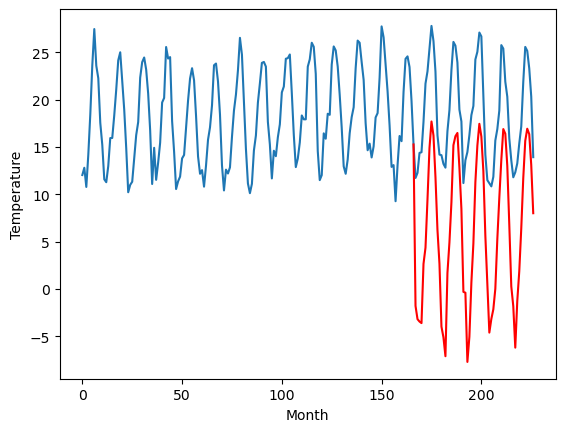

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.46		1.42
1.63		2.05		0.42
1.34		1.80		0.46
2.38		1.63		-0.75
7.61		7.88		0.27
8.91		9.59		0.68
11.51		14.69		3.18
16.80		20.13		3.33
19.79		22.95		3.16
18.79		21.47		2.68
14.76		17.05		2.29
10.84		11.48		0.64
6.23		7.91		1.68
-0.77		1.27		2.04
-1.18		0.13		1.31
-0.68		-1.86		-1.18
6.20		6.95		0.75
8.99		10.19		1.20
13.01		14.44		1.43
17.30		20.48		3.18
18.87		21.43		2.56
18.96		21.79		2.83
14.85		18.11		3.26
11.57		13.75		2.18
2.66		4.98		2.32
4.58		4.91		0.33
-1.90		-2.42		-0.52
2.12		0.25		-1.87
6.23		5.99		-0.24
9.52		10.11		0.59
14.37		16.60		2.23
18.13		20.48		2.35
19.57		22.78		3.21
18.19		21.45		3.26
14.88		17.80		2.92
7.57		10.96		3.39
5.45		5.86		0.41
-1.08		0.70		1.78
2.12		2.14		0.02
5.14		3.16		-1.98
5.59		5.32		-0.27
9.11		10.57		1.46
11.89		14.95		3.06
15.55		18.93		3.38
19.14		22.21		3.07
18.59		21.71		3.12
14.63		18.30		3.67
9.34		12.10		2.76
3.44		5.57		2.13
0.97		3.

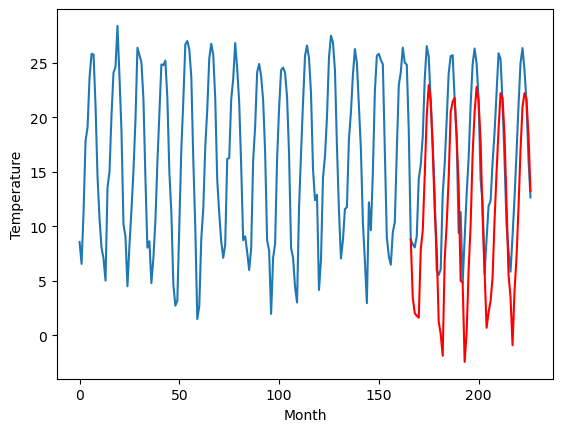

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		-0.00		1.92
-1.32		-1.42		-0.10
-1.76		-1.67		0.09
-1.96		-1.83		0.13
4.08		4.41		0.33
4.51		6.12		1.61
8.55		11.22		2.67
13.92		16.65		2.73
17.21		19.48		2.27
15.95		18.00		2.05
12.00		13.58		1.58
7.34		8.01		0.67
2.29		4.44		2.15
-4.77		-2.20		2.57
-4.44		-3.34		1.10
-3.09		-5.33		-2.24
3.12		3.48		0.36
5.09		6.72		1.63
10.00		10.97		0.97
15.41		17.00		1.59
16.72		17.96		1.24
16.80		18.30		1.50
12.31		14.63		2.32
8.55		10.27		1.72
-1.67		1.50		3.17
0.43		1.42		0.99
-6.44		-5.91		0.53
-1.85		-3.24		-1.39
2.70		2.49		-0.21
5.86		6.62		0.76
12.10		13.11		1.01
15.75		16.99		1.24
17.10		19.29		2.19
15.85		17.96		2.11
11.70		14.31		2.61
4.42		7.47		3.05
1.97		2.37		0.40
-3.49		-2.79		0.70
-1.57		-1.35		0.22
1.22		-0.34		-1.56
1.75		1.83		0.08
6.64		7.07		0.43
9.99		11.45		1.46
12.90		15.42		2.52
16.45		18.70		2.25
15.74		18.20		2.46
12.96		14.79		1.83
6.91		8.59		1.68
0.70		2.07		1.37
-2.

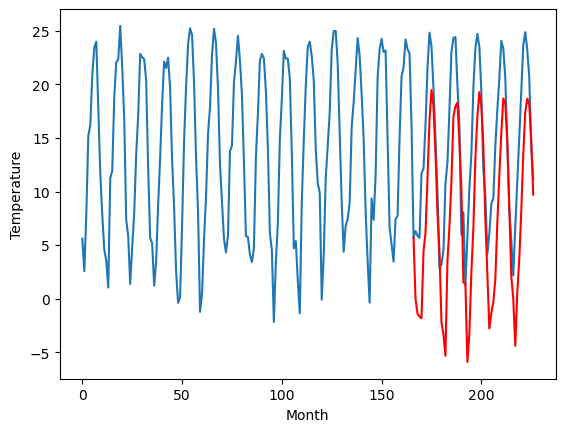

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65  -0.005298
1                 1    3.41   0.039461
2                 2   -0.10  -2.298146
3                 3    9.24   9.245170
4                 4   -6.25  -5.907146
5                 5    7.27   5.357459
6                 6    6.65   5.465916
7                 7    6.03   3.561627
8                 8    2.17  -1.802592
9                 9    2.04   3.463544
10               10   -1.92  -0.000191


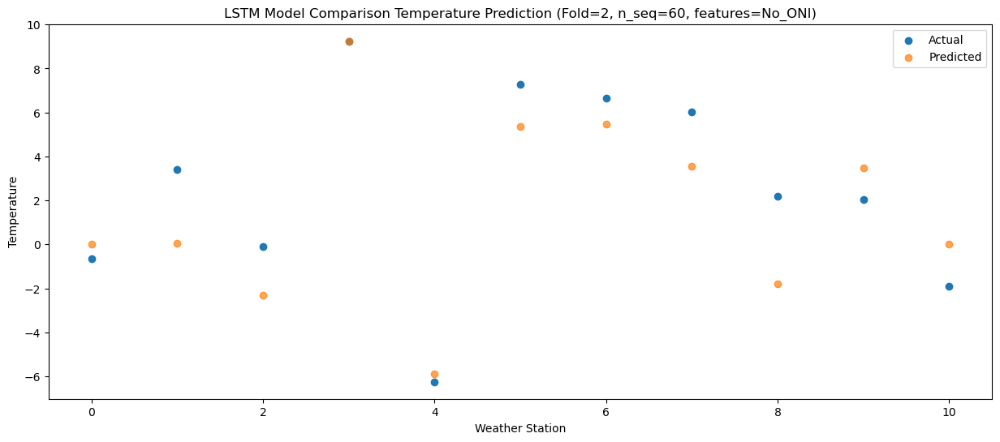

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -1.428798
1                 1    1.13  -1.380829
2                 2   -1.22  -3.718745
3                 3    6.18   7.826621
4                 4   -5.90  -7.324036
5                 5    5.84   3.940213
6                 6    4.84   4.051138
7                 7    1.50   2.154592
8                 8   -1.37  -3.204176
9                 9    1.63   2.048995
10               10   -1.32  -1.421312


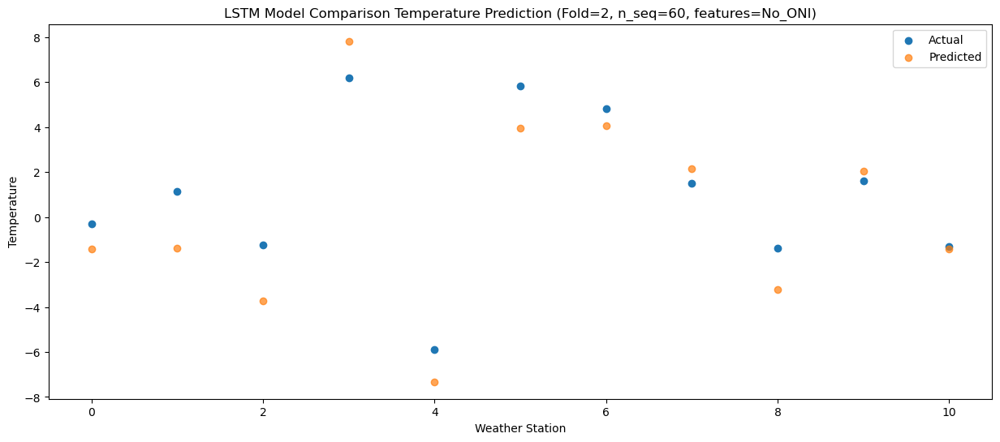

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -1.672234
1                 1    0.89  -1.625323
2                 2   -2.37  -3.975958
3                 3    6.45   7.563881
4                 4   -5.56  -7.588453
5                 5    6.21   3.679719
6                 6    5.19   3.799570
7                 7    2.75   1.906694
8                 8   -0.83  -3.458056
9                 9    1.34   1.796362
10               10   -1.76  -1.671941


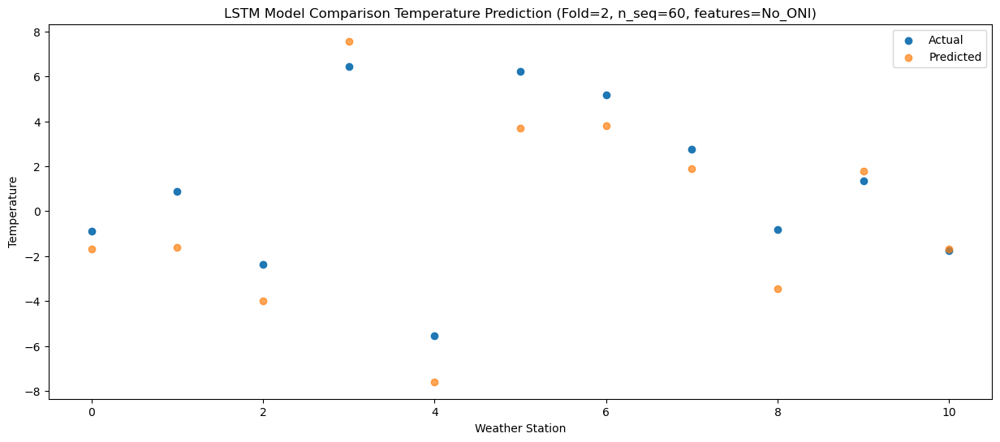

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -1.830555
1                 1    0.16  -1.783260
2                 2   -1.33  -4.140477
3                 3    6.60   7.406180
4                 4   -4.92  -7.758593
5                 5    5.45   3.510064
6                 6    4.63   3.631630
7                 7    3.56   1.740793
8                 8    1.28  -3.620883
9                 9    2.38   1.631613
10               10   -1.96  -1.833419


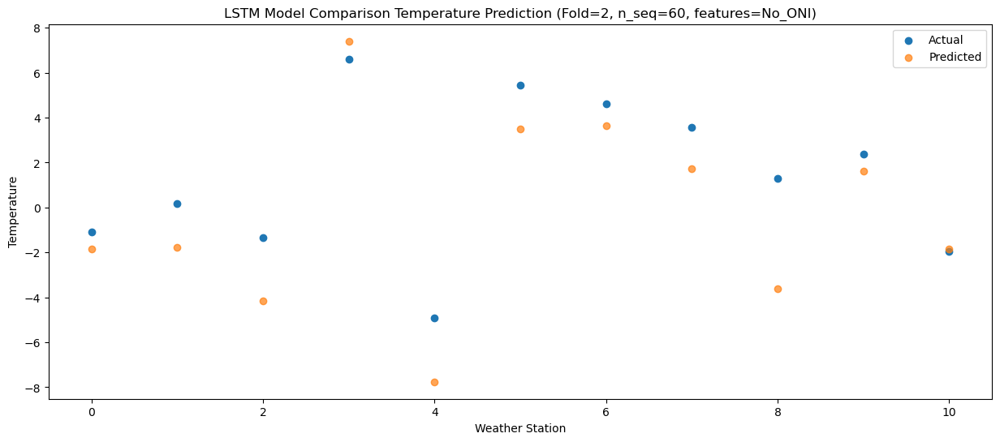

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   4.417576
1                 1    8.17   4.472743
2                 2    2.29   2.110746
3                 3   10.15  13.653879
4                 4    1.77  -1.512365
5                 5   13.54   9.756819
6                 6   12.28   9.881307
7                 7    8.06   7.999417
8                 8    1.35   2.639831
9                 9    7.61   7.879810
10               10    4.08   4.410802


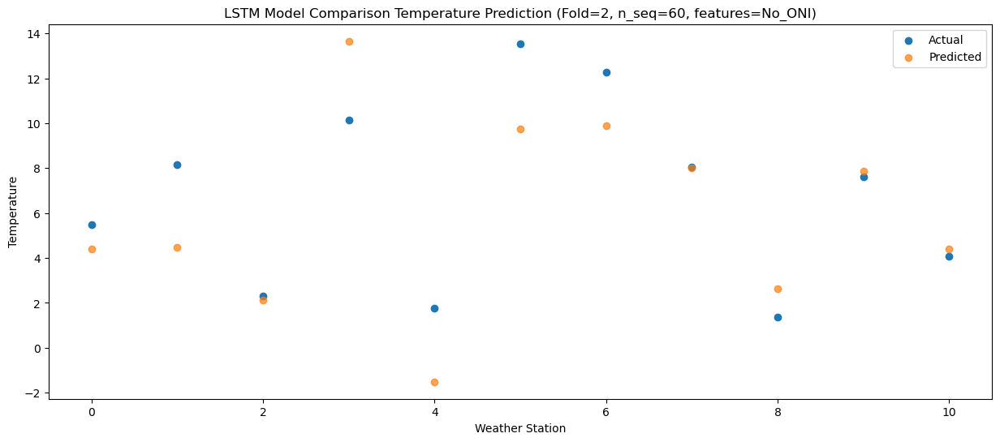

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   6.148894
1                 1   10.40   6.206587
2                 2    3.68   3.840057
3                 3   11.38  15.380164
4                 4    1.24   0.207804
5                 5   13.51  11.473413
6                 6   12.59  11.600381
7                 7   13.04   9.716384
8                 8    4.56   4.354678
9                 9    8.91   9.592390
10               10    4.51   6.124979


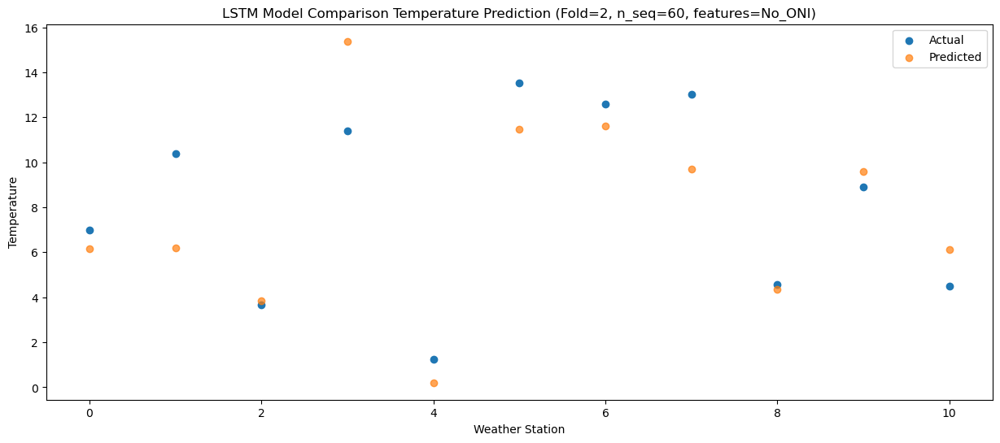

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  11.247970
1                 1   17.20  11.303923
2                 2    4.99   8.930853
3                 3   17.27  20.471196
4                 4    4.21   5.299652
5                 5   17.35  16.563662
6                 6   17.49  16.689262
7                 7   19.33  14.809143
8                 8    8.61   9.459705
9                 9   11.51  14.688353
10               10    8.55  11.216382


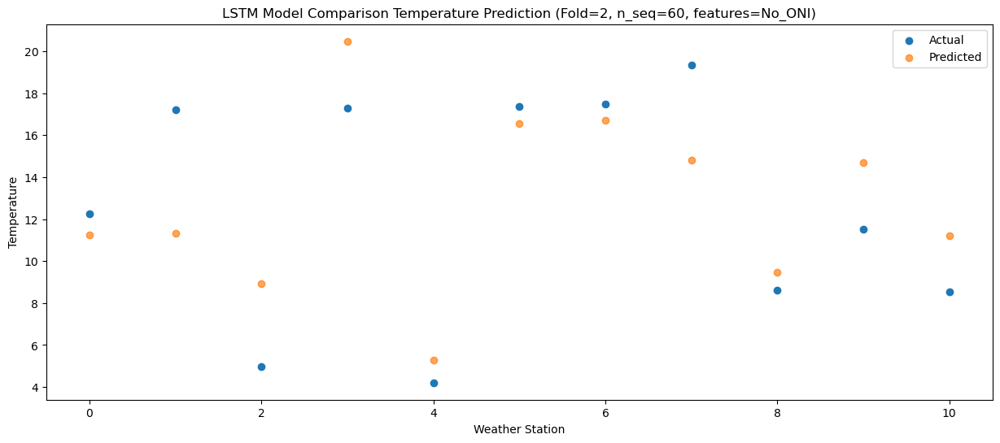

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  16.697898
1                 1   24.40  16.749879
2                 2    7.58  14.364991
3                 3   23.33  25.916564
4                 4    7.25  10.742082
5                 5   20.96  21.998127
6                 6   22.23  22.132130
7                 7   22.85  20.250266
8                 8    9.90  14.892549
9                 9   16.80  20.129807
10               10   13.92  16.654536


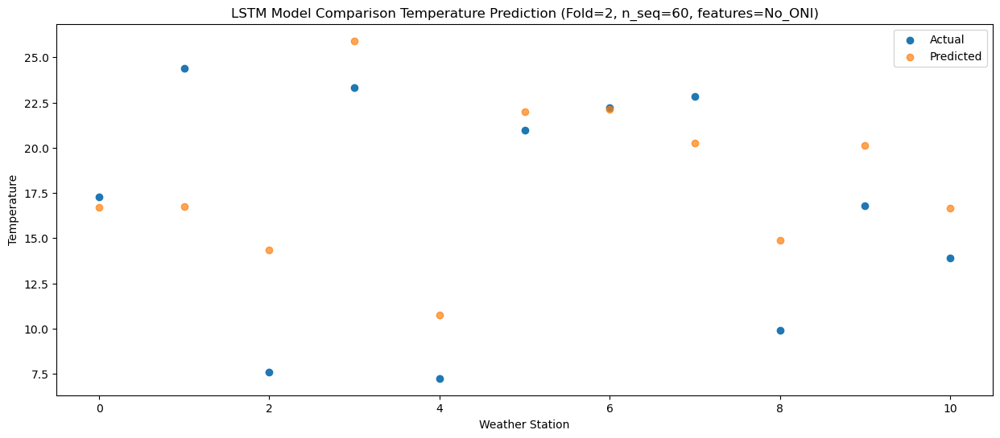

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  19.526909
1                 1   24.43  19.571442
2                 2    8.22  17.184939
3                 3   27.61  28.745114
4                 4    7.99  13.565968
5                 5   22.66  24.821978
6                 6   23.41  24.955614
7                 7   24.95  23.063321
8                 8   12.31  17.702661
9                 9   19.79  22.946624
10               10   17.21  19.476853


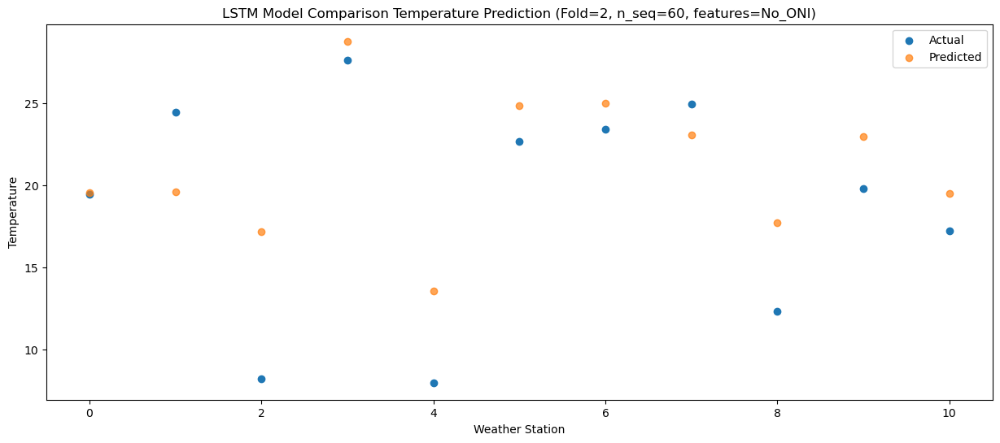

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  18.046489
1                 1   23.10  18.081539
2                 2    7.91  15.700696
3                 3   25.76  27.257279
4                 4    8.36  12.081686
5                 5   22.96  23.335849
6                 6   23.64  23.468352
7                 7   25.39  21.582382
8                 8   14.71  16.222488
9                 9   18.79  21.468297
10               10   15.95  17.998263


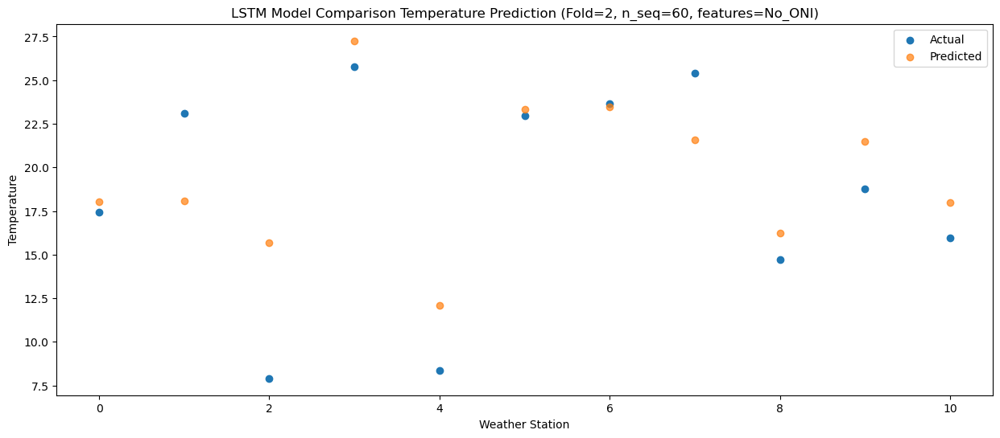

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  13.614440
1                 1   16.97  13.659429
2                 2    6.65  11.275495
3                 3   21.18  22.835911
4                 4    6.01   7.652664
5                 5   18.56  18.908590
6                 6   17.70  19.042791
7                 7   19.14  17.164943
8                 8   13.11  11.810768
9                 9   14.76  17.051714
10               10   12.00  13.577954


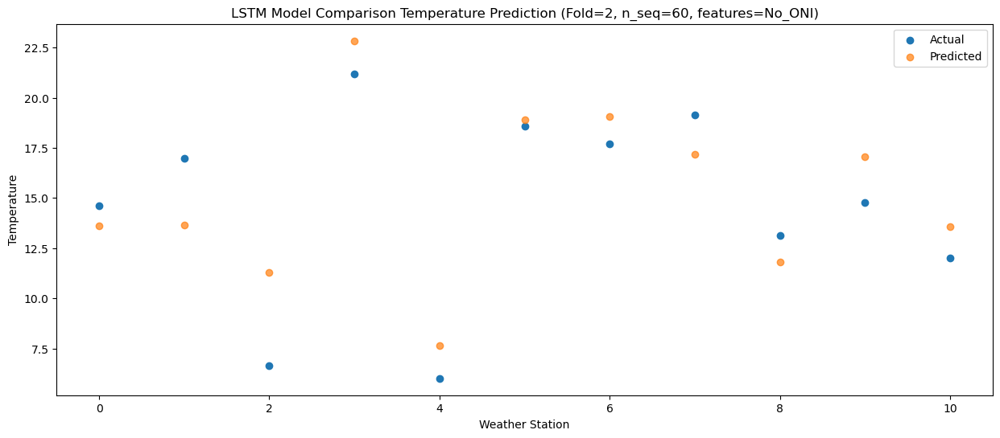

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   8.025137
1                 1    9.98   8.065403
2                 2    5.38   5.683002
3                 3   15.96  17.252364
4                 4    2.32   2.070439
5                 5   14.09  13.331304
6                 6   12.22  13.466912
7                 7   13.54  11.584280
8                 8    9.87   6.236094
9                 9   10.84  11.482022
10               10    7.34   8.007937


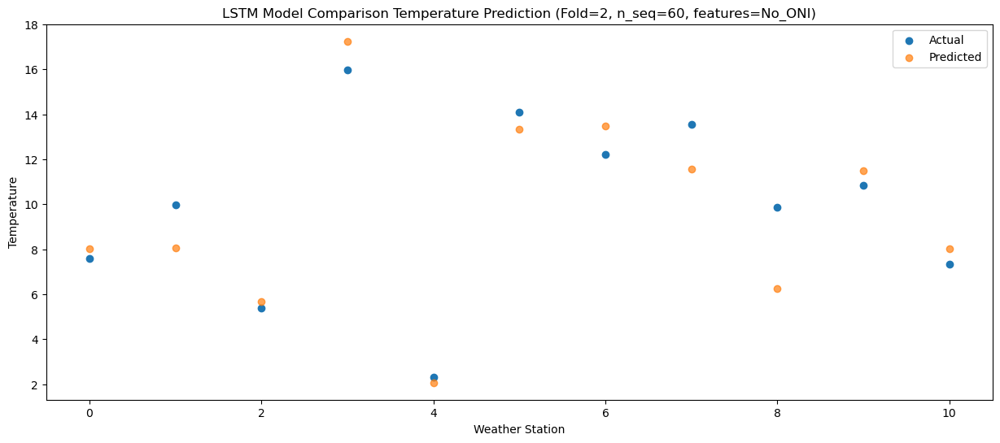

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   4.468354
1                 1    6.86   4.509600
2                 2    1.96   2.118233
3                 3   12.00  13.688117
4                 4   -1.80  -1.494293
5                 5   11.41   9.759853
6                 6    9.73   9.896577
7                 7    7.98   8.014771
8                 8    3.15   2.655474
9                 9    6.23   7.908471
10               10    2.29   4.439926


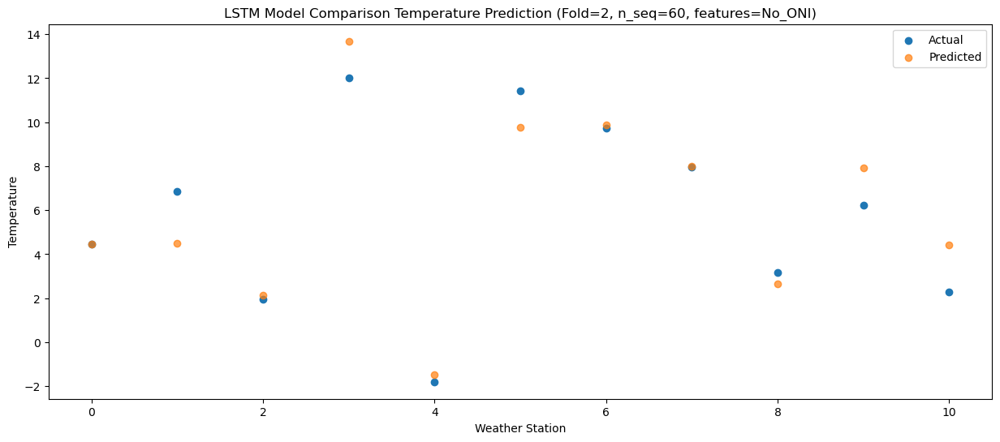

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -2.172517
1                 1    0.23  -2.135819
2                 2   -5.03  -4.521374
3                 3    5.17   7.050292
4                 4   -8.10  -8.126310
5                 5    5.30   3.119170
6                 6    3.27   3.262597
7                 7    0.33   1.368907
8                 8    1.10  -3.994761
9                 9   -0.77   1.266850
10               10   -4.77  -2.199954


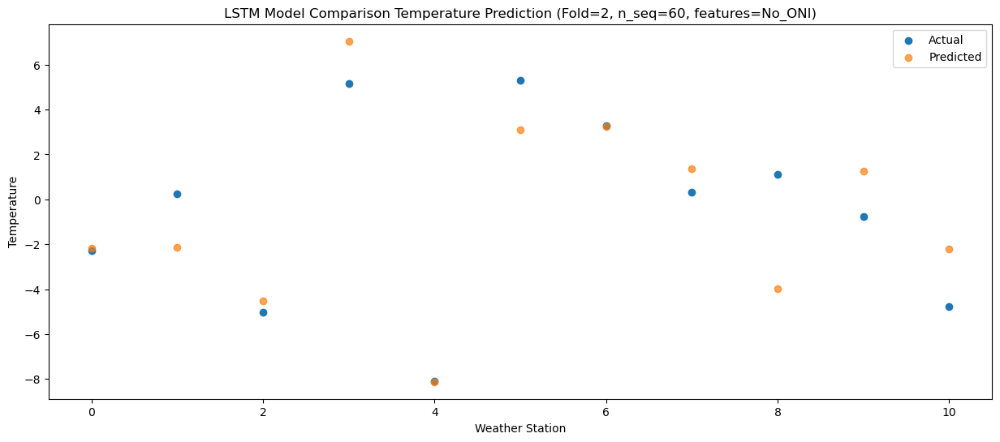

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -3.315760
1                 1    0.15  -3.274558
2                 2   -4.37  -5.660773
3                 3    2.09   5.913577
4                 4   -7.75  -9.263400
5                 5    4.71   1.982896
6                 6    2.57   2.123798
7                 7    0.87   0.234852
8                 8    1.04  -5.133346
9                 9   -1.18   0.133924
10               10   -4.44  -3.335538


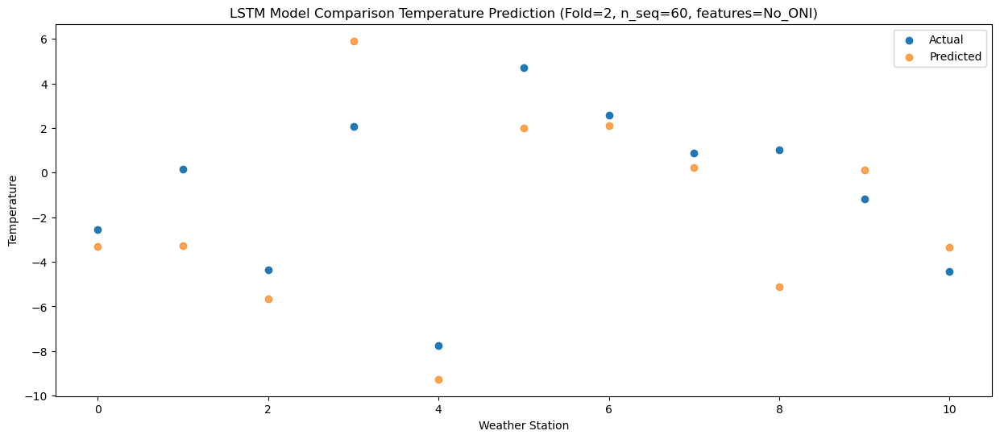

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -5.304096
1                 1   -3.89  -5.265555
2                 2   -1.64  -7.655566
3                 3    2.11   3.924734
4                 4   -8.49 -11.259522
5                 5    2.36  -0.011622
6                 6   -0.54   0.130146
7                 7    3.79  -1.763512
8                 8    0.12  -7.123035
9                 9   -0.68  -1.861184
10               10   -3.09  -5.332343


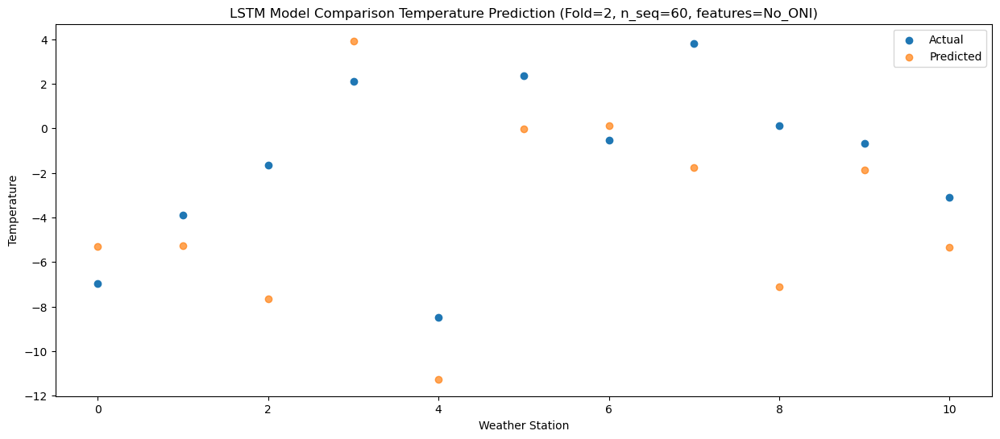

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   3.525137
1                 1    6.30   3.558514
2                 2    0.17   1.164029
3                 3    6.22  12.752124
4                 4   -1.16  -2.448241
5                 5   10.74   8.802539
6                 6    9.83   8.945189
7                 7    6.89   7.042967
8                 8   -0.28   1.681301
9                 9    6.20   6.946954
10               10    3.12   3.475379


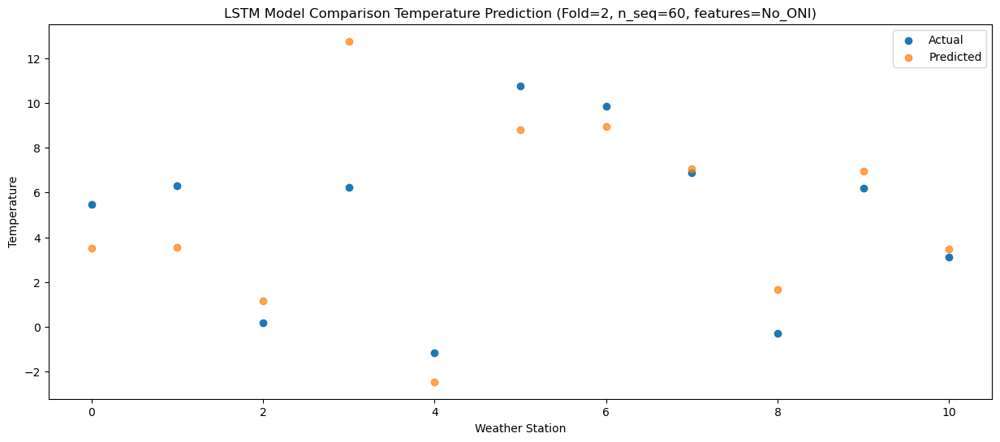

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   6.759840
1                 1   10.06   6.790427
2                 2    1.98   4.404943
3                 3   10.72  15.989363
4                 4   -0.29   0.796813
5                 5   12.86  12.045687
6                 6   11.53  12.183685
7                 7   13.55  10.280313
8                 8    3.58   4.912725
9                 9    8.99  10.188915
10               10    5.09   6.718898


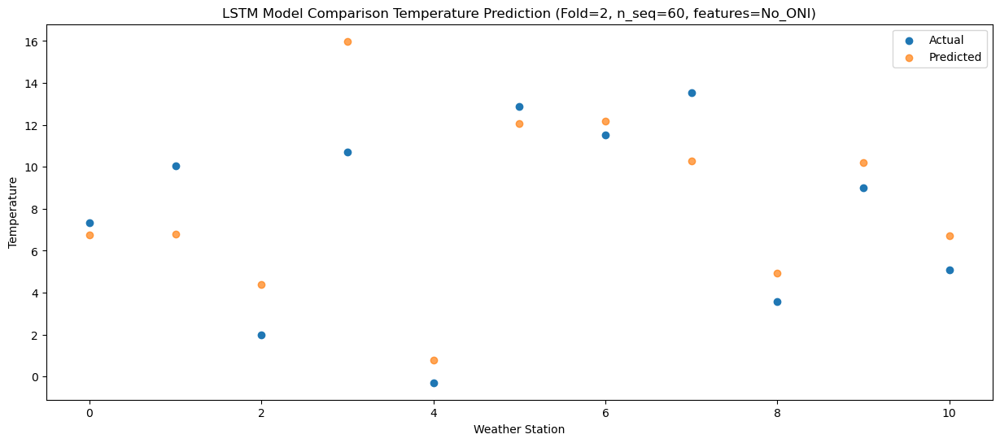

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  11.003120
1                 1   15.24  11.034847
2                 2    5.56   8.658926
3                 3   15.98  20.237573
4                 4    4.18   5.048936
5                 5   16.90  16.296394
6                 6   15.61  16.434578
7                 7   18.56  14.530046
8                 8    5.80   9.161635
9                 9   13.01  14.443012
10               10   10.00  10.968626


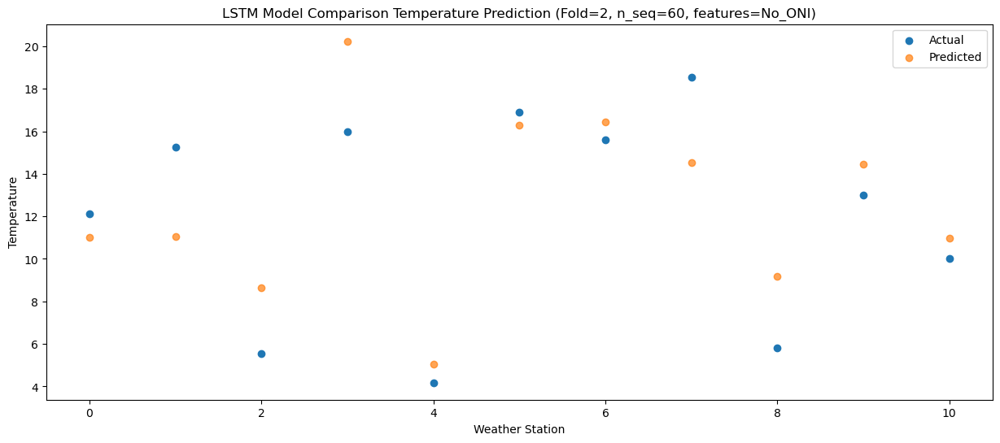

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  17.015003
1                 1   22.49  17.051969
2                 2    6.78  14.676313
3                 3   21.55  26.264424
4                 4    7.66  11.069737
5                 5   21.45  22.317880
6                 6   21.17  22.453916
7                 7   23.55  20.563049
8                 8   10.04  15.199552
9                 9   17.30  20.477194
10               10   15.41  16.997694


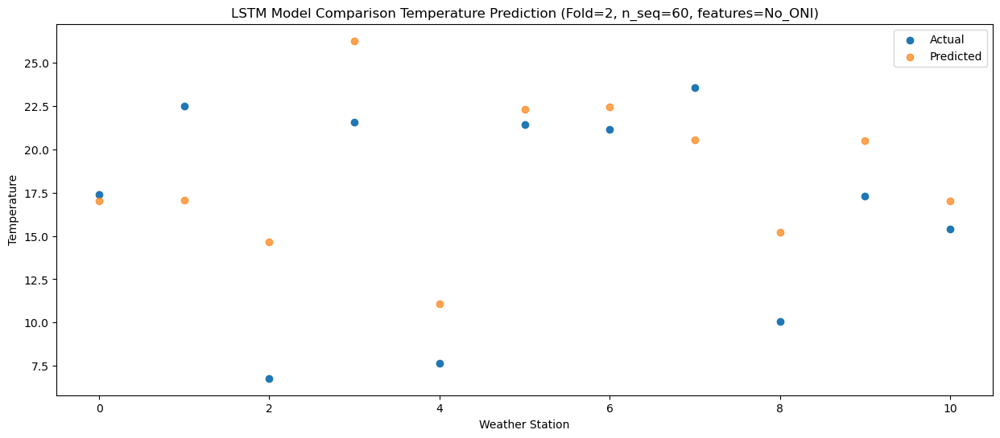

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  17.980145
1                 1   23.18  18.014947
2                 2    7.57  15.628118
3                 3   23.55  27.220809
4                 4    8.25  12.028844
5                 5   21.53  23.267397
6                 6   22.06  23.402984
7                 7   22.35  21.513460
8                 8   13.02  16.145196
9                 9   18.87  21.434456
10               10   16.72  17.955103


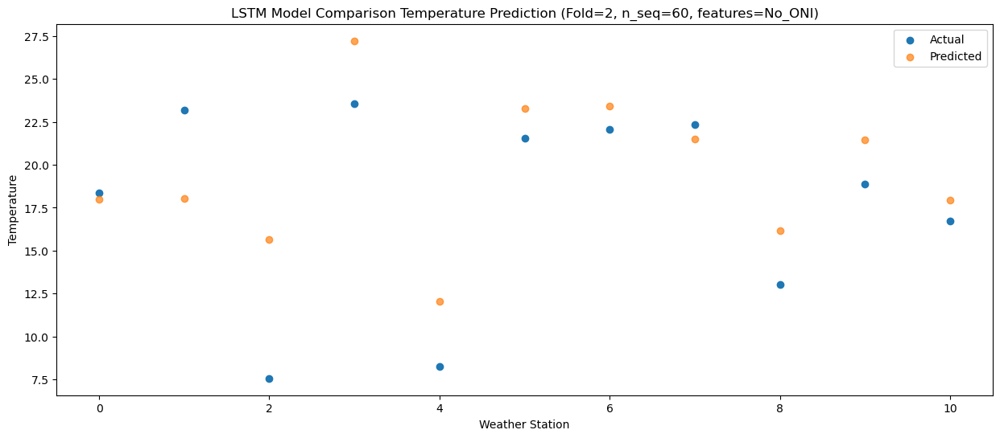

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  18.329542
1                 1   23.94  18.362832
2                 2    7.62  15.984251
3                 3   24.61  27.578142
4                 4    8.42  12.384162
5                 5   22.64  23.617058
6                 6   22.62  23.746211
7                 7   21.83  21.847676
8                 8   12.62  16.488510
9                 9   18.96  21.785777
10               10   16.80  18.304945


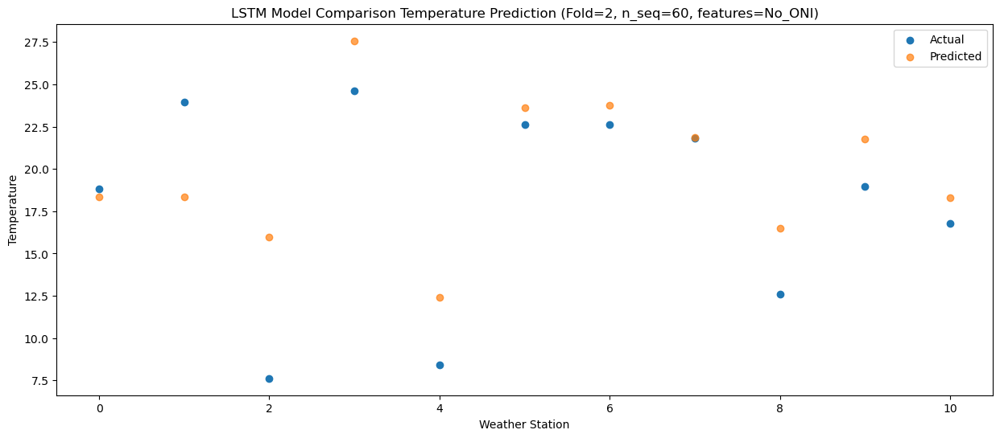

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  14.642961
1                 1   21.70  14.674681
2                 2    6.34  12.303049
3                 3   21.44  23.896343
4                 4    5.88   8.699445
5                 5   19.90  19.931591
6                 6   20.35  20.063930
7                 7   19.65  18.163123
8                 8   10.84  12.809236
9                 9   14.85  18.108327
10               10   12.31  14.632011


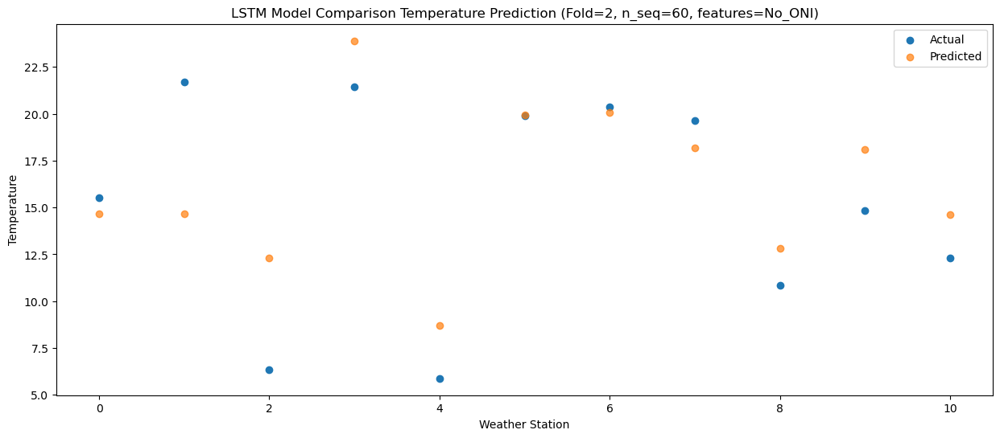

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  10.274611
1                 1   13.44  10.300796
2                 2    5.20   7.932568
3                 3   17.61  19.528416
4                 4    3.14   4.331655
5                 5   16.60  15.564114
6                 6   15.84  15.696878
7                 7   13.09  13.800074
8                 8    5.86   8.447678
9                 9   11.57  13.745632
10               10    8.55  10.269817


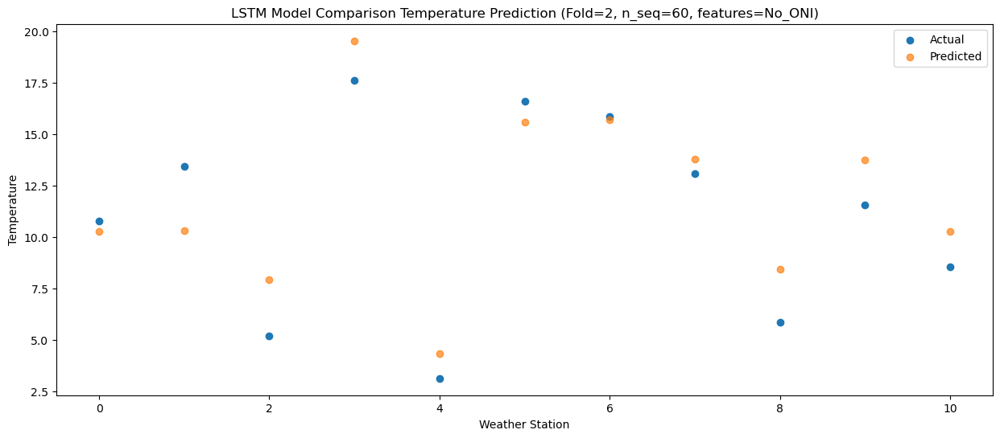

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   1.504030
1                 1    6.73   1.531562
2                 2   -1.65  -0.825074
3                 3    9.53  10.763147
4                 4   -5.13  -4.431085
5                 5    8.96   6.803820
6                 6    7.87   6.929954
7                 7    7.69   5.038817
8                 8    4.60  -0.317148
9                 9    2.66   4.982033
10               10   -1.67   1.502139


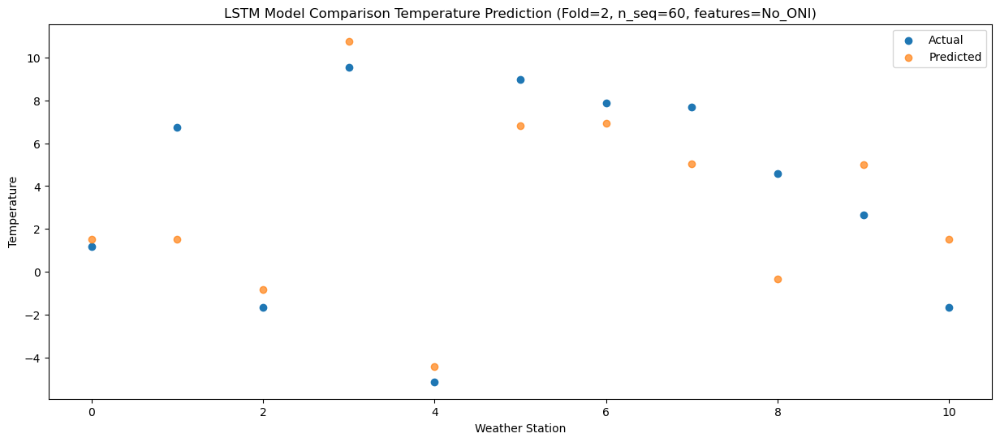

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   1.425075
1                 1    4.34   1.450580
2                 2   -0.75  -0.901321
3                 3    7.61  10.681281
4                 4   -1.72  -4.514332
5                 5   12.20   6.717772
6                 6   10.16   6.851528
7                 7    4.34   4.951973
8                 8   -1.91  -0.404657
9                 9    4.58   4.905375
10               10    0.43   1.424937


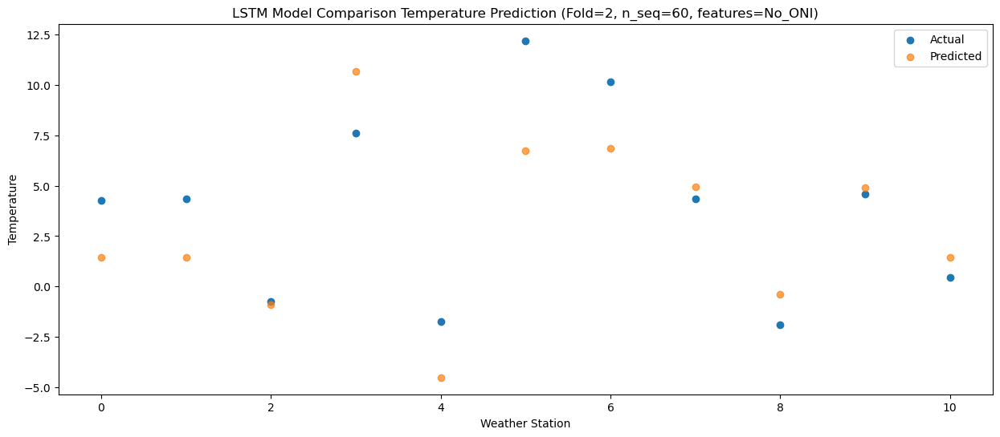

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -5.926101
1                 1   -0.35  -5.889298
2                 2   -5.01  -8.245018
3                 3    1.46   3.340635
4                 4   -9.45 -11.859586
5                 5    3.77  -0.622891
6                 6    1.68  -0.482225
7                 7    1.34  -2.384601
8                 8    0.50  -7.726577
9                 9   -1.90  -2.423058
10               10   -6.44  -5.909243


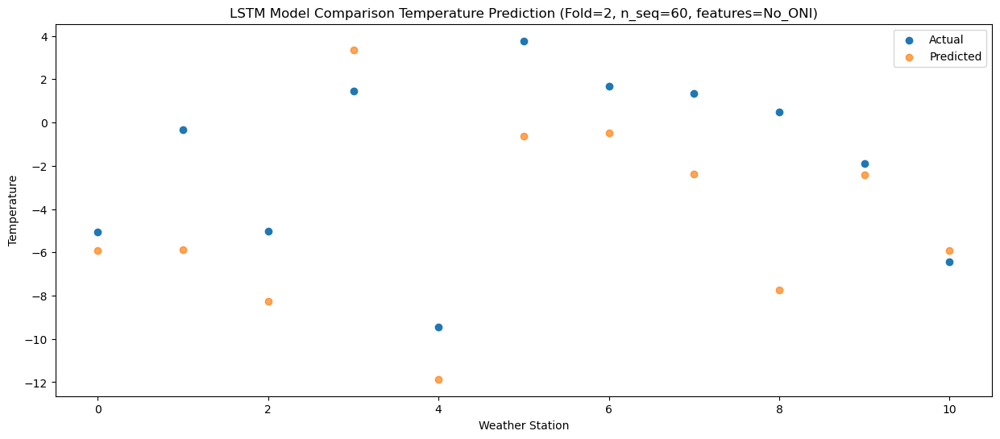

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -3.249511
1                 1   -0.36  -3.219047
2                 2   -2.68  -5.576374
3                 3    3.78   6.008641
4                 4   -6.31  -9.182870
5                 5    3.39   2.047242
6                 6    1.51   2.186645
7                 7    2.31   0.278447
8                 8    1.37  -5.068136
9                 9    2.12   0.249184
10               10   -1.85  -3.235605


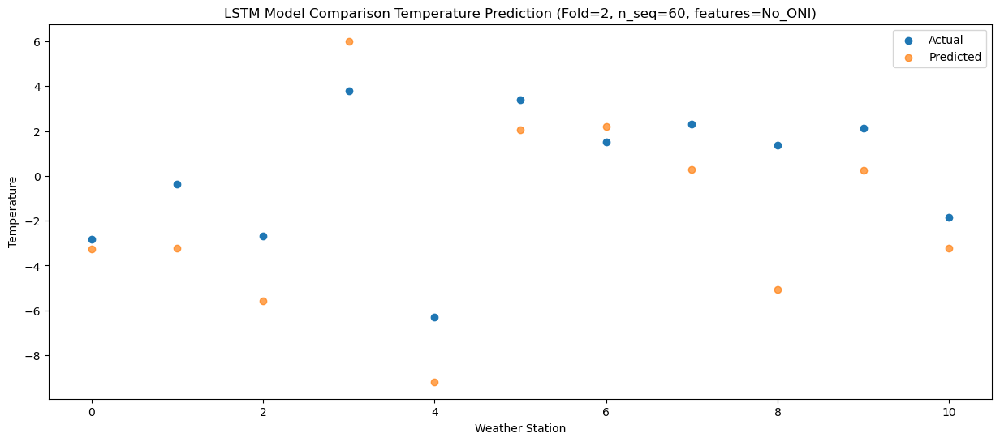

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   2.465954
1                 1    6.62   2.494466
2                 2    0.79   0.143122
3                 3    7.64  11.722390
4                 4   -2.55  -3.465436
5                 5    9.51   7.769356
6                 6    8.09   7.913009
7                 7    7.37   6.000545
8                 8    3.16   0.666807
9                 9    6.23   5.987394
10               10    2.70   2.494913


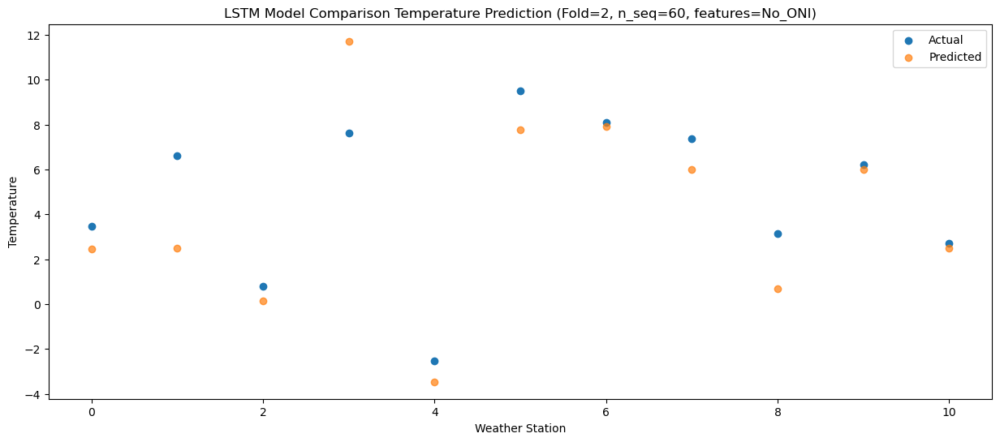

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51   6.606262
1                 1   13.30   6.636317
2                 2    2.60   4.271806
3                 3   12.08  15.858209
4                 4    1.25   0.659830
5                 5   15.66  11.891728
6                 6   14.36  12.041383
7                 7   14.56  10.124342
8                 8    5.28   4.791806
9                 9    9.52  10.114428
10               10    5.86   6.624298


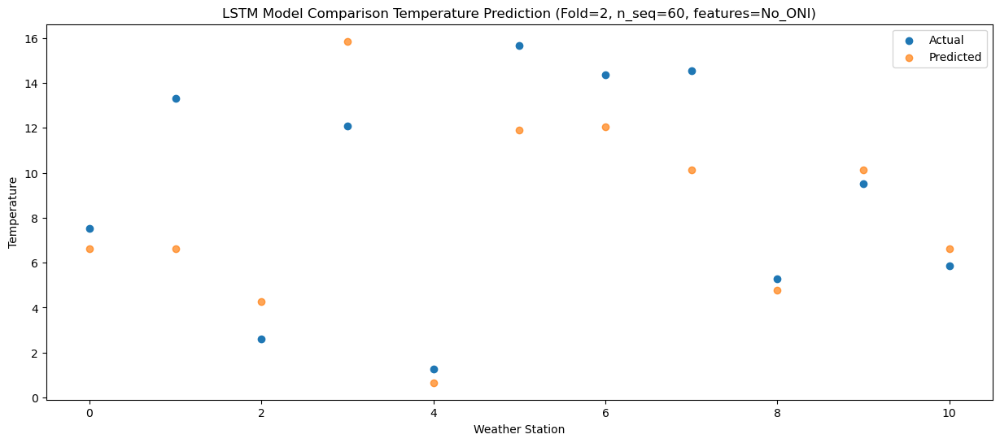

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  13.077844
1                 1   19.10  13.106223
2                 2    5.36  10.743745
3                 3   17.42  22.328932
4                 4    6.41   7.139006
5                 5   20.26  18.373698
6                 6   19.38  18.524607
7                 7   19.26  16.611549
8                 8    6.24  11.279337
9                 9   14.37  16.602567
10               10   12.10  13.108646


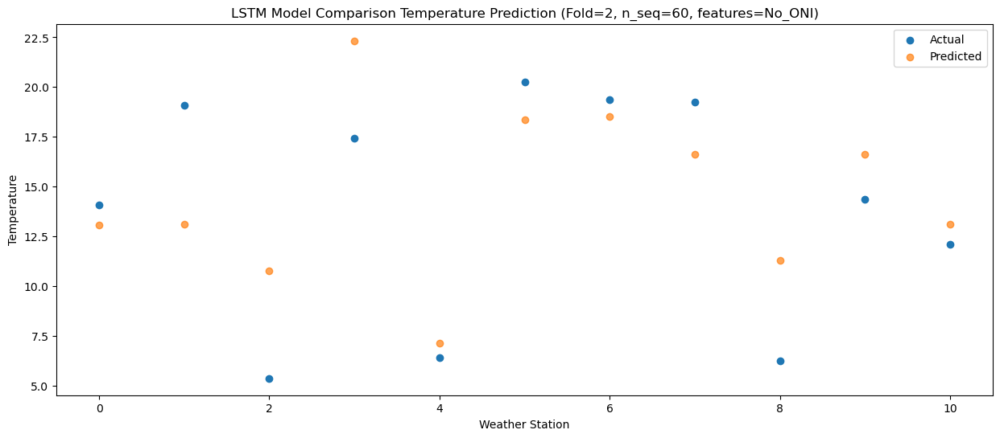

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  16.969934
1                 1   22.90  16.995468
2                 2    7.17  14.629115
3                 3   21.66  26.216120
4                 4    9.00  11.021491
5                 5   23.98  22.252380
6                 6   24.09  22.402548
7                 7   23.12  20.489470
8                 8   11.16  15.155423
9                 9   18.13  20.484301
10               10   15.75  16.990036


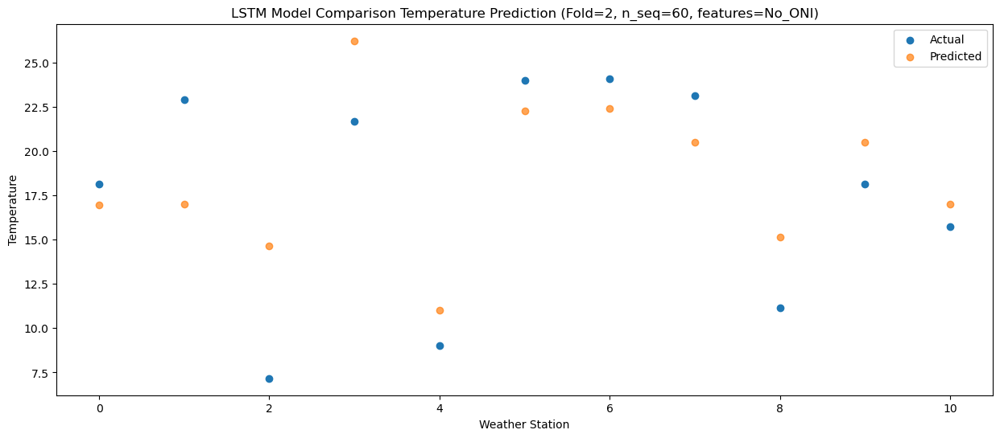

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  19.265837
1                 1   26.14  19.293903
2                 2    7.35  16.917992
3                 3   26.28  28.510701
4                 4    8.83  13.312950
5                 5   25.34  24.541422
6                 6   26.88  24.690457
7                 7   24.26  22.780458
8                 8   11.97  17.455967
9                 9   19.57  22.783122
10               10   17.10  19.287009


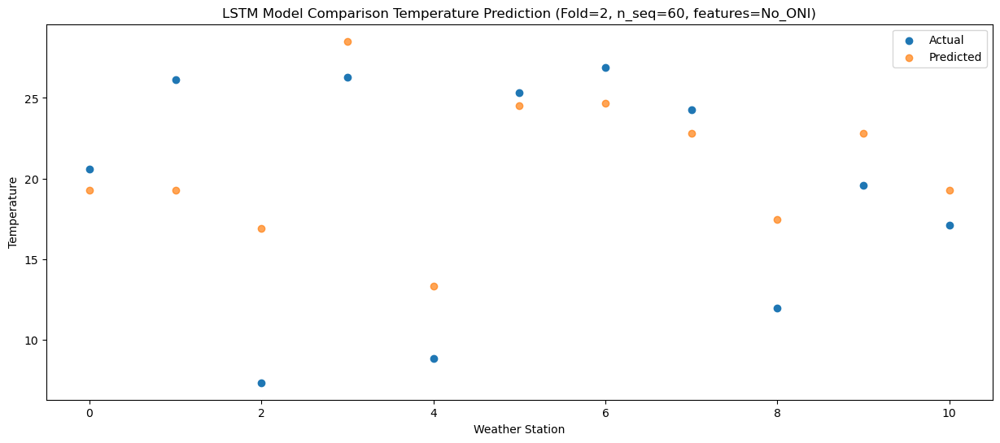

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  17.941371
1                 1   23.83  17.965626
2                 2    6.78  15.581228
3                 3   26.20  27.183674
4                 4    8.01  11.982522
5                 5   22.62  23.206945
6                 6   24.07  23.358697
7                 7   21.24  21.453028
8                 8   14.01  16.113408
9                 9   18.19  21.445178
10               10   15.85  17.955363


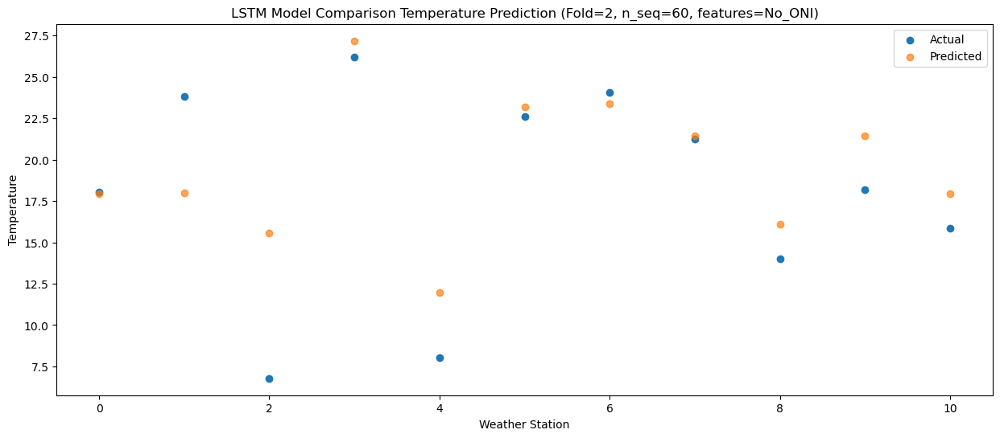

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  14.304407
1                 1   21.07  14.331903
2                 2    5.37  11.941950
3                 3   21.16  23.544031
4                 4    6.04   8.348179
5                 5   19.96  19.564102
6                 6   20.24  19.718290
7                 7   19.51  17.809494
8                 8   13.60  12.464325
9                 9   14.88  17.803034
10               10   11.70  14.310100


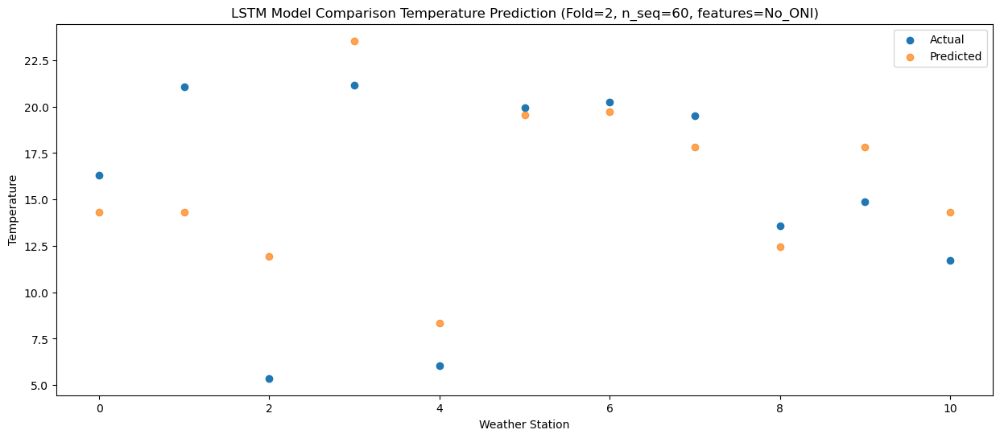

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97   7.463179
1                 1   12.69   7.475206
2                 2    2.74   5.086342
3                 3   15.72  16.696244
4                 4   -0.15   1.497933
5                 5   14.39  12.715437
6                 6   13.86  12.862821
7                 7   11.30  10.961685
8                 8    7.33   5.617447
9                 9    7.57  10.959000
10               10    4.42   7.466752


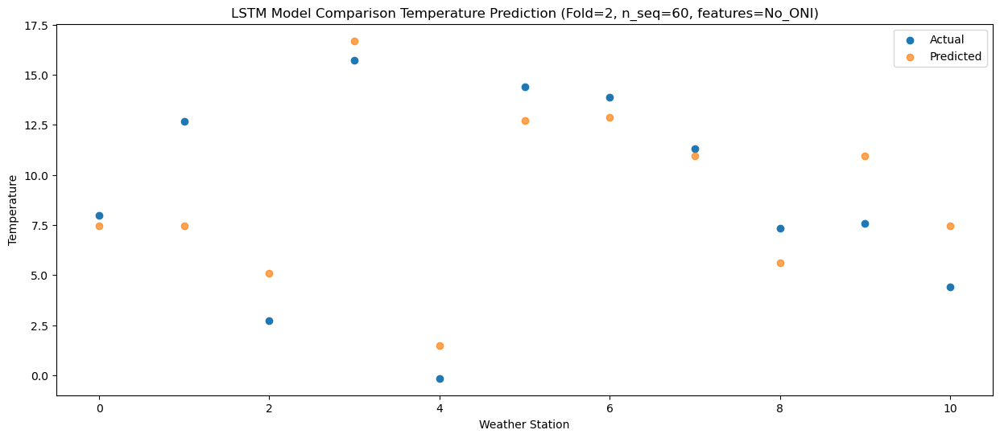

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   2.361531
1                 1    2.70   2.379158
2                 2    0.98  -0.005462
3                 3   11.92  11.599221
4                 4   -3.22  -3.592559
5                 5    8.51   7.625335
6                 6    7.19   7.769044
7                 7    4.41   5.876027
8                 8    1.10   0.529907
9                 9    5.45   5.862075
10               10    1.97   2.370544


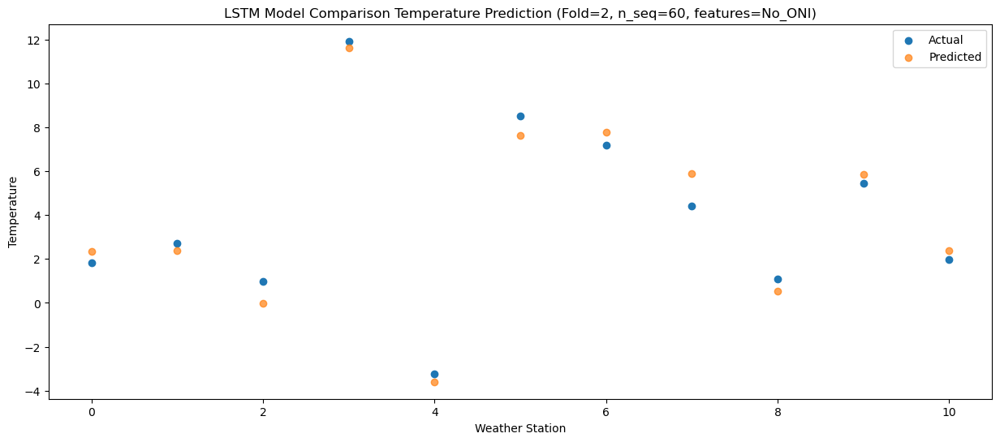

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67  -2.774721
1                 1   -0.01  -2.767055
2                 2   -3.12  -5.150773
3                 3    5.75   6.454132
4                 4   -5.73  -8.747122
5                 5    6.28   2.467612
6                 6    4.57   2.614020
7                 7    2.24   0.720786
8                 8   -1.60  -4.624839
9                 9   -1.08   0.702992
10               10   -3.49  -2.786312


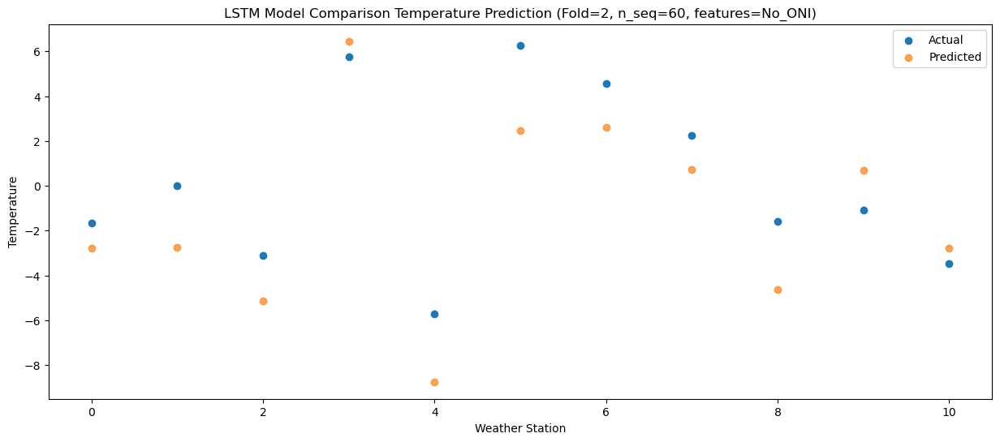

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35  -1.346247
1                 1   -0.26  -1.340258
2                 2   -3.32  -3.725303
3                 3    7.04   7.888176
4                 4   -4.56  -7.319513
5                 5    7.04   3.900808
6                 6    5.45   4.045244
7                 7    1.53   2.160301
8                 8   -1.94  -3.186746
9                 9    2.12   2.138126
10               10   -1.57  -1.352283


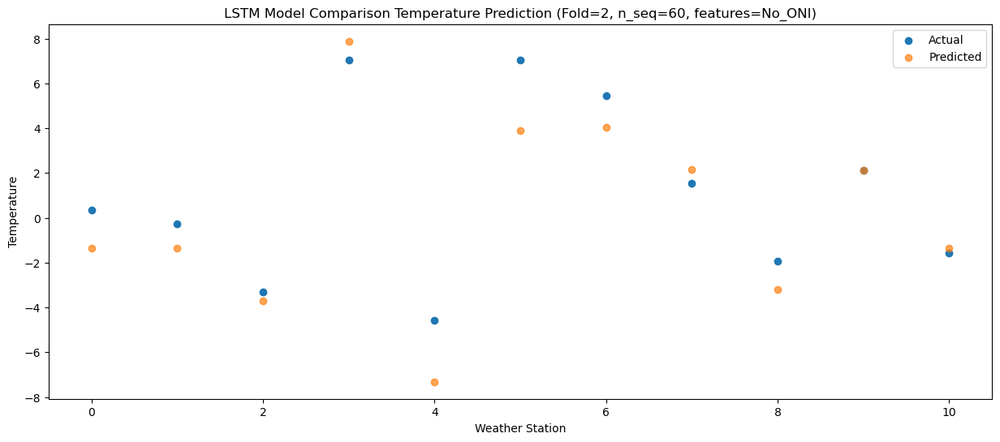

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37  -0.321476
1                 1    1.34  -0.319886
2                 2   -0.26  -2.714822
3                 3    5.16   8.908157
4                 4   -2.43  -6.302507
5                 5    8.23   4.921389
6                 6    5.64   5.070138
7                 7    2.74   3.188194
8                 8   -2.26  -2.161869
9                 9    5.14   3.156595
10               10    1.22  -0.337109


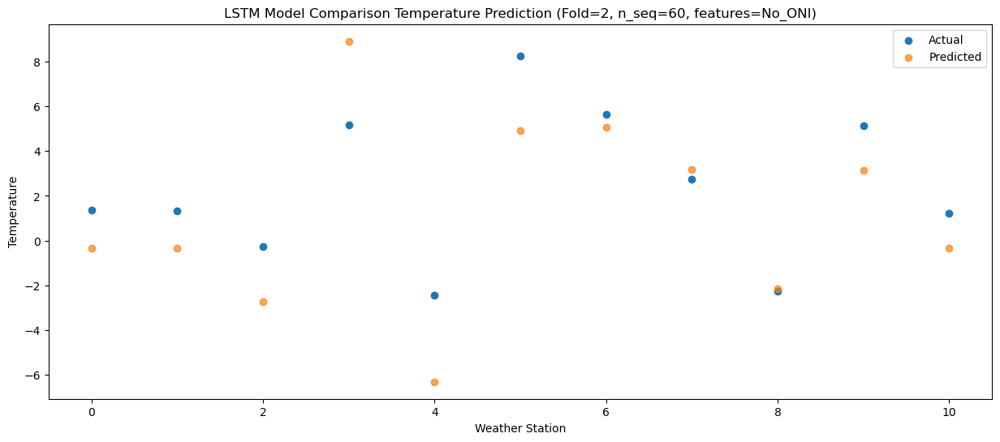

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   1.850494
1                 1    5.41   1.850445
2                 2    0.76  -0.557926
3                 3    7.60  11.072221
4                 4   -0.60  -4.145893
5                 5   12.03   7.084700
6                 6   10.29   7.235123
7                 7    7.44   5.352282
8                 8   -1.25   0.006141
9                 9    5.59   5.322103
10               10    1.75   1.828376


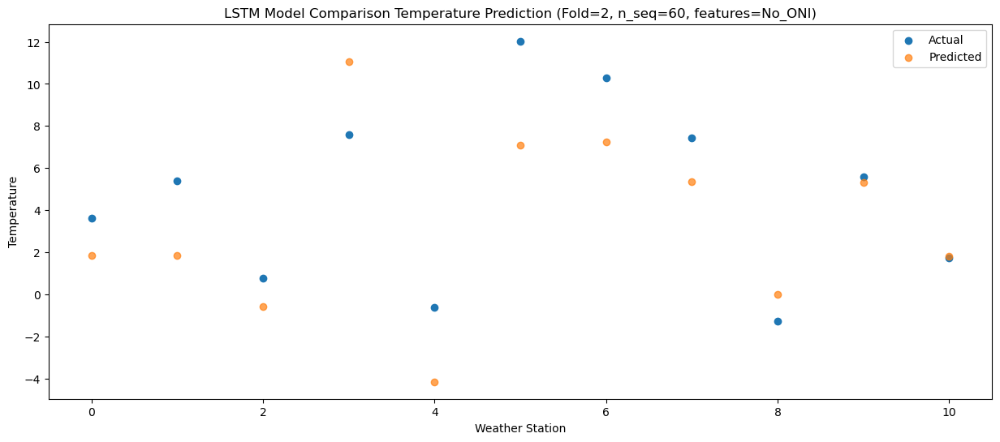

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79   7.072927
1                 1   11.27   7.075091
2                 2    3.30   4.675207
3                 3   13.32  16.302472
4                 4    1.32   1.090060
5                 5   12.95  12.324617
6                 6   12.11  12.478913
7                 7   13.08  10.592167
8                 8    2.59   5.254939
9                 9    9.11  10.566381
10               10    6.64   7.071954


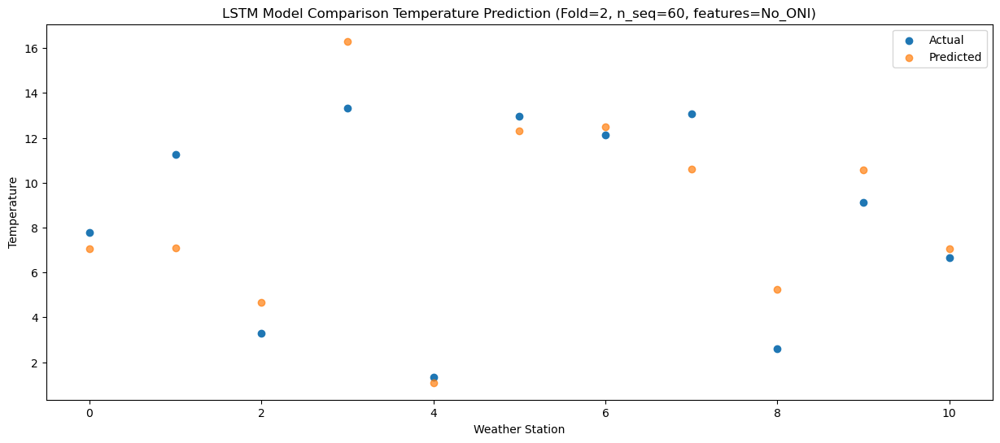

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  11.452063
1                 1   16.76  11.451870
2                 2    4.28   9.048796
3                 3   16.95  20.674498
4                 4    5.35   5.467663
5                 5   18.03  16.701891
6                 6   17.85  16.856743
7                 7   17.73  14.975541
8                 8    3.80   9.638254
9                 9   11.89  14.948150
10               10    9.99  11.446670


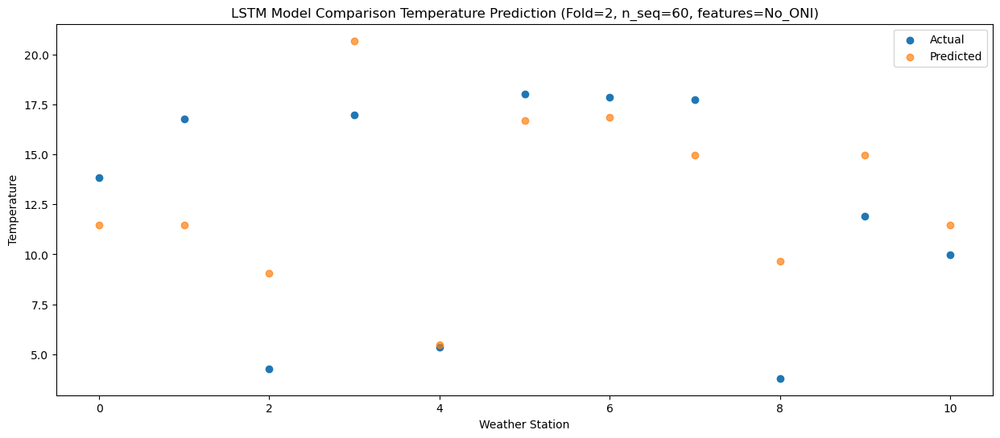

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  15.425334
1                 1   19.37  15.416082
2                 2    6.69  13.007202
3                 3   20.74  24.637264
4                 4    9.00   9.432193
5                 5   22.95  20.666303
6                 6   22.00  20.819560
7                 7   22.39  18.948691
8                 8    5.76  13.620204
9                 9   15.55  18.925391
10               10   12.90  15.416830


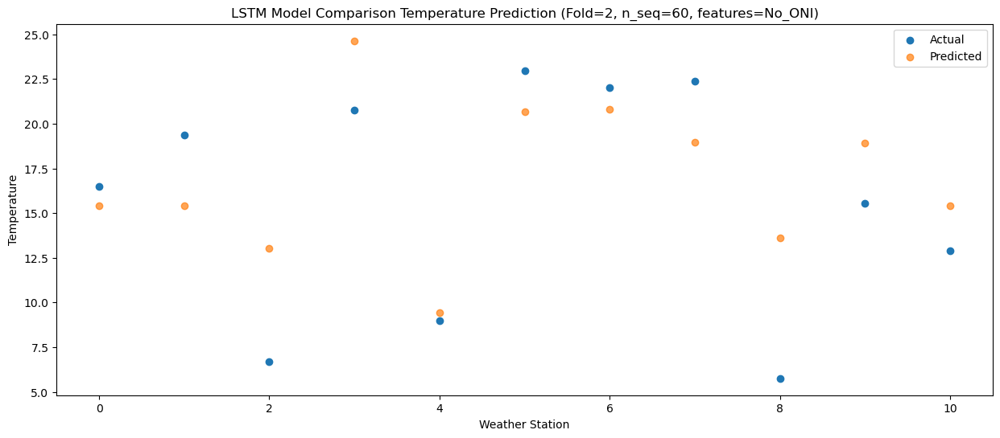

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  18.708647
1                 1   23.47  18.699747
2                 2    8.60  16.303062
3                 3   26.31  27.925413
4                 4   10.44  12.724131
5                 5   25.11  23.949850
6                 6   24.56  24.100624
7                 7   27.14  22.231102
8                 8   12.68  16.901897
9                 9   19.14  22.208495
10               10   16.45  18.697622


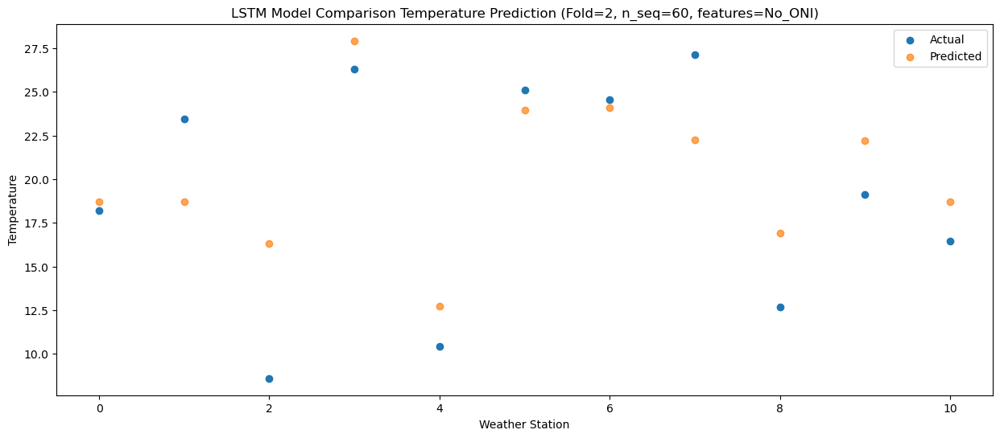

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  18.212966
1                 1   23.96  18.201252
2                 2    8.78  15.805144
3                 3   24.30  27.418766
4                 4   11.74  12.231182
5                 5   26.81  23.454003
6                 6   26.90  23.605417
7                 7   24.14  21.744213
8                 8   12.31  16.407873
9                 9   18.59  21.714157
10               10   15.74  18.204654


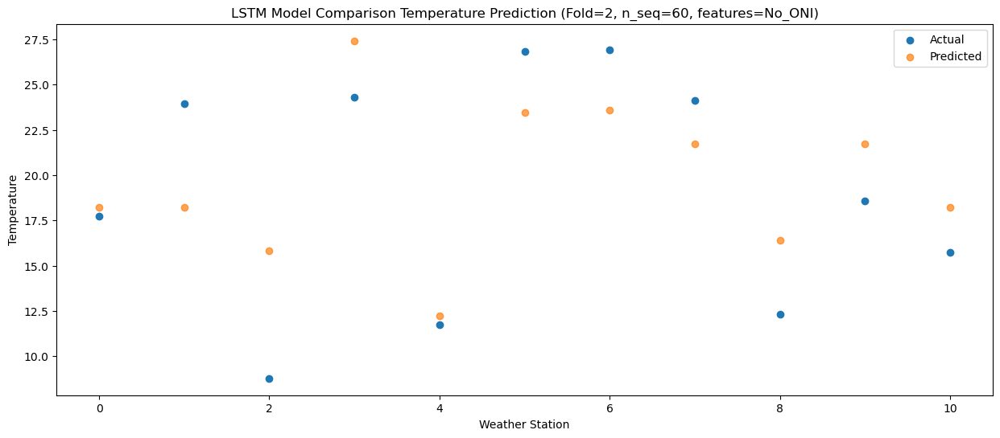

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  14.792812
1                 1   21.09  14.773125
2                 2    6.83  12.395350
3                 3   21.88  24.003854
4                 4    7.31   8.819307
5                 5   22.33  20.043190
6                 6   22.12  20.186642
7                 7   21.48  18.323396
8                 8    8.81  12.994008
9                 9   14.63  18.300611
10               10   12.96  14.792166


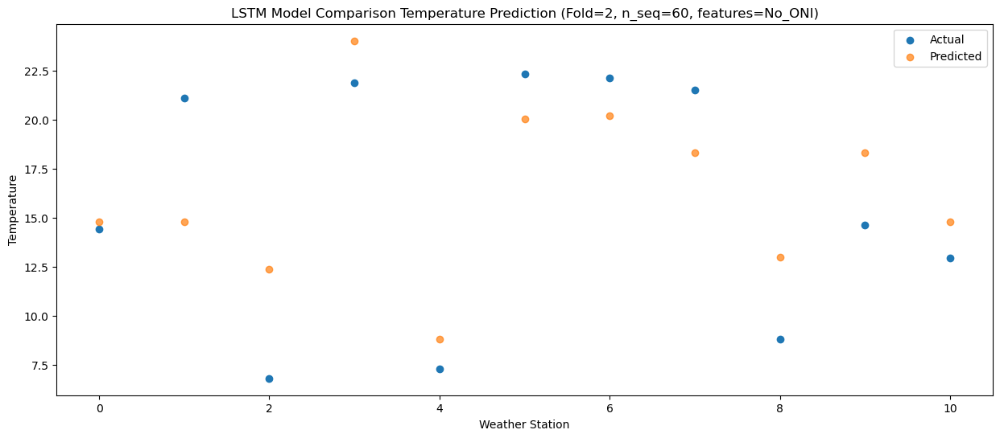

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28   8.596806
1                 1   12.05   8.570867
2                 2    3.25   6.199128
3                 3   16.86  17.804536
4                 4    1.15   2.634195
5                 5   14.44  13.854620
6                 6   13.40  13.987017
7                 7   14.74  12.119062
8                 8    7.22   6.784757
9                 9    9.34  12.099611
10               10    6.91   8.594334


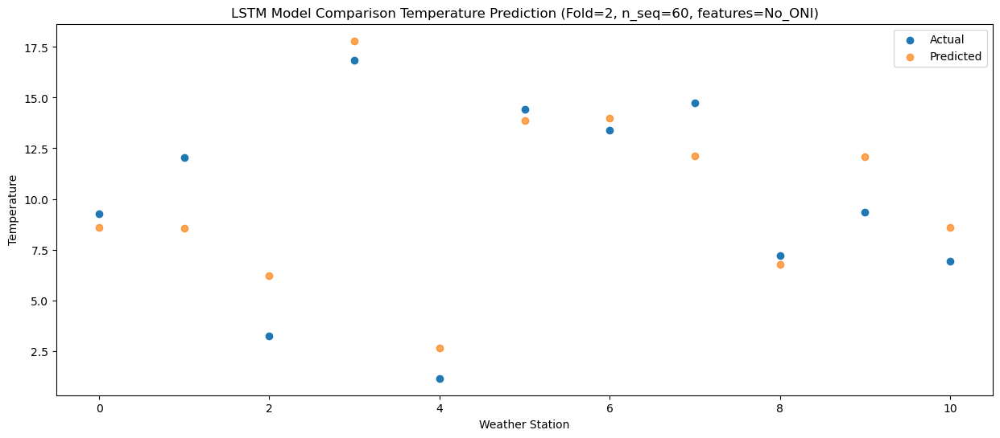

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   2.077411
1                 1    5.33   2.050632
2                 2   -0.73  -0.321455
3                 3    8.88  11.288405
4                 4   -3.96  -3.888222
5                 5    8.16   7.331104
6                 6    8.06   7.465698
7                 7    7.63   5.588876
8                 8    2.83   0.255970
9                 9    3.44   5.571437
10               10    0.70   2.067039


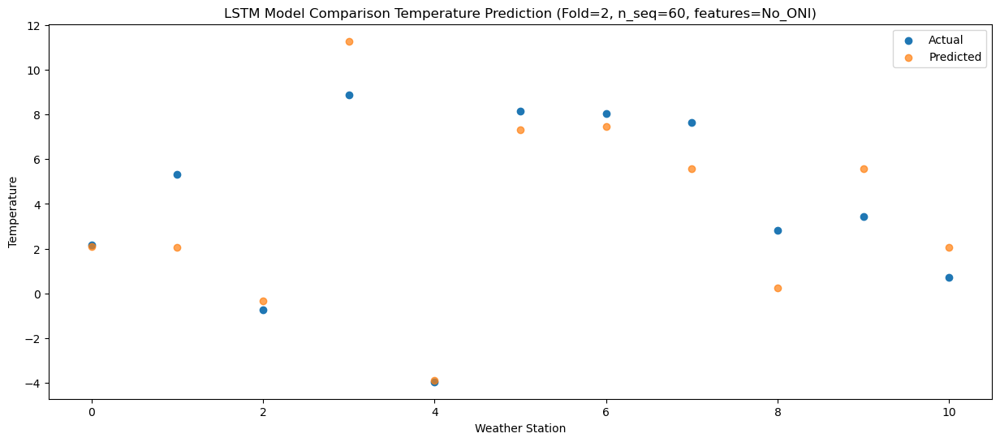

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -0.012381
1                 1    1.66  -0.036376
2                 2   -2.66  -2.411199
3                 3    8.14   9.197087
4                 4   -6.56  -5.976541
5                 5    6.05   5.239679
6                 6    5.08   5.379843
7                 7    2.59   3.494704
8                 8    0.50  -1.838434
9                 9    0.97   3.478606
10               10   -2.15  -0.032163


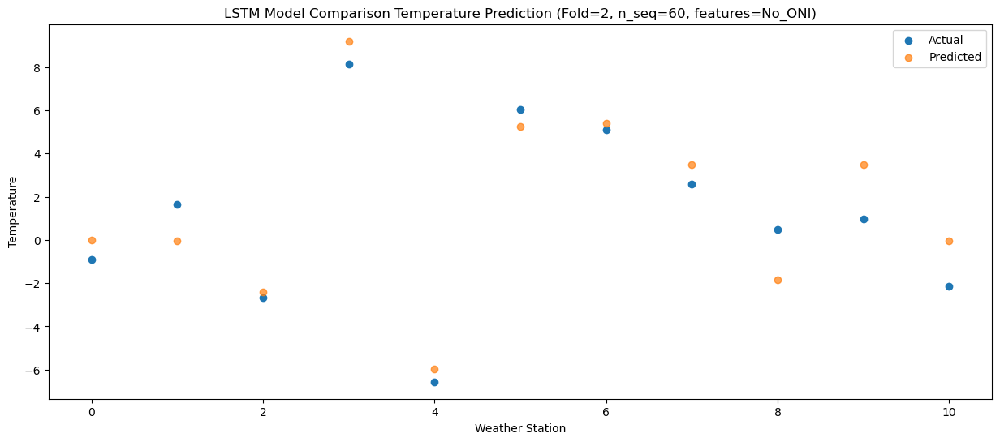

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68  -4.390918
1                 1   -3.43  -4.416548
2                 2   -4.66  -6.786930
3                 3    3.97   4.814678
4                 4   -8.64 -10.356207
5                 5    1.90   0.861328
6                 6   -0.10   1.000779
7                 7    2.26  -0.888836
8                 8   -1.30  -6.216081
9                 9   -0.88  -0.896094
10               10   -5.47  -4.413398


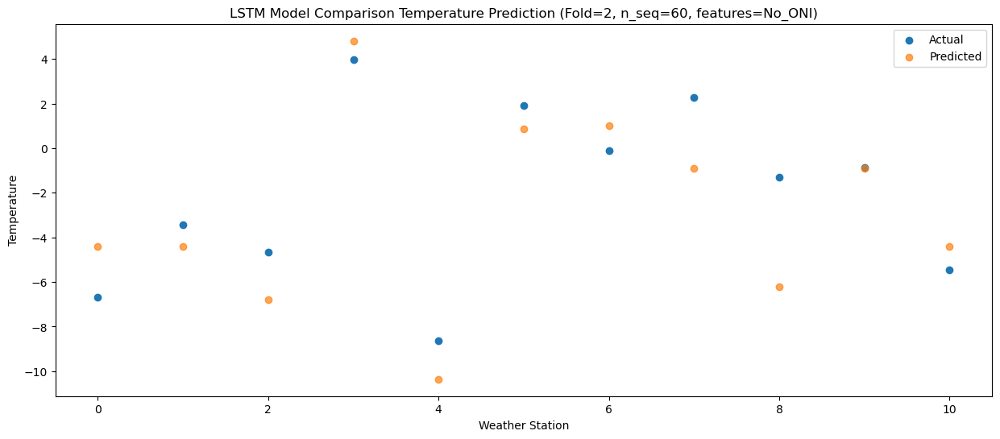

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64   0.523429
1                 1    4.05   0.505336
2                 2   -4.18  -1.863698
3                 3    4.65   9.729902
4                 4   -4.48  -5.433612
5                 5    8.66   5.778969
6                 6    8.16   5.914519
7                 7    5.47   4.031935
8                 8   -0.77  -1.291882
9                 9    2.34   4.024305
10               10   -0.93   0.507536


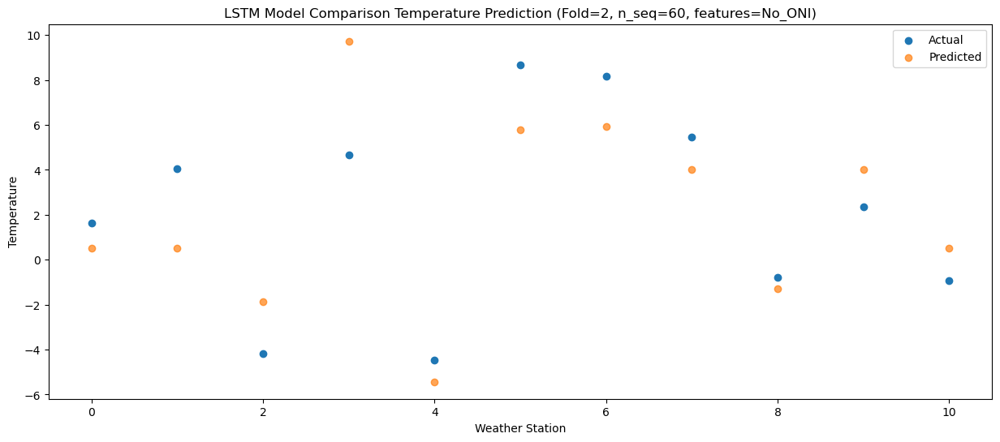

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53   3.680930
1                 1    6.82   3.661487
2                 2    0.24   1.297558
3                 3    9.05  12.890376
4                 4   -1.81  -2.274579
5                 5   11.03   8.939335
6                 6   10.51   9.074918
7                 7    8.04   7.185493
8                 8    0.17   1.866153
9                 9    5.90   7.185694
10               10    3.24   3.667752


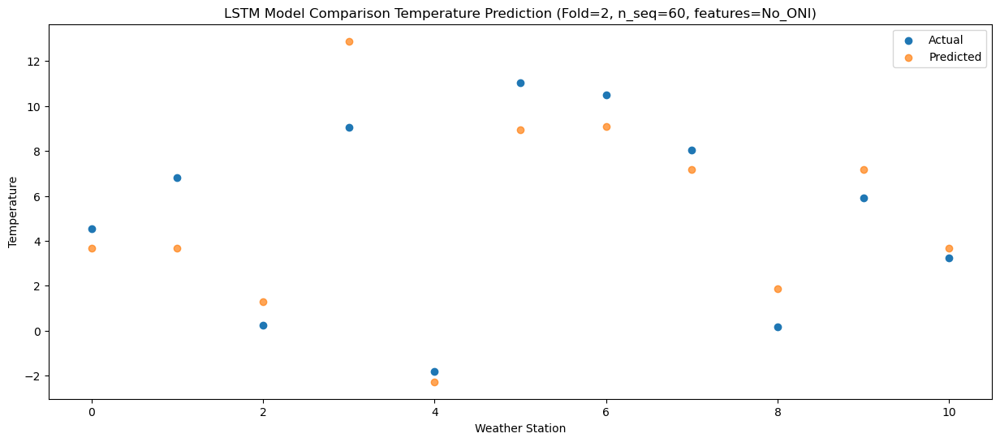

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29   8.177108
1                 1   12.23   8.158624
2                 2    1.63   5.793207
3                 3   11.48  17.392415
4                 4    1.85   2.217313
5                 5   14.77  13.439190
6                 6   13.96  13.573371
7                 7   12.45  11.693919
8                 8    2.28   6.385010
9                 9    9.96  11.691056
10               10    7.22   8.172248


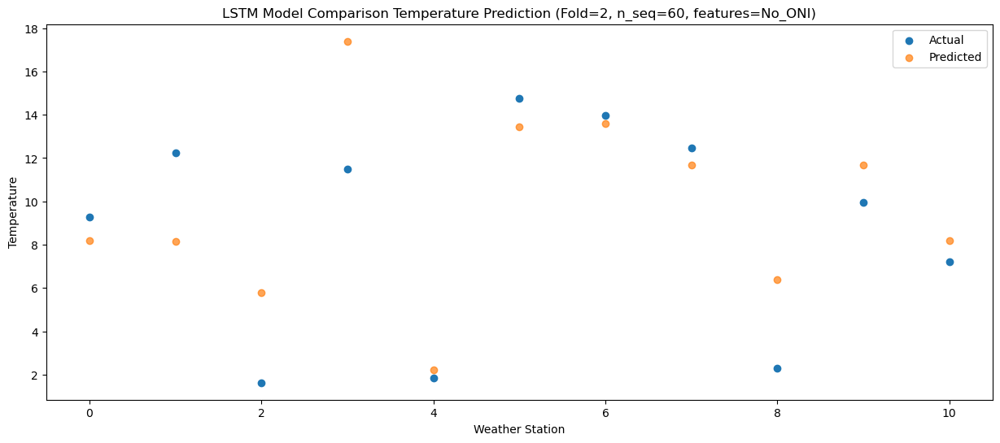

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  13.473518
1                 1   16.84  13.458066
2                 2    6.48  11.088088
3                 3   17.27  22.689052
4                 4    6.90   7.510988
5                 5   18.47  18.734319
6                 6   18.85  18.869417
7                 7   18.27  16.999724
8                 8    4.08  11.694335
9                 9   14.34  16.986712
10               10   11.68  13.467004


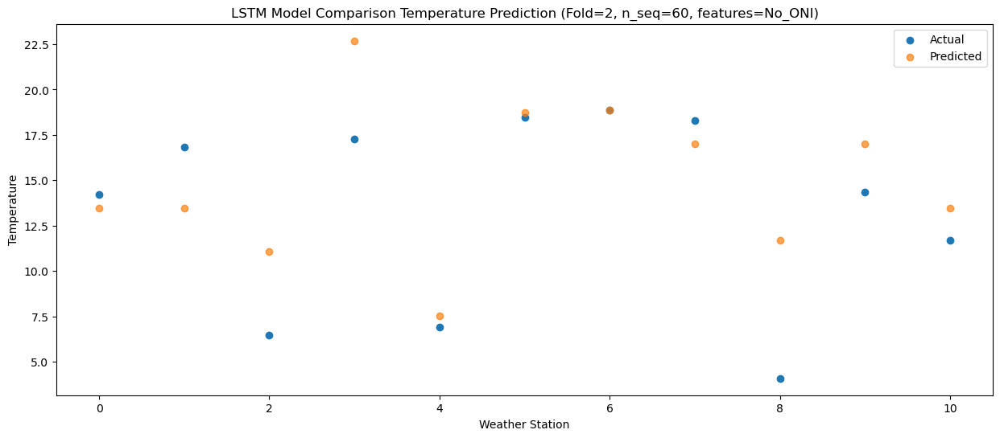

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  17.445463
1                 1   23.01  17.427297
2                 2    7.39  15.045009
3                 3   23.24  26.648677
4                 4    8.73  11.465655
5                 5   21.70  22.687704
6                 6   22.35  22.824862
7                 7   24.69  20.962296
8                 8    8.76  15.656865
9                 9   18.22  20.942869
10               10   16.03  17.418401


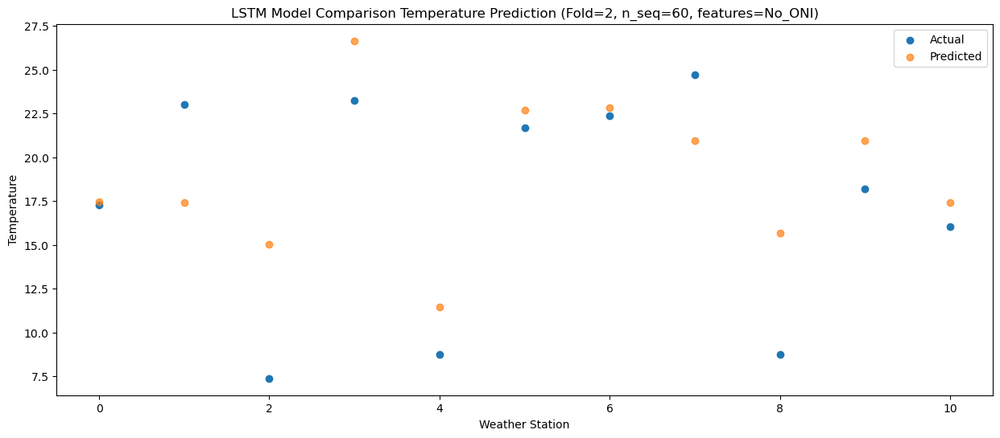

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  18.704882
1                 1   23.56  18.692249
2                 2    8.23  16.307500
3                 3   26.02  27.911003
4                 4    9.34  12.727741
5                 5   20.18  23.959476
6                 6   22.66  24.097453
7                 7   24.16  22.231859
8                 8   12.49  16.938671
9                 9   19.61  22.210353
10               10   17.26  18.681850


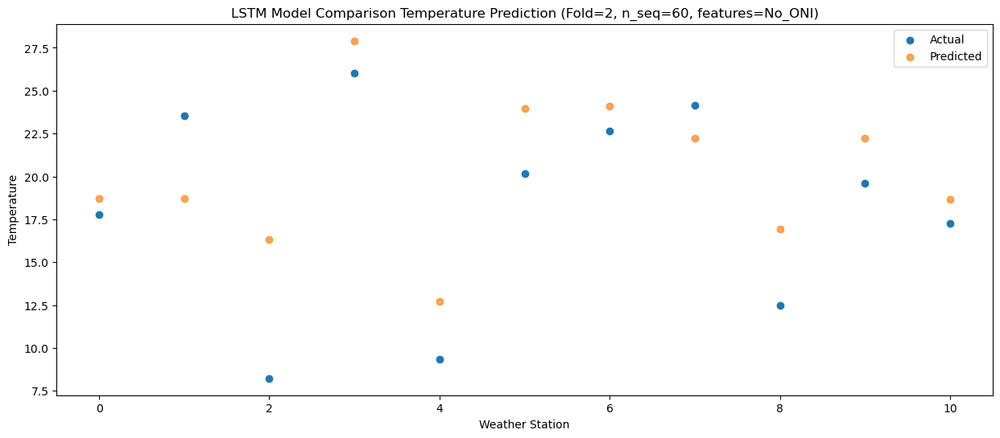

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  18.104890
1                 1   23.61  18.092153
2                 2    8.19  15.711613
3                 3   24.31  27.312245
4                 4    9.69  12.138506
5                 5   21.83  23.370877
6                 6   24.46  23.508799
7                 7   24.55  21.654406
8                 8   12.07  16.365042
9                 9   17.59  21.628328
10               10   15.64  18.099586


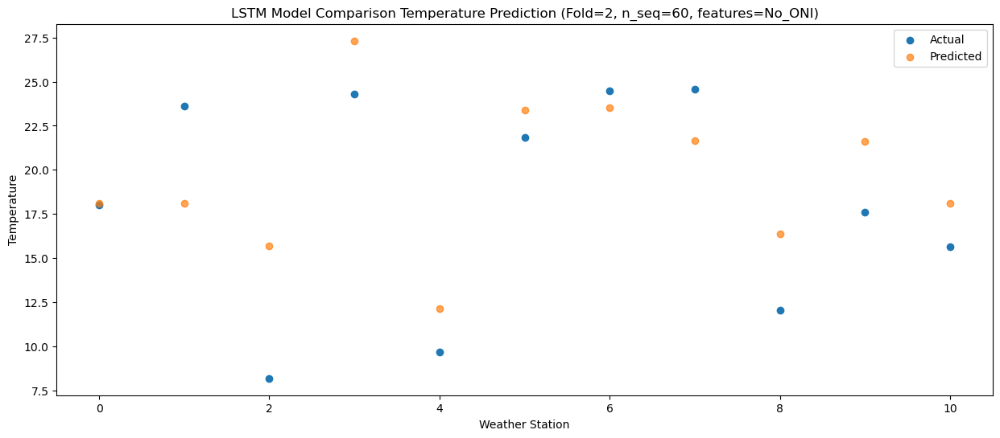

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  14.815383
1                 1   19.88  14.812309
2                 2    7.87  12.431190
3                 3   20.79  24.028811
4                 4    6.89   8.859857
5                 5   19.10  20.093289
6                 6   20.23  20.230628
7                 7   20.52  18.388481
8                 8   10.22  13.108408
9                 9   14.63  18.361272
10               10   13.05  14.827064


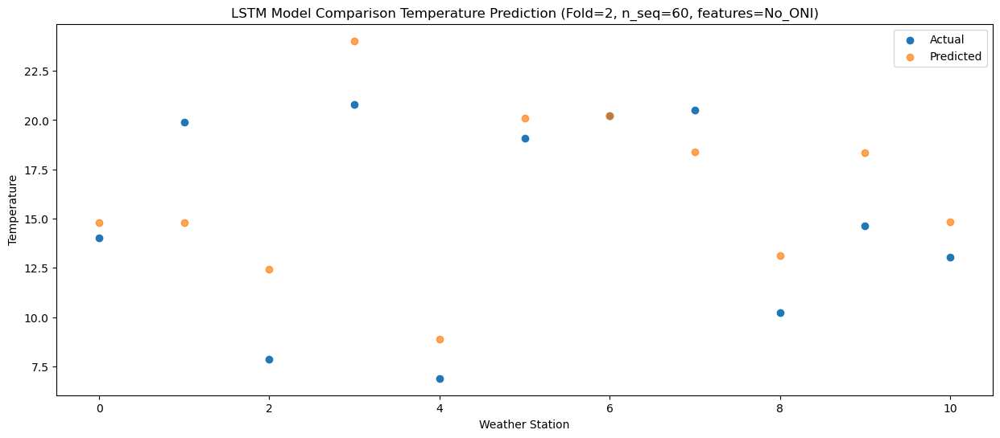

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77   9.707861
1                 1   14.91   9.708585
2                 2    4.40   7.326171
3                 3   15.53  18.919946
4                 4    2.20   3.751595
5                 5   16.45  14.981213
6                 6   17.26  15.121668
7                 7   16.26  13.283988
8                 8    7.23   8.001192
9                 9    9.41  13.251970
10               10    6.63   9.715600


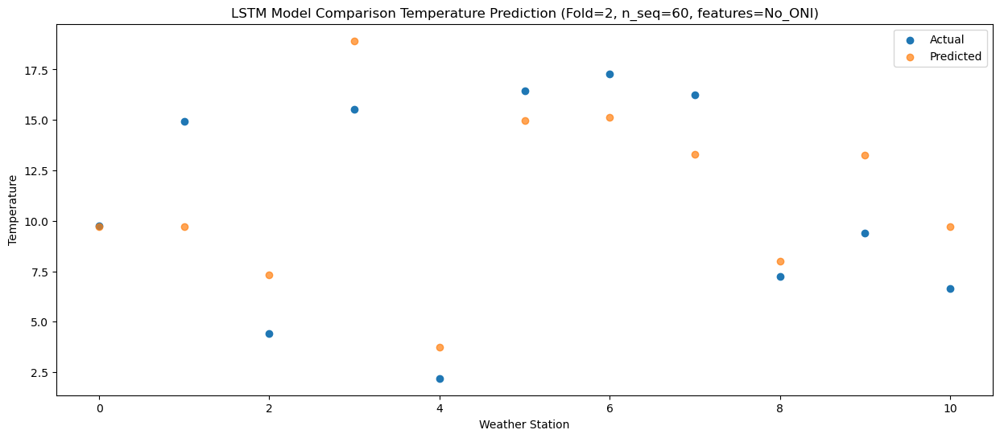

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

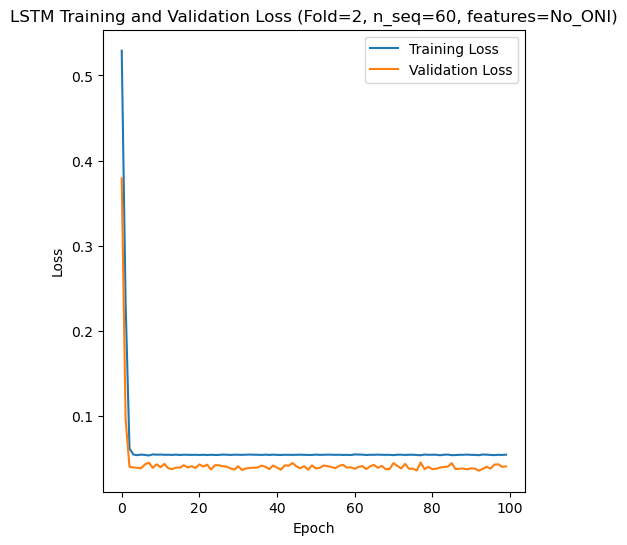

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 32s 139ms/step - loss: 0.5865 - accuracy: 0.0000e+00 - mae: 0.4813 - rmse: 0.5865 - mape: 106.5288 - pearson: 0.0038 - val_loss: 0.4386 - val_accuracy: 0.0000e+00 - val_mae: 0.3637 - val_rmse: 0.4386 - val_mape: 82.1909 - val_pearson: 0.0077
Epoch 2/100
84/84 [==============================] - 6s 68ms/step - loss: 0.2897 - accuracy: 0.2024 - mae: 0.2403 - rmse: 0.2897 - mape: 53.0583 - pearson: 0.1299 - val_loss: 0.1592 - val_accuracy: 0.5000 - val_mae: 0.1332 - val_rmse: 0.1592 - val_mape: 29.3806 - val_pearson: 0.3918
Epoch 3/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0754 - accuracy: 0.6190 - mae: 0.0611 - rmse: 0.0754 - mape: 13.9385 - pearson: 0

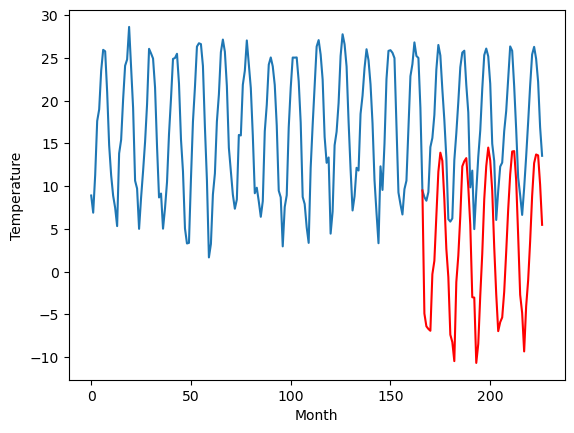

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		0.79		-1.43
0.87		-0.70		-1.57
0.03		-1.01		-1.04
0.18		-1.23		-1.41
7.67		5.38		-2.29
8.59		6.94		-1.65
12.99		12.22		-0.77
20.09		17.36		-2.73
21.95		19.59		-2.36
20.09		18.63		-1.46
16.42		14.14		-2.28
9.31		8.35		-0.96
6.49		5.05		-1.44
-0.06		-1.70		-1.64
-1.21		-2.56		-1.35
-4.93		-4.79		0.14
7.04		4.44		-2.60
8.90		7.53		-1.37
13.12		12.16		-0.96
19.83		17.97		-1.86
21.14		18.58		-2.56
21.71		18.94		-2.77
18.98		15.58		-3.40
12.38		11.13		-1.25
4.67		2.68		-1.99
5.98		2.63		-3.35
-2.85		-5.01		-2.16
-1.63		-2.79		-1.16
5.15		2.85		-2.30
10.00		7.76		-2.24
15.43		14.15		-1.28
20.58		17.99		-2.59
24.62		20.17		-4.45
21.54		18.65		-2.89
17.68		15.12		-2.56
11.13		8.50		-2.63
3.90		3.02		-0.88
-0.15		-1.30		-1.15
0.55		-0.24		-0.79
2.51		0.30		-2.21
5.11		3.31		-1.80
10.16		7.98		-2.18
15.47		12.95		-2.52
19.80		17.03		-2.77
22.06		19.74		-2.32
22.24		19.79		-2.45
18.19		16.37		-1.82

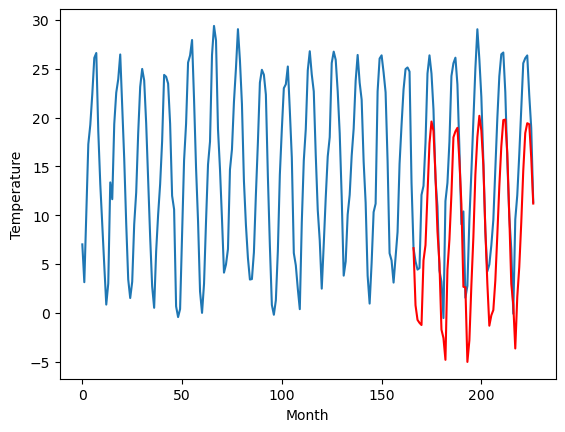

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-1.09		-3.80
0.18		-2.58		-2.76
-1.04		-2.87		-1.83
1.38		-3.09		-4.47
3.17		3.51		0.34
7.83		5.07		-2.76
13.02		10.35		-2.67
16.37		15.49		-0.88
19.15		17.72		-1.43
19.68		16.78		-2.90
15.35		12.28		-3.07
9.86		6.49		-3.37
1.21		3.19		1.98
-1.99		-3.57		-1.58
-0.73		-4.42		-3.69
1.57		-6.65		-8.22
2.72		2.59		-0.13
8.45		5.66		-2.79
13.25		10.28		-2.97
18.10		16.10		-2.00
21.23		16.70		-4.53
19.03		17.07		-1.96
15.72		13.71		-2.01
7.06		9.25		2.19
2.72		0.79		-1.93
-1.20		0.76		1.96
-1.53		-6.88		-5.35
0.17		-4.66		-4.83
4.88		0.97		-3.91
7.95		5.89		-2.06
12.19		12.26		0.07
17.58		16.11		-1.47
20.15		18.29		-1.86
20.33		16.78		-3.55
17.51		13.24		-4.27
10.33		6.63		-3.70
-0.40		1.14		1.54
-1.36		-3.18		-1.82
0.03		-2.12		-2.15
-0.82		-1.59		-0.77
2.05		1.42		-0.63
7.68		6.08		-1.60
12.12		11.05		-1.07
14.92		15.12		0.20
20.58		17.81		-2.77
18.89		17.87		-1.02
15.12		14.44		-0.68
9.81	

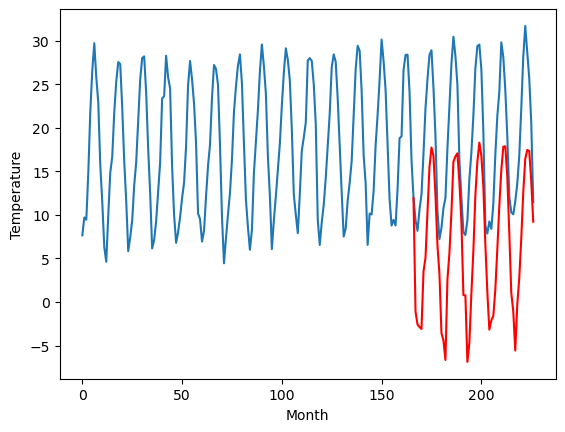

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-0.46		2.40
-2.85		-1.95		0.90
-3.40		-2.26		1.14
-3.75		-2.47		1.28
3.16		4.14		0.98
3.80		5.71		1.91
8.37		10.99		2.62
14.19		16.12		1.93
17.99		18.35		0.36
15.57		17.40		1.83
11.51		12.90		1.39
6.09		7.11		1.02
2.17		3.81		1.64
-5.03		-2.93		2.10
-6.49		-3.79		2.70
-7.81		-6.02		1.79
2.40		3.22		0.82
4.75		6.31		1.56
8.82		10.94		2.12
14.74		16.75		2.01
15.73		17.36		1.63
16.25		17.72		1.47
12.12		14.36		2.24
8.54		9.90		1.36
-1.12		1.45		2.57
0.37		1.41		1.04
-8.58		-6.23		2.35
-4.06		-4.01		0.05
1.69		1.63		-0.06
4.70		6.53		1.83
11.48		12.92		1.44
14.96		16.77		1.81
16.51		18.96		2.45
15.44		17.44		2.00
11.46		13.90		2.44
4.19		7.29		3.10
1.07		1.81		0.74
-4.20		-2.51		1.69
-2.45		-1.45		1.00
-0.11		-0.91		-0.80
0.13		2.10		1.97
6.37		6.76		0.39
9.06		11.73		2.67
12.80		15.80		3.00
16.42		18.50		2.08
15.31		18.55		3.24
12.58		15.12		2.54
7.14		8.64		1.50
0.75		1.75		1.00
-1.08		-

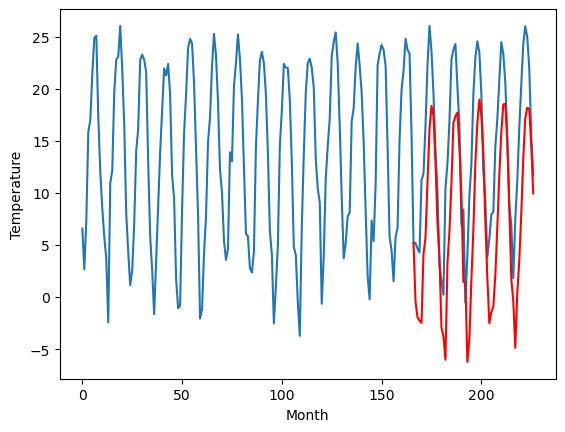

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-1.53		-4.84
0.05		-3.03		-3.08
-2.82		-3.34		-0.52
-1.67		-3.56		-1.89
5.74		3.06		-2.68
8.77		4.64		-4.13
14.84		9.91		-4.93
21.89		15.05		-6.84
23.35		17.27		-6.08
20.79		16.31		-4.48
16.72		11.82		-4.90
8.99		6.04		-2.95
6.17		2.74		-3.43
-1.00		-4.00		-3.00
-2.47		-4.87		-2.40
-6.34		-7.10		-0.76
6.74		2.13		-4.61
10.03		5.22		-4.81
14.60		9.86		-4.74
22.08		15.67		-6.41
22.08		16.28		-5.80
22.20		16.64		-5.56
18.84		13.28		-5.56
13.42		8.83		-4.59
3.68		0.38		-3.30
3.32		0.34		-2.98
-6.15		-7.29		-1.14
-3.63		-5.08		-1.45
4.83		0.56		-4.27
8.96		5.47		-3.49
16.53		11.86		-4.67
21.98		15.71		-6.27
23.10		17.89		-5.21
21.28		16.36		-4.92
16.96		12.83		-4.13
9.69		6.21		-3.48
3.80		0.73		-3.07
-2.17		-3.59		-1.42
-0.45		-2.53		-2.08
6.07		-2.00		-8.07
3.11		1.02		-2.09
10.32		5.69		-4.63
16.32		10.67		-5.65
20.42		14.75		-5.67
22.12		17.46		-4.66
20.83		17.51		-3.32
17.47		14.09		-3.

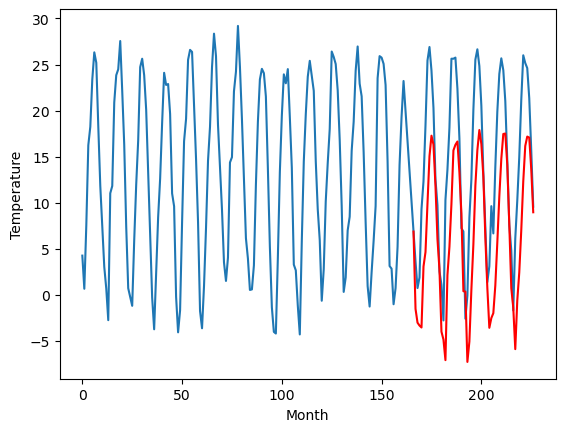

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-3.85		1.97
-5.61		-5.35		0.26
-7.03		-5.67		1.36
-7.44		-5.88		1.56
-0.58		0.74		1.32
1.69		2.32		0.63
7.10		7.59		0.49
14.09		12.72		-1.37
15.98		14.95		-1.03
13.47		13.99		0.52
9.84		9.50		-0.34
3.84		3.72		-0.12
-0.10		0.42		0.52
-7.71		-6.32		1.39
-9.16		-7.19		1.97
-11.88		-9.42		2.46
-0.55		-0.19		0.36
2.90		2.89		-0.01
7.18		7.53		0.35
13.89		13.35		-0.54
14.27		13.96		-0.31
14.59		14.31		-0.28
11.33		10.96		-0.37
6.75		6.51		-0.24
-4.10		-1.94		2.16
-3.05		-1.98		1.07
-11.87		-9.61		2.26
-8.68		-7.40		1.28
-1.72		-1.75		-0.03
2.13		3.16		1.03
9.93		9.55		-0.38
13.87		13.40		-0.47
15.86		15.58		-0.28
14.21		14.05		-0.16
10.26		10.52		0.26
4.22		3.90		-0.32
-2.33		-1.58		0.75
-7.87		-5.90		1.97
-5.73		-4.84		0.89
-4.01		-4.30		-0.29
-3.11		-1.28		1.83
3.12		3.38		0.26
8.53		8.37		-0.16
11.99		12.45		0.46
15.25		15.16		-0.09
13.70		15.20		1.50
10.24		11.78		1.54
4.59		5.30		0.71


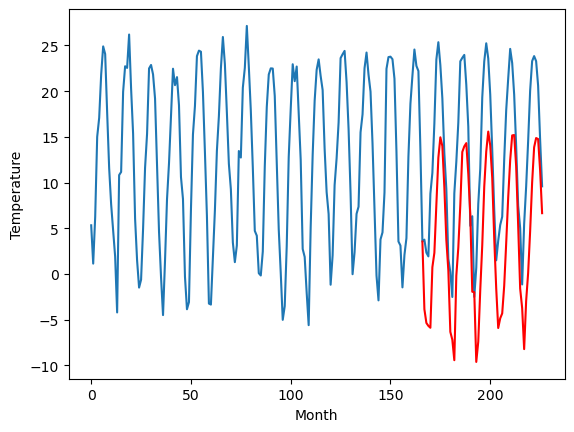

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-2.78		3.68
-12.13		-4.27		7.86
-12.22		-4.59		7.63
-12.03		-4.80		7.23
-7.10		1.81		8.91
-4.12		3.39		7.51
2.99		8.66		5.67
7.20		13.80		6.60
9.19		16.02		6.83
9.94		15.07		5.13
4.44		10.57		6.13
0.70		4.78		4.08
-6.49		1.48		7.97
-12.19		-5.27		6.92
-11.92		-6.13		5.79
-11.82		-8.37		3.45
-8.85		0.87		9.72
-4.07		3.94		8.01
0.98		8.59		7.61
8.37		14.41		6.04
10.21		15.01		4.80
8.29		15.37		7.08
6.42		12.02		5.60
-1.55		7.56		9.11
-4.29		-0.89		3.40
-9.05		-0.94		8.11
-11.34		-8.57		2.77
-13.06		-6.35		6.71
-8.52		-0.70		7.82
-4.20		4.21		8.41
1.71		10.59		8.88
7.48		14.44		6.96
9.40		16.61		7.21
8.64		15.07		6.43
6.48		11.54		5.06
-1.78		4.92		6.70
-9.46		-0.55		8.91
-11.63		-4.88		6.75
-12.36		-3.82		8.54
-12.33		-3.29		9.04
-10.54		-0.27		10.27
-5.20		4.40		9.60
2.01		9.38		7.37
6.59		13.45		6.86
12.73		16.16		3.43
10.14		16.21		6.07
5.99		12.79		6.80
-0.14		6.31		6.45
-6.00		-0.57

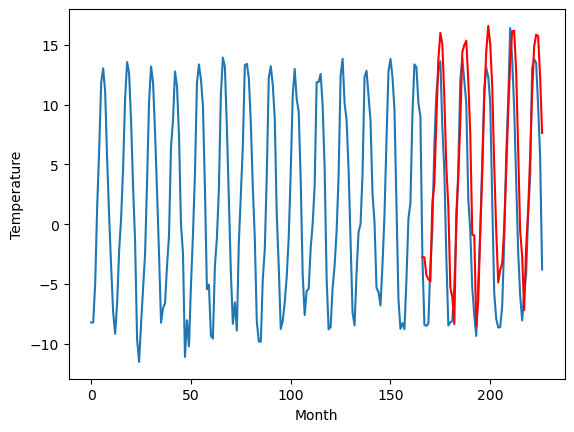

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-16.35		-3.19
-17.89		-17.84		0.05
-16.73		-18.15		-1.42
-15.22		-18.36		-3.14
-12.11		-11.75		0.36
-6.20		-10.17		-3.97
1.07		-4.89		-5.96
4.53		0.25		-4.28
8.76		2.47		-6.29
8.87		1.52		-7.35
4.06		-2.98		-7.04
-2.88		-8.78		-5.90
-11.69		-12.08		-0.39
-17.38		-18.83		-1.45
-16.83		-19.69		-2.86
-13.98		-21.93		-7.95
-12.38		-12.69		-0.31
-4.41		-9.62		-5.21
0.02		-4.98		-5.00
7.66		0.84		-6.82
8.74		1.43		-7.31
7.51		1.79		-5.72
3.54		-1.55		-5.09
-6.81		-6.01		0.80
-9.33		-14.46		-5.13
-16.60		-14.50		2.10
-16.67		-22.14		-5.47
-14.63		-19.93		-5.30
-9.92		-14.29		-4.37
-5.29		-9.38		-4.09
-0.62		-3.01		-2.39
5.86		0.84		-5.02
8.09		3.00		-5.09
6.50		1.48		-5.02
4.14		-2.05		-6.19
-3.75		-8.67		-4.92
-15.17		-14.15		1.02
-17.50		-18.49		-0.99
-18.01		-17.43		0.58
-17.10		-16.91		0.19
-14.27		-13.89		0.38
-6.32		-9.22		-2.90
-0.52		-4.25		-3.73
1.98		-0.18		-2.16
10.34		2.51		-7.83

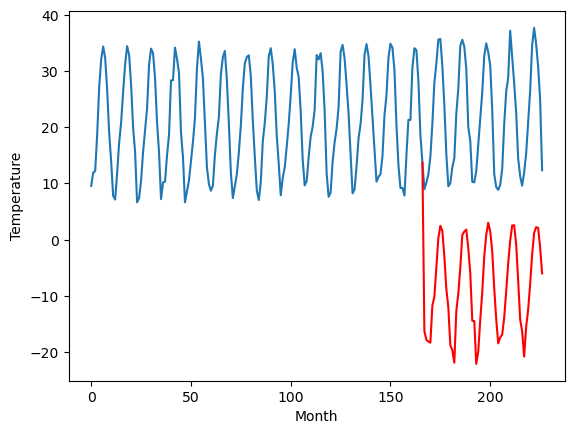

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		1.46		-3.82
4.03		-0.03		-4.06
3.40		-0.33		-3.73
5.42		-0.54		-5.96
4.86		6.06		1.20
8.48		7.62		-0.86
10.88		12.90		2.02
13.42		18.04		4.62
12.61		20.26		7.65
14.49		19.32		4.83
13.91		14.82		0.91
11.69		9.02		-2.67
4.53		5.73		1.20
2.48		-1.03		-3.51
3.70		-1.87		-5.57
4.63		-4.11		-8.74
4.41		5.12		0.71
6.60		8.20		1.60
10.89		12.83		1.94
12.59		18.64		6.05
11.77		19.23		7.46
12.32		19.60		7.28
11.77		16.25		4.48
9.01		11.79		2.78
6.19		3.33		-2.86
2.49		3.29		0.80
3.11		-4.34		-7.45
4.07		-2.12		-6.19
6.30		3.52		-2.78
7.74		8.44		0.70
10.73		14.81		4.08
13.88		18.66		4.78
12.23		20.83		8.60
13.65		19.31		5.66
13.88		15.78		1.90
9.15		9.18		0.03
3.42		3.70		0.28
2.22		-0.64		-2.86
3.89		0.42		-3.47
2.09		0.94		-1.15
3.55		3.96		0.41
7.63		8.62		0.99
8.66		13.59		4.93
10.56		17.65		7.09
13.57		20.35		6.78
14.60		20.42		5.82
11.99		16.99		5.00
10.53		10.50		-0.03
6.49		3.61		-2.88
4.

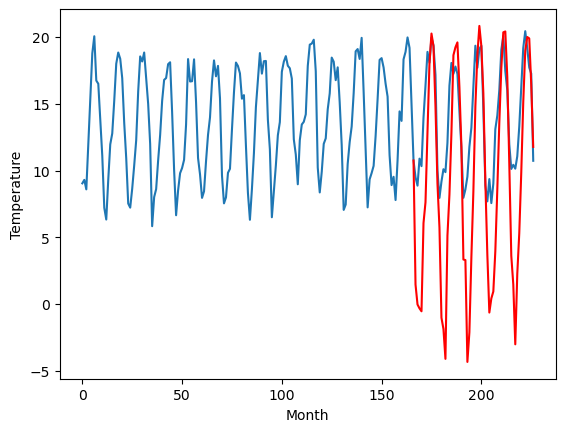

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		0.93		0.30
-2.13		-0.56		1.57
-2.10		-0.87		1.23
-1.66		-1.08		0.58
1.92		5.54		3.62
3.36		7.11		3.75
8.92		12.39		3.47
15.90		17.53		1.63
19.85		19.75		-0.10
18.67		18.81		0.14
14.33		14.30		-0.03
9.01		8.51		-0.50
4.94		5.21		0.27
-1.40		-1.54		-0.14
-4.42		-2.39		2.03
-4.54		-4.63		-0.09
0.46		4.60		4.14
5.08		7.68		2.60
9.91		12.32		2.41
15.78		18.14		2.36
17.92		18.74		0.82
18.54		19.10		0.56
15.22		15.75		0.53
10.78		11.29		0.51
1.86		2.84		0.98
0.26		2.80		2.54
-6.29		-4.83		1.46
-3.53		-2.61		0.92
0.43		3.03		2.60
4.72		7.94		3.22
10.51		14.33		3.82
14.83		18.17		3.34
19.38		20.34		0.96
19.30		18.83		-0.47
14.39		15.28		0.89
8.13		8.67		0.54
4.17		3.20		-0.97
-2.19		-1.13		1.06
-0.21		-0.07		0.14
-1.94		0.46		2.40
0.03		3.46		3.43
6.08		8.13		2.05
9.72		13.09		3.37
13.71		17.16		3.45
19.39		19.86		0.47
17.14		19.92		2.78
14.57		16.49		1.92
9.14		10.01		0.87
1.29		3.12		1.83
0.5

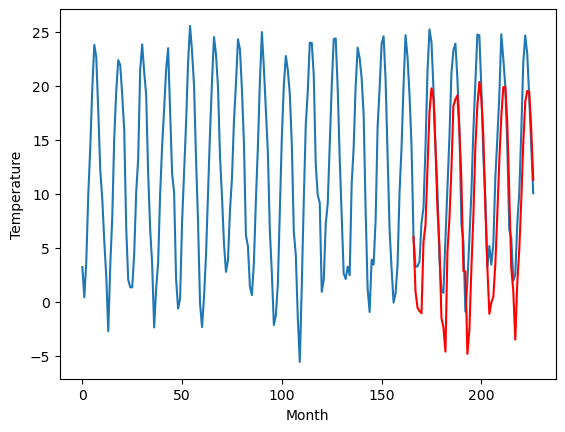

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-4.91		1.55
-9.42		-6.40		3.02
-9.01		-6.71		2.30
-8.09		-6.92		1.17
-3.68		-0.30		3.38
-1.74		1.28		3.02
4.03		6.56		2.53
10.75		11.70		0.95
14.52		13.93		-0.59
12.65		12.98		0.33
7.68		8.48		0.80
2.19		2.69		0.50
-2.09		-0.62		1.47
-8.91		-7.37		1.54
-10.47		-8.22		2.25
-11.27		-10.46		0.81
-4.08		-1.22		2.86
0.79		1.86		1.07
5.05		6.50		1.45
11.22		12.32		1.10
12.86		12.93		0.07
12.59		13.29		0.70
8.33		9.94		1.61
4.21		5.48		1.27
-6.01		-2.96		3.05
-6.42		-3.01		3.41
-13.40		-10.64		2.76
-9.59		-8.42		1.17
-4.41		-2.77		1.64
-0.59		2.13		2.72
6.19		8.52		2.33
10.18		12.37		2.19
13.96		14.53		0.57
13.09		13.02		-0.07
7.86		9.48		1.62
0.25		2.86		2.61
-2.87		-2.60		0.27
-9.90		-6.94		2.96
-7.25		-5.88		1.37
-7.04		-5.34		1.70
-5.48		-2.34		3.14
2.09		2.32		0.23
4.56		7.29		2.73
8.49		11.35		2.86
13.33		14.06		0.73
11.36		14.10		2.74
8.07		10.68		2.61
2.78		4.19		1.41
-5.49		-2.70		2

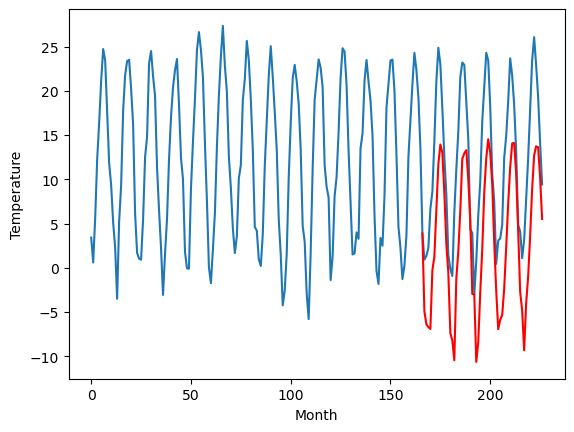

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -4.907688
1                 1    2.22   0.790428
2                 2    2.71  -1.091471
3                 3   -2.86  -0.457755
4                 4    3.31  -1.532258
5                 5   -5.82  -3.853424
6                 6   -6.46  -2.777539
7                 7  -13.16 -16.352178
8                 8    5.28   1.458673
9                 9    0.63   0.930413
10               10   -6.46  -4.905970


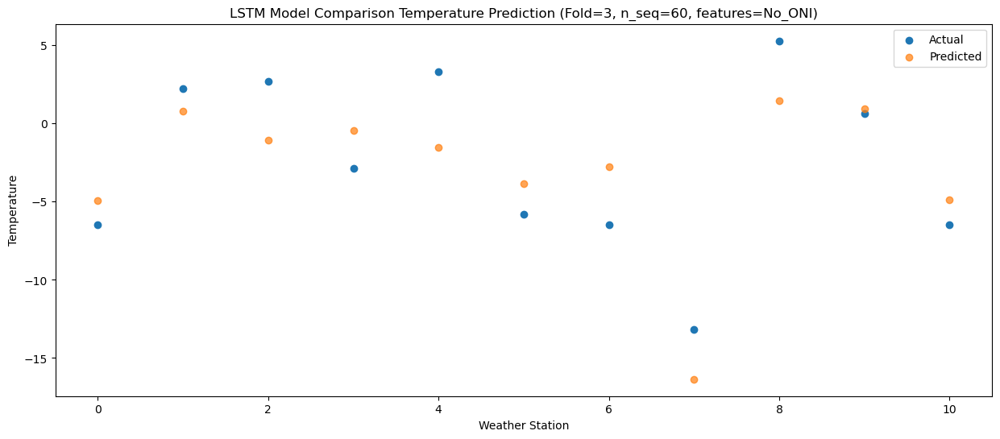

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -6.396233
1                 1    0.87  -0.703946
2                 2    0.18  -2.580146
3                 3   -2.85  -1.951313
4                 4    0.05  -3.030260
5                 5   -5.61  -5.349595
6                 6  -12.13  -4.273896
7                 7  -17.89 -17.842368
8                 8    4.03  -0.034417
9                 9   -2.13  -0.561666
10               10   -9.42  -6.401619


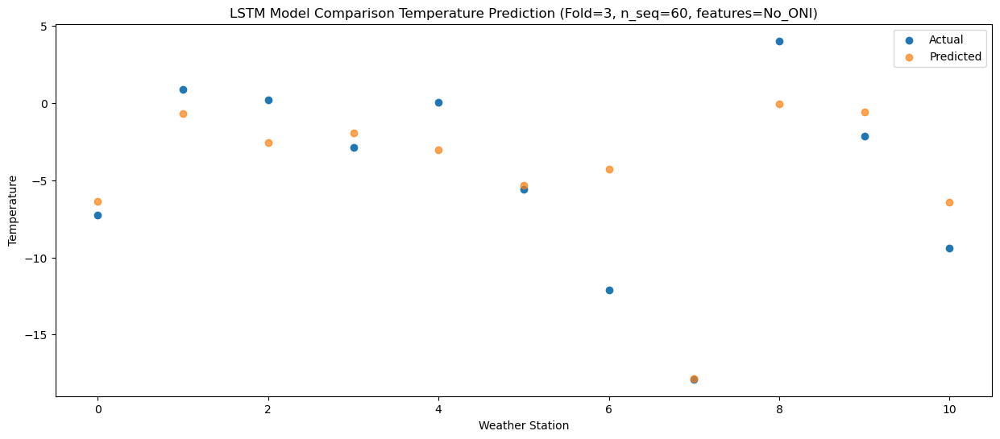

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -6.701639
1                 1    0.03  -1.012645
2                 2   -1.04  -2.872984
3                 3   -3.40  -2.256951
4                 4   -2.82  -3.344499
5                 5   -7.03  -5.670527
6                 6  -12.22  -4.592535
7                 7  -16.73 -18.151119
8                 8    3.40  -0.327350
9                 9   -2.10  -0.865125
10               10   -9.01  -6.711009


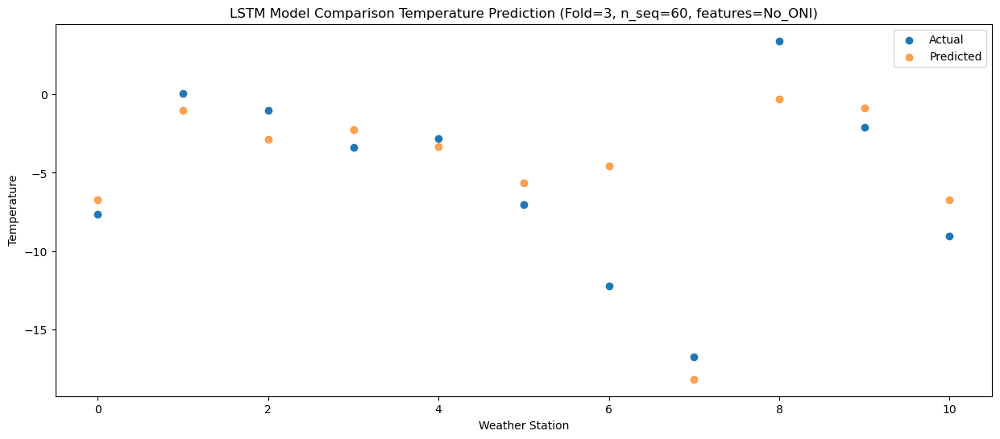

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -6.916643
1                 1    0.18  -1.231480
2                 2    1.38  -3.092782
3                 3   -3.75  -2.469286
4                 4   -1.67  -3.555348
5                 5   -7.44  -5.875858
6                 6  -12.03  -4.799924
7                 7  -15.22 -18.359868
8                 8    5.42  -0.544447
9                 9   -1.66  -1.078812
10               10   -8.09  -6.918861


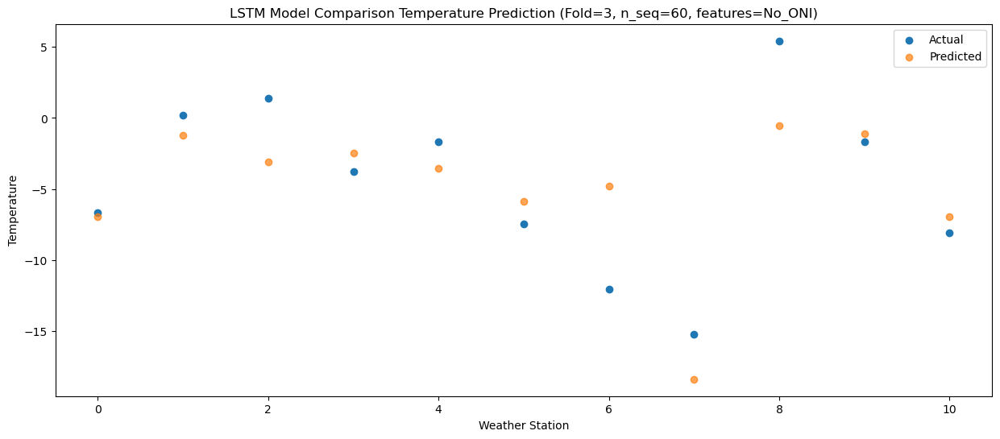

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -0.300988
1                 1    7.67   5.378439
2                 2    3.17   3.507792
3                 3    3.16   4.143396
4                 4    5.74   3.061851
5                 5   -0.58   0.743195
6                 6   -7.10   1.814905
7                 7  -12.11 -11.746371
8                 8    4.86   6.060947
9                 9    1.92   5.539052
10               10   -3.68  -0.298360


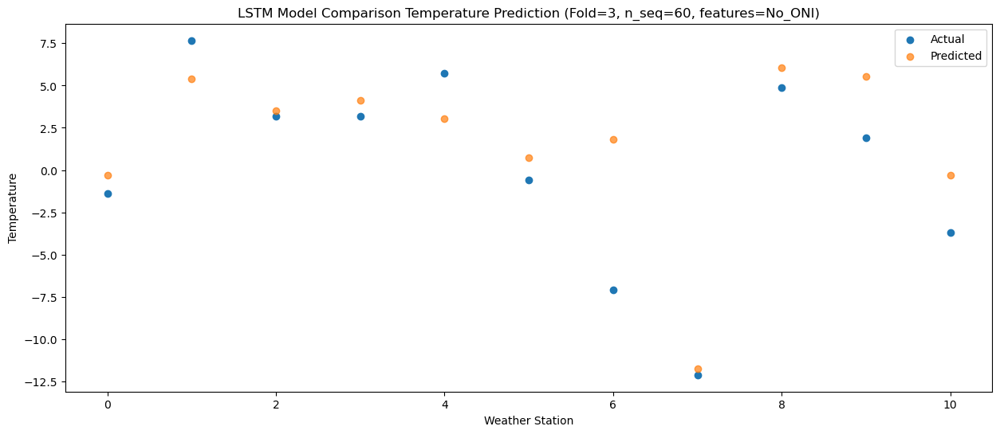

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32   1.258078
1                 1    8.59   6.943810
2                 2    7.83   5.067773
3                 3    3.80   5.707304
4                 4    8.77   4.635151
5                 5    1.69   2.316381
6                 6   -4.12   3.391238
7                 7   -6.20 -10.171161
8                 8    8.48   7.624283
9                 9    3.36   7.112661
10               10   -1.74   1.279039


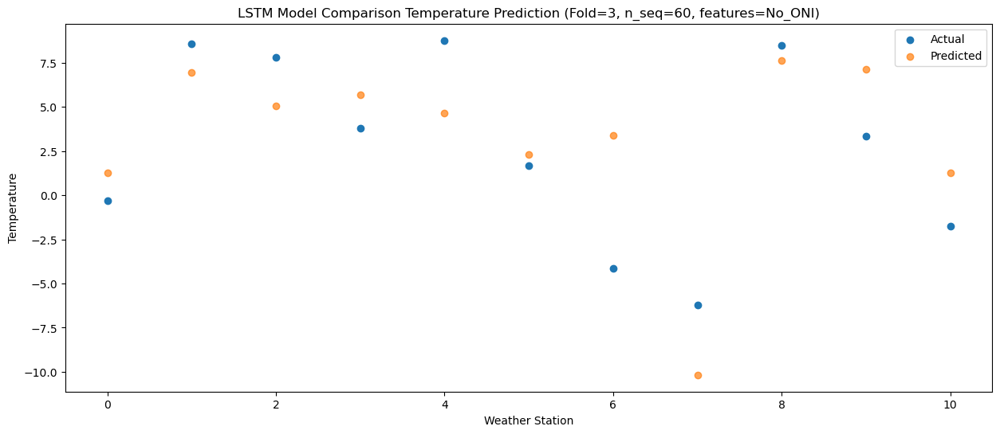

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   6.538296
1                 1   12.99  12.218523
2                 2   13.02  10.345315
3                 3    8.37  10.985023
4                 4   14.84   9.906119
5                 5    7.10   7.587499
6                 6    2.99   8.661390
7                 7    1.07  -4.894491
8                 8   10.88  12.899113
9                 9    8.92  12.392247
10               10    4.03   6.562897


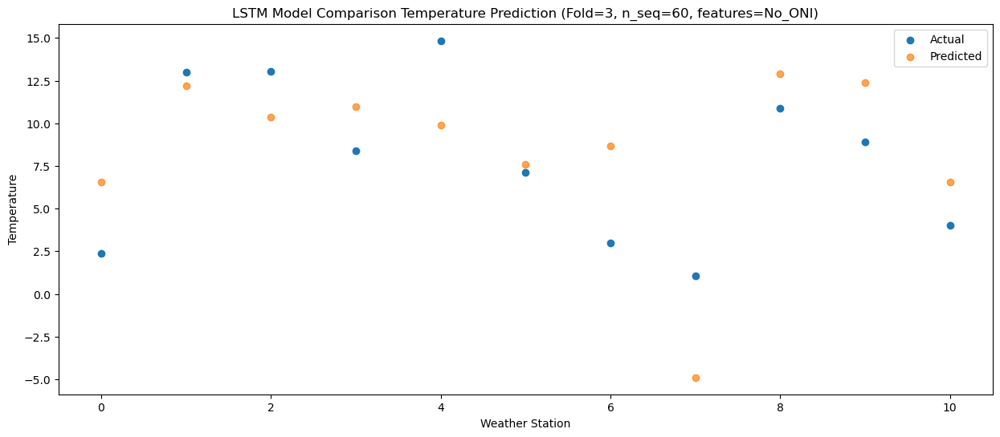

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69  11.676276
1                 1   20.09  17.361552
2                 2   16.37  15.492201
3                 3   14.19  16.120992
4                 4   21.89  15.047949
5                 5   14.09  12.724835
6                 6    7.20  13.800092
7                 7    4.53   0.248562
8                 8   13.42  18.044624
9                 9   15.90  17.532553
10               10   10.75  11.702331


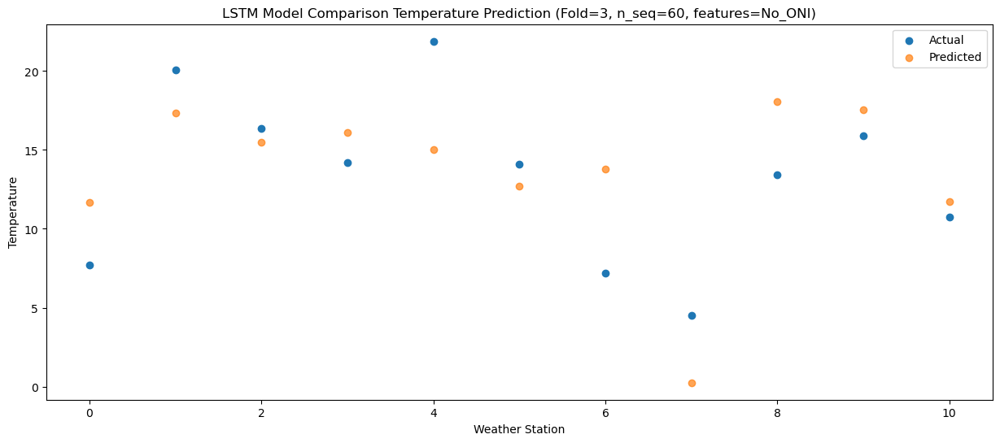

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  13.907678
1                 1   21.95  19.587790
2                 2   19.15  17.723011
3                 3   17.99  18.351331
4                 4   23.35  17.270709
5                 5   15.98  14.949042
6                 6    9.19  16.022095
7                 7    8.76   2.469613
8                 8   12.61  20.261855
9                 9   19.85  19.754473
10               10   14.52  13.928705


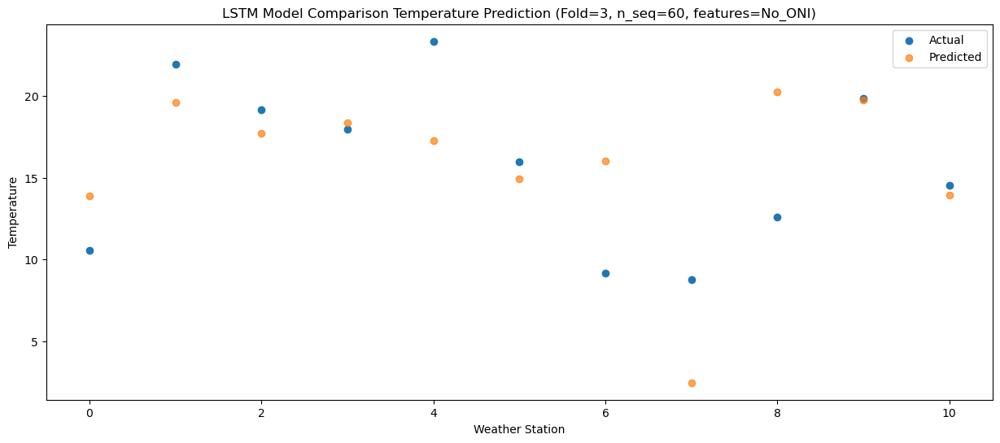

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  12.958400
1                 1   20.09  18.634810
2                 2   19.68  16.777774
3                 3   15.57  17.401784
4                 4   20.79  16.314393
5                 5   13.47  13.990646
6                 6    9.94  15.068093
7                 7    8.87   1.519430
8                 8   14.49  19.316518
9                 9   18.67  18.807185
10               10   12.65  12.983934


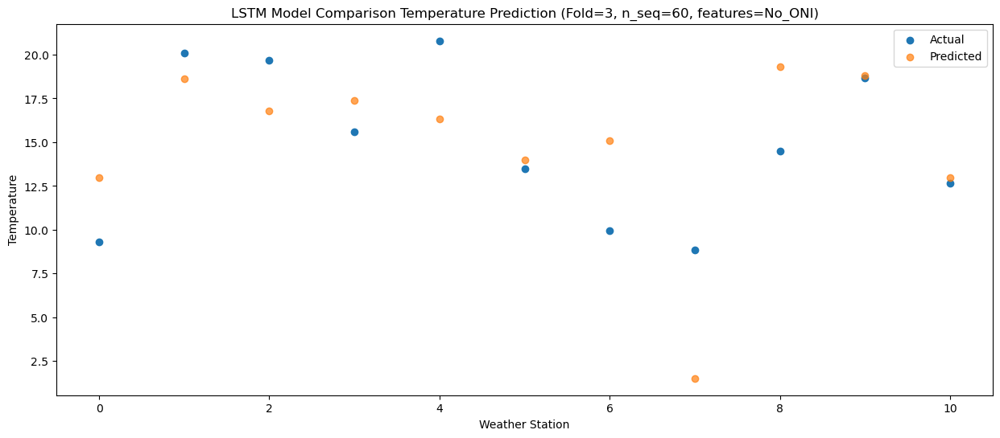

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   8.453794
1                 1   16.42  14.139739
2                 2   15.35  12.280657
3                 3   11.51  12.902554
4                 4   16.72  11.819779
5                 5    9.84   9.497003
6                 6    4.44  10.571785
7                 7    4.06  -2.983792
8                 8   13.91  14.821384
9                 9   14.33  14.303651
10               10    7.68   8.476258


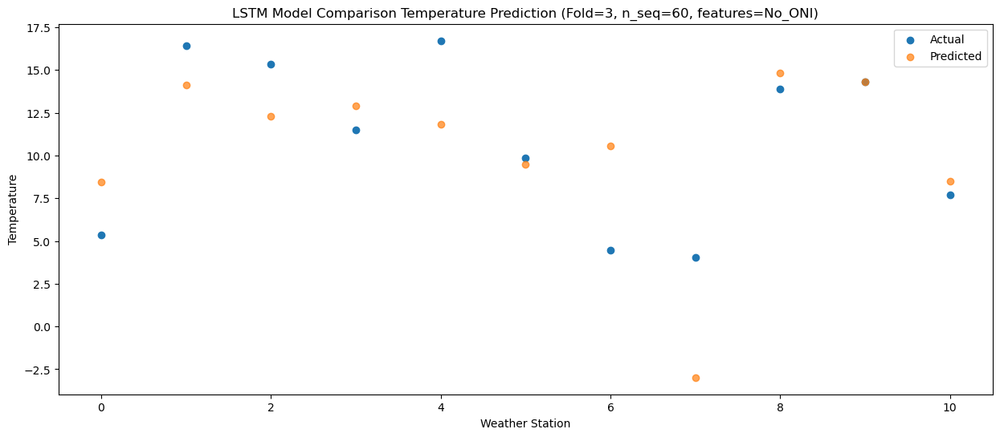

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   2.657477
1                 1    9.31   8.346649
2                 2    9.86   6.488038
3                 3    6.09   7.111009
4                 4    8.99   6.038227
5                 5    3.84   3.716586
6                 6    0.70   4.781002
7                 7   -2.88  -8.779685
8                 8   11.69   9.024578
9                 9    9.01   8.508683
10               10    2.19   2.685159


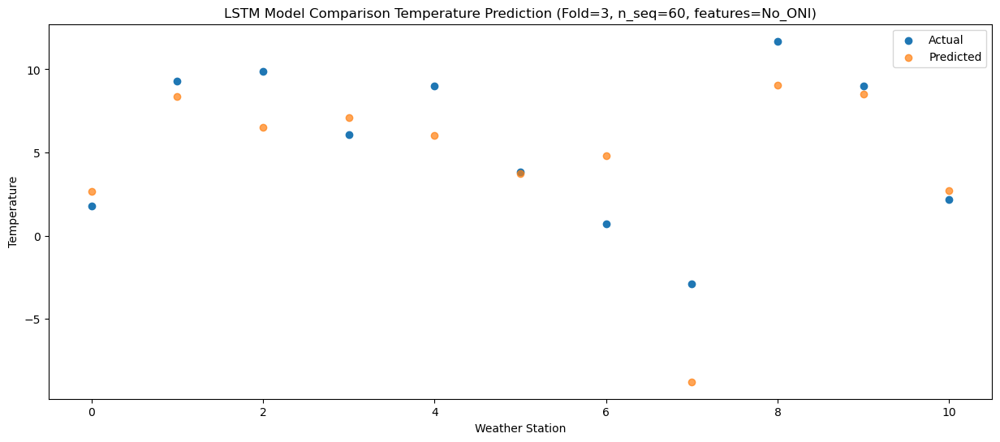

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -0.631316
1                 1    6.49   5.050484
2                 2    1.21   3.189136
3                 3    2.17   3.814590
4                 4    6.17   2.740096
5                 5   -0.10   0.419820
6                 6   -6.49   1.480163
7                 7  -11.69 -12.077216
8                 8    4.53   5.731782
9                 9    4.94   5.212895
10               10   -2.09  -0.618386


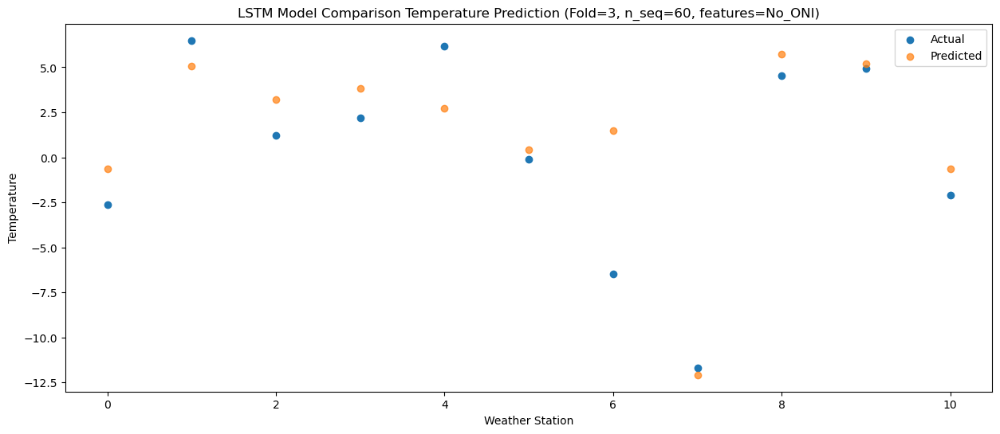

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -7.379054
1                 1   -0.06  -1.698755
2                 2   -1.99  -3.565710
3                 3   -5.03  -2.930666
4                 4   -1.00  -4.004856
5                 5   -7.71  -6.322787
6                 6  -12.19  -5.271564
7                 7  -17.38 -18.829554
8                 8    2.48  -1.027945
9                 9   -1.40  -1.542504
10               10   -8.91  -7.365472


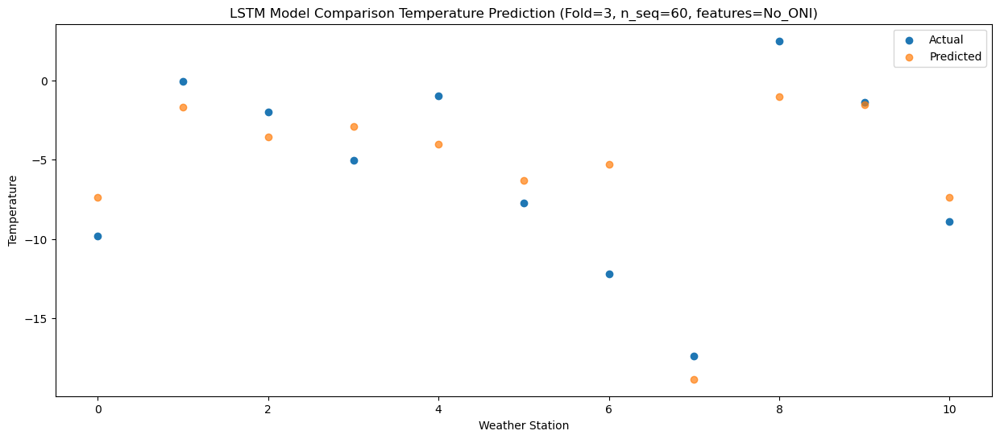

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -8.239405
1                 1   -1.21  -2.560066
2                 2   -0.73  -4.415159
3                 3   -6.49  -3.786971
4                 4   -2.47  -4.865720
5                 5   -9.16  -7.185476
6                 6  -11.92  -6.134690
7                 7  -16.83 -19.685201
8                 8    3.70  -1.871845
9                 9   -4.42  -2.391471
10               10  -10.47  -8.219530


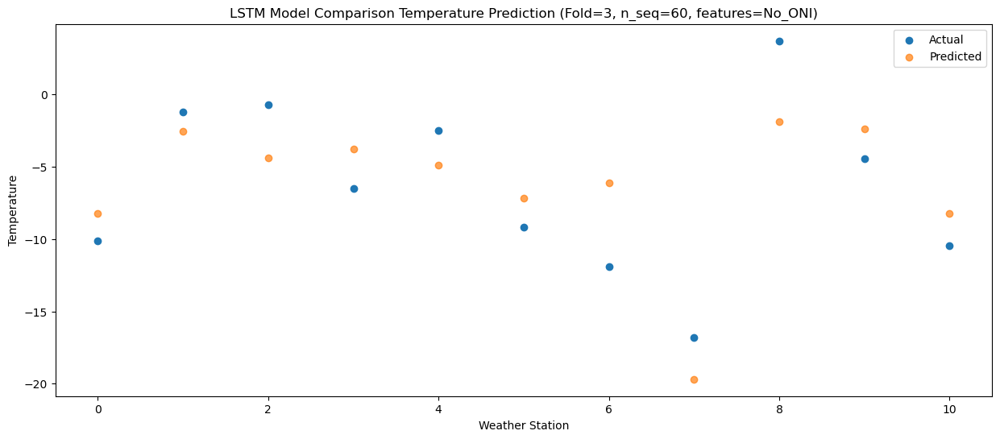

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -10.466355
1                 1   -4.93  -4.792859
2                 2    1.57  -6.653203
3                 3   -7.81  -6.016315
4                 4   -6.34  -7.099161
5                 5  -11.88  -9.421686
6                 6  -11.82  -8.368131
7                 7  -13.98 -21.926140
8                 8    4.63  -4.107595
9                 9   -4.54  -4.628393
10               10  -11.27 -10.457319


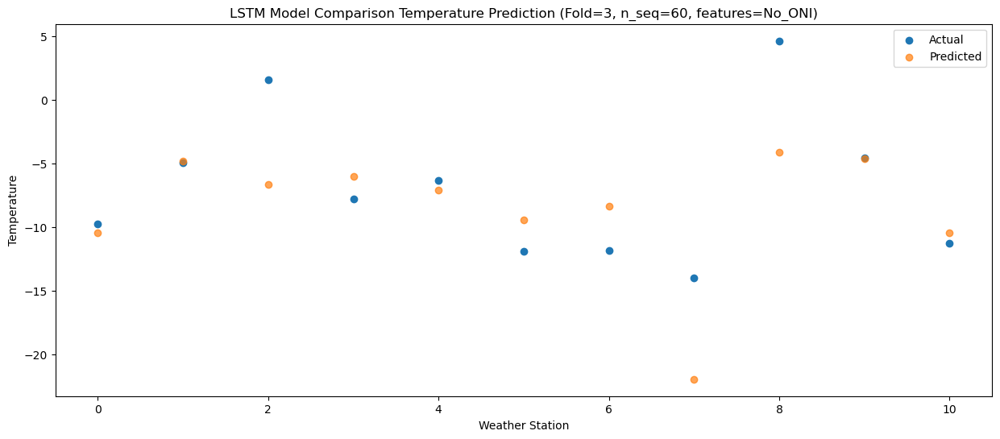

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -1.224839
1                 1    7.04   4.443528
2                 2    2.72   2.585670
3                 3    2.40   3.223354
4                 4    6.74   2.132535
5                 5   -0.55  -0.187988
6                 6   -8.85   0.870851
7                 7  -12.38 -12.694362
8                 8    4.41   5.121882
9                 9    0.46   4.604921
10               10   -4.08  -1.224642


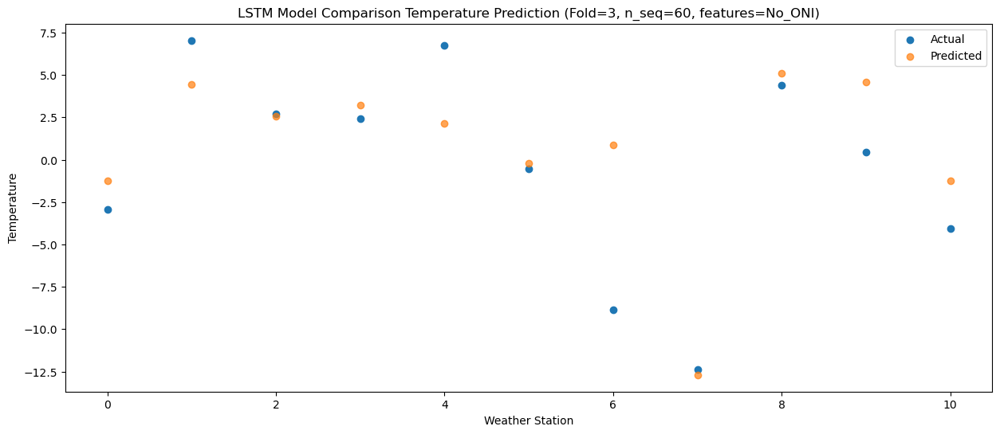

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23   1.858473
1                 1    8.90   7.529229
2                 2    8.45   5.661188
3                 3    4.75   6.305356
4                 4   10.03   5.215643
5                 5    2.90   2.892395
6                 6   -4.07   3.944980
7                 7   -4.41  -9.618592
8                 8    6.60   8.197882
9                 9    5.08   7.684953
10               10    0.79   1.857020


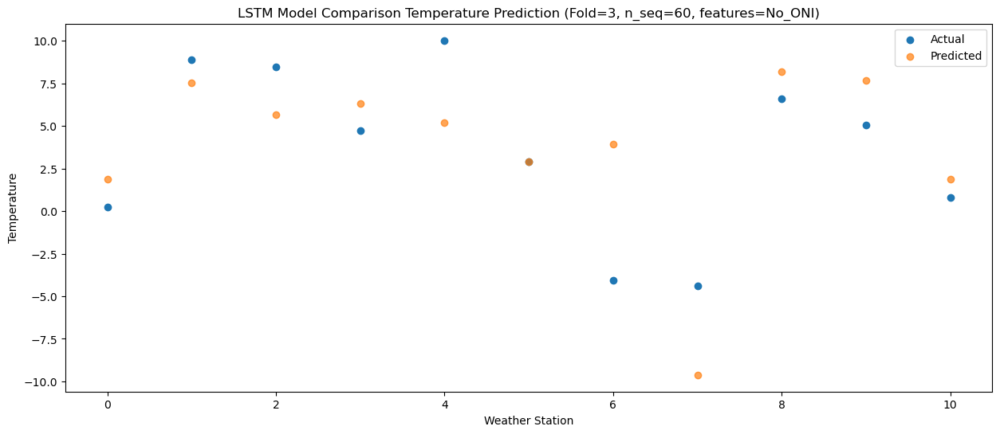

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   6.496480
1                 1   13.12  12.161205
2                 2   13.25  10.283003
3                 3    8.82  10.936570
4                 4   14.60   9.855475
5                 5    7.18   7.533949
6                 6    0.98   8.591481
7                 7    0.02  -4.981924
8                 8   10.89  12.825324
9                 9    9.91  12.316723
10               10    5.05   6.498102


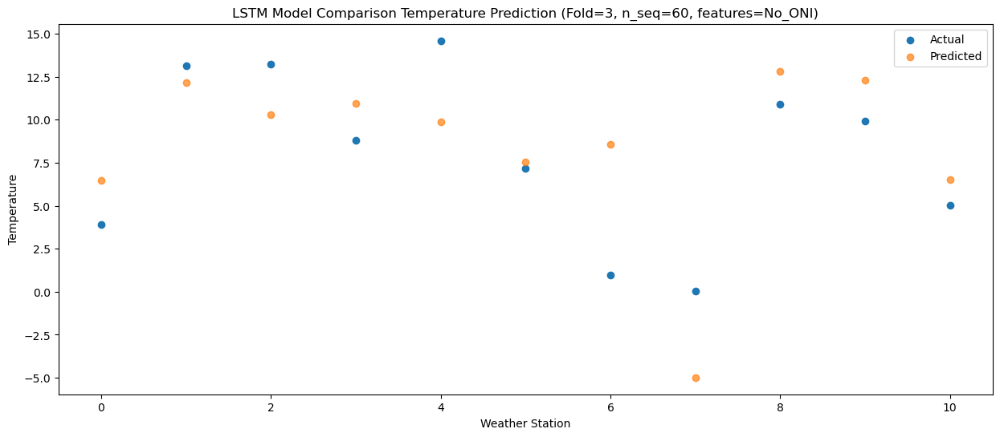

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95  12.310156
1                 1   19.83  17.974800
2                 2   18.10  16.100069
3                 3   14.74  16.751562
4                 4   22.08  15.673912
5                 5   13.89  13.351947
6                 6    8.37  14.409907
7                 7    7.66   0.835352
8                 8   12.59  18.642432
9                 9   15.78  18.136866
10               10   11.22  12.323149


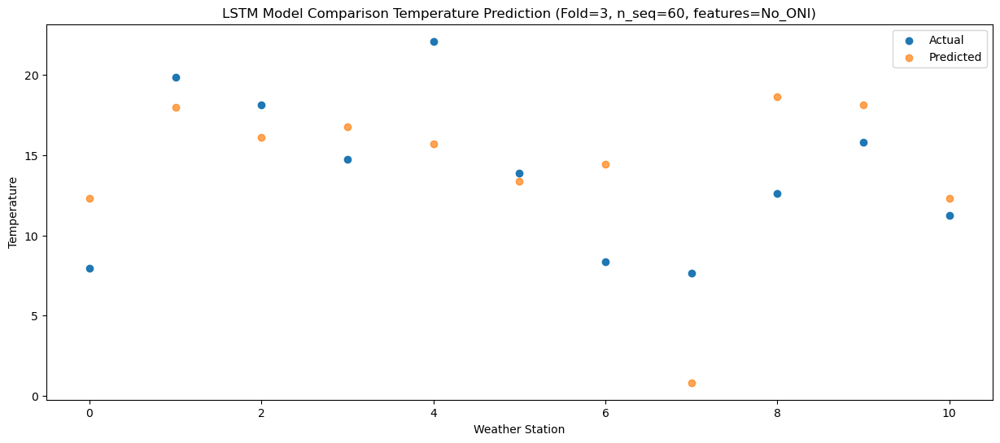

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  12.910259
1                 1   21.14  18.581032
2                 2   21.23  16.695253
3                 3   15.73  17.355154
4                 4   22.08  16.284496
5                 5   14.27  13.962518
6                 6   10.21  15.011891
7                 7    8.74   1.429552
8                 8   11.77  19.228126
9                 9   17.92  18.736451
10               10   12.86  12.928470


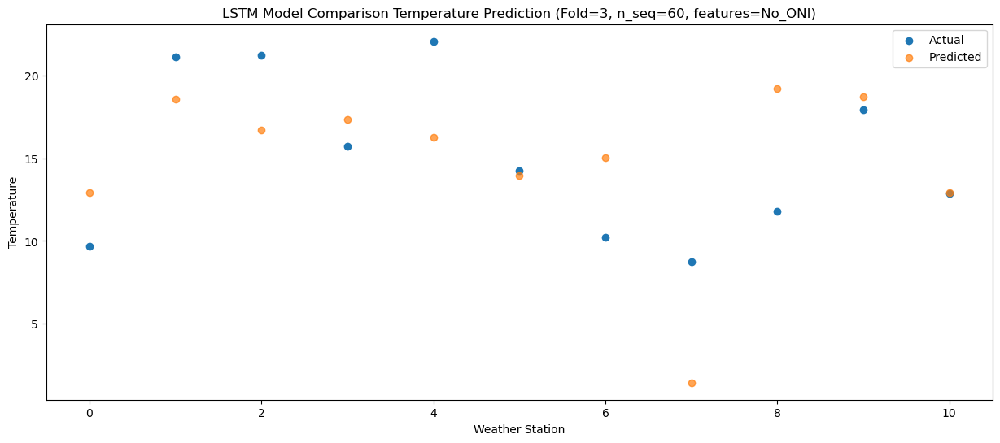

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  13.270468
1                 1   21.71  18.943526
2                 2   19.03  17.067485
3                 3   16.25  17.717222
4                 4   22.20  16.639495
5                 5   14.59  14.314209
6                 6    8.29  15.370368
7                 7    7.51   1.793547
8                 8   12.32  19.599056
9                 9   18.54  19.099004
10               10   12.59  13.288676


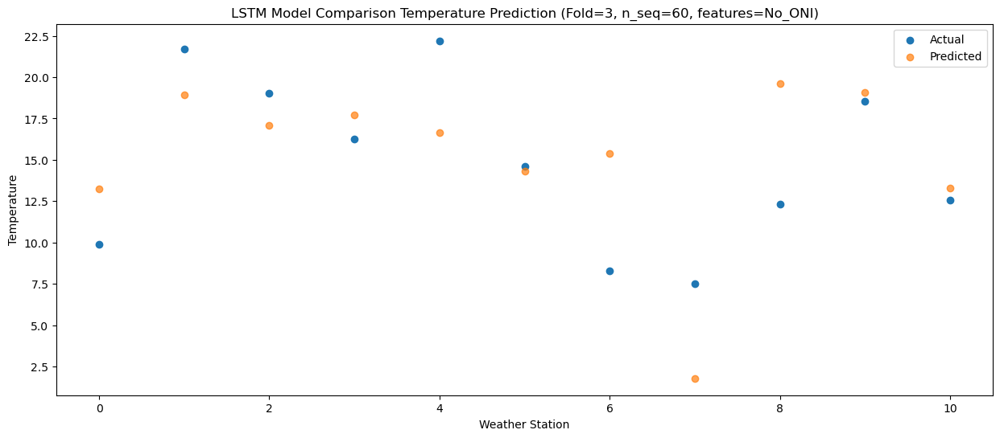

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   9.912694
1                 1   18.98  15.583235
2                 2   15.72  13.705814
3                 3   12.12  14.358380
4                 4   18.84  13.283040
5                 5   11.33  10.958969
6                 6    6.42  12.015897
7                 7    3.54  -1.552201
8                 8   11.77  16.248652
9                 9   15.22  15.746485
10               10    8.33   9.939218


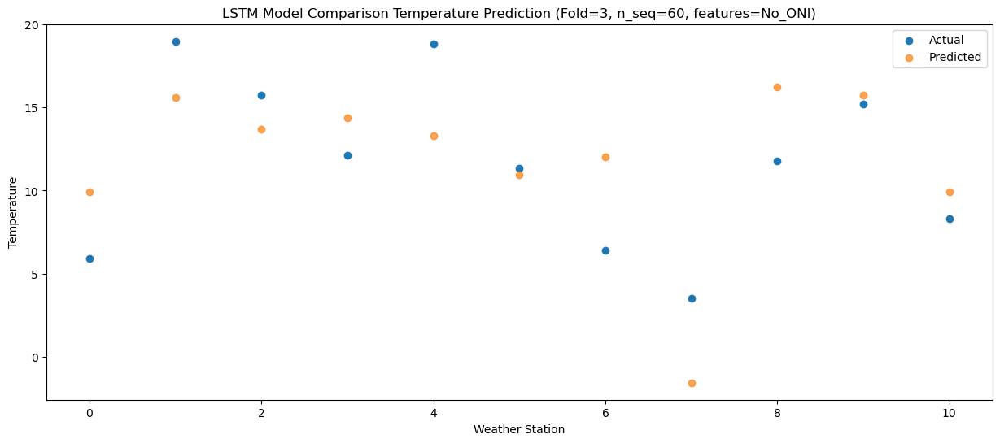

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   5.455470
1                 1   12.38  11.130491
2                 2    7.06   9.247912
3                 3    8.54   9.901795
4                 4   13.42   8.830889
5                 5    6.75   6.508331
6                 6   -1.55   7.561700
7                 7   -6.81  -6.009495
8                 8    9.01  11.787185
9                 9   10.78  11.291866
10               10    4.21   5.483900


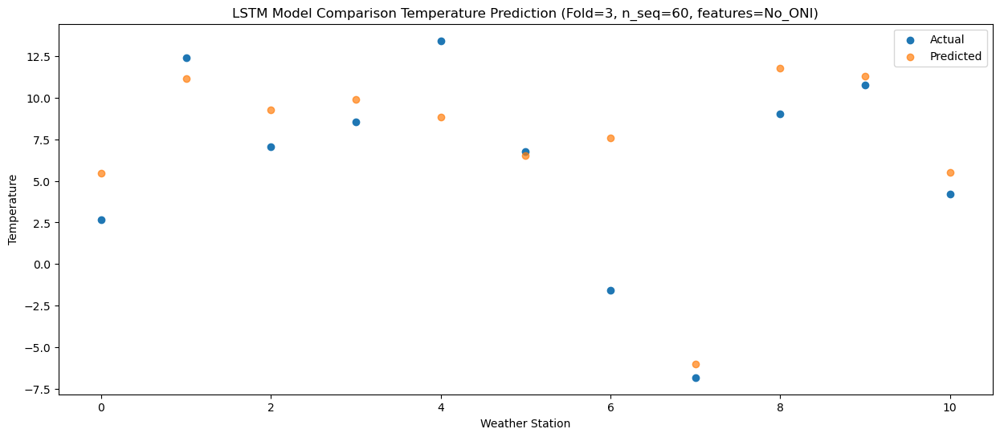

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -2.993691
1                 1    4.67   2.677867
2                 2    2.72   0.792838
3                 3   -1.12   1.452582
4                 4    3.68   0.384325
5                 5   -4.10  -1.936849
6                 6   -4.29  -0.889841
7                 7   -9.33 -14.457942
8                 8    6.19   3.333028
9                 9    1.86   2.843337
10               10   -6.01  -2.962493


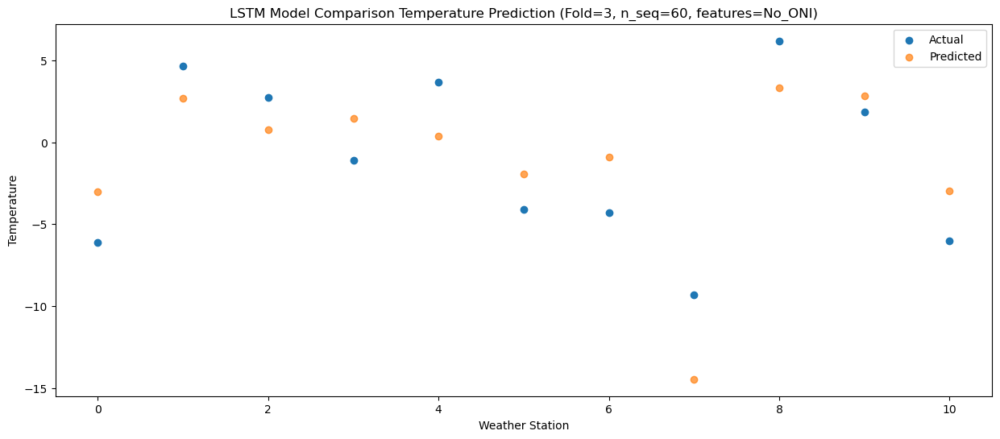

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -3.036915
1                 1    5.98   2.628762
2                 2   -1.20   0.755795
3                 3    0.37   1.410305
4                 4    3.32   0.337107
5                 5   -3.05  -1.983075
6                 6   -9.05  -0.937209
7                 7  -16.60 -14.504618
8                 8    2.49   3.294569
9                 9    0.26   2.802127
10               10   -6.42  -3.005182


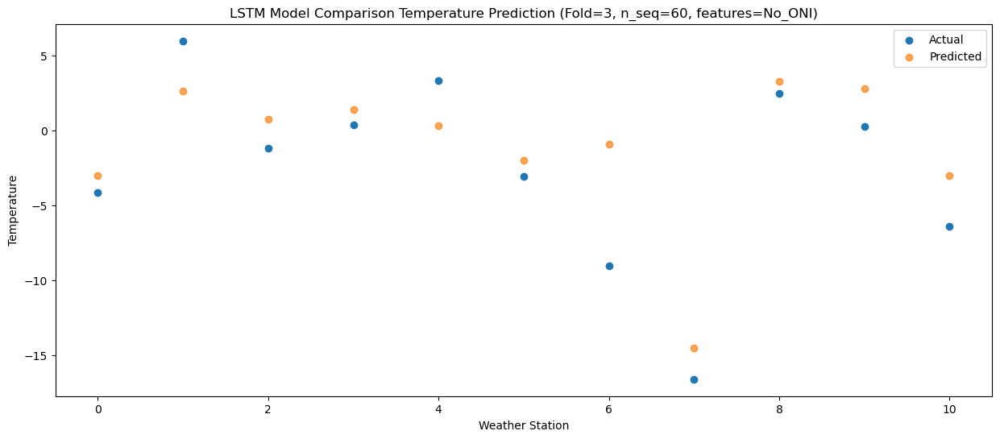

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -10.675762
1                 1   -2.85  -5.007242
2                 2   -1.53  -6.877876
3                 3   -8.58  -6.228100
4                 4   -6.15  -7.293023
5                 5  -11.87  -9.610445
6                 6  -11.34  -8.565809
7                 7  -16.67 -22.142803
8                 8    3.11  -4.337078
9                 9   -6.29  -4.834193
10               10  -13.40 -10.642577


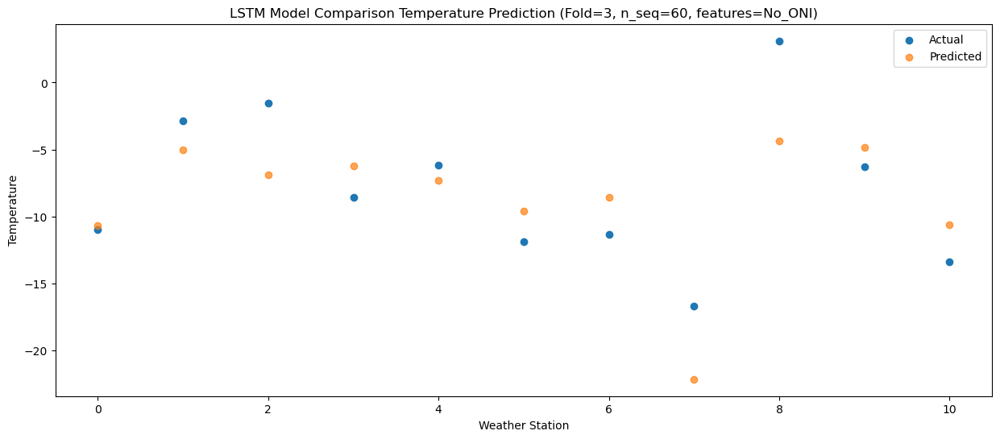

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60  -8.453470
1                 1   -1.63  -2.789526
2                 2    0.17  -4.664604
3                 3   -4.06  -4.010829
4                 4   -3.63  -5.077845
5                 5   -8.68  -7.398399
6                 6  -13.06  -6.353302
7                 7  -14.63 -19.928563
8                 8    4.07  -2.118051
9                 9   -3.53  -2.608096
10               10   -9.59  -8.420132


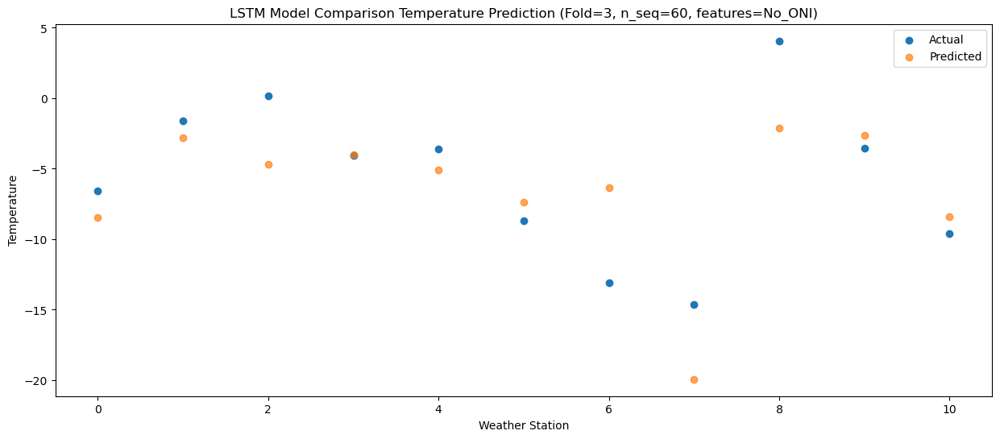

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -2.816069
1                 1    5.15   2.851719
2                 2    4.88   0.968989
3                 3    1.69   1.625117
4                 4    4.83   0.561566
5                 5   -1.72  -1.751204
6                 6   -8.52  -0.703121
7                 7   -9.92 -14.289272
8                 8    6.30   3.515814
9                 9    0.43   3.032213
10               10   -4.41  -2.773358


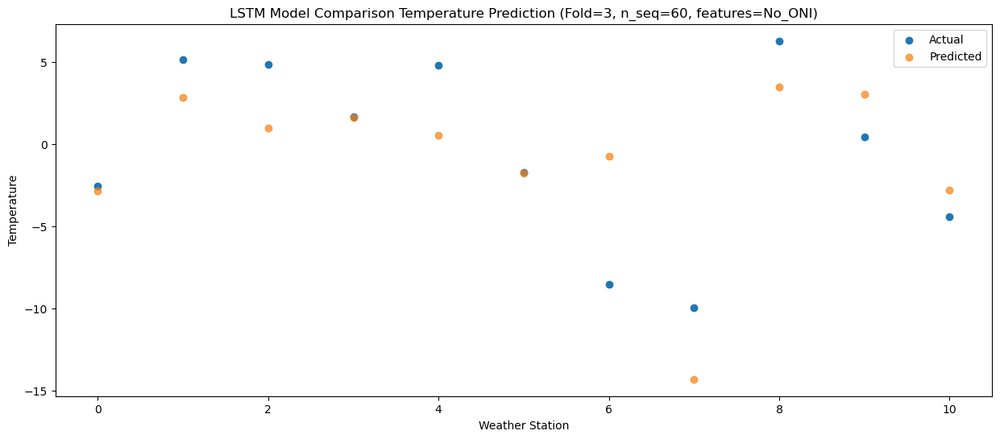

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56   2.081143
1                 1   10.00   7.763446
2                 2    7.95   5.885205
3                 3    4.70   6.529624
4                 4    8.96   5.471372
5                 5    2.13   3.156051
6                 6   -4.20   4.205326
7                 7   -5.29  -9.380816
8                 8    7.74   8.438705
9                 9    4.72   7.940821
10               10   -0.59   2.126350


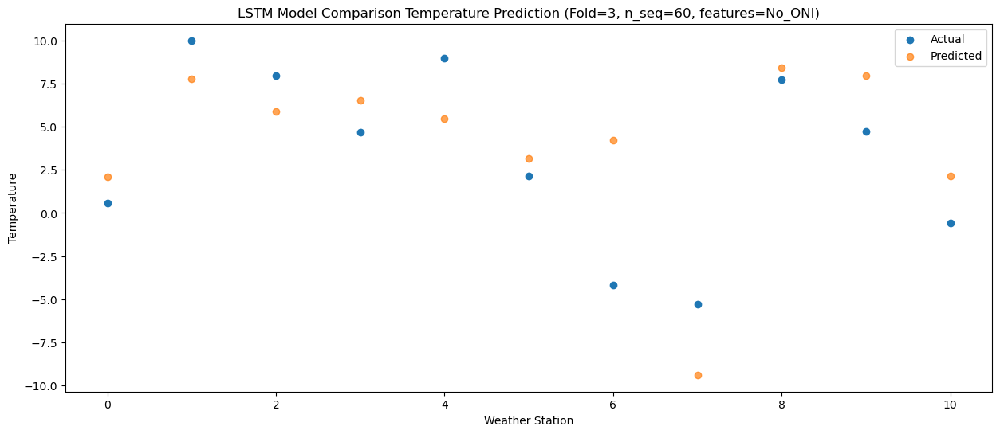

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40   8.467297
1                 1   15.43  14.145118
2                 2   12.19  12.260248
3                 3   11.48  12.921368
4                 4   16.53  11.862844
5                 5    9.93   9.551744
6                 6    1.71  10.587980
7                 7   -0.62  -3.006427
8                 8   10.73  14.809940
9                 9   10.51  14.328117
10               10    6.19   8.518687


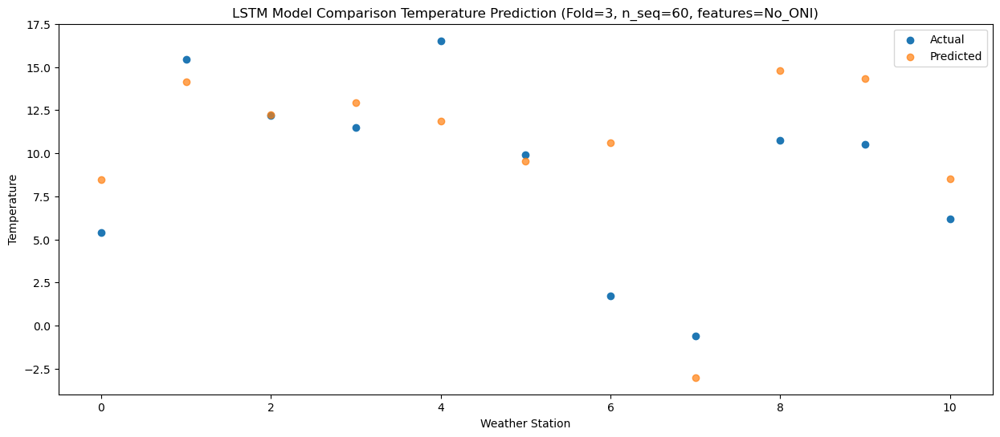

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36  12.320465
1                 1   20.58  17.991989
2                 2   17.58  16.108410
3                 3   14.96  16.772126
4                 4   21.98  15.708139
5                 5   13.87  13.396303
6                 6    7.48  14.436207
7                 7    5.86   0.838715
8                 8   13.88  18.661929
9                 9   14.83  18.173457
10               10   10.18  12.365093


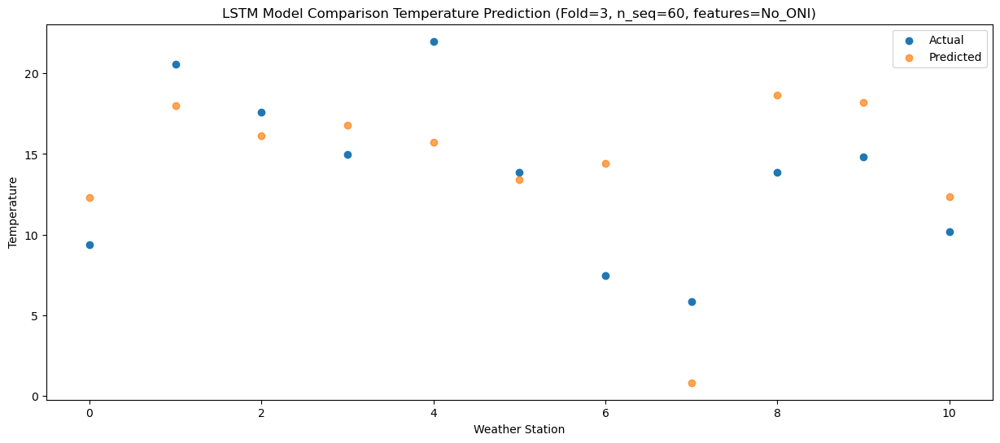

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  14.502646
1                 1   24.62  20.174322
2                 2   20.15  18.289609
3                 3   16.51  18.956216
4                 4   23.10  17.889189
5                 5   15.86  15.577519
6                 6    9.40  16.606374
7                 7    8.09   3.003009
8                 8   12.23  20.833070
9                 9   19.38  20.341643
10               10   13.96  14.527580


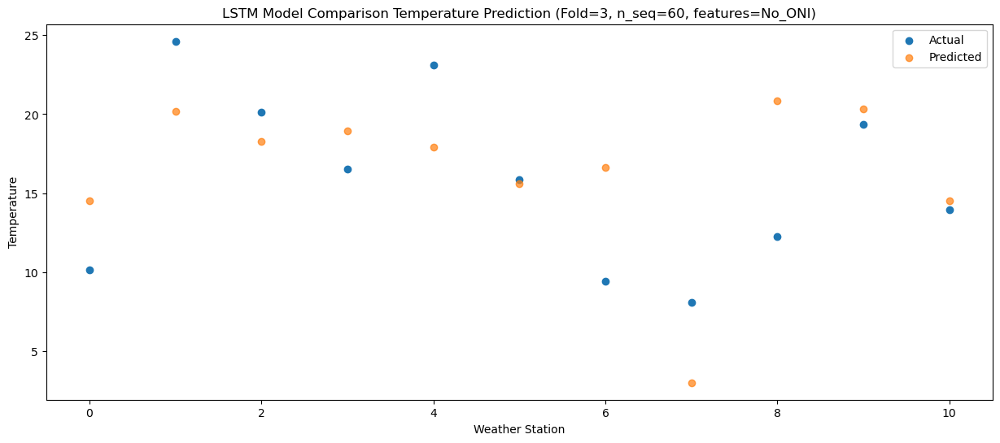

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22  12.988538
1                 1   21.54  18.654716
2                 2   20.33  16.776687
3                 3   15.44  17.440724
4                 4   21.28  16.361929
5                 5   14.21  14.053377
6                 6    8.64  15.073886
7                 7    6.50   1.477356
8                 8   13.65  19.313186
9                 9   19.30  18.826975
10               10   13.09  13.018637


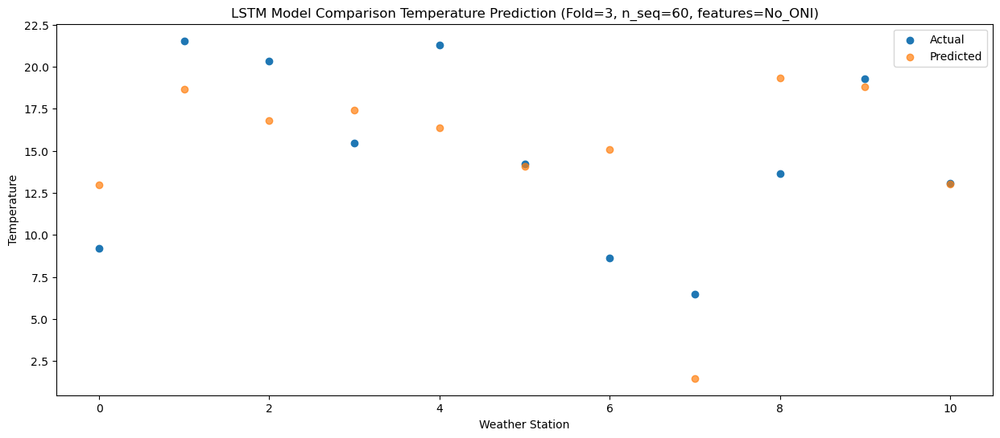

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01   9.457308
1                 1   17.68  15.123822
2                 2   17.51  13.242874
3                 3   11.46  13.903148
4                 4   16.96  12.829785
5                 5   10.26  10.520153
6                 6    6.48  11.542828
7                 7    4.14  -2.052696
8                 8   13.88  15.782746
9                 9   14.39  15.283814
10               10    7.86   9.477738


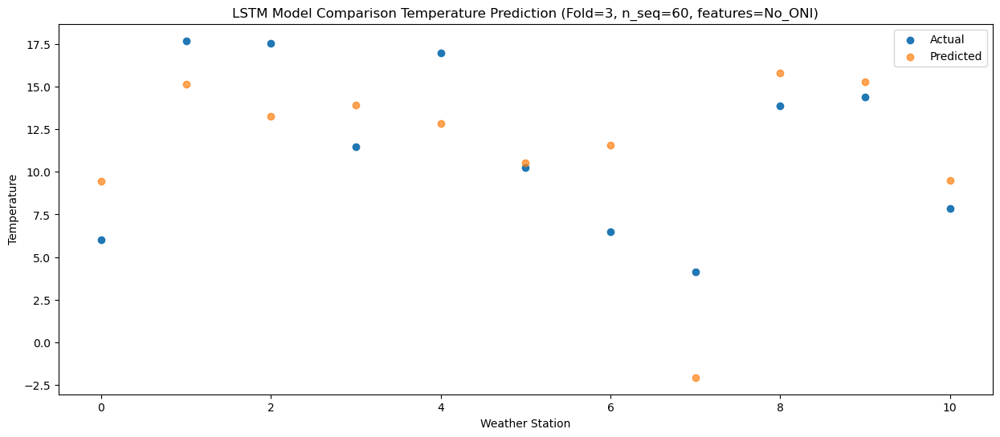

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00   2.845139
1                 1   11.13   8.504196
2                 2   10.33   6.628830
3                 3    4.19   7.287555
4                 4    9.69   6.212061
5                 5    4.22   3.902394
6                 6   -1.78   4.924621
7                 7   -3.75  -8.665629
8                 8    9.15   9.178376
9                 9    8.13   8.674678
10               10    0.25   2.862562


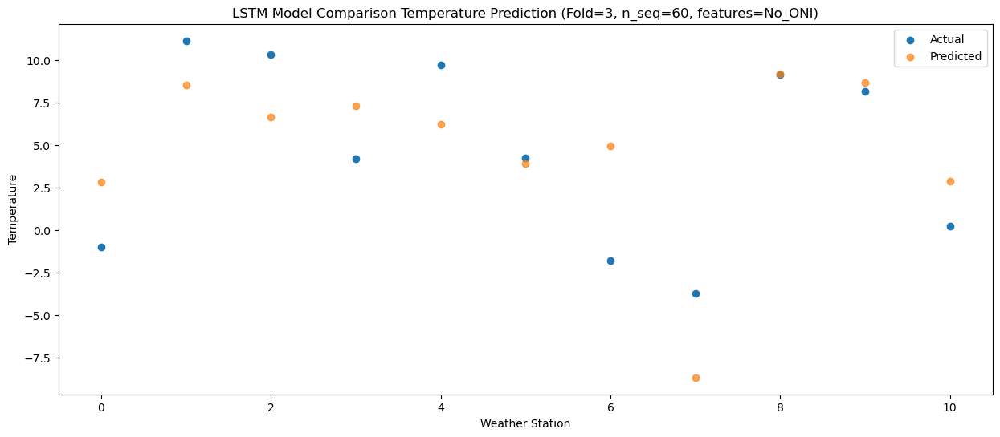

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -2.631745
1                 1    3.90   3.021487
2                 2   -0.40   1.143732
3                 3    1.07   1.809047
4                 4    3.80   0.730285
5                 5   -2.33  -1.580065
6                 6   -9.46  -0.553234
7                 7  -15.17 -14.148753
8                 8    3.42   3.699797
9                 9    4.17   3.202664
10               10   -2.87  -2.601637


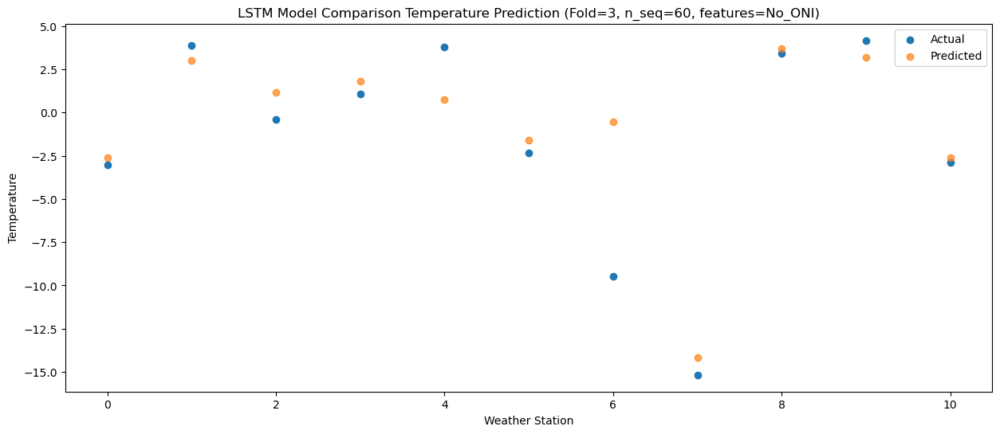

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91  -6.959542
1                 1   -0.15  -1.301180
2                 2   -1.36  -3.177958
3                 3   -4.20  -2.509939
4                 4   -2.17  -3.588117
5                 5   -7.87  -5.900663
6                 6  -11.63  -4.878904
7                 7  -17.50 -18.485122
8                 8    2.22  -0.638457
9                 9   -2.19  -1.133044
10               10   -9.90  -6.936203


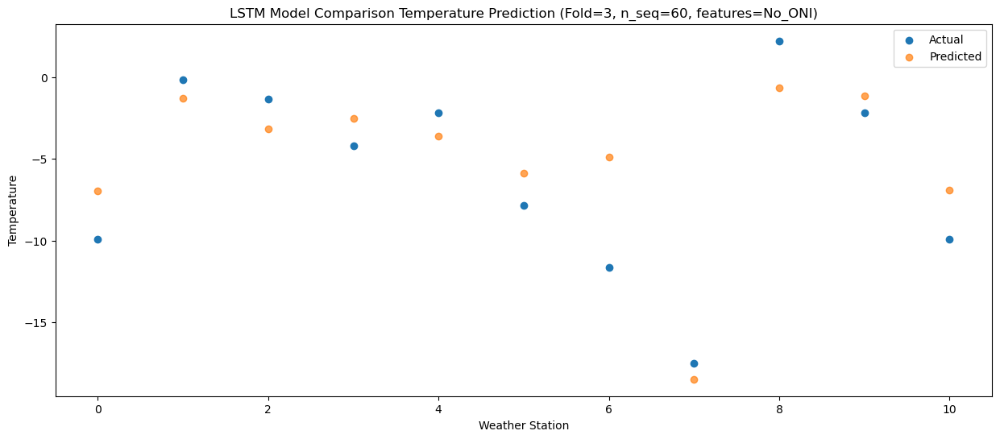

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49  -5.905415
1                 1    0.55  -0.240342
2                 2    0.03  -2.121336
3                 3   -2.45  -1.451866
4                 4   -0.45  -2.532780
5                 5   -5.73  -4.843058
6                 6  -12.36  -3.822472
7                 7  -18.01 -17.430415
8                 8    3.89   0.417889
9                 9   -0.21  -0.073821
10               10   -7.25  -5.880400


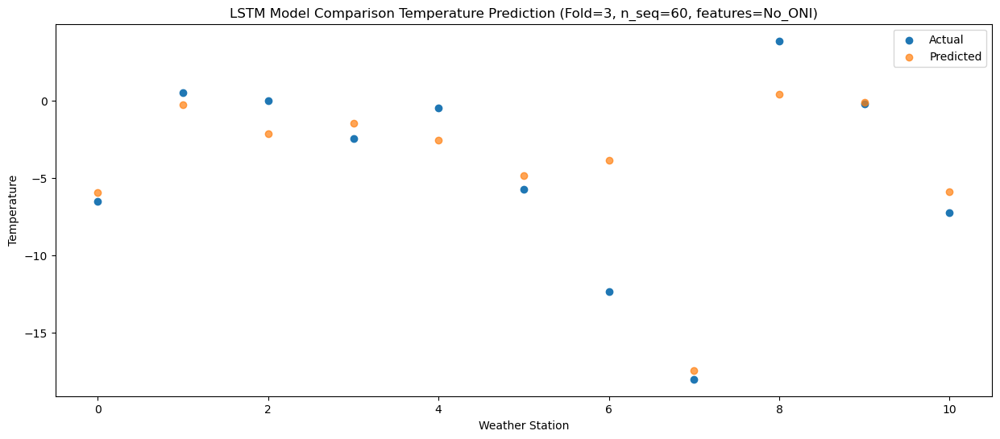

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -5.356342
1                 1    2.51   0.298527
2                 2   -0.82  -1.591576
3                 3   -0.11  -0.909345
4                 4    6.07  -1.998802
5                 5   -4.01  -4.304821
6                 6  -12.33  -3.291627
7                 7  -17.10 -16.909640
8                 8    2.09   0.939750
9                 9   -1.94   0.458509
10               10   -7.04  -5.342027


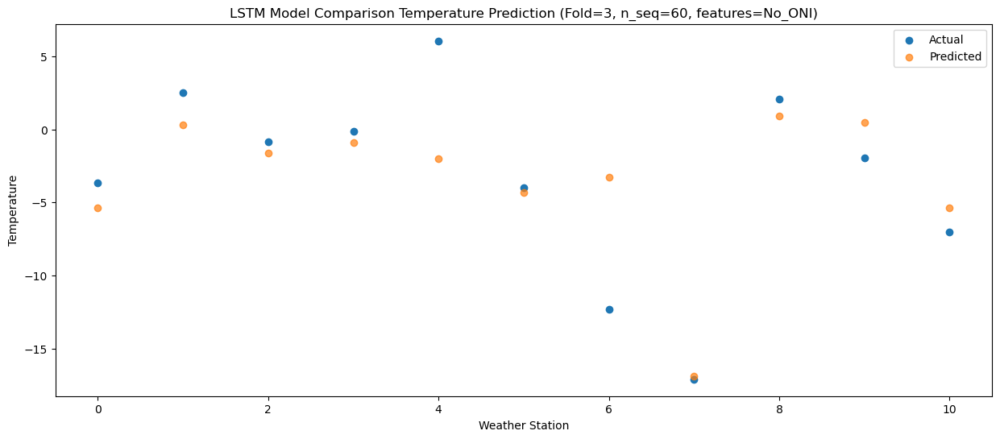

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -2.361926
1                 1    5.11   3.307459
2                 2    2.05   1.416584
3                 3    0.13   2.098757
4                 4    3.11   1.020922
5                 5   -3.11  -1.284929
6                 6  -10.54  -0.269442
7                 7  -14.27 -13.888577
8                 8    3.55   3.956776
9                 9    0.03   3.462486
10               10   -5.48  -2.341242


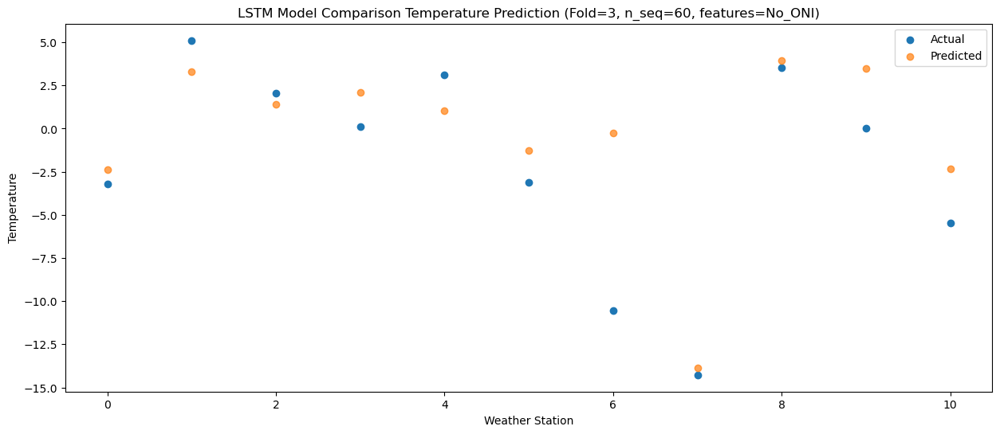

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47   2.299397
1                 1   10.16   7.975325
2                 2    7.68   6.084000
3                 3    6.37   6.762166
4                 4   10.32   5.689559
5                 5    3.12   3.380506
6                 6   -5.20   4.402094
7                 7   -6.32  -9.224045
8                 8    7.63   8.621627
9                 9    6.08   8.127352
10               10    2.09   2.322032


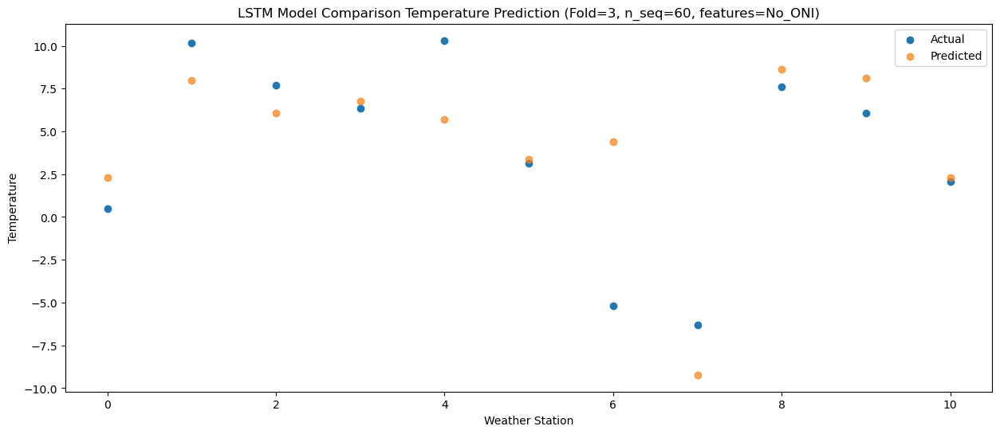

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83   7.270850
1                 1   15.47  12.953280
2                 2   12.12  11.047767
3                 3    9.06  11.734729
4                 4   16.32  10.670814
5                 5    8.53   8.366189
6                 6    2.01   9.378675
7                 7   -0.52  -4.252805
8                 8    8.66  13.587497
9                 9    9.72  13.093086
10               10    4.56   7.291298


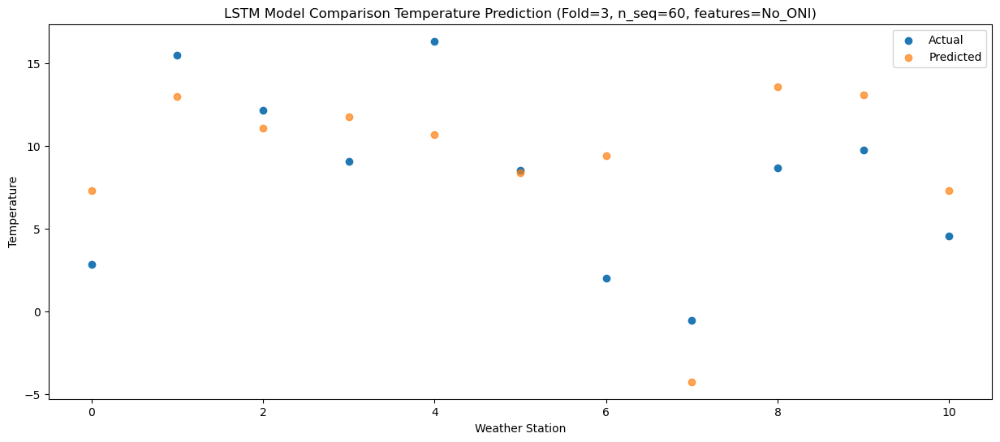

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60  11.344550
1                 1   19.80  17.034120
2                 2   14.92  15.116298
3                 3   12.80  15.804383
4                 4   20.42  14.749250
5                 5   11.99  12.446809
6                 6    6.59  13.454026
7                 7    1.98  -0.184966
8                 8   10.56  17.654060
9                 9   13.71  17.158607
10               10    8.49  11.354015


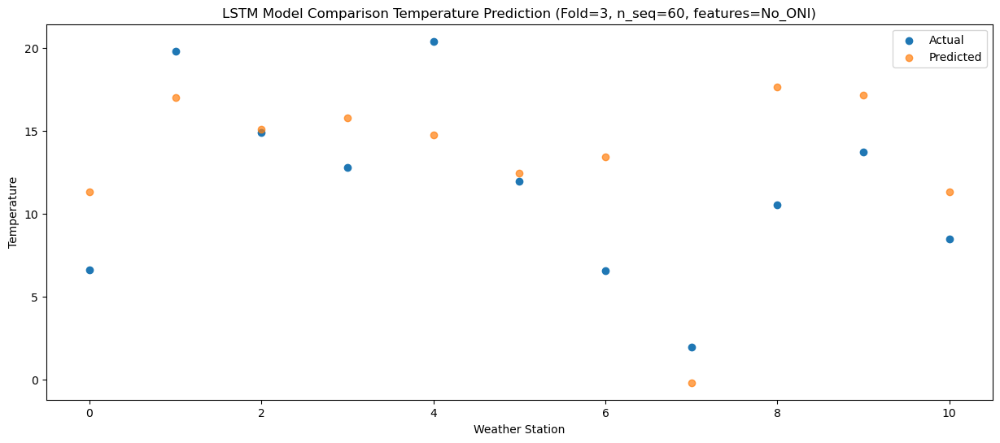

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  14.043506
1                 1   22.06  19.736330
2                 2   20.58  17.812371
3                 3   16.42  18.502303
4                 4   22.12  17.457334
5                 5   15.25  15.157992
6                 6   12.73  16.159755
7                 7   10.34   2.514385
8                 8   13.57  20.354310
9                 9   19.39  19.863630
10               10   13.33  14.056740


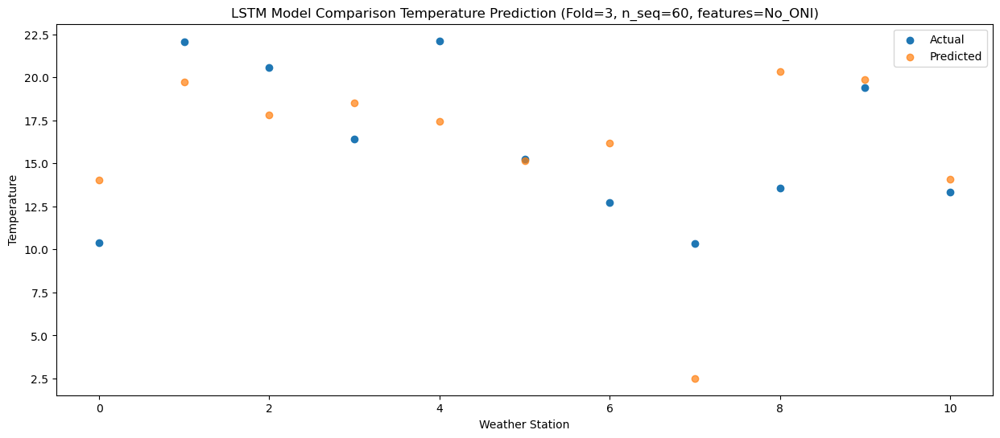

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  14.089938
1                 1   22.24  19.787660
2                 2   18.89  17.868353
3                 3   15.31  18.546787
4                 4   20.83  17.505288
5                 5   13.70  15.200736
6                 6   10.14  16.210632
7                 7    5.71   2.577808
8                 8   14.60  20.418006
9                 9   17.14  19.916976
10               10   11.36  14.103061


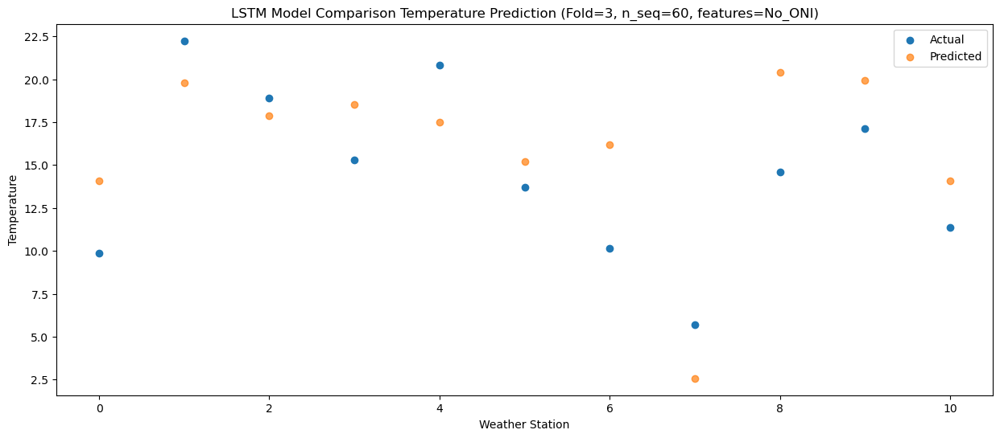

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73  10.664405
1                 1   18.19  16.365607
2                 2   15.12  14.436455
3                 3   12.58  15.123431
4                 4   17.47  14.085124
5                 5   10.24  11.778422
6                 6    5.99  12.787733
7                 7    1.01  -0.845644
8                 8   11.99  16.989855
9                 9   14.57  16.493478
10               10    8.07  10.680431


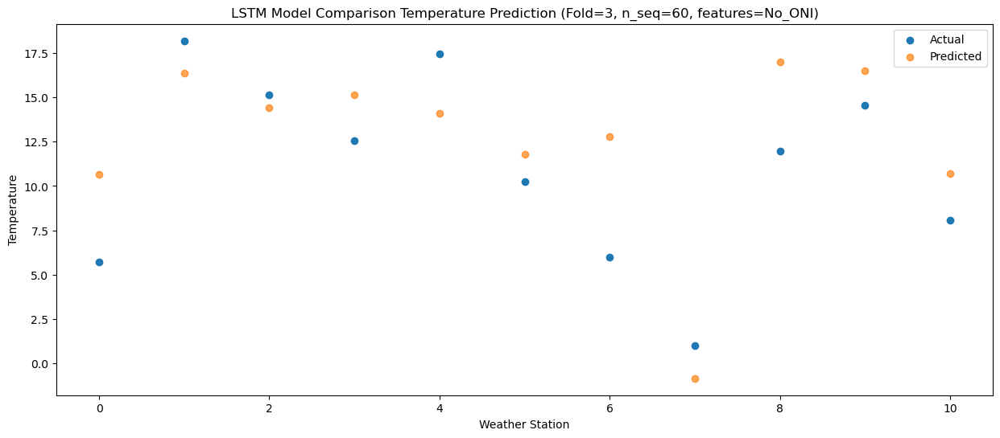

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70   4.184680
1                 1   11.25   9.880201
2                 2    9.81   7.952295
3                 3    7.14   8.642022
4                 4   11.01   7.604361
5                 5    4.59   5.299156
6                 6   -0.14   6.310714
7                 7   -4.28  -7.324148
8                 8   10.53  10.502662
9                 9    9.14  10.005620
10               10    2.78   4.190066


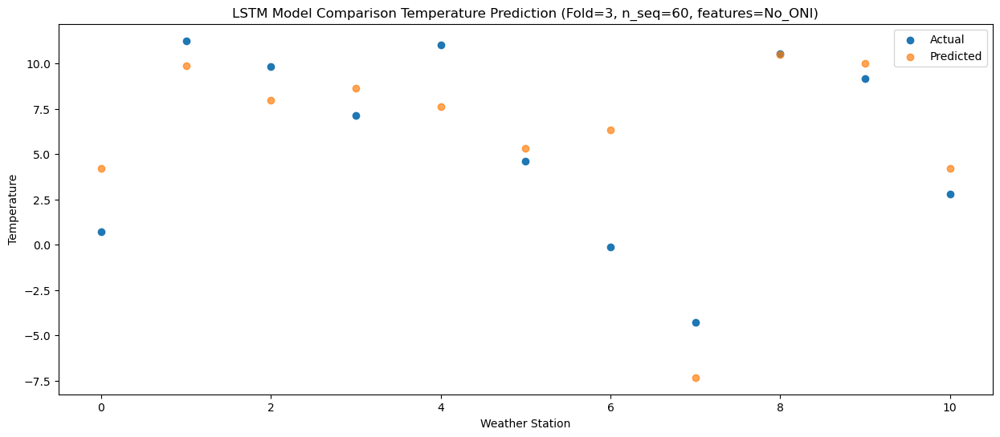

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  -2.707063
1                 1    5.47   2.985343
2                 2    2.90   1.051248
3                 3    0.75   1.751828
4                 4    4.06   0.717062
5                 5   -1.89  -1.585446
6                 6   -6.00  -0.565915
7                 7  -12.42 -14.206731
8                 8    6.49   3.611817
9                 9    1.29   3.115860
10               10   -5.49  -2.700279


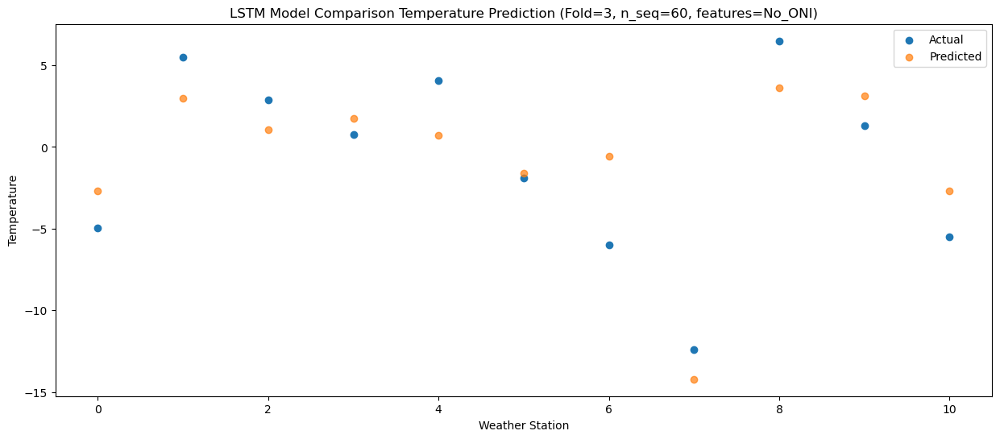

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01  -4.838729
1                 1    2.12   0.851755
2                 2    1.06  -1.086137
3                 3   -1.08  -0.381633
4                 4    1.25  -1.415583
5                 5   -4.35  -3.718089
6                 6   -9.63  -2.700630
7                 7  -15.55 -16.340022
8                 8    4.65   1.475563
9                 9    0.56   0.982579
10               10   -6.24  -4.833123


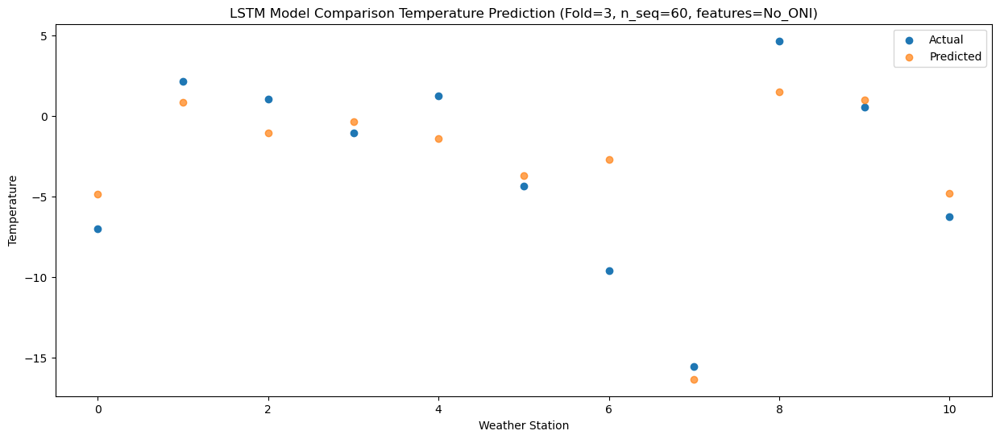

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32  -9.333048
1                 1   -4.49  -3.632884
2                 2    0.85  -5.572191
3                 3   -6.24  -4.872809
4                 4   -5.25  -5.905479
5                 5  -10.51  -8.210166
6                 6  -11.77  -7.200063
7                 7  -17.27 -20.833523
8                 8    4.96  -3.018499
9                 9   -3.43  -3.509344
10               10   -9.26  -9.327502


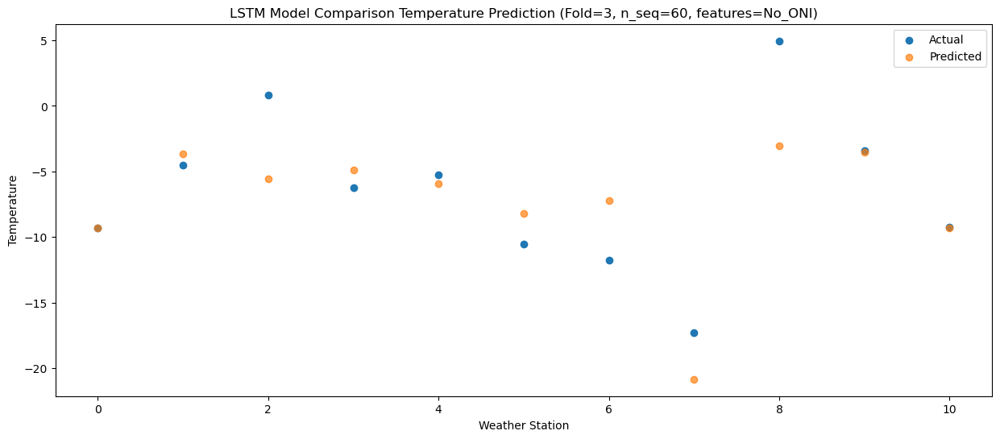

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18  -4.065362
1                 1    5.16   1.641492
2                 2    2.34  -0.302449
3                 3   -0.56   0.394909
4                 4    2.56  -0.637156
5                 5   -3.88  -2.938646
6                 6   -9.61  -1.925739
7                 7  -14.91 -15.562812
8                 8    4.67   2.251919
9                 9   -2.86   1.758194
10               10   -7.22  -4.056774


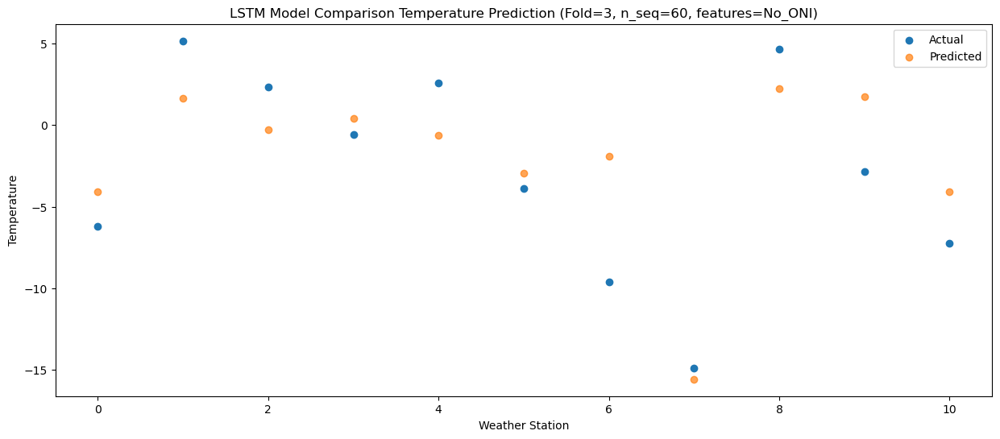

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51  -1.022051
1                 1    7.64   4.698469
2                 2    4.37   2.753185
3                 3    3.09   3.446082
4                 4    6.67   2.427570
5                 5    0.19   0.121245
6                 6   -7.87   1.137066
7                 7  -11.55 -12.499011
8                 8    5.60   5.311247
9                 9    1.84   4.808955
10               10   -2.56  -1.002363


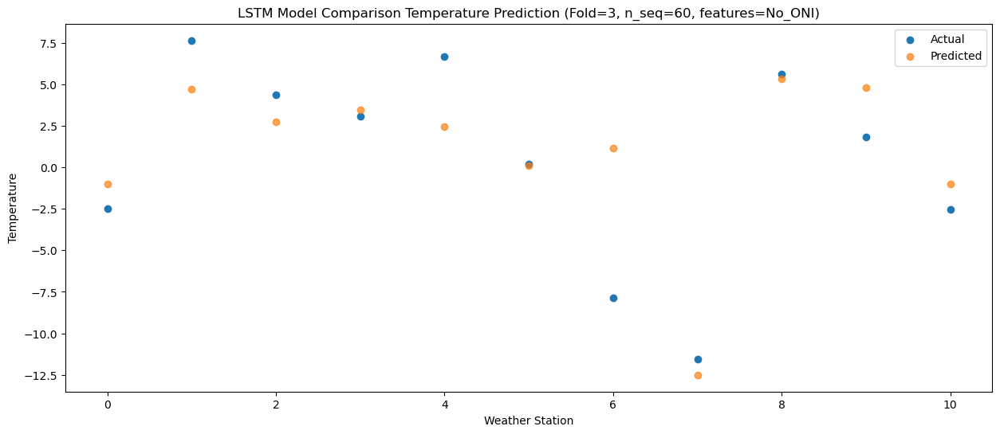

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51   3.530672
1                 1   11.81   9.249939
2                 2    7.56   7.293376
3                 3    8.15   8.003517
4                 4   11.42   6.987294
5                 5    5.16   4.682037
6                 6   -2.89   5.687197
7                 7   -6.05  -7.951729
8                 8    7.83   9.848673
9                 9    4.71   9.357917
10               10    2.02   3.559161


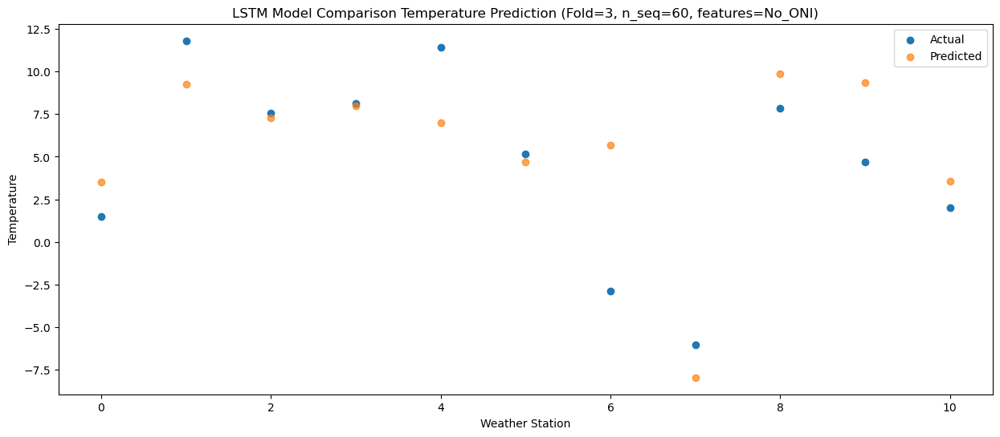

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78   8.832974
1                 1   16.58  14.549961
2                 2   12.95  12.578889
3                 3   12.34  13.305488
4                 4   17.58  12.301375
5                 5   10.68   9.998405
6                 6    0.22  10.996892
7                 7   -0.42  -2.653823
8                 8   10.80  15.130812
9                 9   10.26  14.647210
10               10    7.69   8.856085


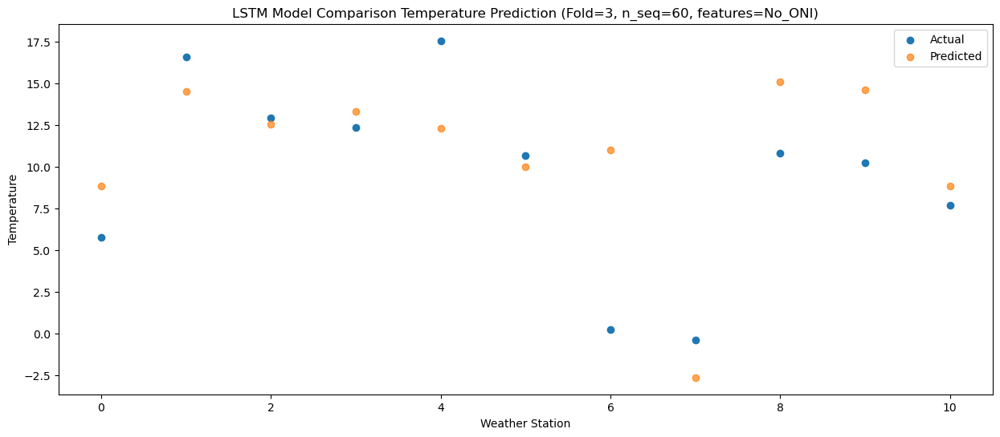

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  12.683997
1                 1   21.14  18.403310
2                 2   18.90  16.423648
3                 3   16.24  17.154019
4                 4   22.45  16.159444
5                 5   13.91  13.856646
6                 6    9.37  14.855176
7                 7    7.76   1.195559
8                 8   13.71  18.981887
9                 9   16.73  18.494883
10               10   13.06  12.705737


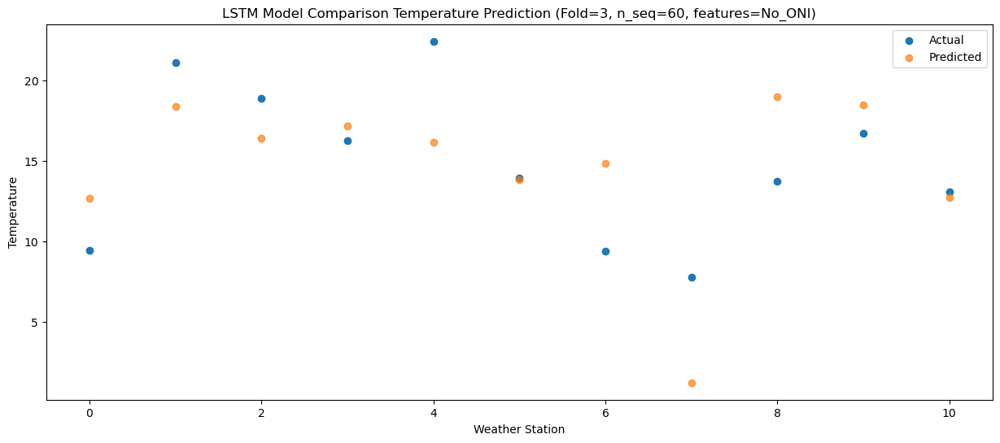

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  13.699280
1                 1   21.66  19.418026
2                 2   22.47  17.444368
3                 3   17.95  18.169925
4                 4   21.61  17.176413
5                 5   14.46  14.871599
6                 6   10.12  15.868533
7                 7   10.84   2.215953
8                 8   14.97  20.002742
9                 9   19.29  19.514009
10               10   15.72  13.726580


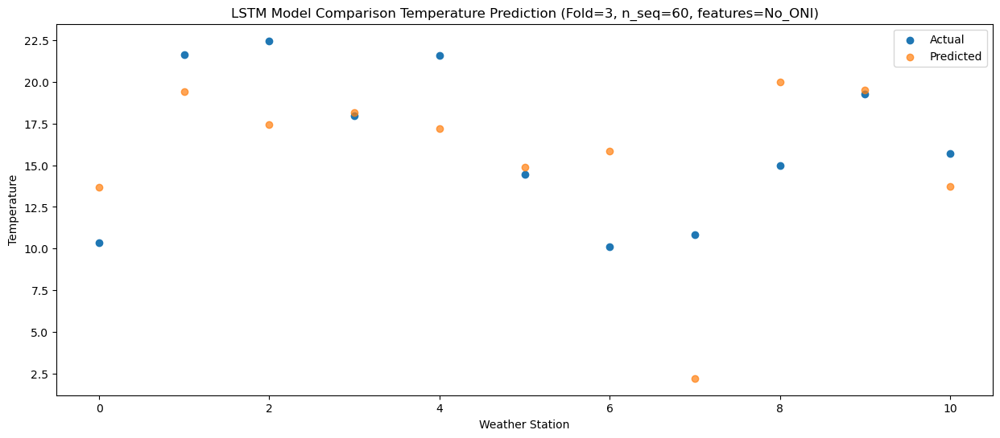

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93  13.586278
1                 1   21.94  19.312237
2                 2   19.50  17.336508
3                 3   16.93  18.058611
4                 4   21.06  17.067247
5                 5   13.91  14.758791
6                 6    9.83  15.763343
7                 7    7.98   2.108424
8                 8   13.69  19.898692
9                 9   17.57  19.401522
10               10   12.58  13.616010


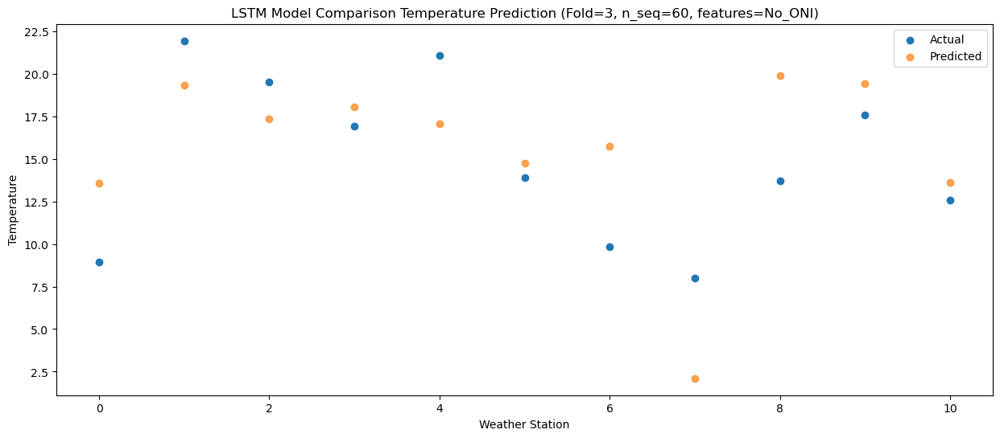

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  10.171533
1                 1   17.90  15.894949
2                 2   16.47  13.913005
3                 3   13.96  14.643695
4                 4   17.80  13.654098
5                 5   11.22  11.353464
6                 6    6.21  12.343043
7                 7    4.03  -1.320166
8                 8   12.25  16.464338
9                 9   13.56  15.980050
10               10    8.99  10.202811


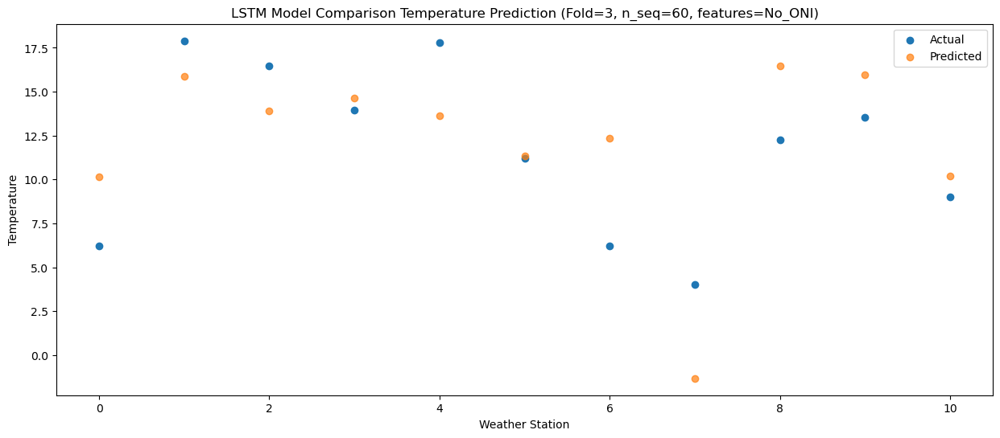

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93   5.470738
1                 1   14.51  11.195935
2                 2   11.44   9.213499
3                 3    7.46   9.947220
4                 4   12.17   8.956103
5                 5    5.34   6.654023
6                 6    1.98   7.642345
7                 7   -1.86  -6.019942
8                 8   11.79  11.768079
9                 9    9.03  11.278507
10               10    3.75   5.502725


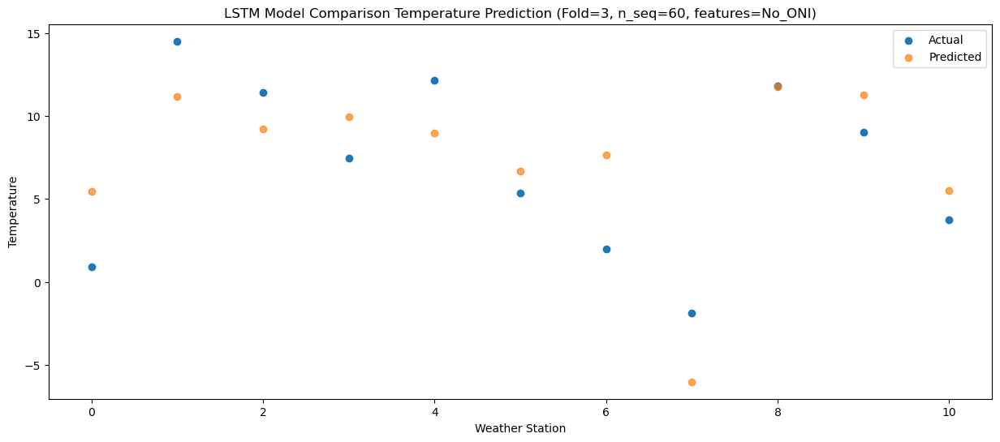

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

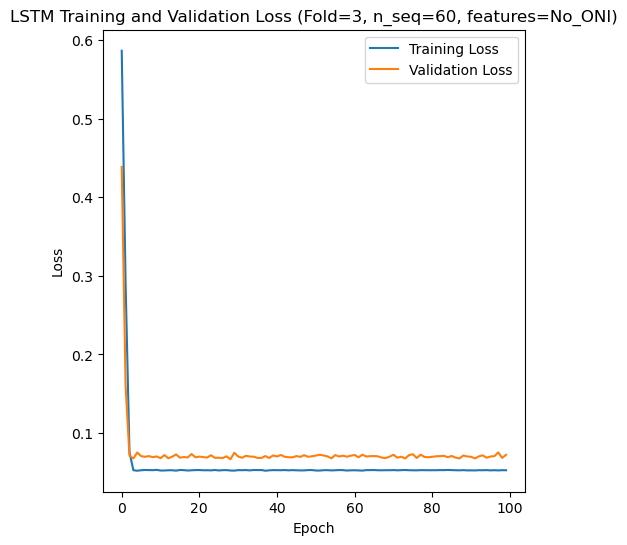

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 31s 121ms/step - loss: 0.6793 - accuracy: 0.5476 - mae: 0.5608 - rmse: 0.6793 - mape: inf - pearson: 0.0060 - val_loss: 0.5307 - val_accuracy: 0.6000 - val_mae: 0.4385 - val_rmse: 0.5307 - val_mape: 91.8507 - val_pearson: 0.0183
Epoch 2/100
84/84 [==============================] - 6s 68ms/step - loss: 0.3829 - accuracy: 0.5476 - mae: 0.3158 - rmse: 0.3829 - mape: inf - pearson: 0.0846 - val_loss: 0.2432 - val_accuracy: 0.6000 - val_mae: 0.2015 - val_rmse: 0.2432 - val_mape: 41.8944 - val_pearson: 0.2352
Epoch 3/100
84/84 [==============================] - 6s 68ms/step - loss: 0.1220 - accuracy: 0.5476 - mae: 0.0993 - rmse: 0.1220 - mape: inf - pearson: 0.6158 - val_loss: 0.0

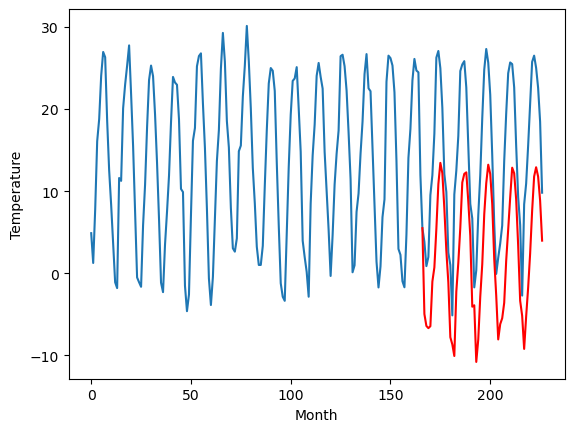

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-3.69		-1.31
-2.56		-5.13		-2.57
-4.02		-5.39		-1.37
-2.47		-5.15		-2.68
1.60		0.30		-1.30
3.28		2.02		-1.26
4.68		6.74		2.06
6.44		12.17		5.73
6.76		14.75		7.99
6.61		13.49		6.88
6.03		9.23		3.20
4.53		4.06		-0.47
1.14		0.19		-0.95
-6.61		-6.47		0.14
-5.91		-7.35		-1.44
-2.48		-8.75		-6.27
-0.88		-0.91		-0.03
0.56		2.59		2.03
4.60		6.87		2.27
6.23		12.37		6.14
6.60		13.41		6.81
6.88		13.59		6.71
5.59		10.07		4.48
3.75		5.87		2.12
-3.41		-2.78		0.63
-1.61		-2.62		-1.01
-6.37		-9.51		-3.14
-2.94		-6.76		-3.82
-0.12		-1.56		-1.44
2.22		2.39		0.17
5.04		8.49		3.45
6.76		12.28		5.52
7.13		14.54		7.41
7.08		13.41		6.33
5.64		9.76		4.12
1.81		3.08		1.27
0.35		-1.41		-1.76
-4.50		-6.74		-2.24
-4.65		-4.87		-0.22
-1.35		-4.13		-2.78
0.37		-2.26		-2.63
3.09		2.87		-0.22
3.87		6.68		2.81
6.08		10.56		4.48
7.69		14.21		6.52
8.20		13.52		5.32
6.10		10.33		4.23
2.45		4.72		2.27
-1.26		-2.00		-0.74


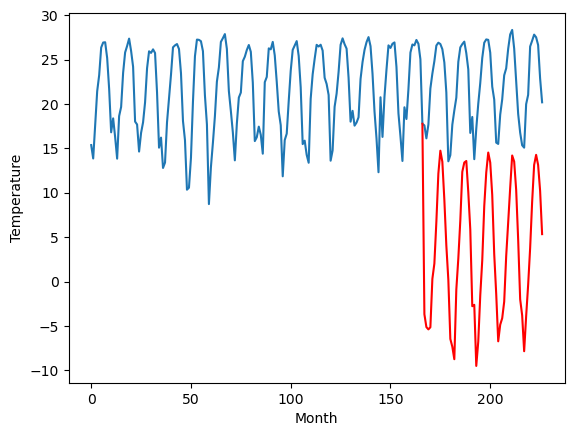

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		6.80		0.05
6.81		5.35		-1.46
6.62		5.10		-1.52
6.88		5.33		-1.55
14.68		10.78		-3.90
13.73		12.50		-1.23
17.61		17.22		-0.39
21.70		22.66		0.96
23.27		25.24		1.97
22.44		23.97		1.53
20.34		19.71		-0.63
15.00		14.55		-0.45
11.00		10.69		-0.31
4.75		4.03		-0.72
4.78		3.15		-1.63
2.86		1.74		-1.12
12.19		9.58		-2.61
13.26		13.09		-0.17
17.73		17.37		-0.36
21.99		22.86		0.87
22.65		23.91		1.26
23.30		24.08		0.78
20.18		20.56		0.38
16.79		16.35		-0.44
8.12		7.70		-0.42
11.63		7.85		-3.78
3.35		0.96		-2.39
5.71		3.72		-1.99
10.45		8.92		-1.53
14.66		12.87		-1.79
20.46		18.97		-1.49
23.75		22.76		-0.99
23.95		25.02		1.07
22.41		23.89		1.48
20.34		20.23		-0.11
14.21		13.56		-0.65
9.62		9.06		-0.56
7.19		3.74		-3.45
7.60		5.60		-2.00
9.54		6.33		-3.21
11.69		8.21		-3.48
13.44		13.33		-0.11
18.30		17.14		-1.16
21.89		21.01		-0.88
23.67		24.65		0.98
25.75		23.96		-1.79
22.00		20.77		-1.23
15.89		1

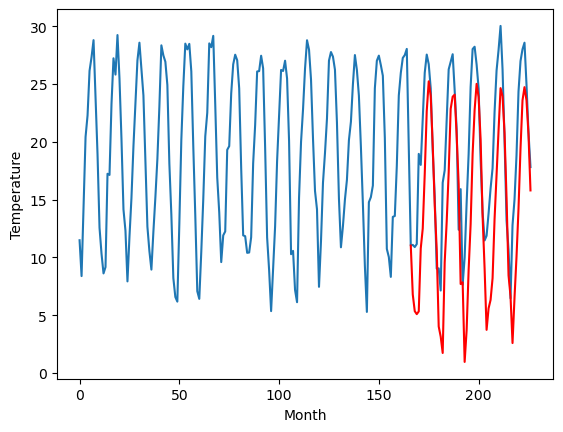

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		2.91		-1.32
2.58		1.47		-1.11
2.82		1.21		-1.61
2.49		1.44		-1.05
9.95		6.88		-3.07
10.61		8.60		-2.01
15.74		13.32		-2.42
20.70		18.76		-1.94
22.56		21.34		-1.22
22.31		20.08		-2.23
16.53		15.83		-0.70
10.80		10.67		-0.13
8.19		6.81		-1.38
1.91		0.15		-1.76
0.99		-0.73		-1.72
-2.47		-2.14		0.33
8.49		5.71		-2.78
10.18		9.21		-0.97
14.34		13.50		-0.84
20.02		19.00		-1.02
21.61		20.04		-1.57
21.98		20.22		-1.76
19.19		16.70		-2.49
14.54		12.49		-2.05
6.54		3.84		-2.70
8.54		3.99		-4.55
0.07		-2.90		-2.97
0.33		-0.15		-0.48
6.51		5.05		-1.46
12.56		9.00		-3.56
17.27		15.09		-2.18
21.82		18.88		-2.94
25.12		21.14		-3.98
22.39		20.02		-2.37
18.96		16.35		-2.61
12.09		9.69		-2.40
5.04		5.20		0.16
2.35		-0.13		-2.48
3.34		1.73		-1.61
3.40		2.46		-0.94
7.93		4.34		-3.59
10.53		9.46		-1.07
16.21		13.26		-2.95
20.40		17.12		-3.28
22.95		20.77		-2.18
25.50		20.09		-5.41
20.80		16.89		-3.91
12.67	

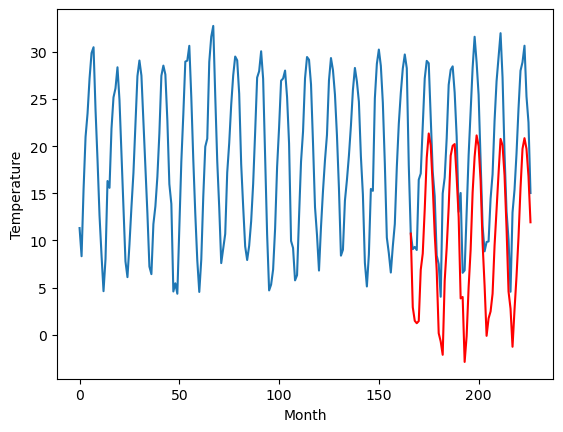

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.73		-0.92
1.87		1.29		-0.58
2.49		1.04		-1.45
2.11		1.26		-0.85
9.99		6.70		-3.29
10.68		8.42		-2.26
16.33		13.13		-3.20
21.04		18.57		-2.47
23.48		21.15		-2.33
22.80		19.90		-2.90
16.50		15.64		-0.86
10.75		10.48		-0.27
7.99		6.62		-1.37
1.42		-0.04		-1.46
0.82		-0.91		-1.73
-3.07		-2.32		0.75
7.85		5.53		-2.32
10.03		9.04		-0.99
13.56		13.33		-0.23
20.41		18.83		-1.58
21.90		19.87		-2.03
22.27		20.05		-2.22
18.84		16.53		-2.31
13.97		12.32		-1.65
6.13		3.68		-2.45
7.87		3.83		-4.04
-1.03		-3.06		-2.03
-0.41		-0.33		0.08
6.51		4.88		-1.63
13.20		8.82		-4.38
18.03		14.91		-3.12
22.70		18.69		-4.01
26.12		20.95		-5.17
23.28		19.83		-3.45
19.19		16.16		-3.03
12.04		9.50		-2.54
4.95		5.01		0.06
1.98		-0.31		-2.29
2.75		1.54		-1.21
2.98		2.27		-0.71
7.83		4.15		-3.68
10.48		9.27		-1.21
16.64		13.07		-3.57
21.75		16.93		-4.82
24.83		20.58		-4.25
26.70		19.90		-6.80
21.61		16.70		-4.91
12.7

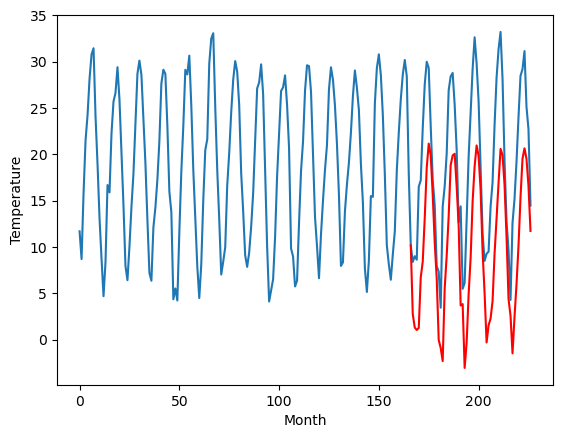

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.12		-2.00
3.48		1.68		-1.80
2.75		1.41		-1.34
1.99		1.63		-0.36
9.55		7.08		-2.47
12.52		8.80		-3.72
19.09		13.50		-5.59
22.42		18.94		-3.48
25.25		21.52		-3.73
24.63		20.27		-4.36
16.90		16.01		-0.89
12.94		10.84		-2.10
9.06		6.98		-2.08
2.08		0.32		-1.76
0.98		-0.56		-1.54
-0.59		-1.96		-1.37
8.66		5.89		-2.77
10.89		9.39		-1.50
16.38		13.69		-2.69
21.34		19.19		-2.15
21.08		20.24		-0.84
21.40		20.42		-0.98
20.71		16.90		-3.81
15.01		12.69		-2.32
8.07		4.04		-4.03
8.48		4.18		-4.30
1.11		-2.71		-3.82
0.91		0.03		-0.88
8.23		5.22		-3.01
15.74		9.17		-6.57
21.43		15.26		-6.17
23.80		19.04		-4.76
25.70		21.30		-4.40
22.40		20.18		-2.22
19.50		16.51		-2.99
12.69		9.85		-2.84
4.84		5.36		0.52
3.24		0.03		-3.21
3.61		1.89		-1.72
3.78		2.62		-1.16
8.85		4.50		-4.35
13.07		9.63		-3.44
17.99		13.42		-4.57
24.47		17.29		-7.18
25.93		20.94		-4.99
26.02		20.26		-5.76
22.54		17.07		-5.47
14.01		

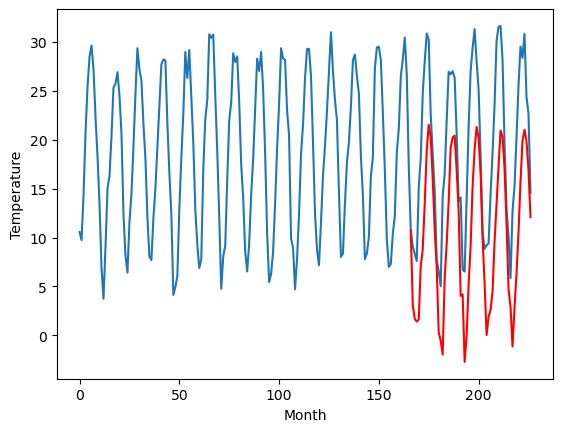

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		1.99		1.13
0.51		0.54		0.03
0.34		0.29		-0.05
0.81		0.51		-0.30
6.42		5.96		-0.46
7.69		7.68		-0.01
10.48		12.39		1.91
15.07		17.83		2.76
18.11		20.41		2.30
16.91		19.16		2.25
13.11		14.90		1.79
9.29		9.73		0.44
4.98		5.87		0.89
-2.27		-0.79		1.48
-2.04		-1.66		0.38
-1.37		-3.06		-1.69
5.03		4.79		-0.24
7.76		8.29		0.53
11.21		12.58		1.37
15.23		18.08		2.85
16.97		19.12		2.15
17.10		19.30		2.20
13.13		15.78		2.65
9.33		11.57		2.24
1.17		2.93		1.76
3.08		3.07		-0.01
-2.98		-3.82		-0.84
1.30		-1.08		-2.38
4.86		4.12		-0.74
7.52		8.06		0.54
13.50		14.15		0.65
16.71		17.93		1.22
17.98		20.19		2.21
16.46		19.07		2.61
13.37		15.40		2.03
6.50		8.73		2.23
3.80		4.25		0.45
-2.15		-1.06		1.09
0.87		0.79		-0.08
4.29		1.53		-2.76
4.77		3.41		-1.36
7.88		8.53		0.65
10.50		12.33		1.83
14.14		16.20		2.06
18.01		19.84		1.83
17.45		19.16		1.71
13.61		15.97		2.36
8.17		10.37		2.20
2.44		3.65		1.21
0.23		

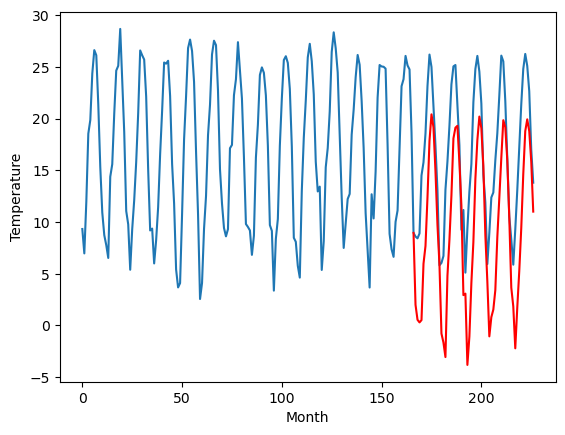

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.75		-1.26
1.20		-0.70		-1.90
-0.45		-0.96		-0.51
0.12		-0.74		-0.86
7.05		4.71		-2.34
8.63		6.43		-2.20
12.73		11.14		-1.59
19.08		16.59		-2.49
21.62		19.17		-2.45
19.63		17.92		-1.71
16.05		13.66		-2.39
9.12		8.49		-0.63
6.57		4.63		-1.94
0.04		-2.03		-2.07
-1.63		-2.90		-1.27
-5.24		-4.31		0.93
7.03		3.53		-3.50
8.93		7.03		-1.90
12.97		11.33		-1.64
19.27		16.83		-2.44
20.56		17.87		-2.69
21.08		18.05		-3.03
18.04		14.53		-3.51
12.27		10.33		-1.94
4.33		1.68		-2.65
5.79		1.84		-3.95
-3.28		-5.06		-1.78
-1.22		-2.32		-1.10
5.44		2.89		-2.55
9.30		6.84		-2.46
14.97		12.93		-2.04
20.29		16.71		-3.58
23.99		18.97		-5.02
20.47		17.85		-2.62
16.88		14.18		-2.70
10.51		7.51		-3.00
3.96		3.03		-0.93
-0.89		-2.30		-1.41
0.76		-0.44		-1.20
2.90		0.30		-2.60
4.62		2.17		-2.45
10.24		7.29		-2.95
15.02		11.09		-3.93
19.10		14.96		-4.14
21.06		18.60		-2.46
20.87		17.92		-2.95
16.93		14.73		-2.20


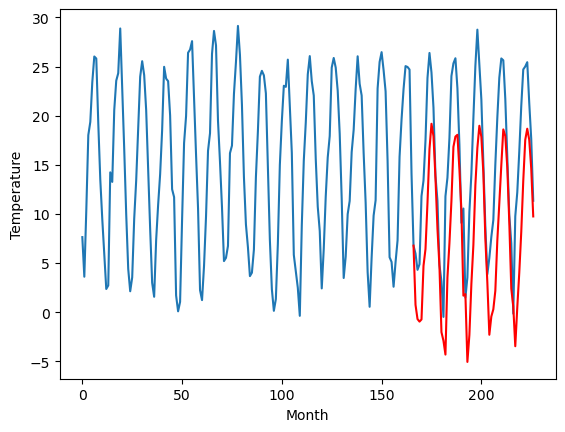

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.94		1.70
-3.46		-2.38		1.08
-4.39		-2.65		1.74
-5.22		-2.43		2.79
1.60		3.01		1.41
4.59		4.73		0.14
10.17		9.45		-0.72
17.46		14.90		-2.56
19.50		17.49		-2.01
17.30		16.23		-1.07
13.54		11.98		-1.56
6.70		6.81		0.11
2.86		2.96		0.10
-4.65		-3.70		0.95
-6.23		-4.57		1.66
-9.59		-5.99		3.60
2.38		1.86		-0.52
6.03		5.35		-0.68
10.44		9.64		-0.80
17.68		15.13		-2.55
18.25		16.18		-2.07
19.11		16.36		-2.75
15.62		12.84		-2.78
10.27		8.64		-1.63
-0.59		-0.01		0.58
-0.27		0.15		0.42
-9.11		-6.75		2.36
-6.09		-4.00		2.09
1.38		1.20		-0.18
5.16		5.14		-0.02
13.66		11.25		-2.41
18.14		15.02		-3.12
20.08		17.28		-2.80
17.85		16.15		-1.70
13.94		12.48		-1.46
6.45		5.81		-0.64
0.66		1.33		0.67
-5.12		-3.99		1.13
-3.16		-2.13		1.03
-1.57		-1.40		0.17
-0.30		0.48		0.78
6.20		5.60		-0.60
11.91		9.40		-2.51
15.79		13.27		-2.52
18.52		16.91		-1.61
17.36		16.22		-1.14
14.27		13.02		-1.25
8.13		7.41		-

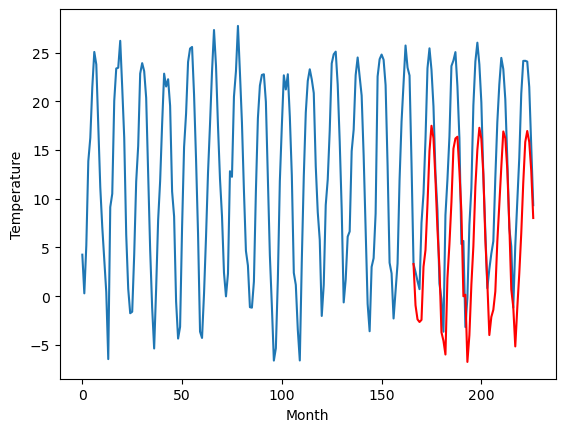

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.32		0.56
-5.20		-5.77		-0.57
-7.64		-6.04		1.60
-7.89		-5.83		2.06
-0.29		-0.39		-0.10
2.82		1.33		-1.49
8.70		6.06		-2.64
16.43		11.51		-4.92
17.64		14.10		-3.54
15.04		12.85		-2.19
11.14		8.59		-2.55
3.80		3.43		-0.37
1.16		-0.43		-1.59
-6.72		-7.09		-0.37
-8.75		-7.95		0.80
-13.19		-9.37		3.82
0.67		-1.53		-2.20
4.38		1.97		-2.41
9.16		6.25		-2.91
16.55		11.75		-4.80
16.26		12.80		-3.46
16.54		12.98		-3.56
13.43		9.45		-3.98
7.97		5.26		-2.71
-2.34		-3.39		-1.05
-2.59		-3.22		-0.63
-12.07		-10.12		1.95
-9.24		-7.37		1.87
-1.03		-2.18		-1.15
3.09		1.77		-1.32
11.62		7.88		-3.74
16.23		11.65		-4.58
17.05		13.92		-3.13
15.75		12.79		-2.96
11.61		9.11		-2.50
4.14		2.44		-1.70
-1.40		-2.04		-0.64
-8.13		-7.37		0.76
-5.89		-5.51		0.38
-4.70		-4.79		-0.09
-2.16		-2.92		-0.76
5.17		2.21		-2.96
10.93		6.01		-4.92
15.24		9.88		-5.36
16.77		13.52		-3.25
15.51		12.82		-2.69
12.47		9.62		-2.

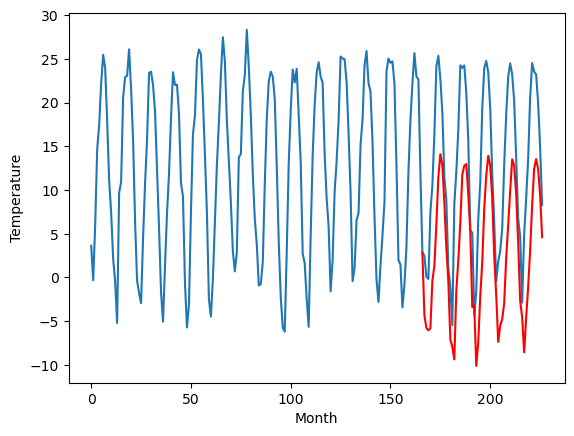

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-4.96		1.83
-7.57		-6.41		1.16
-8.77		-6.68		2.09
-9.58		-6.47		3.11
-3.42		-1.03		2.39
-2.04		0.69		2.73
4.70		5.42		0.72
11.19		10.87		-0.32
14.63		13.47		-1.16
12.22		12.20		-0.02
8.23		7.95		-0.28
2.07		2.78		0.71
-1.16		-1.07		0.09
-8.72		-7.73		0.99
-10.64		-8.59		2.05
-12.88		-10.02		2.86
-2.99		-2.18		0.81
0.81		1.32		0.51
5.34		5.59		0.25
12.23		11.09		-1.14
12.39		12.14		-0.25
13.59		12.33		-1.26
9.30		8.80		-0.50
5.77		4.60		-1.17
-4.63		-4.05		0.58
-5.49		-3.88		1.61
-14.32		-10.78		3.54
-10.76		-8.03		2.73
-4.79		-2.83		1.96
-0.79		1.12		1.91
7.79		7.23		-0.56
11.06		11.01		-0.05
13.66		13.27		-0.39
12.59		12.13		-0.46
8.54		8.46		-0.08
1.68		1.79		0.11
-2.40		-2.70		-0.30
-9.11		-8.02		1.09
-7.48		-6.16		1.32
-7.34		-5.44		1.90
-6.46		-3.56		2.90
2.01		1.56		-0.45
5.70		5.36		-0.34
10.01		9.23		-0.78
13.10		12.87		-0.23
11.77		12.18		0.41
9.43		8.98		-0.45
4.17		3.37		-0

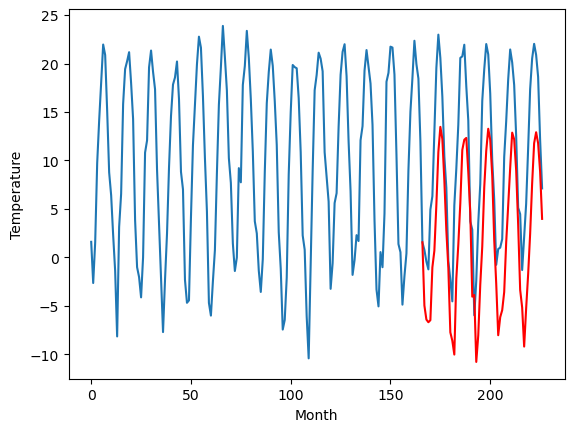

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.957990
1                 1   -2.38  -3.686996
2                 2    6.75   6.799235
3                 3    4.23   2.911353
4                 4    3.65   2.734871
5                 5    5.12   3.120906
6                 6    0.86   1.989211
7                 7    2.01   0.747318
8                 8   -2.64  -0.935237
9                 9   -4.88  -4.317624
10               10   -6.79  -4.958165


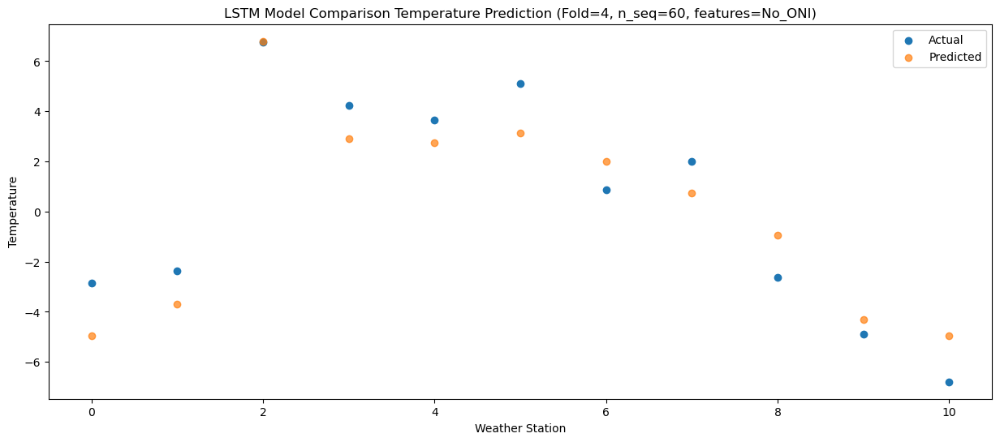

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -6.407217
1                 1   -2.56  -5.131522
2                 2    6.81   5.353488
3                 3    2.58   1.466842
4                 4    1.87   1.293634
5                 5    3.48   1.676086
6                 6    0.51   0.541023
7                 7    1.20  -0.698443
8                 8   -3.46  -2.380606
9                 9   -5.20  -5.767905
10               10   -7.57  -6.407503


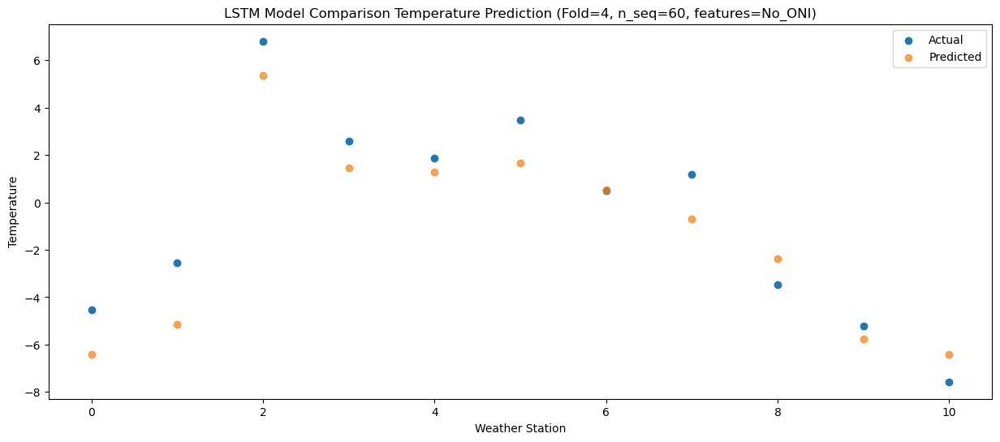

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -6.675265
1                 1   -4.02  -5.393047
2                 2    6.62   5.098104
3                 3    2.82   1.210936
4                 4    2.49   1.036132
5                 5    2.75   1.410481
6                 6    0.34   0.286842
7                 7   -0.45  -0.958484
8                 8   -4.39  -2.650506
9                 9   -7.64  -6.044842
10               10   -8.77  -6.684273


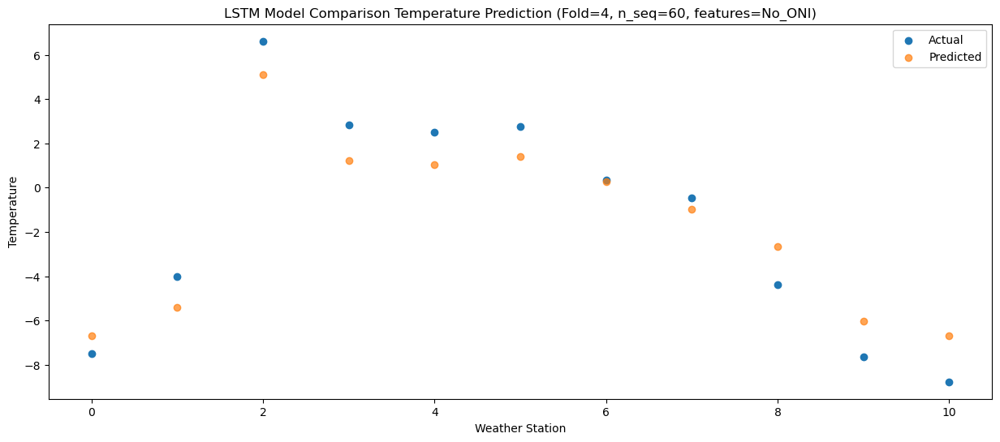

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -6.439754
1                 1   -2.47  -5.154135
2                 2    6.88   5.333440
3                 3    2.49   1.436008
4                 4    2.11   1.255775
5                 5    1.99   1.630510
6                 6    0.81   0.510580
7                 7    0.12  -0.736270
8                 8   -5.22  -2.431028
9                 9   -7.89  -5.829212
10               10   -9.58  -6.472775


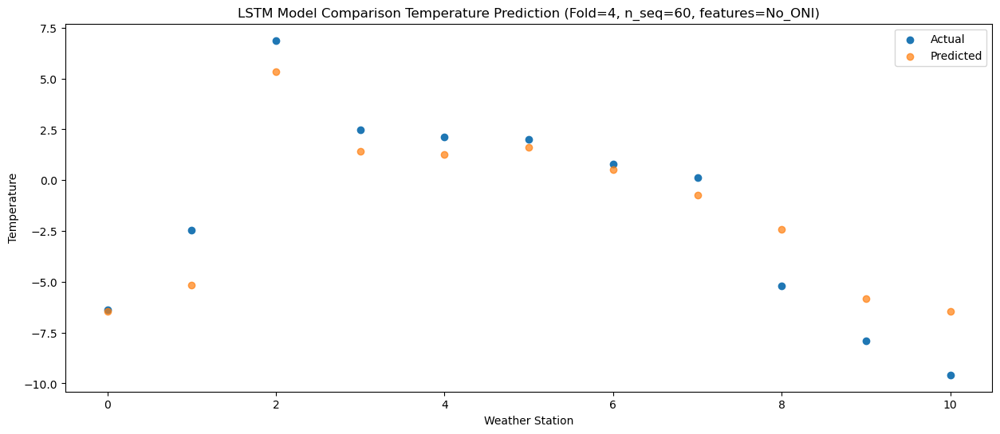

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16  -0.999541
1                 1    1.60   0.299136
2                 2   14.68  10.784141
3                 3    9.95   6.883177
4                 4    9.99   6.700801
5                 5    9.55   7.079269
6                 6    6.42   5.961396
7                 7    7.05   4.710906
8                 8    1.60   3.014267
9                 9   -0.29  -0.385569
10               10   -3.42  -1.027170


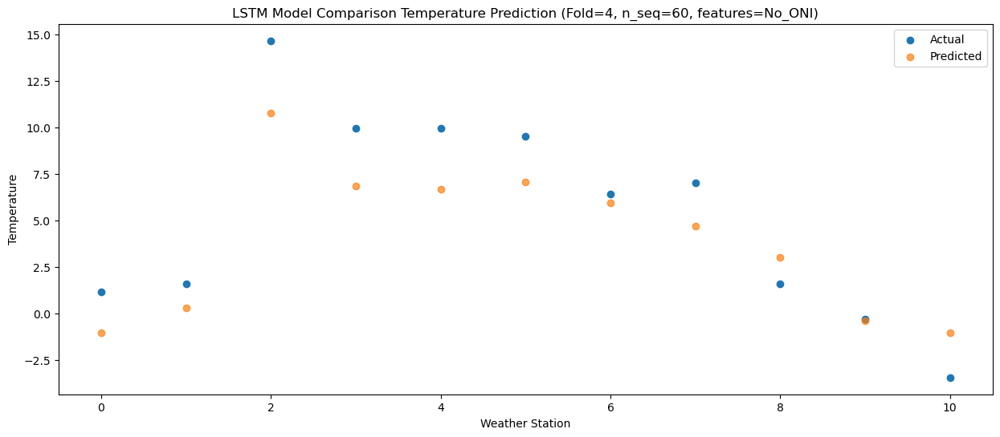

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   0.717049
1                 1    3.28   2.022007
2                 2   13.73  12.499347
3                 3   10.61   8.603089
4                 4   10.68   8.423193
5                 5   12.52   8.800321
6                 6    7.69   7.680184
7                 7    8.63   6.427178
8                 8    4.59   4.730996
9                 9    2.82   1.330464
10               10   -2.04   0.693175


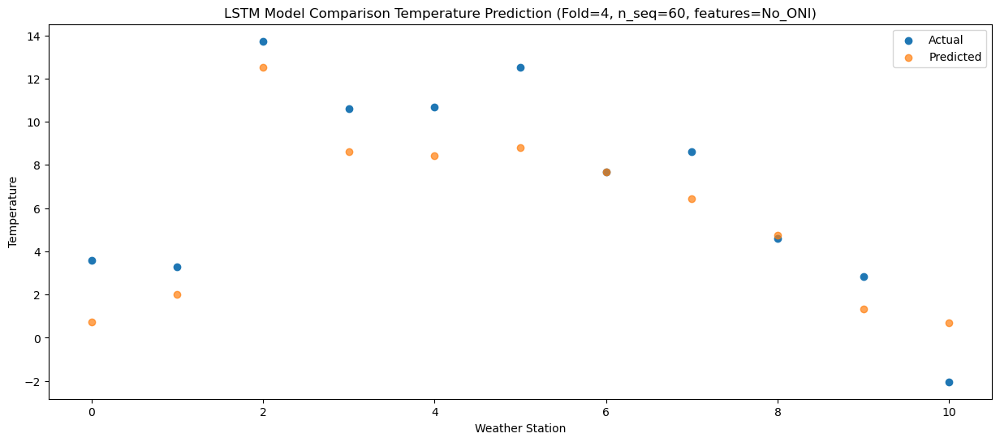

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   5.432436
1                 1    4.68   6.735538
2                 2   17.61  17.224565
3                 3   15.74  13.323201
4                 4   16.33  13.133995
5                 5   19.09  13.504408
6                 6   10.48  12.388533
7                 7   12.73  11.143352
8                 8   10.17   9.451236
9                 9    8.70   6.056592
10               10    4.70   5.421817


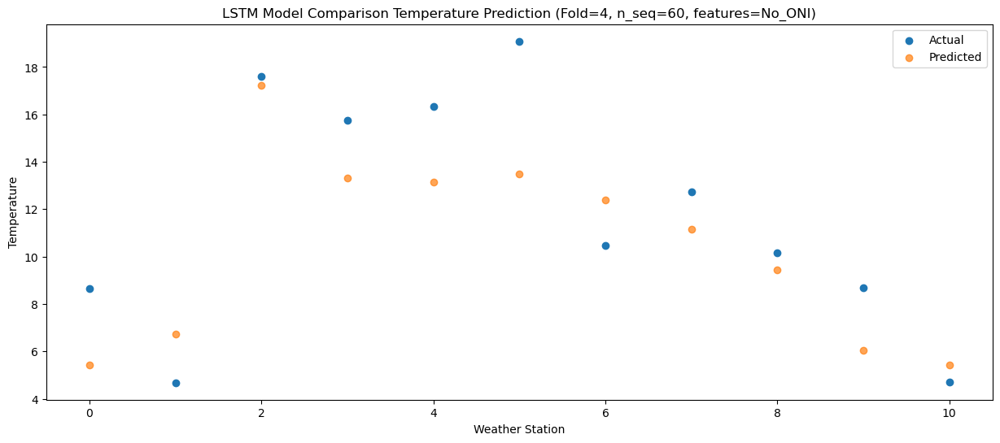

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  10.867473
1                 1    6.44  12.166499
2                 2   21.70  22.655616
3                 3   20.70  18.760794
4                 4   21.04  18.573161
5                 5   22.42  18.944946
6                 6   15.07  17.829519
7                 7   19.08  16.589098
8                 8   17.46  14.900461
9                 9   16.43  11.507854
10               10   11.19  10.873363


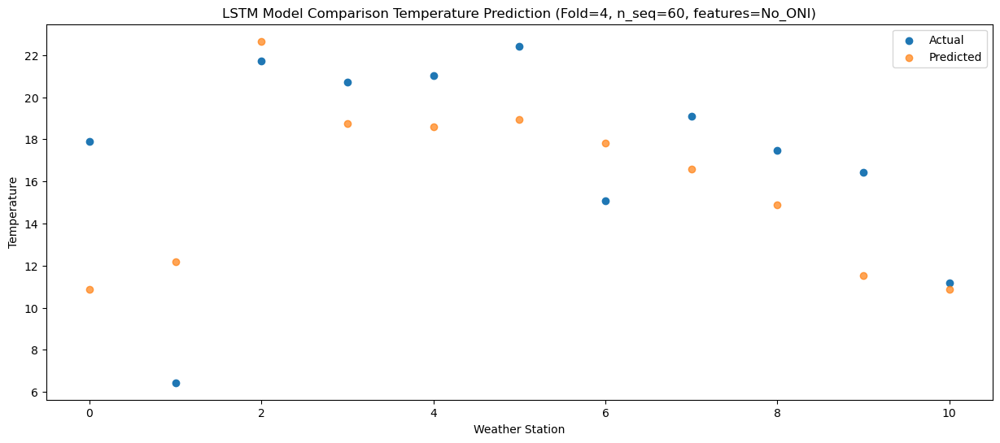

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  13.450614
1                 1    6.76  14.746340
2                 2   23.27  25.236753
3                 3   22.56  21.344646
4                 4   23.48  21.154504
5                 5   25.25  21.521234
6                 6   18.11  20.408560
7                 7   21.62  19.174253
8                 8   19.50  17.491116
9                 9   17.64  14.102439
10               10   14.63  13.467794


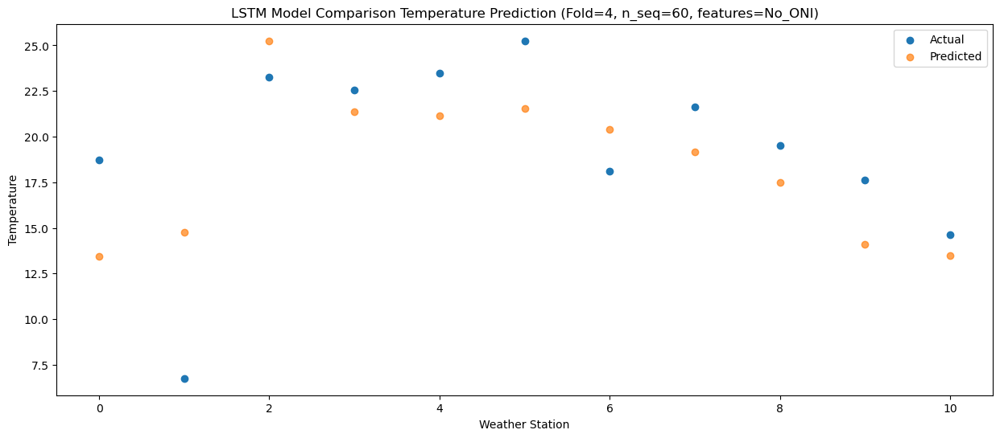

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  12.192632
1                 1    6.61  13.494997
2                 2   22.44  23.974435
3                 3   22.31  20.083763
4                 4   22.80  19.897147
5                 5   24.63  20.269184
6                 6   16.91  19.160657
7                 7   19.63  17.916338
8                 8   17.30  16.231951
9                 9   15.04  12.845611
10               10   12.22  12.204063


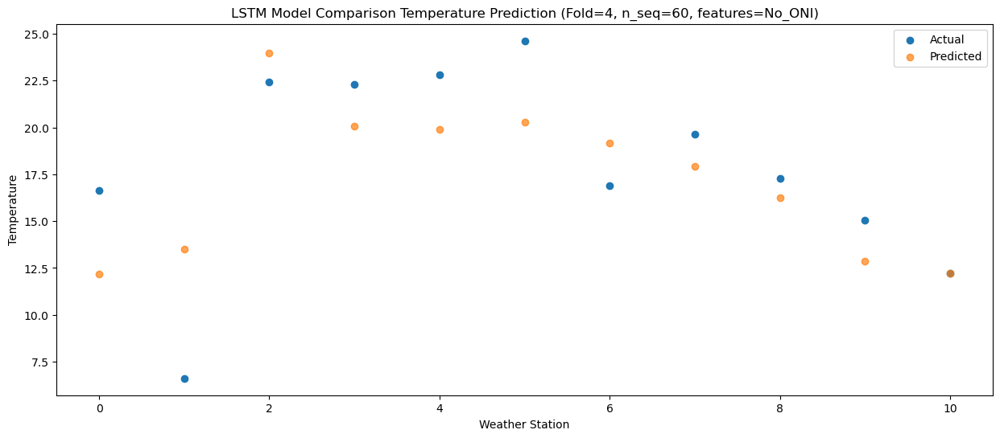

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78   7.920586
1                 1    6.03   9.226067
2                 2   20.34  19.711429
3                 3   16.53  15.827726
4                 4   16.50  15.641651
5                 5   16.90  16.009972
6                 6   13.11  14.902399
7                 7   16.05  13.657230
8                 8   13.54  11.976878
9                 9   11.14   8.592010
10               10    8.23   7.947116


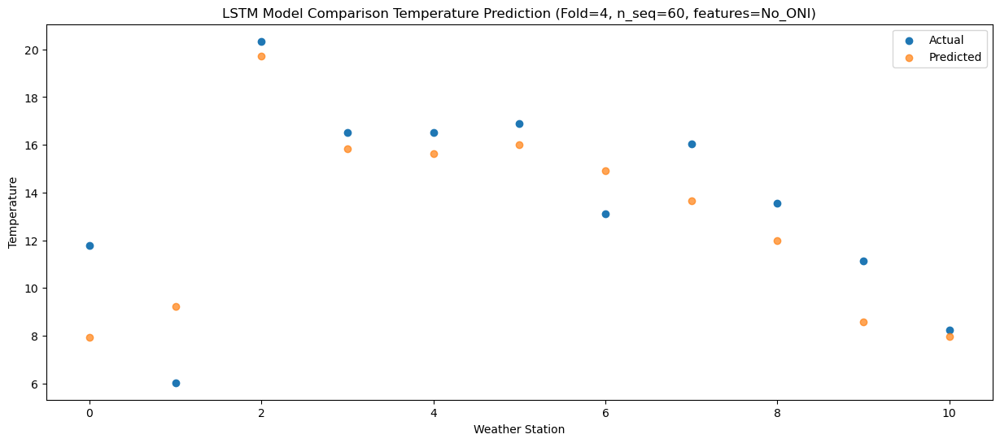

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   2.750444
1                 1    4.53   4.058400
2                 2   15.00  14.548342
3                 3   10.80  10.666711
4                 4   10.75  10.480100
5                 5   12.94  10.837749
6                 6    9.29   9.731742
7                 7    9.12   8.488801
8                 8    6.70   6.813225
9                 9    3.80   3.427651
10               10    2.07   2.782314


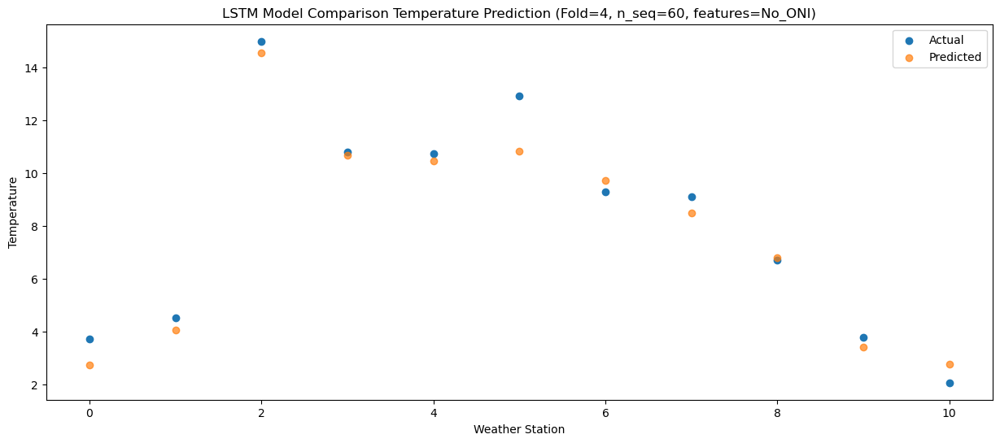

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54  -1.114078
1                 1    1.14   0.193098
2                 2   11.00  10.685657
3                 3    8.19   6.805515
4                 4    7.99   6.620055
5                 5    9.06   6.977027
6                 6    4.98   5.867869
7                 7    6.57   4.627588
8                 8    2.86   2.958312
9                 9    1.16  -0.426245
10               10   -1.16  -1.067496


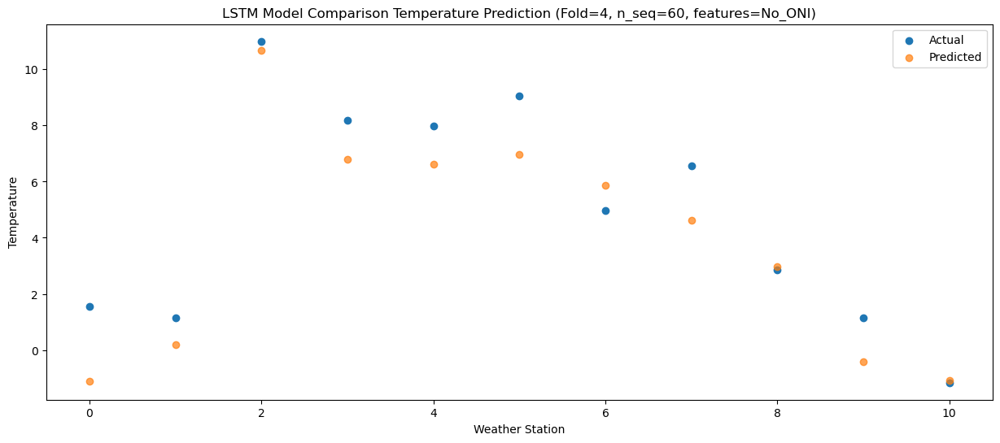

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -7.780986
1                 1   -6.61  -6.469443
2                 2    4.75   4.028035
3                 3    1.91   0.148919
4                 4    1.42  -0.035459
5                 5    2.08   0.318446
6                 6   -2.27  -0.788864
7                 7    0.04  -2.030488
8                 8   -4.65  -3.704973
9                 9   -6.72  -7.089528
10               10   -8.72  -7.726538


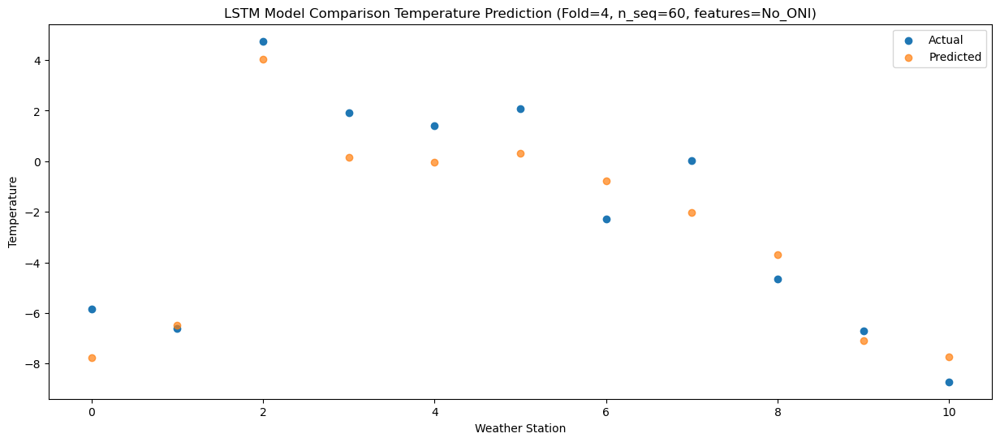

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -8.656638
1                 1   -5.91  -7.348694
2                 2    4.78   3.152247
3                 3    0.99  -0.728314
4                 4    0.82  -0.913941
5                 5    0.98  -0.558107
6                 6   -2.04  -1.660080
7                 7   -1.63  -2.902022
8                 8   -6.23  -4.574210
9                 9   -8.75  -7.953770
10               10  -10.64  -8.593622


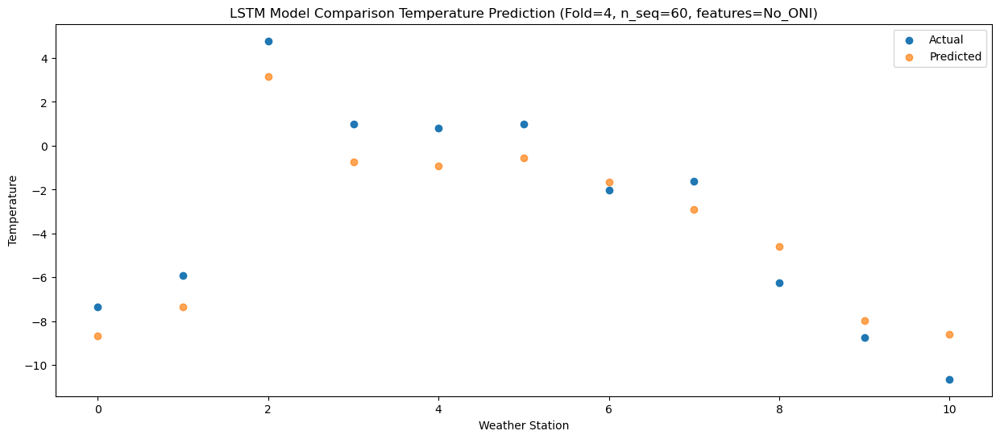

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48 -10.067350
1                 1   -2.48  -8.754556
2                 2    2.86   1.737402
3                 3   -2.47  -2.140092
4                 4   -3.07  -2.322070
5                 5   -0.59  -1.963368
6                 6   -1.37  -3.064288
7                 7   -5.24  -4.312393
8                 8   -9.59  -5.988191
9                 9  -13.19  -9.371030
10               10  -12.88 -10.019399


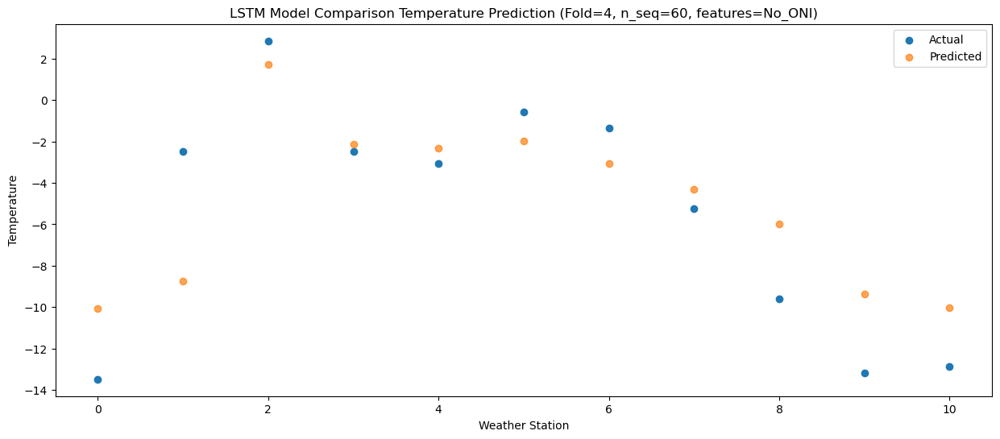

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -2.224744
1                 1   -0.88  -0.913761
2                 2   12.19   9.582282
3                 3    8.49   5.712390
4                 4    7.85   5.533843
5                 5    8.66   5.892592
6                 6    5.03   4.786465
7                 7    7.03   3.534053
8                 8    2.38   1.858928
9                 9    0.67  -1.526031
10               10   -2.99  -2.180361


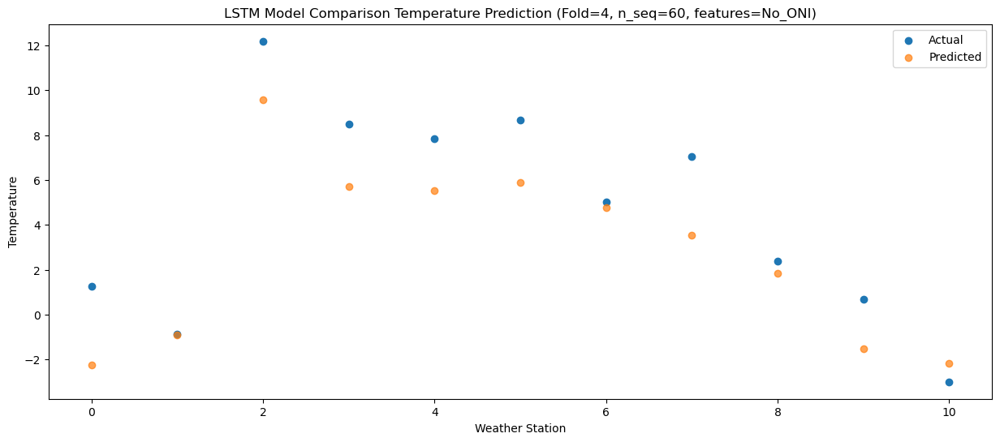

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   1.277493
1                 1    0.56   2.589002
2                 2   13.26  13.086234
3                 3   10.18   9.212910
4                 4   10.03   9.035694
5                 5   10.89   9.393307
6                 6    7.76   8.286624
7                 7    8.93   7.032272
8                 8    6.03   5.351786
9                 9    4.38   1.970801
10               10    0.81   1.317636


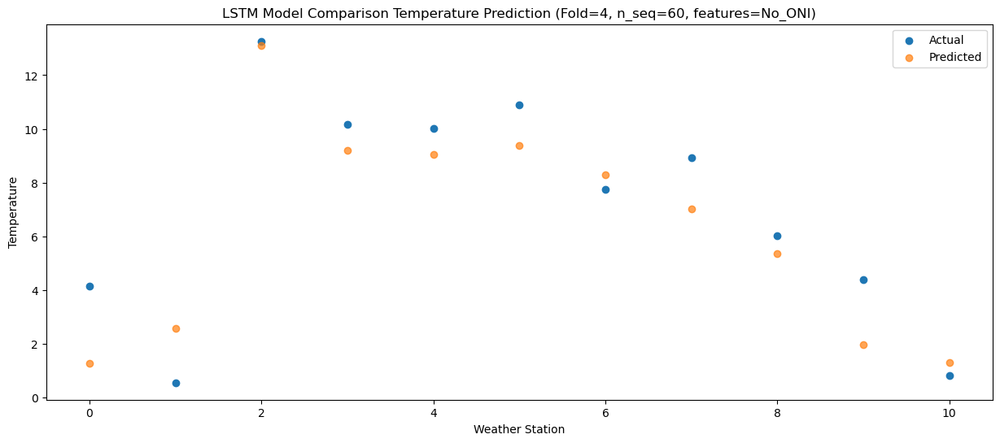

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   5.565996
1                 1    4.60   6.872736
2                 2   17.73  17.369829
3                 3   14.34  13.501349
4                 4   13.56  13.329682
5                 5   16.38  13.691273
6                 6   11.21  12.576543
7                 7   12.97  11.326412
8                 8   10.44   9.636483
9                 9    9.16   6.252667
10               10    5.34   5.594745


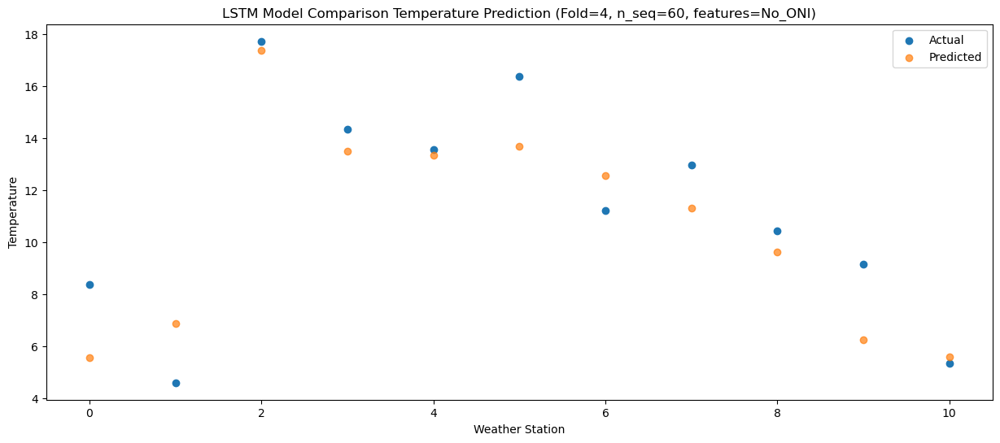

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  11.071659
1                 1    6.23  12.367529
2                 2   21.99  22.861786
3                 3   20.02  18.997953
4                 4   20.41  18.829171
5                 5   21.34  19.187900
6                 6   15.23  18.077369
7                 7   19.27  16.825423
8                 8   17.68  15.134064
9                 9   16.55  11.750297
10               10   12.23  11.087358


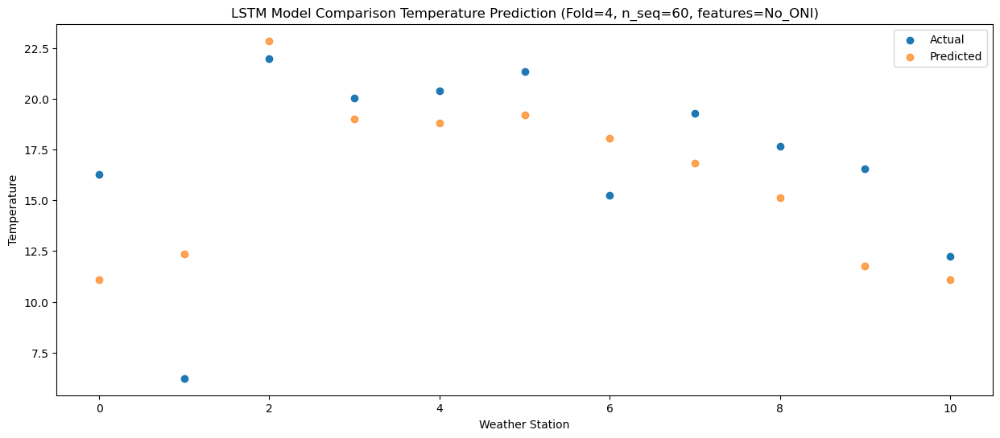

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  12.119476
1                 1    6.60  13.414019
2                 2   22.65  23.908771
3                 3   21.61  20.042466
4                 4   21.90  19.873446
5                 5   21.08  20.235497
6                 6   16.97  19.118650
7                 7   20.56  17.870067
8                 8   18.25  16.183482
9                 9   16.26  12.797688
10               10   12.39  12.140479


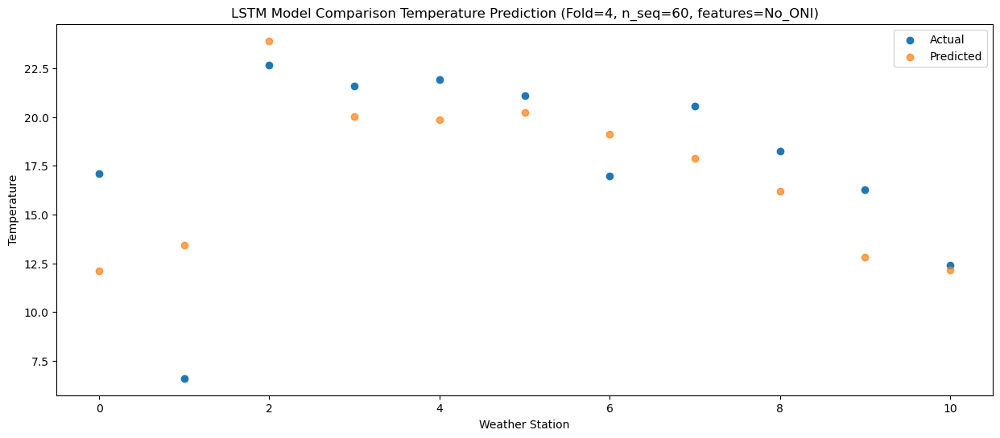

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  12.296355
1                 1    6.88  13.587716
2                 2   23.30  24.082438
3                 3   21.98  20.222590
4                 4   22.27  20.053831
5                 5   21.40  20.415687
6                 6   17.10  19.300254
7                 7   21.08  18.050957
8                 8   19.11  16.364778
9                 9   16.54  12.981651
10               10   13.59  12.325344


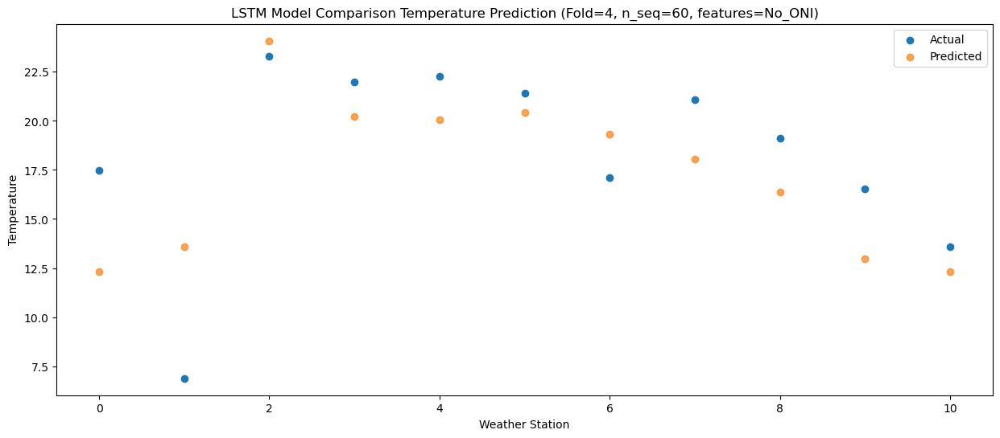

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29   8.775253
1                 1    5.59  10.072549
2                 2   20.18  20.559489
3                 3   19.19  16.698009
4                 4   18.84  16.532821
5                 5   20.71  16.899164
6                 6   13.13  15.777166
7                 7   18.04  14.532324
8                 8   15.62  12.839921
9                 9   13.43   9.451364
10               10    9.30   8.797396


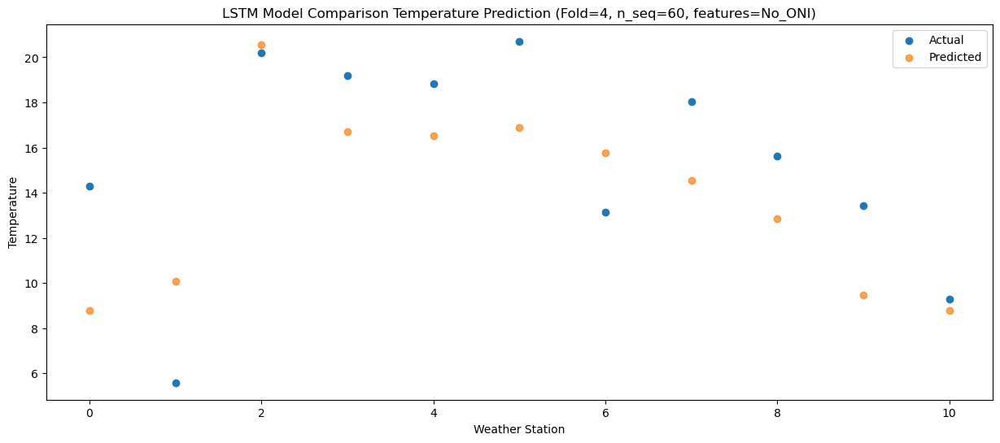

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   4.584405
1                 1    3.75   5.873614
2                 2   16.79  16.351420
3                 3   14.54  12.488949
4                 4   13.97  12.323561
5                 5   15.01  12.688352
6                 6    9.33  11.570362
7                 7   12.27  10.332914
8                 8   10.27   8.640004
9                 9    7.97   5.258052
10               10    5.77   4.599387


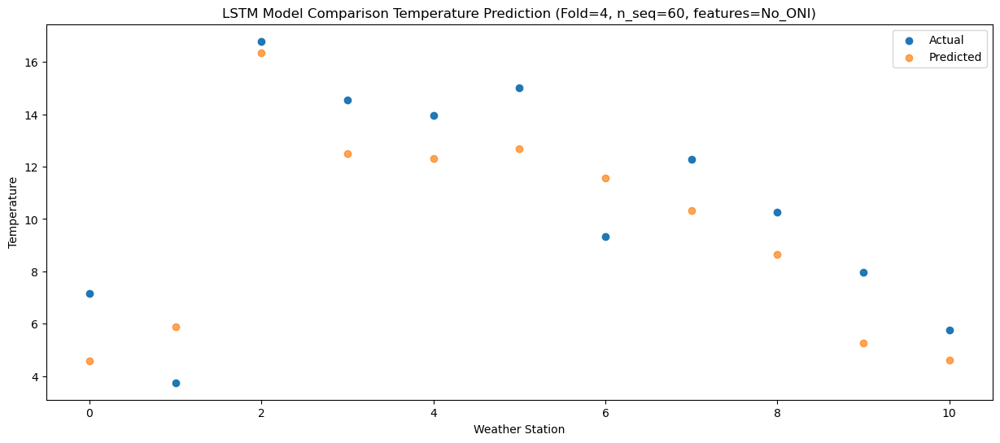

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10  -4.062317
1                 1   -3.41  -2.779806
2                 2    8.12   7.701919
3                 3    6.54   3.843756
4                 4    6.13   3.678365
5                 5    8.07   4.039710
6                 6    1.17   2.925158
7                 7    4.33   1.683877
8                 8   -0.59  -0.010179
9                 9   -2.34  -3.387559
10               10   -4.63  -4.047881


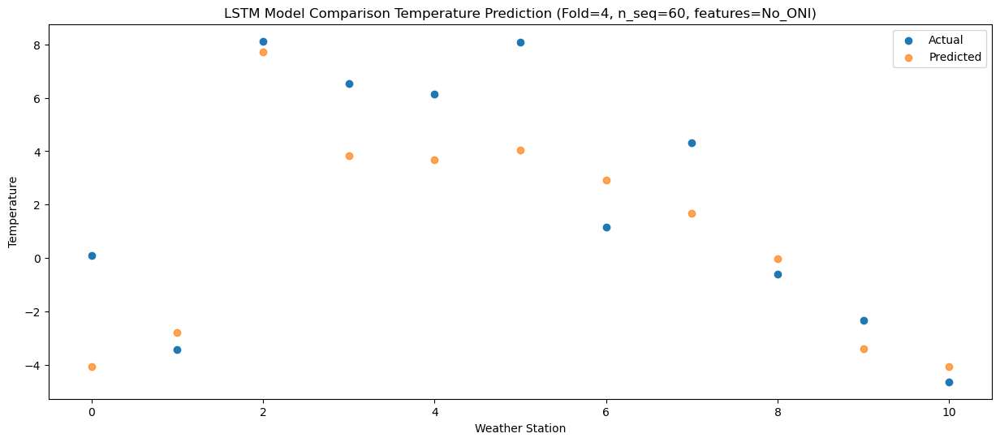

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -3.892896
1                 1   -1.61  -2.623202
2                 2   11.63   7.851247
3                 3    8.54   3.994785
4                 4    7.87   3.830697
5                 5    8.48   4.182541
6                 6    3.08   3.068620
7                 7    5.79   1.837302
8                 8   -0.27   0.147822
9                 9   -2.59  -3.217295
10               10   -5.49  -3.877799


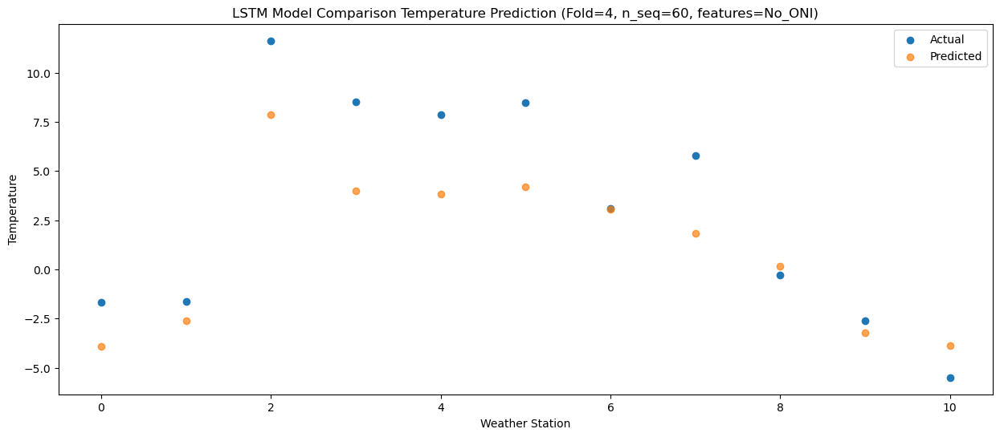

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07 -10.789172
1                 1   -6.37  -9.510983
2                 2    3.35   0.964046
3                 3    0.07  -2.896149
4                 4   -1.03  -3.060899
5                 5    1.11  -2.711883
6                 6   -2.98  -3.824639
7                 7   -3.28  -5.059941
8                 8   -9.11  -6.748552
9                 9  -12.07 -10.116760
10               10  -14.32 -10.778398


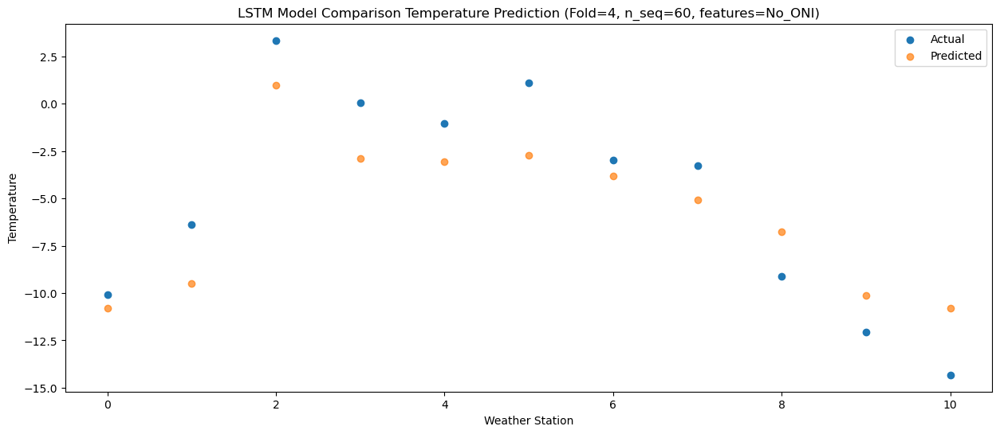

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -8.048857
1                 1   -2.94  -6.764068
2                 2    5.71   3.716615
3                 3    0.33  -0.154314
4                 4   -0.41  -0.325019
5                 5    0.91   0.025024
6                 6    1.30  -1.083447
7                 7   -1.22  -2.316188
8                 8   -6.09  -4.004273
9                 9   -9.24  -7.372620
10               10  -10.76  -8.029179


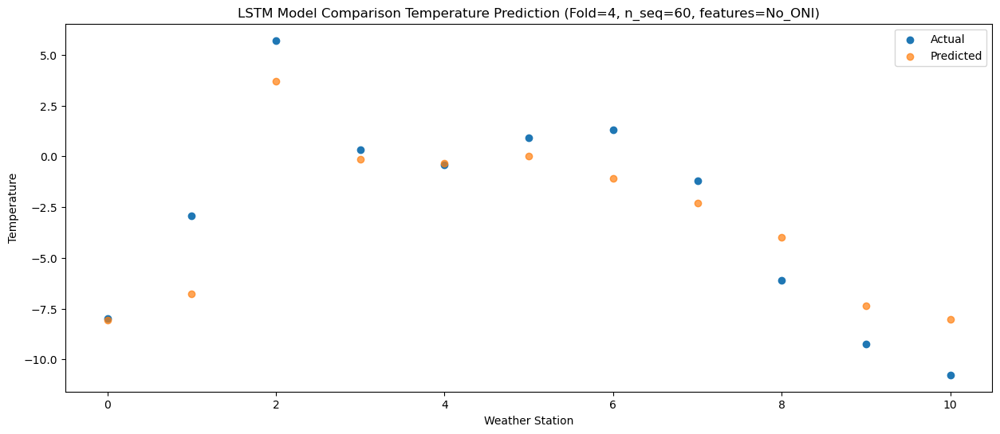

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -2.843589
1                 1   -0.12  -1.560636
2                 2   10.45   8.922803
3                 3    6.51   5.051204
4                 4    6.51   4.879624
5                 5    8.23   5.223065
6                 6    4.86   4.116947
7                 7    5.44   2.888075
8                 8    1.38   1.196600
9                 9   -1.03  -2.175077
10               10   -4.79  -2.827896


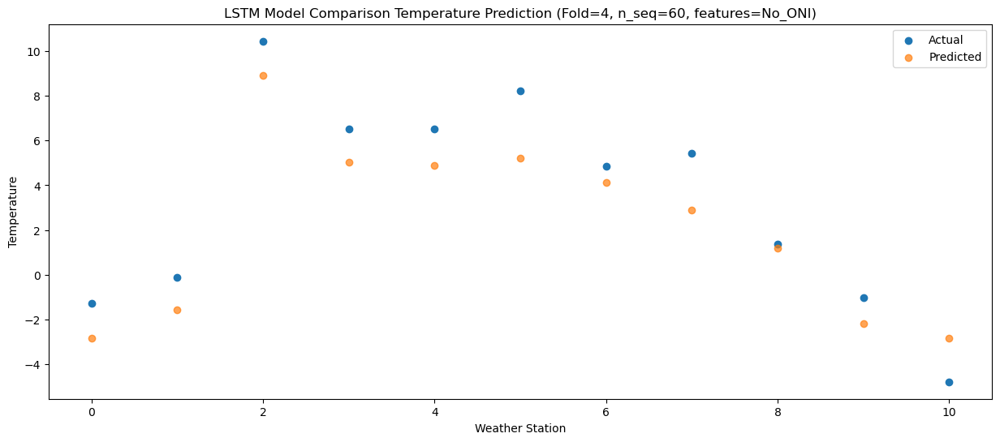

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.106533
1                 1    2.22   2.393477
2                 2   14.66  12.873407
3                 3   12.56   8.997019
4                 4   13.20   8.821598
5                 5   15.74   9.170565
6                 6    7.52   8.061622
7                 7    9.30   6.835617
8                 8    5.16   5.140656
9                 9    3.09   1.770728
10               10   -0.79   1.117715


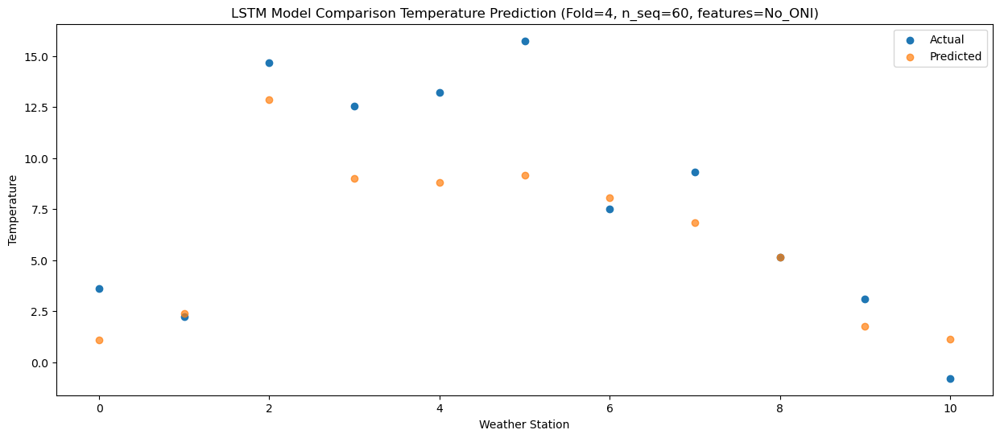

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53   7.202865
1                 1    5.04   8.493260
2                 2   20.46  18.970699
3                 3   17.27  15.092612
4                 4   18.03  14.910845
5                 5   21.43  15.261696
6                 6   13.50  14.154139
7                 7   14.97  12.934281
8                 8   13.66  11.248873
9                 9   11.62   7.884185
10               10    7.79   7.233574


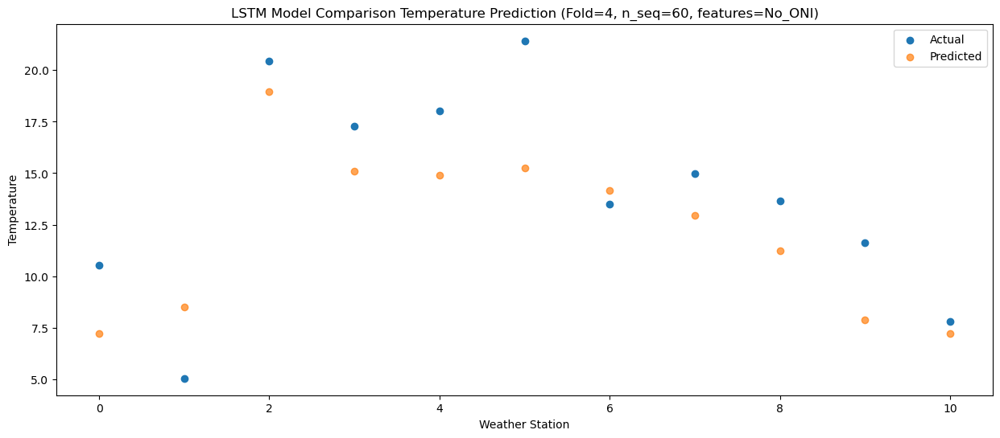

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  10.973142
1                 1    6.76  12.281217
2                 2   23.75  22.762007
3                 3   21.82  18.876604
4                 4   22.70  18.689554
5                 5   23.80  19.042239
6                 6   16.71  17.931210
7                 7   20.29  16.710846
8                 8   18.14  15.023714
9                 9   16.23  11.653234
10               10   11.06  11.010217


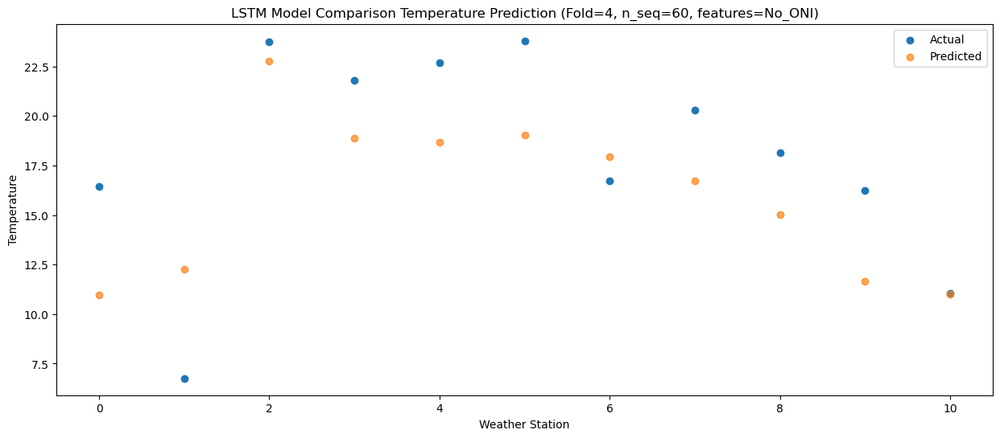

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  13.227449
1                 1    7.13  14.537988
2                 2   23.95  25.020056
3                 3   25.12  21.140645
4                 4   26.12  20.952210
5                 5   25.70  21.297535
6                 6   17.98  20.191492
7                 7   23.99  18.970362
8                 8   20.08  17.284777
9                 9   17.05  13.917672
10               10   13.66  13.271054


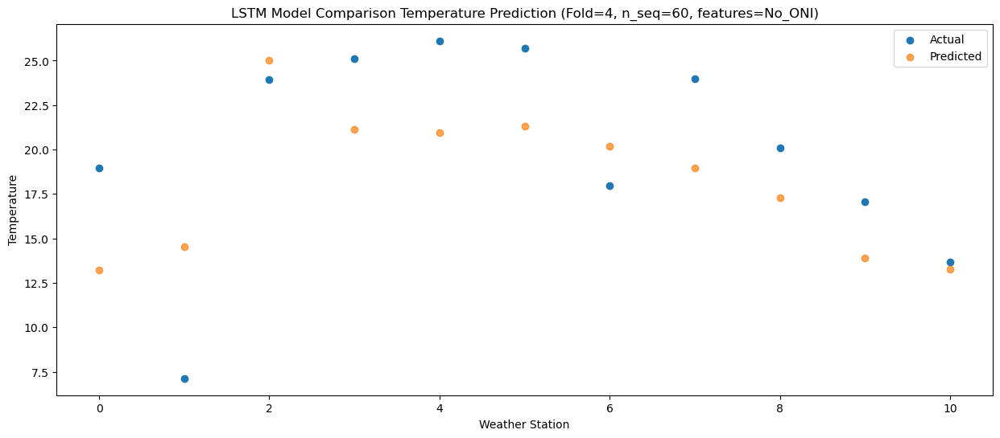

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  12.104154
1                 1    7.08  13.411566
2                 2   22.41  23.891485
3                 3   22.39  20.017218
4                 4   23.28  19.832625
5                 5   22.40  20.176081
6                 6   16.46  19.069645
7                 7   20.47  17.845346
8                 8   17.85  16.151564
9                 9   15.75  12.786866
10               10   12.59  12.133576


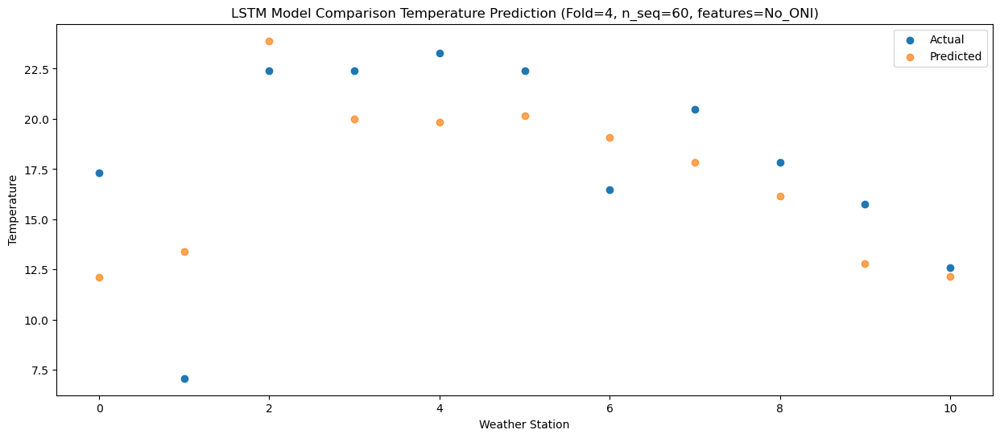

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39   8.444900
1                 1    5.64   9.760387
2                 2   20.34  20.232855
3                 3   18.96  16.348429
4                 4   19.19  16.159802
5                 5   19.50  16.512523
6                 6   13.37  15.401978
7                 7   16.88  14.176362
8                 8   13.94  12.483290
9                 9   11.61   9.114269
10               10    8.54   8.463973


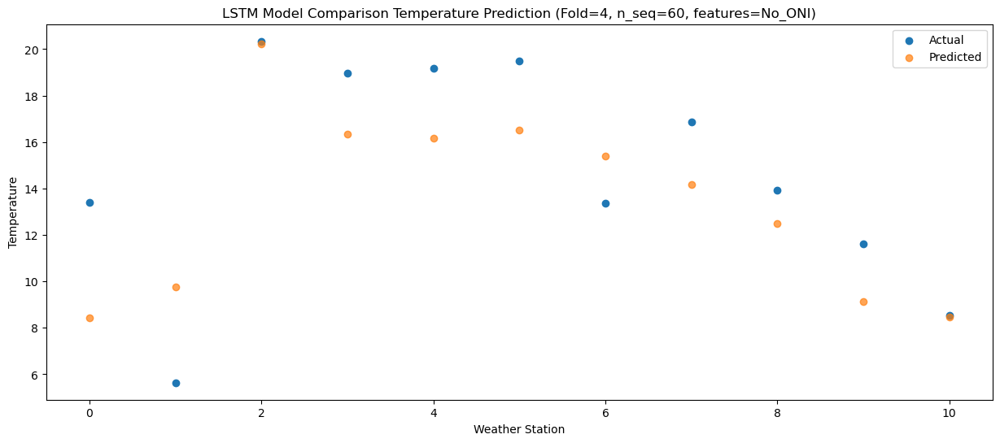

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   1.758555
1                 1    1.81   3.080503
2                 2   14.21  13.561432
3                 3   12.09   9.686260
4                 4   12.04   9.497878
5                 5   12.69   9.845574
6                 6    6.50   8.733693
7                 7   10.51   7.510225
8                 8    6.45   5.810980
9                 9    4.14   2.439209
10               10    1.68   1.785106


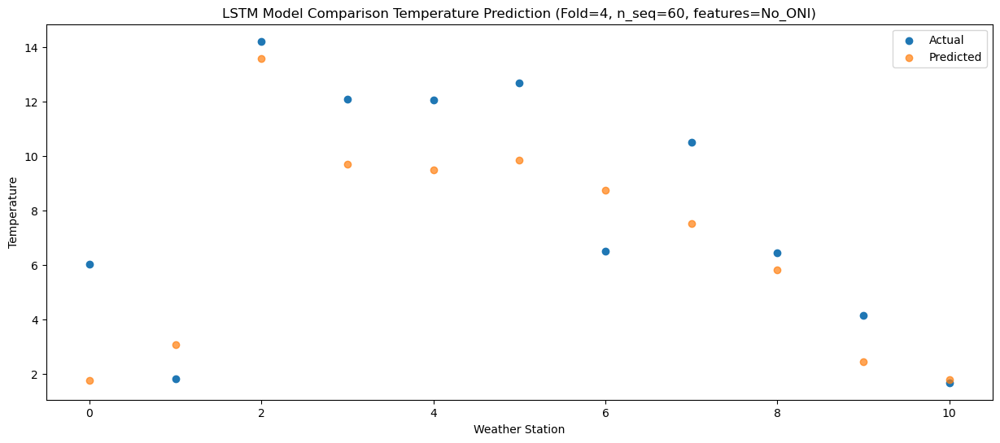

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -2.714658
1                 1    0.35  -1.414276
2                 2    9.62   9.063469
3                 3    5.04   5.199745
4                 4    4.95   5.012521
5                 5    4.84   5.355181
6                 6    3.80   4.246896
7                 7    3.96   3.025900
8                 8    0.66   1.330138
9                 9   -1.40  -2.040833
10               10   -2.40  -2.695542


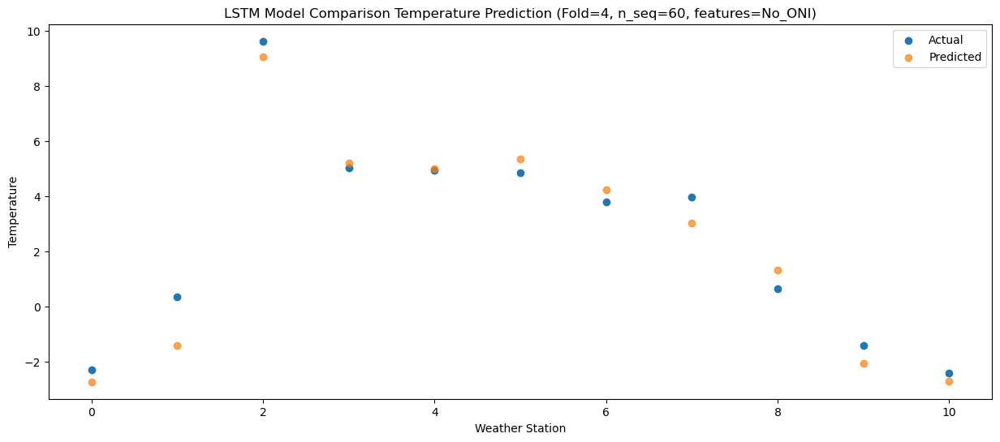

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -8.050027
1                 1   -4.50  -6.737939
2                 2    7.19   3.738571
3                 3    2.35  -0.127732
4                 4    1.98  -0.314525
5                 5    3.24   0.033836
6                 6   -2.15  -1.063430
7                 7   -0.89  -2.295505
8                 8   -5.12  -3.990138
9                 9   -8.13  -7.370237
10               10   -9.11  -8.024534


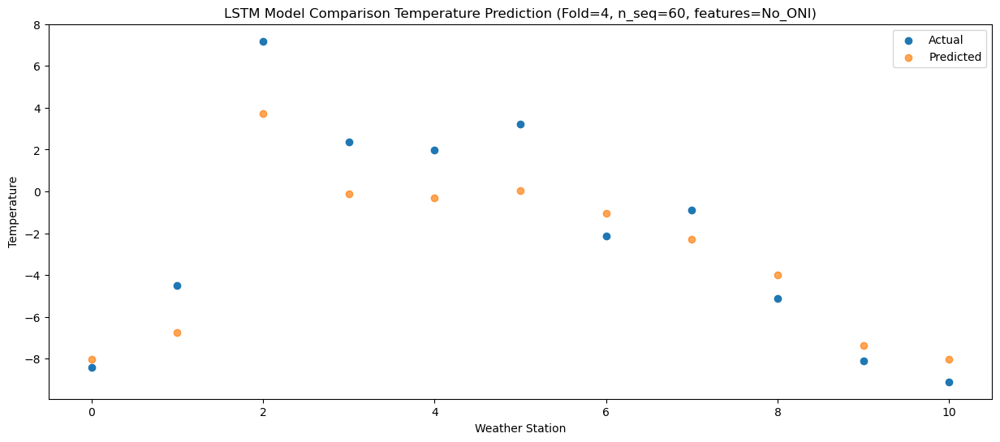

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -6.188372
1                 1   -4.65  -4.867364
2                 2    7.60   5.601251
3                 3    3.34   1.729610
4                 4    2.75   1.541559
5                 5    3.61   1.888458
6                 6    0.87   0.793488
7                 7    0.76  -0.437015
8                 8   -3.16  -2.129011
9                 9   -5.89  -5.512036
10               10   -7.48  -6.163347


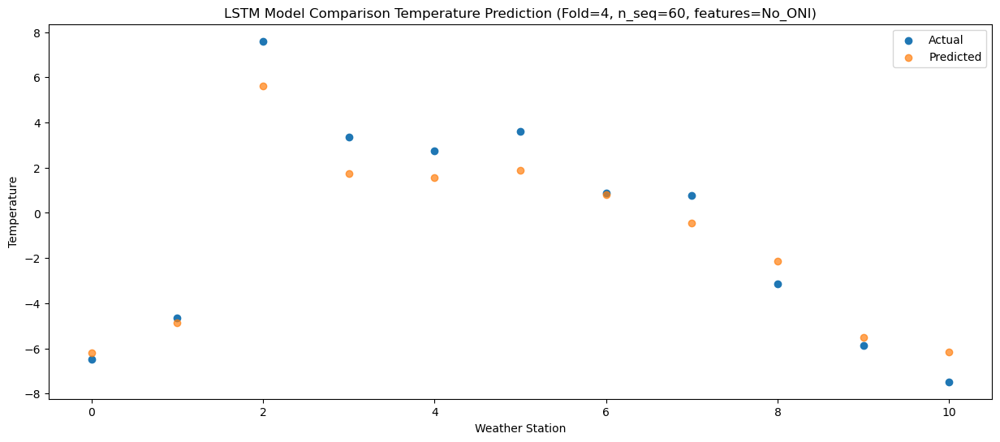

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -5.466547
1                 1   -1.35  -4.133866
2                 2    9.54   6.327868
3                 3    3.40   2.459797
4                 4    2.98   2.271712
5                 5    3.78   2.620092
6                 6    4.29   1.528664
7                 7    2.90   0.295002
8                 8   -1.57  -1.399016
9                 9   -4.70  -4.788763
10               10   -7.34  -5.435364


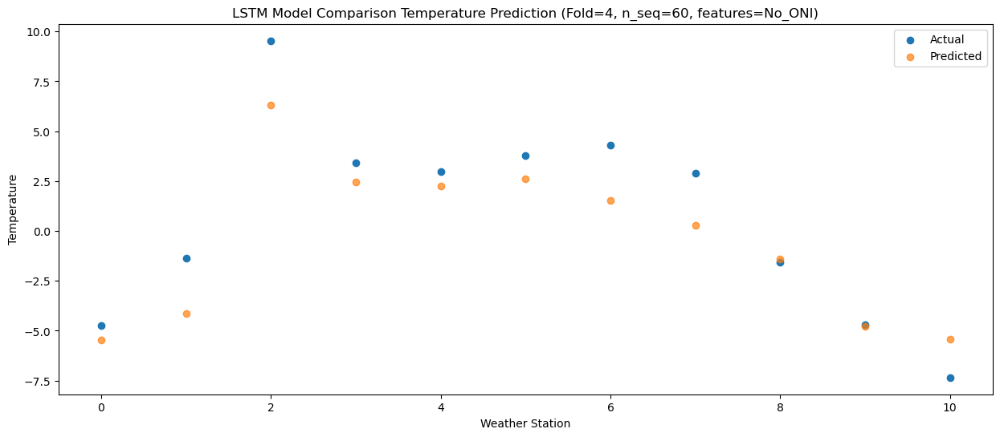

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -3.593069
1                 1    0.37  -2.264241
2                 2   11.69   8.207331
3                 3    7.93   4.341217
4                 4    7.83   4.153953
5                 5    8.85   4.503462
6                 6    4.77   3.406846
7                 7    4.62   2.172216
8                 8   -0.30   0.479659
9                 9   -2.16  -2.915320
10               10   -6.46  -3.564148


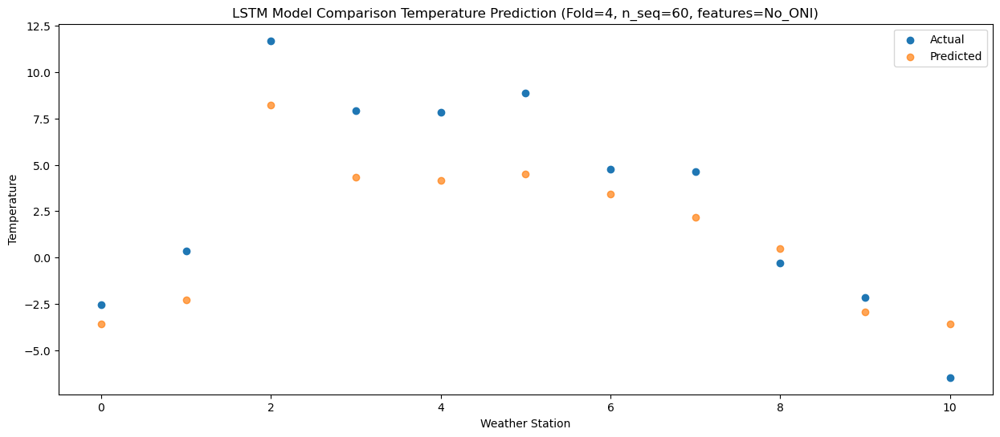

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   1.545062
1                 1    3.09   2.873020
2                 2   13.44  13.332409
3                 3   10.53   9.462465
4                 4   10.48   9.273515
5                 5   13.07   9.626715
6                 6    7.88   8.529677
7                 7   10.24   7.289793
8                 8    6.20   5.602268
9                 9    5.17   2.210977
10               10    2.01   1.562119


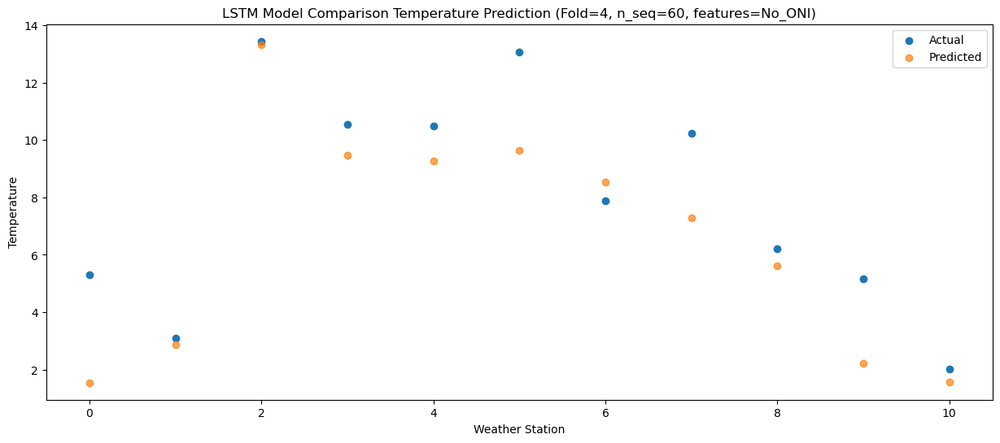

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10   5.344144
1                 1    3.87   6.681450
2                 2   18.30  17.138885
3                 3   16.21  13.262518
4                 4   16.64  13.067641
5                 5   17.99  13.421477
6                 6   10.50  12.332030
7                 7   15.02  11.093482
8                 8   11.91   9.399856
9                 9   10.93   6.008118
10               10    5.70   5.360106


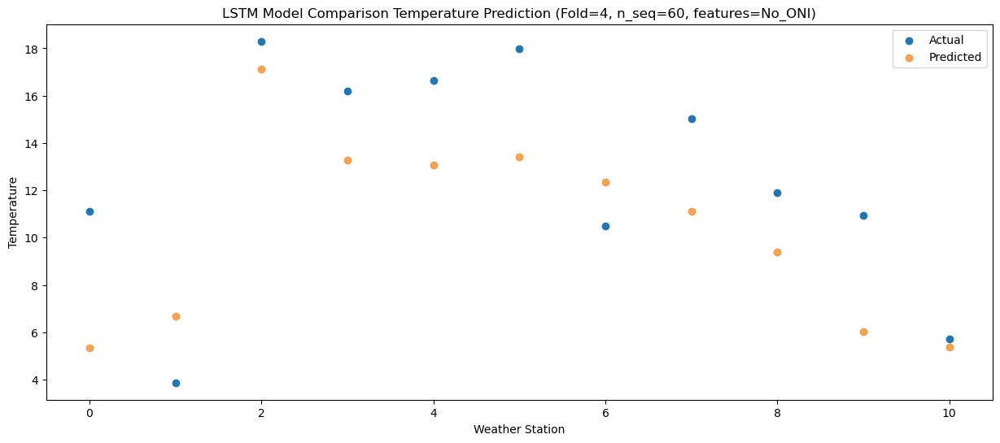

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01   9.222761
1                 1    6.08  10.563374
2                 2   21.89  21.005033
3                 3   20.40  17.124291
4                 4   21.75  16.930287
5                 5   24.47  17.292962
6                 6   14.14  16.198865
7                 7   19.10  14.958370
8                 8   15.79  13.267860
9                 9   15.24   9.875952
10               10   10.01   9.233293


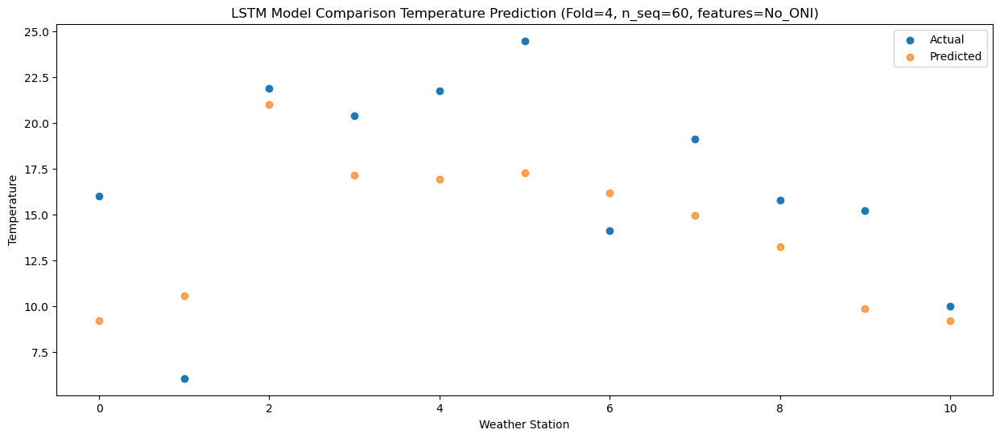

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  12.866099
1                 1    7.69  14.208705
2                 2   23.67  24.647709
3                 3   22.95  20.772022
4                 4   24.83  20.581501
5                 5   25.93  20.941279
6                 6   18.01  19.841130
7                 7   21.06  18.601122
8                 8   18.52  16.908176
9                 9   16.77  13.518570
10               10   13.10  12.873825


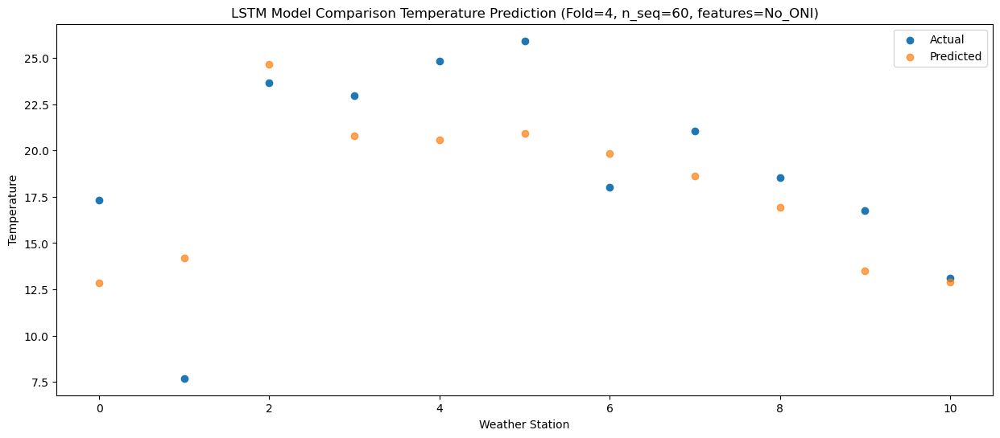

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  12.180724
1                 1    8.20  13.520325
2                 2   25.75  23.957470
3                 3   25.50  20.089725
4                 4   26.70  19.904069
5                 5   26.02  20.262196
6                 6   17.45  19.160386
7                 7   20.87  17.919633
8                 8   17.36  16.218478
9                 9   15.51  12.824252
10               10   11.77  12.177960


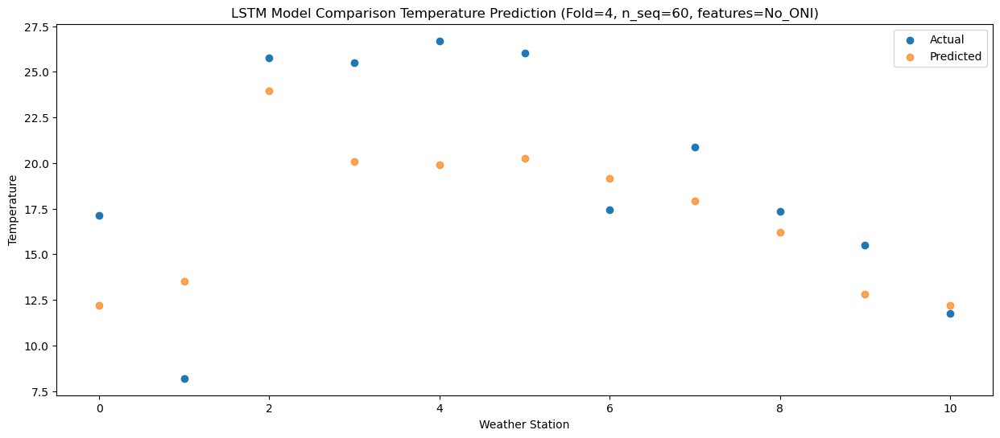

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29   8.987004
1                 1    6.10  10.325935
2                 2   22.00  20.765666
3                 3   20.80  16.894973
4                 4   21.61  16.704796
5                 5   22.54  17.067641
6                 6   13.61  15.969691
7                 7   16.93  14.727437
8                 8   14.27  13.019784
9                 9   12.47   9.619680
10               10    9.43   8.975337


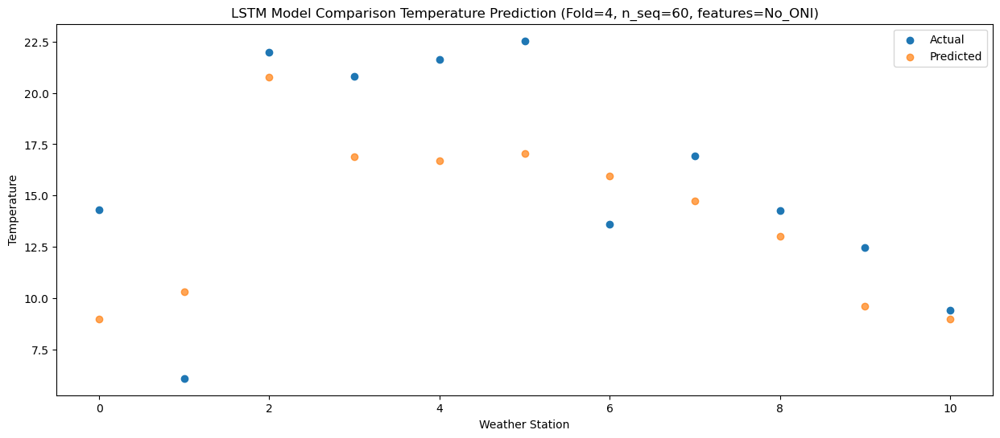

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17   3.374965
1                 1    2.45   4.721813
2                 2   15.89  15.162584
3                 3   12.67  11.294754
4                 4   12.78  11.105430
5                 5   14.01  11.466112
6                 6    8.17  10.369207
7                 7   11.03   9.121827
8                 8    8.13   7.410586
9                 9    6.06   4.009330
10               10    4.17   3.367359


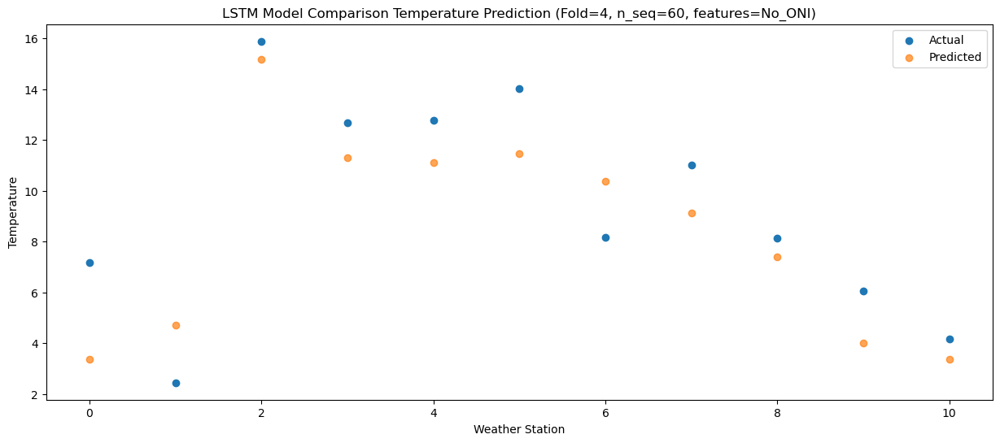

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92  -3.346798
1                 1   -1.26  -1.995963
2                 2    8.93   8.450211
3                 3    6.60   4.578091
4                 4    6.25   4.386200
5                 5    7.30   4.741002
6                 6    2.44   3.648422
7                 7    5.13   2.398208
8                 8    1.06   0.693771
9                 9   -1.03  -2.706927
10               10   -3.22  -3.346141


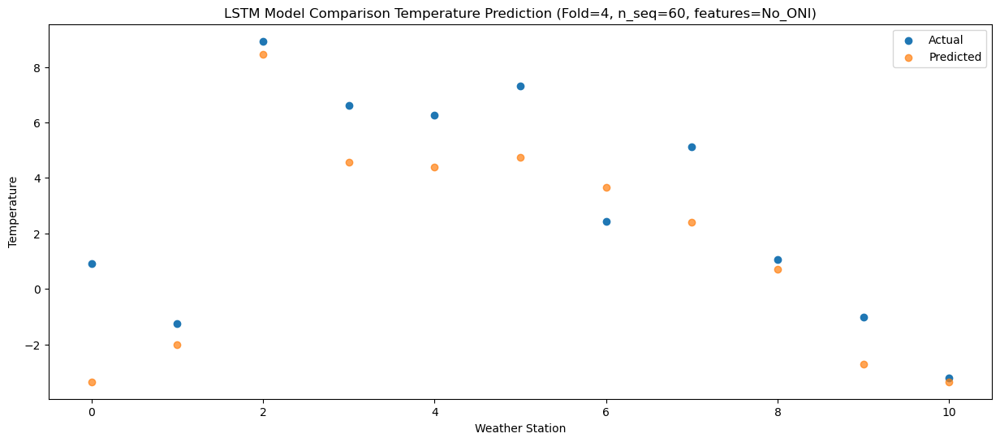

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48  -5.164665
1                 1   -3.38  -3.805354
2                 2    6.38   6.642005
3                 3    3.58   2.761506
4                 4    3.12   2.566448
5                 5    4.50   2.923484
6                 6    0.23   1.833533
7                 7    2.25   0.585208
8                 8   -0.83  -1.117745
9                 9   -3.02  -4.521185
10               10   -3.88  -5.161702


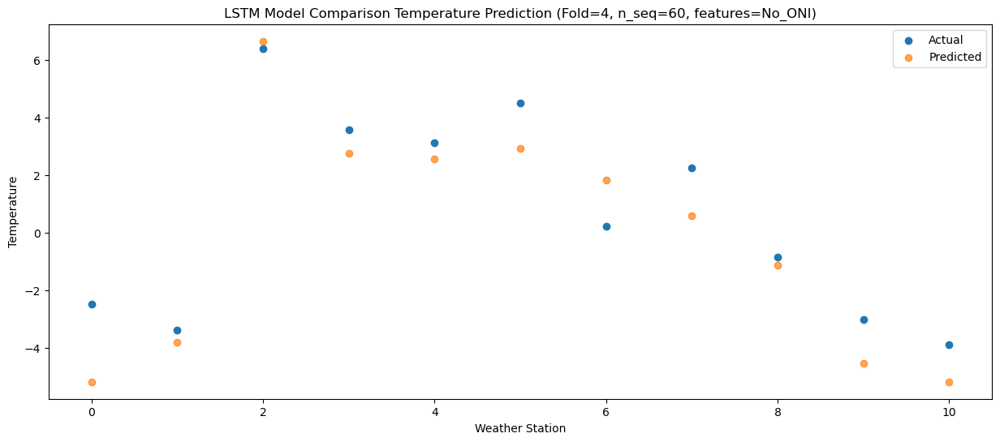

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07  -9.205703
1                 1   -4.80  -7.855694
2                 2    2.19   2.595923
3                 3   -1.94  -1.288322
4                 4   -2.23  -1.487846
5                 5    0.25  -1.130843
6                 6   -2.21  -2.218889
7                 7   -4.91  -3.463782
8                 8   -7.11  -5.158802
9                 9  -10.60  -8.554839
10               10   -9.65  -9.195055


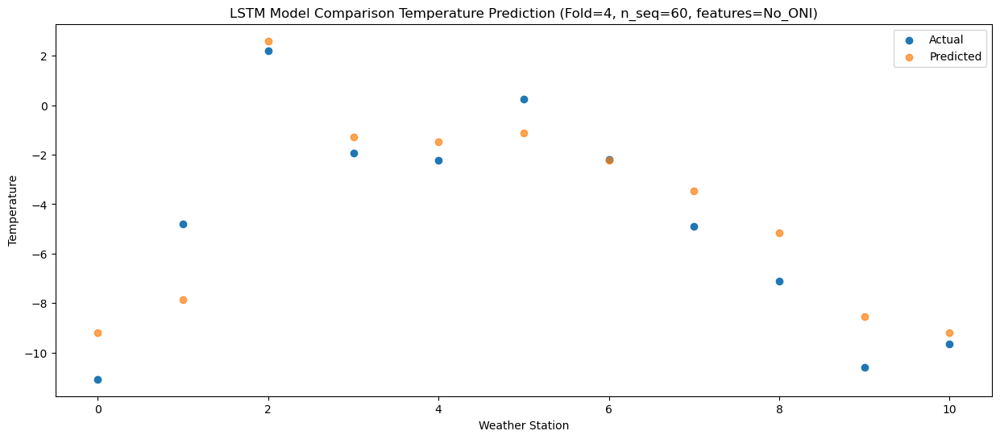

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04  -5.268910
1                 1   -5.07  -3.910786
2                 2    8.51   6.541689
3                 3    6.47   2.658106
4                 4    6.09   2.457588
5                 5    7.07   2.818951
6                 6    1.20   1.725715
7                 7    5.00   0.478373
8                 8   -0.77  -1.222585
9                 9   -2.83  -4.622536
10               10   -6.17  -5.259122


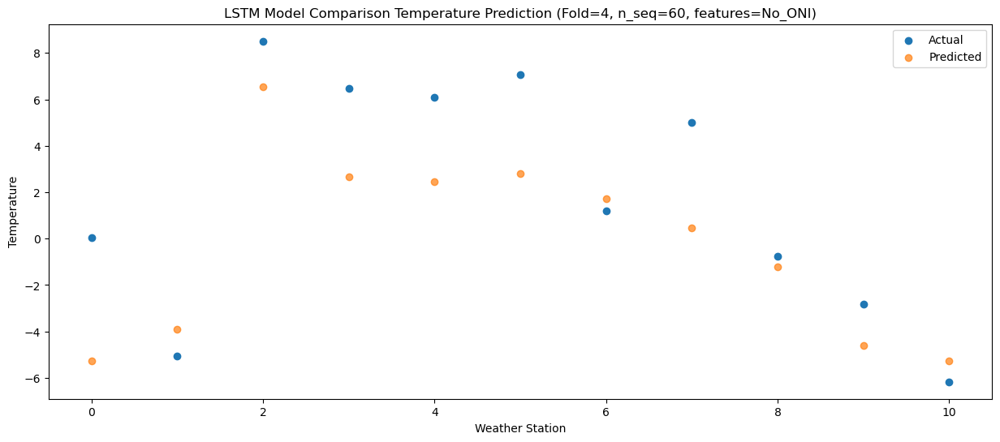

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57  -1.747818
1                 1   -0.17  -0.382283
2                 2   10.74  10.065979
3                 3    8.88   6.175945
4                 4    8.66   5.974930
5                 5    9.67   6.344126
6                 6    4.99   5.255813
7                 7    7.43   4.003894
8                 8    3.67   2.297760
9                 9    1.32  -1.108149
10               10   -2.82  -1.739704


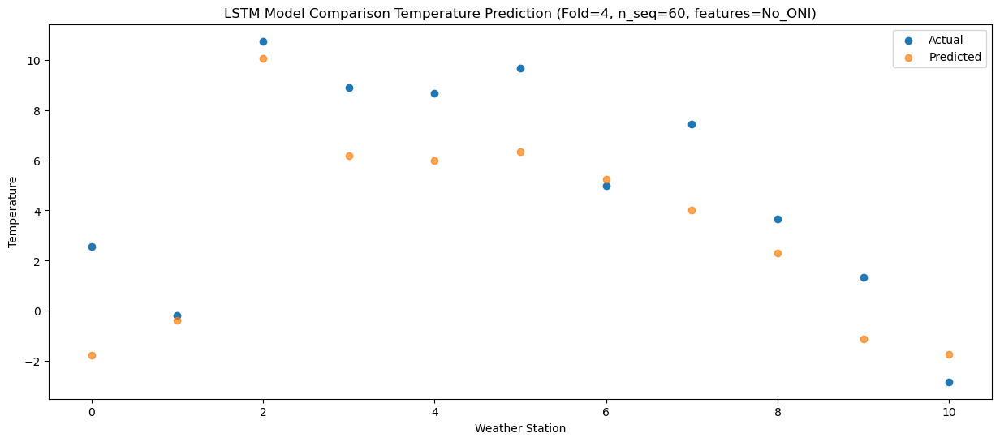

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19   2.416150
1                 1    0.88   3.770161
2                 2   14.56  14.224188
3                 3   12.73  10.341144
4                 4   12.71  10.138505
5                 5   14.63  10.504627
6                 6    9.22   9.414786
7                 7   11.57   8.171869
8                 8    8.25   6.460961
9                 9    5.81   3.056120
10               10    2.90   2.426933


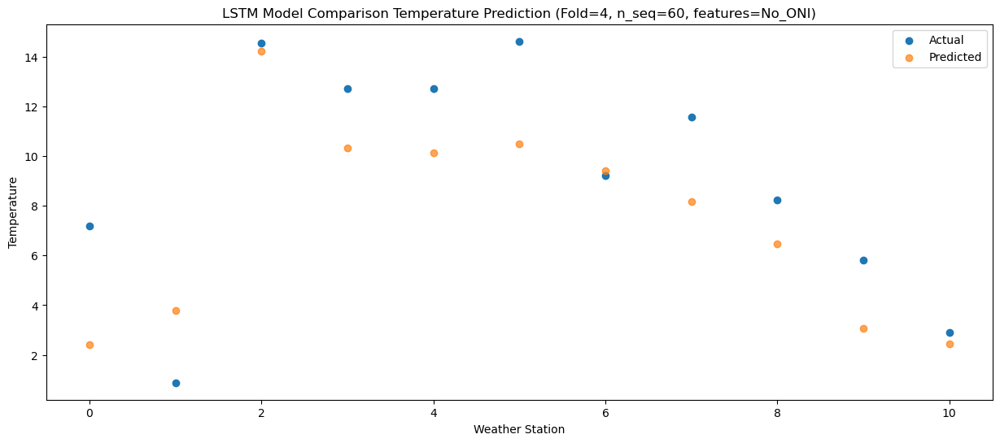

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20   7.601820
1                 1    6.33   8.950475
2                 2   20.08  19.410829
3                 3   17.49  15.533564
4                 4   17.51  15.334004
5                 5   19.92  15.697453
6                 6   13.29  14.603695
7                 7   16.22  13.359577
8                 8   14.85  11.644870
9                 9   12.84   8.239519
10               10    9.00   7.603318


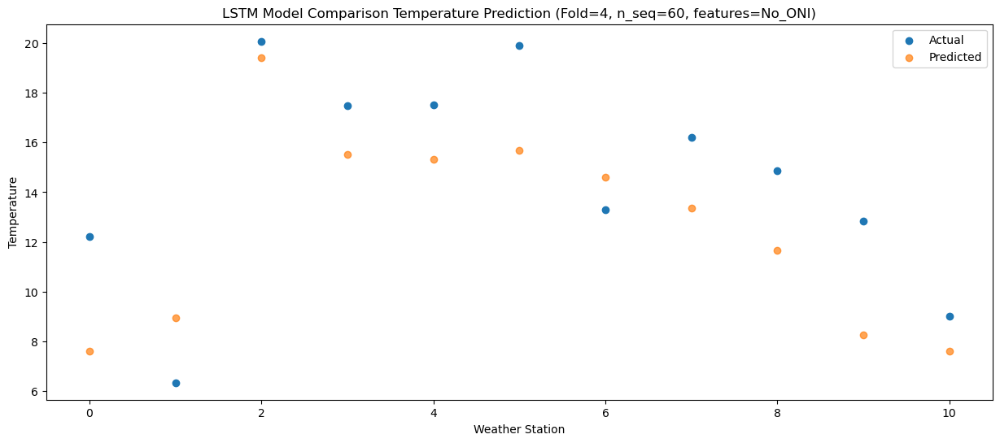

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  11.791538
1                 1    6.98  13.135853
2                 2   22.71  23.592100
3                 3   21.52  19.717252
4                 4   21.96  19.515916
5                 5   23.93  19.881508
6                 6   16.71  18.785555
7                 7   19.94  17.539500
8                 8   18.21  15.822845
9                 9   16.81  12.414093
10               10   12.16  11.778773


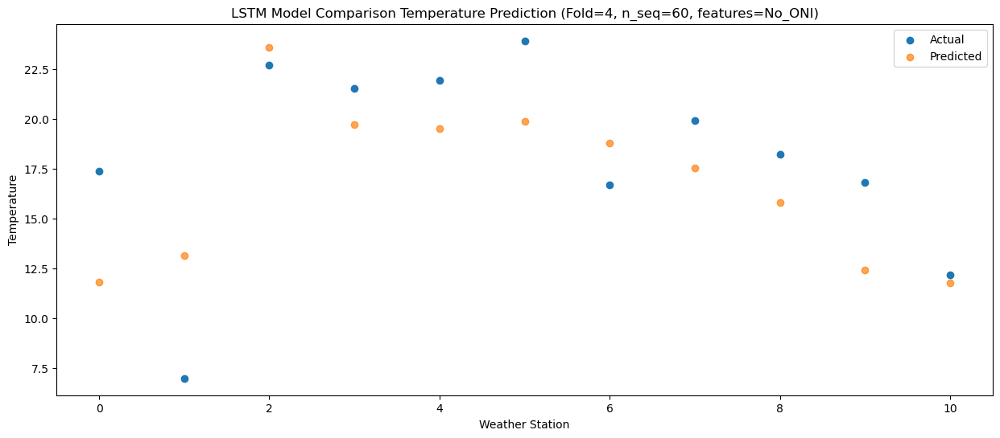

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  12.920022
1                 1    7.67  14.281090
2                 2   23.73  24.732300
3                 3   22.42  20.850459
4                 4   22.67  20.647787
5                 5   22.76  21.016122
6                 6   18.17  19.924662
7                 7   20.24  18.672782
8                 8   18.22  16.957710
9                 9   15.84  13.548909
10               10   13.68  12.915176


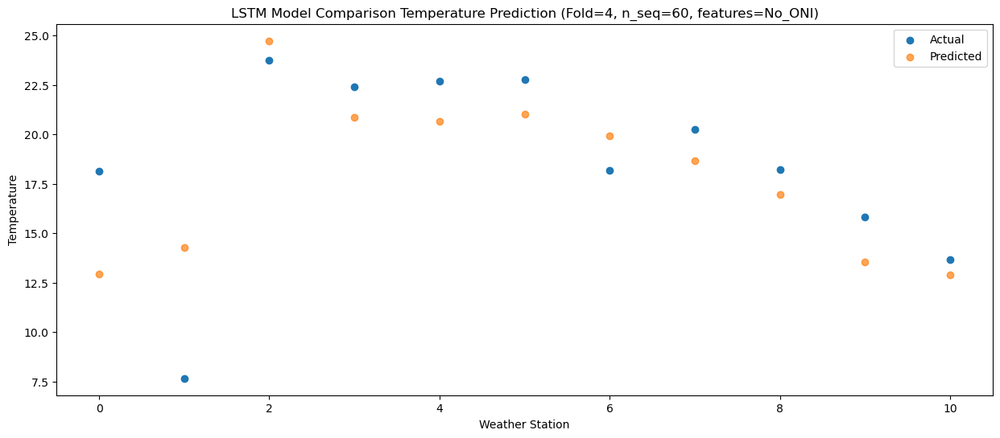

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  11.778205
1                 1    7.37  13.138064
2                 2   24.30  23.596526
3                 3   24.17  19.714687
4                 4   24.63  19.510611
5                 5   25.22  19.878475
6                 6   17.01  18.793658
7                 7   20.68  17.538283
8                 8   18.14  15.822387
9                 9   15.50  12.413140
10               10   12.54  11.777163


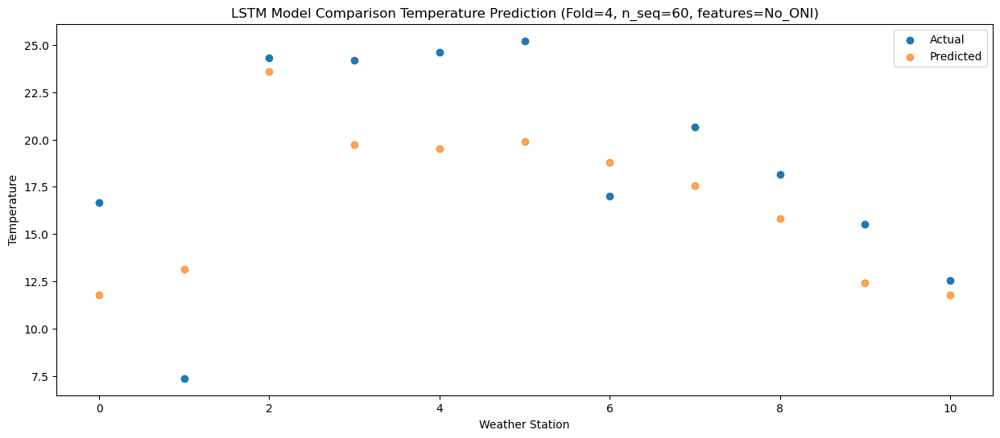

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23   8.859071
1                 1    6.50  10.220425
2                 2   20.69  20.671987
3                 3   18.78  16.792641
4                 4   18.62  16.595377
5                 5   18.77  16.961364
6                 6   14.57  15.872237
7                 7   16.54  14.613374
8                 8   15.53  12.895351
9                 9   12.27   9.485216
10               10   10.27   8.850196


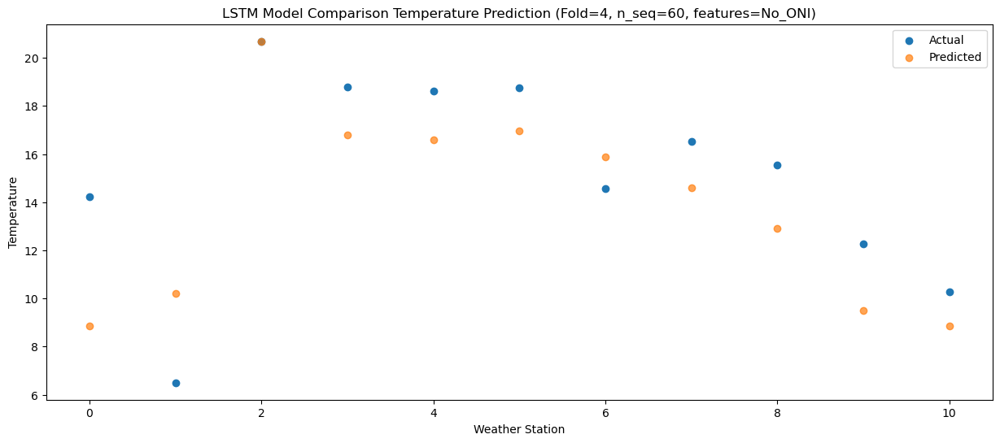

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10   3.980529
1                 1    2.73   5.342815
2                 2   16.55  15.799735
3                 3   16.03  11.923580
4                 4   16.20  11.727865
5                 5   17.06  12.093313
6                 6    8.95  11.001884
7                 7   12.86   9.743455
8                 8    9.60   8.022065
9                 9    7.20   4.613517
10               10    3.80   3.976650


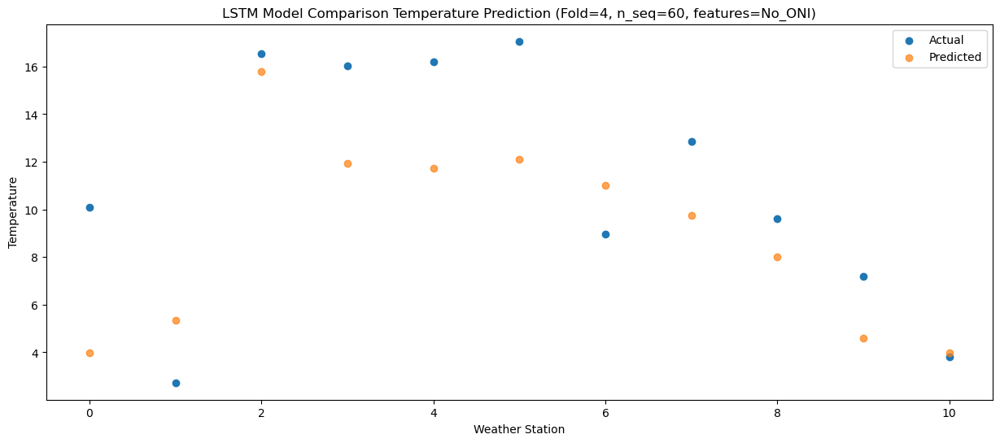

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

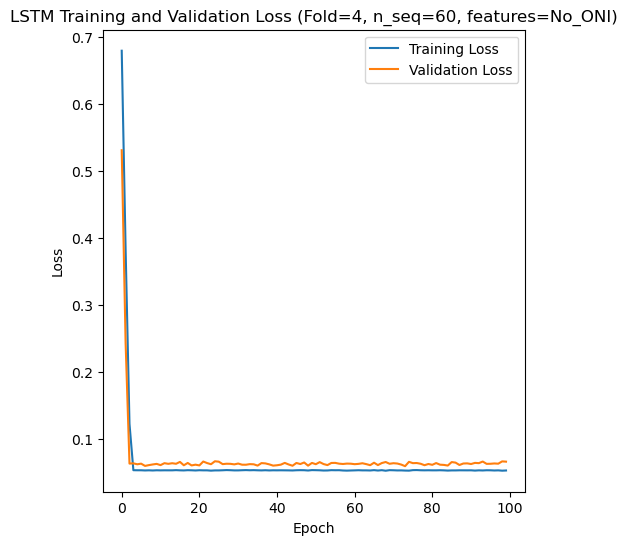

[[2.6436398379330015], [2.6565719224234385], [2.92411841727002], [3.5829173302860875], [2.6870945811505655]]
[[array(2.64363984)], [array(2.65657192)], [array(2.92411842)], [array(3.58291733)], [array(2.68709458)]]
[[2.093180070504546], [2.181748026232827], [2.2774454664849872], [2.81813680595069], [2.176535536065245]]
[[1.199643038596339], [0.7134581285866327], [1.207653442019532], [1.792548733818079], [0.833648083757636]]
[[0.8877198260007731], [0.8907349548458277], [0.8797966189014406], [0.8538153936374726], [0.9129387224017734]]
[[array(-0.58598164)], [array(0.31813993)], [array(-0.11710081)], [array(1.03503577)], [array(0.60937937)]]
[[array(0.93772646)], [array(0.90160172)], [array(0.89127614)], [array(0.8584495)], [array(0.93152789)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-3.02216335 -4.88735732 -5.29619022 ... 11.77716295  8.85019628
  3.97665016]
Accuracy Results:
RMSE for each fold:
[[2.6436398379330015], [2.6565719224234385], [2.92411841727002], [3.5829173302860875], [2

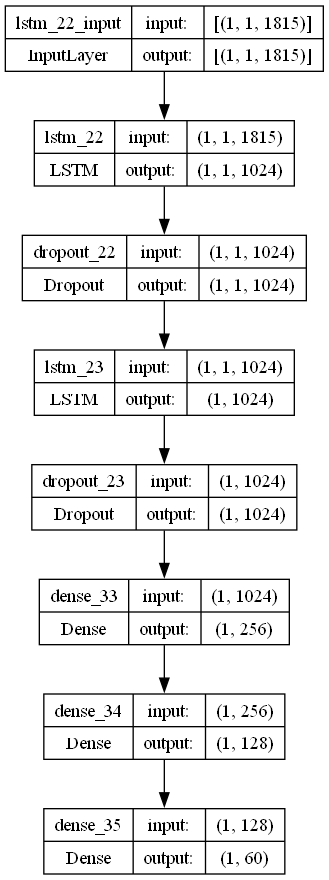

In [5]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.005668181316305681 
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.45502838358743375

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)